<a href="https://colab.research.google.com/github/gyanendar/ms_project/blob/main/RIM_ONE_DL_CROSSFOLD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Author: Gyanendar Manohar

Description: Implementation RIM-ONE DL validation

F. J. F. Batista, T. Diaz-Aleman, J. Sigut, S. Alayon, R. Arnay, and D. Angel-
Pereira, “Rim-one dl: A unified retinal image database for assessing glaucoma
using deep learning,” Image Analysis Stereology, vol. 39, no. 3, pp. 161–167, 2020.

# Headers

In [ ]:
import os
import random
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from IPython.display import display
from keras.layers import Dense, GlobalAveragePooling2D
#from keras.utils import plot_model
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from sklearn.model_selection import train_test_split
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix,accuracy_score
from sklearn.model_selection import KFold
from sklearn import metrics
import seaborn as sns

In [ ]:
import gc
gc.collect()

59

# Drives

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
RIM_ONE_DL_DIR = '/content/gdrive/My Drive/MSC_Project/Dataset/RIM-ONE_DL_images/partitioned_randomly'
RIM_ONE_DL_HOSPITAL_TEST_DIR = '/content/gdrive/My Drive/MSC_Project/Dataset/RIM-ONE_DL_images/partitioned_by_hospital'
RIM_ONE_R2_DIR= '/content/gdrive/My Drive/MSC_Project/Dataset/RIMONE-db-r2'
ACRIMA_DIR = '/content/gdrive/My Drive/MSC_Project/Dataset/ACRIMA'
SAVE_FILE = r'/content/gdrive/My Drive/MSC_Project/Model/CNN/generated_data/RIMONE_CROSSFOLD_v1.csv'
#SAVE_FILE = r'/content/gdrive/My Drive/MSC_Project/Model/CNN/generated_data/RIMONE_CROSSFOLD.csv'


In [ ]:
def initialise_df_perfromance_matrix():
  g_performance_df =  pd.DataFrame([], columns = ['Model', 'Accuracy','Sensitivity','AUC'])
  g_performance_df.to_csv(SAVE_FILE, encoding='utf-8', index=False)

In [ ]:
def save_performance_data(new_data):
  g_performance_df = pd.read_csv(SAVE_FILE)
  data_list = g_performance_df.values.tolist()
  data_exist = False
  for index in range(len(data_list)):
    if(data_list[index][0]==new_data[0]):
      data_list[index] = new_data
      data_exist = True
  if(data_exist==False):
    data_list.append(new_data)
  g_performance_df = pd.DataFrame(data_list, columns = ['Model', 'Accuracy','Sensitivity','AUC'])
  g_performance_df.to_csv(SAVE_FILE, encoding='utf-8', index=False)

In [ ]:
HEIGHT= 299
WIDTH = 299
BATCH_SIZE = 32
CLASS_COUNT = 2
NUM_EPOCHS_A = 50
NUM_EPOCHS_B = 50
g_performance = {}

# Dataset

In [ ]:
# Resize image to 256*256
# Convert to numpy array
def process_image(data_set_dir, label_dict, width, height):
    print(f"Width {width}, Height:{height}")
    x = [] # will store images as arrays
    y = [] # store labels
    # list folders in directory
    directories = os.listdir(data_set_dir)
     
    # for each folder (train and validation) 
    for label in directories:
        
        # add class label to label dictionary
        if label not in label_dict:
            label_dict[label] = len(label_dict)
        
        # create full path for image directory 
        source_images = os.path.join(data_set_dir, label)
        images = os.listdir(source_images)
        # for each image in directory, 
        for image in images:
            #folder have .txt files which needs to be ignored
            if '.txt'not in image:
                # read the image from file, resize and add to a list
                full_size_image = cv2.imread(os.path.join(source_images, image))
                
                #append the image to x
                x.append(cv2.resize(full_size_image, (width,height), 
                                                            interpolation=cv2.INTER_CUBIC))
                # add the class label to y
                y.append(label)

   
    data = np.array(x, dtype="float") / 255.0                
    label = np.array(y)
    
    return data,label

In [ ]:
def get_rim_one_dl_dataset(width = WIDTH, height = HEIGHT):
    class_labels = {}
    training_images,training_labels = process_image(RIM_ONE_DL_DIR+"/training_set",class_labels,width,height)
    training_label = (pd.Series(training_labels).map(class_labels)).values
   

    test_images,test_labels = process_image(RIM_ONE_DL_DIR+"/test_set",class_labels,width,height)
    test_label = (pd.Series(test_labels).map(class_labels)).values
    
    return training_images,training_label,test_images,test_label

In [ ]:
def get_rim_one_dl_dataset_hospital(width = WIDTH, height = HEIGHT):
   class_labels = {}
   training_images,training_labels = process_image(RIM_ONE_DL_HOSPITAL_TEST_DIR+"/training_set",class_labels,width,height)
   training_label = (pd.Series(training_labels).map(class_labels)).values
   

   test_images,test_labels = process_image(RIM_ONE_DL_HOSPITAL_TEST_DIR+"/test_set",class_labels,width,height)
   test_label = (pd.Series(test_labels).map(class_labels)).values
    
   return training_images,training_label,test_images,test_label

In [ ]:
def get_rim_one_db_r2(width,height,test_train_ratio = 0.2,histogram_eq = False):
  print(f"Height:{height} Width:{width} test_train_ratio:{test_train_ratio}")
  class_labels = {}
  training_images,training_labels = process_image(RIM_ONE_R2_DIR,
                                                  class_labels,
                                                  width,height)
  
  training_label = (pd.Series(training_labels).map(class_labels)).values
  #training_label = to_categorical(training_label.astype('float32'))
  training_images = training_images.reshape(-1, width, width, 3).astype('float32')

  X_train, X_test, y_train, y_test = train_test_split(training_images, 
                                                      training_label, 
                                                      test_size=test_train_ratio, 
                                                      random_state=100)

  return (X_train,y_train),(X_test,y_test)

In [ ]:
def get_acrima_dataset(width,height,test_train_ratio = 0.2):
  print(f"Height:{height} Width:{width}")
  class_labels = {}
  training_images,training_labels = process_image(ACRIMA_DIR,
                                                  class_labels,
                                                  width,height)
  
  training_label = (pd.Series(training_labels).map(class_labels)).values
  #training_label = to_categorical(training_label.astype('float32'))
  training_images = training_images.reshape(-1, width, width, 3).astype('float32')

  X_train, X_test, y_train, y_test = train_test_split(training_images, 
                                                      training_label, 
                                                      test_size=test_train_ratio, 
                                                      random_state=100)

  return (X_train,y_train),(X_test,y_test)

In [ ]:
def set_seed():
  tf.random.set_seed(100)
  np.random.seed(100)
  random.seed(100)

**Callbacks**

In [ ]:


def get_early_stoping_cb_on_min_val_loss(patience_num = 6):
  return EarlyStopping(monitor='val_loss', mode='min', verbose=0, \
                       patience=patience_num)

def get_model_checkpoint_cb_on_max_val_acc(file_name):
  return ModelCheckpoint(file_name, monitor="val_loss", 	mode="min", \
                         save_best_only=True, verbose=1)	

def learning_rate_schedular_fun(epoch, lr):
  if epoch <100:
    return lr 
  else:
    return lr*tf.math.exp(-.1)
  
def get_model_learning_rate_cb():
  return tf.keras.callbacks.LearningRateScheduler(learning_rate_schedular_fun,\
                                                  verbose=0)


def get_basic_callback():
  return [get_early_stoping_cb_on_min_val_loss()]

def get_basic_and_lrs_callback():
  return [get_early_stoping_cb_on_min_val_loss(),get_model_learning_rate_cb()]

def get_all_callback(file_name):
  return [get_early_stoping_cb_on_min_val_loss(),\
          get_model_checkpoint_cb_on_max_val_acc(file_name)]

# Plots

In [ ]:
def plot_model_performance(history,model_name,part):
  plt.style.use("ggplot")
  plt.figure(figsize=(7,6))
  epoch_ran = len(history.history["loss"])
  plt.plot(np.arange(0, epoch_ran), \
           history.history["loss"], label="train_loss")
  plt.plot(np.arange(0, epoch_ran), \
           history.history["val_loss"], label="val_loss")
  plt.plot(np.arange(0, epoch_ran), \
           history.history["accuracy"], label="train_acc")
  plt.plot(np.arange(0, epoch_ran), \
           history.history["val_accuracy"], label="val_acc")
  plt.title("Training Loss and Accuracy")
  plt.xlabel("Epoch #")
  plt.ylabel("Loss/Accuracy")
  plt.legend()
  plt.show()

  #Print best score 
 
  print("\nModel Performance Summary:\n")
  
  

  epoch_index = history.history["val_accuracy"].index(max(history.history["val_accuracy"]))
    
  best_val_accuracy = history.history["val_accuracy"][epoch_index]

  print(f"Best Validation accuracy:{best_val_accuracy} at EPOCH:{epoch_index+1}")

  
  
  #Store the above performance matrix
  #g_record_v1.add_entry(model_name,MODEL_PERFORMANCE(model_part = part, \
  #   val_acc = best_val_accuracy))

In [ ]:
def plot_ROC_AUC(fpr,tpr,roc_auc):
    plt.figure()
    lw = 2
    plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()

In [ ]:
def plot_overall_performance():
  g_performance_df = pd.read_csv(SAVE_FILE)
  #data_list = g_performance_df.values.tolist()
  
  # for item in g_performance:
  #   data_list.append([item,g_performance[item][0],g_performance[item][1],g_performance[item][2]])
  #df = pd.DataFrame(data_list, columns = ['Model', 'Accuracy','Sensitivity','AUC'])
 
  display(g_performance_df)
  plt.figure()
  plot = sns.barplot(y='Model', x='Accuracy', data=g_performance_df)
  plt.show()
  print(g_performance_df.to_latex(index=False))

In [ ]:
def plot_performance(dataset='RIM-ONE_v2'):
  g_performance_df = pd.read_csv(SAVE_FILE)
  filtered_df = g_performance_df[g_performance_df["Model"].str.contains(dataset)]
  display(filtered_df)
  plt.figure()
  plot = sns.barplot(y='Model', x='Accuracy', data=filtered_df)
  plt.show()

  print(filtered_df.to_latex(index=False))

Get Pre-trained Model

In [ ]:
# Returns Pretrained Network with top layer removed
# And Trainable set to false

def get_high_level_model(trained_model_name,input_shape = (224,224,3)):
  set_seed()
  model = None
  if trained_model_name == "vgg16":
      model = tf.keras.applications.VGG16(weights='imagenet', \
                              include_top = False, input_shape = input_shape)
      
  elif trained_model_name == "vgg19":
      model =  tf.keras.applications.VGG19(weights='imagenet', \
                              include_top = False, input_shape = input_shape)
      
  elif trained_model_name == "resnet50":
     model = tf.keras.applications.ResNet50(weights='imagenet', \
                              include_top = False, input_shape = input_shape)
     
  elif trained_model_name == "xception":
     model = tf.keras.applications.Xception(weights='imagenet', \
                            include_top = False, input_shape = input_shape)
     
  elif trained_model_name == "DenseNet121":
     model = tf.keras.applications.DenseNet121(weights='imagenet', \
                            include_top = False, input_shape = input_shape)
  elif trained_model_name == "MobileNet":
     model = tf.keras.applications.MobileNet(weights='imagenet', \
                            include_top = False, input_shape = input_shape)
  elif trained_model_name == "MobileNetV2":
     model = tf.keras.applications.MobileNetV2(weights='imagenet', \
                            include_top = False, input_shape = input_shape)
  elif trained_model_name == "InceptionResNetV2":
     model = tf.keras.applications.InceptionResNetV2(weights='imagenet', \
                            include_top = False, input_shape = input_shape)
  elif trained_model_name == "InceptionV3":
     model = tf.keras.applications.InceptionV3(weights='imagenet', \
                            include_top = False, input_shape = input_shape)  
  elif trained_model_name == "NASNetMobile":
     model = tf.keras.applications.NASNetMobile(weights='imagenet', \
                            include_top = False, input_shape = input_shape)  

  elif trained_model_name == "NasNetLarge":
     model = tf.keras.applications.NASNetLarge(weights='imagenet', \
                            include_top = False, input_shape = input_shape)       
  
  if model != None:
    for layer in model.layers:
       layer.trainable = False

  return model

In [ ]:
# Returns Pretrained Network with top layer removed
# And Trainable set to false

def get_high_level_model_ex(trained_model_name):
  set_seed()
  model = None
  if trained_model_name == "vgg16":
      model = tf.keras.applications.VGG16(weights='imagenet', \
                              include_top = False, input_shape = (224,224,3))
      
  elif trained_model_name == "vgg19":
      model =  tf.keras.applications.VGG19(weights='imagenet', \
                              include_top = False, input_shape = (224,224,3))
      
  elif trained_model_name == "resnet50":
     model = tf.keras.applications.ResNet50(weights='imagenet', \
                              include_top = False, input_shape = (224,224,3))
     
  elif trained_model_name == "xception":
     model = tf.keras.applications.Xception(weights='imagenet', \
                            include_top = False, input_shape = (299,299,3))
     
  elif trained_model_name == "DenseNet121":
     model = tf.keras.applications.DenseNet121(weights='imagenet', \
                            include_top = False, input_shape = (224,224,3))
  elif trained_model_name == "MobileNet":
     model = tf.keras.applications.MobileNet(weights='imagenet', \
                            include_top = False, input_shape = (224,224,3))
  elif trained_model_name == "MobileNetV2":
     model = tf.keras.applications.MobileNetV2(weights='imagenet', \
                            include_top = False, input_shape = (224,224,3))
  elif trained_model_name == "InceptionResNetV2":
     model = tf.keras.applications.InceptionResNetV2(weights='imagenet', \
                            include_top = False, input_shape = (299,299,3))
  elif trained_model_name == "InceptionV3":
     model = tf.keras.applications.InceptionV3(weights='imagenet', \
                            include_top = False, input_shape = (299,299,3))  
  elif trained_model_name == "NASNetMobile":
     model = tf.keras.applications.NASNetMobile(weights='imagenet', \
                            include_top = False, input_shape = (224,224,3))  

  elif trained_model_name == "NasNetLarge":
     model = tf.keras.applications.NASNetLarge(weights='imagenet', \
                            include_top = False, input_shape = (331,331,3))       
  
  if model != None:
    for layer in model.layers:
       layer.trainable = False

  return model

# MODEL

In [ ]:
def get_resizing_layer(model_name,actual_resizing = False):

   if actual_resizing == False:
      return tf.keras.Sequential([tf.keras.layers.Resizing(224, 224)])
      
   if model_name == 'NasNetLarge':
      return tf.keras.Sequential([tf.keras.layers.Resizing(331, 331)])
   elif model_name == 'InceptionV3' or model_name == 'xception' or model_name == 'InceptionResNetV2':
      return tf.keras.Sequential([tf.keras.layers.Resizing(299, 299)])
   else:
      return tf.keras.Sequential([tf.keras.layers.Resizing(224, 224)])

In [ ]:
class HIGH_LEVEL_MODEL:
  def __init__(self, trained_model_name,fold = 5):

    set_seed()
    
    #Start constructing the model with pretrained network 
    self.model = tf.keras.models.Sequential(name = trained_model_name)
    self.model.add(get_resizing_layer(trained_model_name))
    
    # Get Pretrained model with top layer removed and trainable parameter frozen
    self.high_level_model_obj = get_high_level_model(trained_model_name)
    self.model.add(self.high_level_model_obj)
    
    # Flatten the output and add FC & Softmax layer
    #self.model.add(tf.keras.layers.Flatten())
    self.model.add(tf.keras.layers.GlobalAveragePooling2D())
    
    #self.model.add(tf.keras.layers.Dense(512, activation='relu'))  
    self.model.add(tf.keras.layers.Dense(CLASS_COUNT, activation='softmax'))                             
    
    #Model is constructed Now
    #print(self.model.summary())    
    
    #display(plot_model(self.model, show_shapes=True, expand_nested=True))
    
    # Setting Model JSON file and weight filte name 
    self.model_file_name = self.model.name+".json"
    self.fold_count = fold
    #display(plot_model(self.model, show_shapes=True, expand_nested=True))
    self.kfold = KFold(n_splits=self.fold_count, shuffle=True)
    # Setting Model JSON file and weight filte name 
    self.model_wt_file_name_a = []
    self.model_wt_file_name_b = []
    self.model_file_name = self.model.name+".json"
    for index in range(0,fold):
      self.model_wt_file_name_a.append(f"{self.model.name}_a_{index}.hdf5")
      self.model_wt_file_name_b.append(f"{self.model.name}_b_{index}.hdf5")
    self.model_wt_file_name =f"{self.model.name}_wt.hdf5"
    self.fold_accuracy_a = []
    self.fold_accuracy_b = []
    
    # To identify the variantion in parameter 
    #self.model_varient = varient

  def train_phase(self,train_x,train_y,test_x,test_y,data_aug=True,dataset = 'RIM-ONE_dl'):
    fold_itr = 0
    for train,validate in self.kfold.split(train_x,train_y):  
      print(f"Starting fold {fold_itr}")

      train_data_generator = ImageDataGenerator(horizontal_flip=True,vertical_flip=True,rotation_range=30, fill_mode='nearest',zoom_range=0.2)
      if data_aug == False:
         train_data_generator = ImageDataGenerator()
      
      train_generator = train_data_generator.flow(train_x[train], train_y[train], batch_size=BATCH_SIZE)
   
      val_data_generator = ImageDataGenerator()
      val_generator = val_data_generator.flow(train_x[validate], train_y[validate], batch_size=BATCH_SIZE)

      self.model.compile(loss='sparse_categorical_crossentropy', \
          optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-5),metrics=['accuracy'])
    
      model_json = self.model.to_json()
      with open(self.model_file_name, "w") as json_file:
        json_file.write(model_json)

      history = self.model.fit(train_generator, epochs=NUM_EPOCHS_A, \
                   batch_size=BATCH_SIZE, validation_data=val_generator, \
                   callbacks = get_all_callback(self.model_wt_file_name_a[fold_itr]))        
      best_val_accuracy = max(history.history["val_accuracy"])
      self.fold_accuracy_a.append(best_val_accuracy)
      
      plot_model_performance(history,self.model.name,"phase_a"+str(fold_itr))
      
      self.model.load_weights(self.model_wt_file_name_a[fold_itr])
      self.high_level_model_obj.trainable = True
      gc.collect()
      optimizer_obj = tf.keras.optimizers.RMSprop(learning_rate=1e-5)
      self.model.compile(loss='sparse_categorical_crossentropy',
                optimizer=optimizer_obj,
                metrics=['accuracy'])
    
      history = self.model.fit(train_generator, epochs=NUM_EPOCHS_B, \
                   batch_size=BATCH_SIZE, validation_data=val_generator, \
                   callbacks = get_all_callback(self.model_wt_file_name_b[fold_itr]))

      best_val_accuracy = max(history.history["val_accuracy"])
      self.fold_accuracy_b.append(best_val_accuracy)      
      plot_model_performance(history,self.model.name,"phase_b"+str(fold_itr))
      fold_itr = fold_itr + 1
      gc.collect()

    print(f"Average Accuracy:{sum(self.fold_accuracy_b)/len(self.fold_accuracy_b)}")
    print(" Training Model on full dataset")
    print(" Training Model with pretraned layer frozen")
    index= self.fold_accuracy_b.index(max(self.fold_accuracy_b))
    self.model.load_weights(self.model_wt_file_name_b[index])
    self.high_level_model_obj.trainable = False
    optimizer_obj = tf.keras.optimizers.RMSprop(learning_rate=1e-5)
    self.model.compile(loss='sparse_categorical_crossentropy',
                optimizer=optimizer_obj,
                metrics=['accuracy'])
    
    train_data_generator = ImageDataGenerator(horizontal_flip=True,vertical_flip=True,rotation_range=30, fill_mode='nearest',zoom_range=0.2)
    if data_aug == False:
       train_data_generator = ImageDataGenerator()

    train_generator = train_data_generator.flow(train_x, train_y, batch_size=BATCH_SIZE)
   
    val_data_generator = ImageDataGenerator()
    val_generator = val_data_generator.flow(test_x,test_y, batch_size=BATCH_SIZE)
    history = self.model.fit(train_generator, epochs=NUM_EPOCHS_B, \
                   batch_size=BATCH_SIZE, validation_data=val_generator, \
                   callbacks = get_all_callback(self.model_wt_file_name))
        
    plot_model_performance(history,self.model.name,"final")
    print(" Training Model with pretraned layer trainable")
    self.model.load_weights(self.model_wt_file_name)
    self.high_level_model_obj.trainable = True
    optimizer_obj = tf.keras.optimizers.RMSprop(learning_rate=2e-5)
    self.model.compile(loss='sparse_categorical_crossentropy',
                optimizer=optimizer_obj,
                metrics=['accuracy'])
    
    history = self.model.fit(train_generator, epochs=NUM_EPOCHS_B, \
                   batch_size=BATCH_SIZE, validation_data=val_generator, \
                   callbacks = get_all_callback(self.model_wt_file_name))
    
    self.model.load_weights(self.model_wt_file_name)
    
    predicted_val = self.model.predict(test_x,verbose = 1)
    self.y_classes = predicted_val.argmax(axis=-1)
    tn, fp, fn, tp = confusion_matrix(test_y, self.y_classes).ravel()
    final_accuracy = accuracy_score(test_y, self.y_classes)
    final_sensitivity=tp/(tp+fn)
    print("Accuracy:",final_accuracy)
    print("Sensitivity:",final_sensitivity)
    #self.fpr, self.tpr, _ = roc_curve(test_y, self.y_classes)
    #self.roc_auc = auc(self.fpr, self.tpr)
    #plot_ROC_AUC(self.fpr, self.tpr, self.roc_auc)     
    
    fpr, tpr, thresholds = metrics.roc_curve(test_y, self.y_classes)
    auc = metrics.auc(fpr, tpr)
    print(f"AUC:{auc}")
    
    save_performance_data([f"{self.model.name}_A_{data_aug}_{dataset}",final_accuracy,final_sensitivity,auc])
    
    #STEP A: 
    # Train the model with pre-trained network trainable parameter frozen
    # Get Validation accuracy


  def get_scores(self,test_x,test_y):

    #index= self.fold_accuracy_b.index(max(self.fold_accuracy_b))
    #self.model.load_weights(self.model_wt_file_name_b[index])
    self.model.load_weights(self.model_wt_file_name)
    optimizer_obj = tf.keras.optimizers.RMSprop(learning_rate=1e-5)
    self.model.compile(loss='sparse_categorical_crossentropy',
                optimizer=optimizer_obj,
                metrics=['accuracy'])
    
    predicted_val = self.model.predict(test_x,verbose = 1)
    self.y_classes = predicted_val.argmax(axis=-1)
    tn, fp, fn, tp = confusion_matrix(test_y, self.y_classes).ravel()
    print("Accuracy:",accuracy_score(test_y, self.y_classes))
    print("Sensitivity:",tp/(tp+fn))
    self.fpr, self.tpr, _ = roc_curve(test_y, self.y_classes)
    self.roc_auc = auc(self.fpr, self.tpr)
    plot_ROC_AUC(self.fpr, self.tpr, self.roc_auc)  

Initialise Matrix

In [ ]:
# Run this onnce
#initialise_df_perfromance_matrix()

Get DataSet

In [ ]:
trainx1,trainy1,testx1,testy1 = get_rim_one_dl_dataset()

# Run 

With Augmentation

In [ ]:
MODEL_LIST_1 = ['InceptionV3','vgg16','vgg19','resnet50','DenseNet121']
MODEL_LIST_2 = ['xception','InceptionResNetV2']
MODEL_LIST_3 = ['MobileNet','MobileNetV2']

87924736/87910968 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7959 - accuracy: 0.4022
Epoch 1: val_loss improved from inf to 0.75224, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 11s 673ms/step - loss: 0.7959 - accuracy: 0.4022 - val_loss: 0.7522 - val_accuracy: 0.3971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.7552 - accuracy: 0.4096
Epoch 2: val_loss improved from 0.75224 to 0.73393, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 5s 560ms/step - loss: 0.7552 - accuracy: 0.4096 - val_loss: 0.7339 - val_accuracy: 0.4118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.7346 - accuracy: 0.4723
Epoch 3: val_loss improved from 0.73393 to 0.71970, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 5s 568ms/step - loss: 0.7346 - accuracy: 0.4723 - val_loss: 0.7197 - val_accuracy:

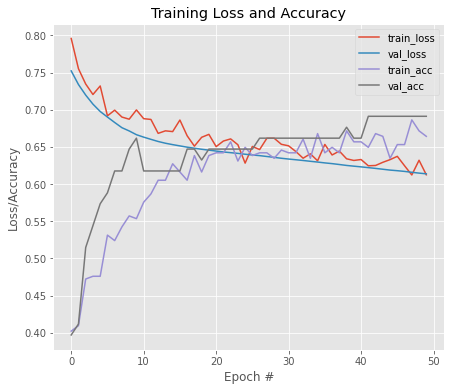


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:42
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5851 - accuracy: 0.7122
Epoch 1: val_loss improved from inf to 0.58522, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 18s 720ms/step - loss: 0.5851 - accuracy: 0.7122 - val_loss: 0.5852 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5112 - accuracy: 0.7749
Epoch 2: val_loss improved from 0.58522 to 0.55694, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 6s 607ms/step - loss: 0.5112 - accuracy: 0.7749 - val_loss: 0.5569 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4970 - accuracy: 0.7749
Epoch 3: val_loss improved from 0.55694 to 0.52976, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 6s 612ms/step - loss: 0.4970 - accuracy: 0.7749 - val_loss: 0.5298 - val_accur

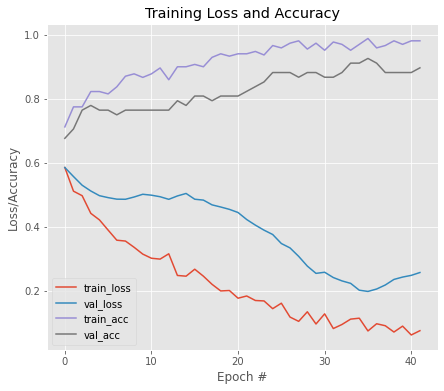


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:36
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0757 - accuracy: 0.9705
Epoch 1: val_loss improved from inf to 0.05210, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 17s 774ms/step - loss: 0.0757 - accuracy: 0.9705 - val_loss: 0.0521 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0902 - accuracy: 0.9668
Epoch 2: val_loss improved from 0.05210 to 0.03627, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 6s 606ms/step - loss: 0.0902 - accuracy: 0.9668 - val_loss: 0.0363 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0705 - accuracy: 0.9779
Epoch 3: val_loss improved from 0.03627 to 0.03533, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 6s 615ms/step - loss: 0.0705 - accuracy: 0.9779 - val_loss: 0.

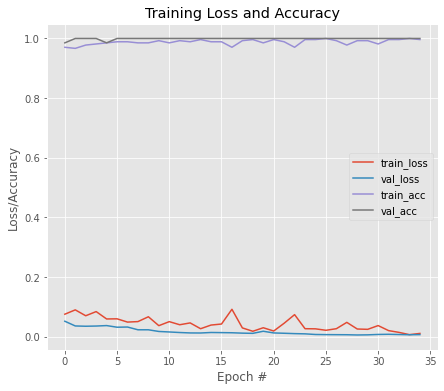


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0154 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 0.02011, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 16s 742ms/step - loss: 0.0154 - accuracy: 0.9926 - val_loss: 0.0201 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0259 - accuracy: 0.9889
Epoch 2: val_loss improved from 0.02011 to 0.01904, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 6s 605ms/step - loss: 0.0259 - accuracy: 0.9889 - val_loss: 0.0190 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0189 - accuracy: 0.9963
Epoch 3: val_loss improved from 0.01904 to 0.01389, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 6s 624ms/step - loss: 0.0189 - accuracy: 0.9963 - val_loss: 0.0139 - val_accuracy: 1.0000
Epoc

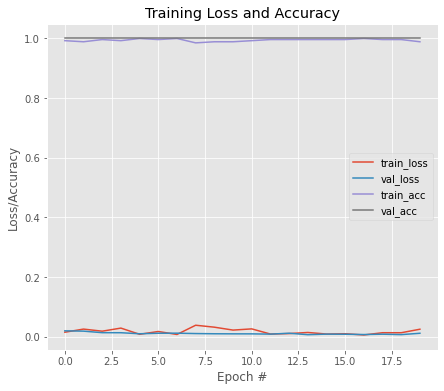


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0234 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.00956, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 16s 783ms/step - loss: 0.0234 - accuracy: 0.9852 - val_loss: 0.0096 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0202 - accuracy: 0.9852
Epoch 2: val_loss did not improve from 0.00956
9/9 [==============================] - 5s 515ms/step - loss: 0.0202 - accuracy: 0.9852 - val_loss: 0.0149 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0226 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 0.00956
9/9 [==============================] - 5s 517ms/step - loss: 0.0226 - accuracy: 0.9926 - val_loss: 0.0156 - val_accuracy: 0.9853
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0238

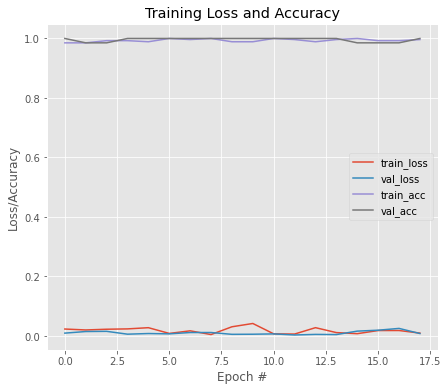


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00388, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 17s 743ms/step - loss: 0.0073 - accuracy: 1.0000 - val_loss: 0.0039 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0122 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.00388 to 0.00260, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 6s 612ms/step - loss: 0.0122 - accuracy: 0.9963 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0164 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.00260
9/9 [==============================] - 5s 512ms/step - loss: 0.0164 - accuracy: 0.9963 - val_loss: 0.0038 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================

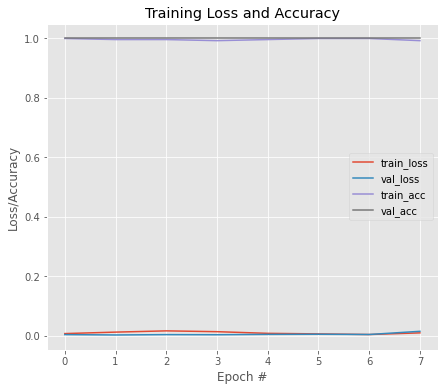


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00452, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 17s 739ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0113 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00452 to 0.00315, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 6s 607ms/step - loss: 0.0113 - accuracy: 1.0000 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0264 - accuracy: 0.9926
Epoch 3: val_loss improved from 0.00315 to 0.00257, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 6s 655ms/step - loss: 0.0264 - accuracy: 0.9926 - val_loss: 0.0026 - val_accur

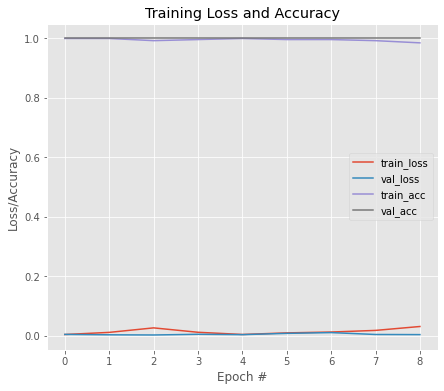


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0154 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 0.01659, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 16s 731ms/step - loss: 0.0154 - accuracy: 0.9926 - val_loss: 0.0166 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.01659 to 0.00317, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 6s 603ms/step - loss: 0.0109 - accuracy: 0.9963 - val_loss: 0.0032 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00317 to 0.00308, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 6s 653ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoc

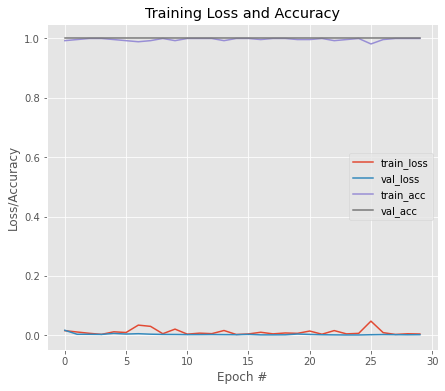


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0042 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.02061, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 17s 848ms/step - loss: 0.0042 - accuracy: 1.0000 - val_loss: 0.0206 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0060 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.02061 to 0.00929, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 6s 612ms/step - loss: 0.0060 - accuracy: 1.0000 - val_loss: 0.0093 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0120 - accuracy: 0.9963
Epoch 3: val_loss improved from 0.00929 to 0.00302, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 6s 607ms/step - loss: 0.0120 - accuracy: 0.9963 - val_loss: 0.0030 - val_accur

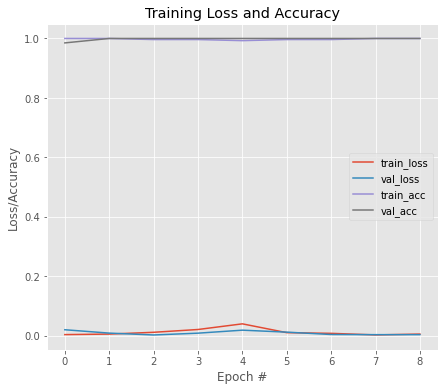


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0090 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.00251, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 16s 739ms/step - loss: 0.0090 - accuracy: 0.9963 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0220 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.00251
9/9 [==============================] - 5s 519ms/step - loss: 0.0220 - accuracy: 0.9926 - val_loss: 0.0057 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0066 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.00251
9/9 [==============================] - 5s 512ms/step - loss: 0.0066 - accuracy: 0.9963 - val_loss: 0.0063 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0

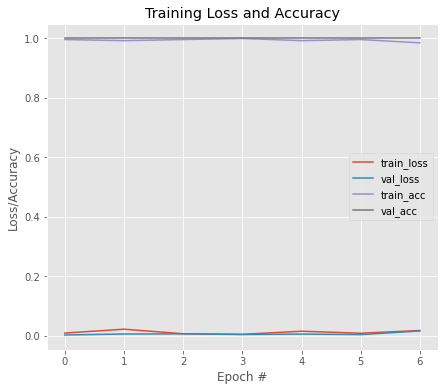


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9852941155433654
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0063 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.36100, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 11s 719ms/step - loss: 0.0063 - accuracy: 1.0000 - val_loss: 0.3610 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0182 - accuracy: 0.9912
Epoch 2: val_loss improved from 0.36100 to 0.36054, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 6s 576ms/step - loss: 0.0182 - accuracy: 0.9912 - val_loss: 0.3605 - val_accuracy: 0.9041
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.36054
11/11 [==============================] - 6s 529ms/step 

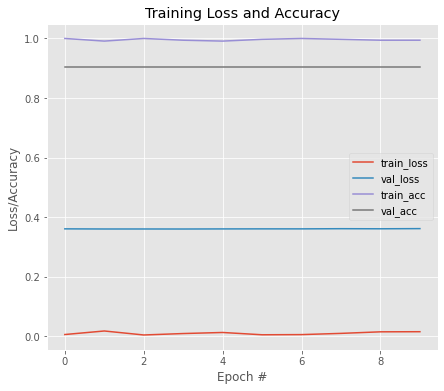


Model Performance Summary:

Best Validation accuracy:0.9041095972061157 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0556 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.44678, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 18s 749ms/step - loss: 0.0556 - accuracy: 0.9853 - val_loss: 0.4468 - val_accuracy: 0.8904
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0354 - accuracy: 0.9853
Epoch 2: val_loss improved from 0.44678 to 0.44099, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 7s 616ms/step - loss: 0.0354 - accuracy: 0.9853 - val_loss: 0.4410 - val_accuracy: 0.8904
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0223 - accuracy: 0.9971
Epoch 3: val_loss improved from 0.44099 to 0.42971, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 7s 618ms/step - loss: 0

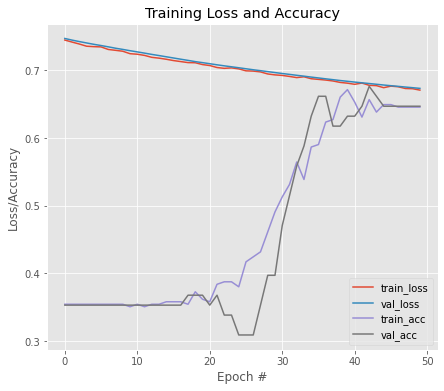


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:43
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6374 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.61961, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 7s 557ms/step - loss: 0.6374 - accuracy: 0.6494 - val_loss: 0.6196 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6158 - accuracy: 0.6716
Epoch 2: val_loss improved from 0.61961 to 0.59850, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 5s 546ms/step - loss: 0.6158 - accuracy: 0.6716 - val_loss: 0.5985 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6104 - accuracy: 0.7011
Epoch 3: val_loss improved from 0.59850 to 0.57361, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 5s 549ms/step - loss: 0.6104 - accuracy: 0.7011 - val_loss: 0.5736 - val_accuracy: 0.7500
Epoch 4

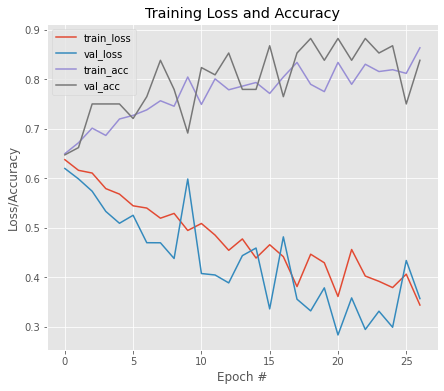


Model Performance Summary:

Best Validation accuracy:0.8823529481887817 at EPOCH:19
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5159 - accuracy: 0.7306
Epoch 1: val_loss improved from inf to 0.22568, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 6s 561ms/step - loss: 0.5159 - accuracy: 0.7306 - val_loss: 0.2257 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3409 - accuracy: 0.8266
Epoch 2: val_loss did not improve from 0.22568
9/9 [==============================] - 5s 504ms/step - loss: 0.3409 - accuracy: 0.8266 - val_loss: 0.2381 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3861 - accuracy: 0.8303
Epoch 3: val_loss did not improve from 0.22568
9/9 [==============================] - 5s 503ms/step - loss: 0.3861 - accuracy: 0.8303 - val_loss: 0.4827 - val_accuracy: 0.6912
Epoch 4/50
9/9 [==============================] - ETA: 0s - los

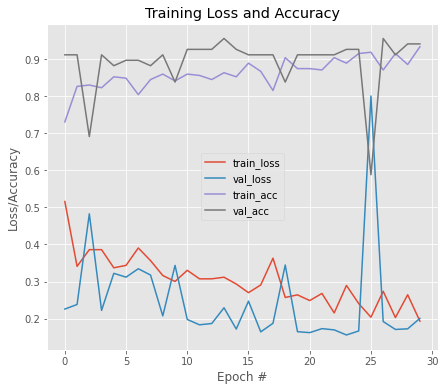


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:14
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4478 - accuracy: 0.8598
Epoch 1: val_loss improved from inf to 0.14661, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 6s 548ms/step - loss: 0.4478 - accuracy: 0.8598 - val_loss: 0.1466 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2031 - accuracy: 0.9262
Epoch 2: val_loss did not improve from 0.14661
9/9 [==============================] - 5s 502ms/step - loss: 0.2031 - accuracy: 0.9262 - val_loss: 0.2315 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2077 - accuracy: 0.9114
Epoch 3: val_loss did not improve from 0.14661
9/9 [==============================] - 5s 557ms/step - loss: 0.2077 - accuracy: 0.9114 - val_loss: 0.1676 - val_accuracy: 0.9265
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1958 - accu

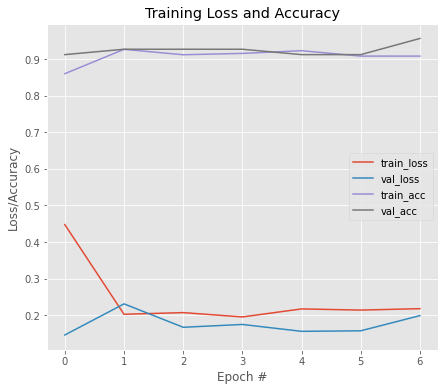


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:7
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3736 - accuracy: 0.9004
Epoch 1: val_loss improved from inf to 0.19230, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 7s 570ms/step - loss: 0.3736 - accuracy: 0.9004 - val_loss: 0.1923 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1681 - accuracy: 0.9225
Epoch 2: val_loss did not improve from 0.19230
9/9 [==============================] - 5s 519ms/step - loss: 0.1681 - accuracy: 0.9225 - val_loss: 0.1970 - val_accuracy: 0.8971
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1715 - accuracy: 0.9262
Epoch 3: val_loss did not improve from 0.19230
9/9 [==============================] - 5s 514ms/step - loss: 0.1715 - accuracy: 0.9262 - val_loss: 0.2734 - val_accuracy: 0.8971
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

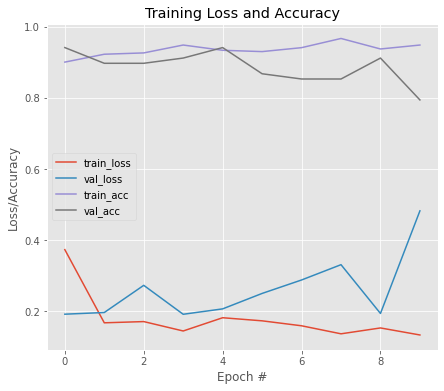


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3247 - accuracy: 0.8708
Epoch 1: val_loss improved from inf to 0.28266, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 7s 564ms/step - loss: 0.3247 - accuracy: 0.8708 - val_loss: 0.2827 - val_accuracy: 0.8971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1484 - accuracy: 0.9446
Epoch 2: val_loss improved from 0.28266 to 0.26596, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 5s 553ms/step - loss: 0.1484 - accuracy: 0.9446 - val_loss: 0.2660 - val_accuracy: 0.8676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1990 - accuracy: 0.9114
Epoch 3: val_loss improved from 0.26596 to 0.21214, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 5s 548ms/step - loss: 0.1990 - accuracy: 0.9114 - val_loss: 0.2121 - val_accuracy: 0.8971
Epoch 4/

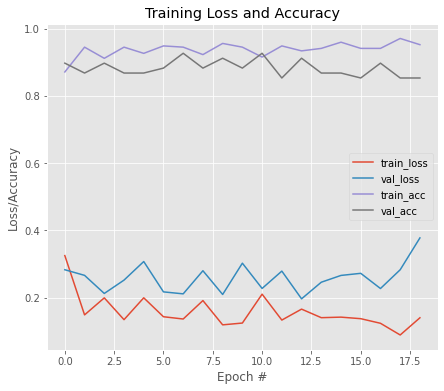


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:7
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2361 - accuracy: 0.9041
Epoch 1: val_loss improved from inf to 0.10222, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 6s 560ms/step - loss: 0.2361 - accuracy: 0.9041 - val_loss: 0.1022 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1373 - accuracy: 0.9483
Epoch 2: val_loss did not improve from 0.10222
9/9 [==============================] - 5s 509ms/step - loss: 0.1373 - accuracy: 0.9483 - val_loss: 0.1456 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1274 - accuracy: 0.9594
Epoch 3: val_loss did not improve from 0.10222
9/9 [==============================] - 5s 516ms/step - loss: 0.1274 - accuracy: 0.9594 - val_loss: 0.2099 - val_accuracy: 0.8971
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

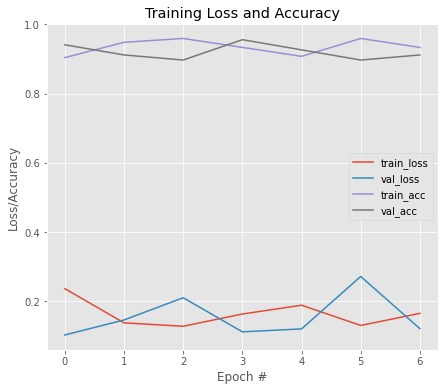


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2804 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 0.12521, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 7s 571ms/step - loss: 0.2804 - accuracy: 0.8967 - val_loss: 0.1252 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1095 - accuracy: 0.9594
Epoch 2: val_loss improved from 0.12521 to 0.12345, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 5s 555ms/step - loss: 0.1095 - accuracy: 0.9594 - val_loss: 0.1235 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1553 - accuracy: 0.9446
Epoch 3: val_loss did not improve from 0.12345
9/9 [==============================] - 5s 516ms/step - loss: 0.1553 - accuracy: 0.9446 - val_loss: 0.1296 - val_accuracy: 0.9118
Epoch 4/50
9/9 [============================

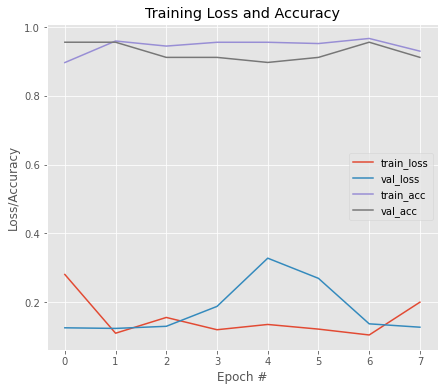


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3449 - accuracy: 0.8750
Epoch 1: val_loss improved from inf to 0.06631, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 7s 677ms/step - loss: 0.3449 - accuracy: 0.8750 - val_loss: 0.0663 - val_accuracy: 0.9701
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1168 - accuracy: 0.9596
Epoch 2: val_loss improved from 0.06631 to 0.04288, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 5s 543ms/step - loss: 0.1168 - accuracy: 0.9596 - val_loss: 0.0429 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0998 - accuracy: 0.9596
Epoch 3: val_loss did not improve from 0.04288
9/9 [==============================] - 5s 514ms/step - loss: 0.0998 - accuracy: 0.9596 - val_loss: 0.1005 - val_accuracy: 0.9552
Epoch 4/50
9/9 [============

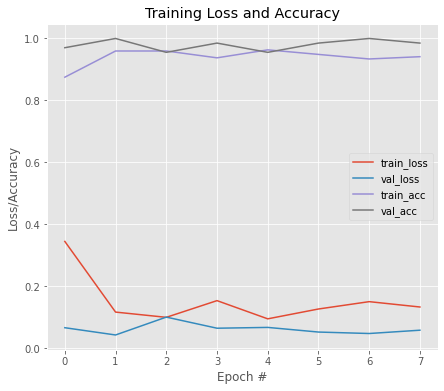


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3934 - accuracy: 0.9007
Epoch 1: val_loss improved from inf to 0.05078, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 6s 557ms/step - loss: 0.3934 - accuracy: 0.9007 - val_loss: 0.0508 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1147 - accuracy: 0.9485
Epoch 2: val_loss did not improve from 0.05078
9/9 [==============================] - 5s 504ms/step - loss: 0.1147 - accuracy: 0.9485 - val_loss: 0.0647 - val_accuracy: 0.9851
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1093 - accuracy: 0.9632
Epoch 3: val_loss did not improve from 0.05078
9/9 [==============================] - 5s 505ms/step - loss: 0.1093 - accuracy: 0.9632 - val_loss: 0.2121 - val_accuracy: 0.8955
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1359 - accuracy: 0.9338
Epo

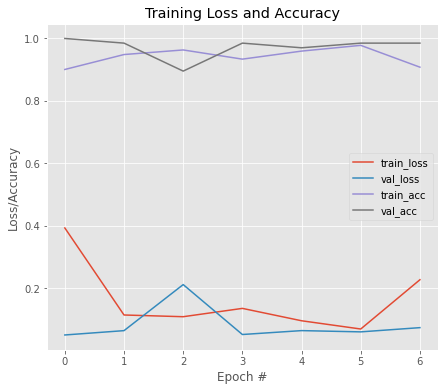


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9441176533699036
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0798 - accuracy: 0.9794
Epoch 1: val_loss improved from inf to 0.21250, saving model to vgg16_wt.hdf5
11/11 [==============================] - 7s 614ms/step - loss: 0.0798 - accuracy: 0.9794 - val_loss: 0.2125 - val_accuracy: 0.9110
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0909 - accuracy: 0.9735
Epoch 2: val_loss did not improve from 0.21250
11/11 [==============================] - 6s 537ms/step - loss: 0.0909 - accuracy: 0.9735 - val_loss: 0.2127 - val_accuracy: 0.9110
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0907 - accuracy: 0.9735
Epoch 3: val_loss did not improve from 0.21250
11/11 [==============================] - 6s 526ms/step - loss: 0.0907 - accuracy: 0.9735 - val_loss: 0.

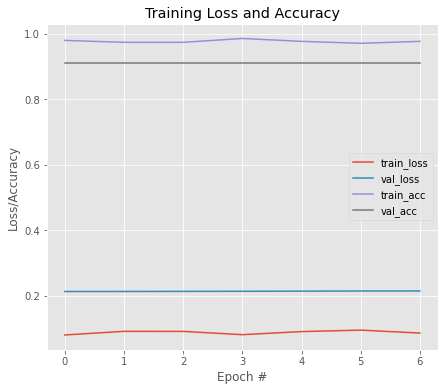


Model Performance Summary:

Best Validation accuracy:0.9109588861465454 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.9286 - accuracy: 0.8171
Epoch 1: val_loss improved from inf to 0.21423, saving model to vgg16_wt.hdf5
11/11 [==============================] - 8s 633ms/step - loss: 0.9286 - accuracy: 0.8171 - val_loss: 0.2142 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1189 - accuracy: 0.9676
Epoch 2: val_loss did not improve from 0.21423
11/11 [==============================] - 6s 549ms/step - loss: 0.1189 - accuracy: 0.9676 - val_loss: 0.8160 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2100 - accuracy: 0.9145
Epoch 3: val_loss did not improve from 0.21423
11/11 [==============================] - 6s 534ms/step - loss: 0.2100 - accuracy: 0.9145 - val_loss: 0.5954 - val_accuracy: 0.8151
Epoch 4/50
11/11 [====

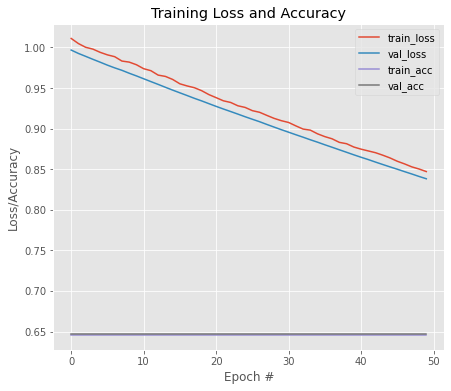


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6726 - accuracy: 0.6458
Epoch 1: val_loss improved from inf to 0.62062, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 7s 580ms/step - loss: 0.6726 - accuracy: 0.6458 - val_loss: 0.6206 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6257 - accuracy: 0.6568
Epoch 2: val_loss improved from 0.62062 to 0.61035, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 5s 572ms/step - loss: 0.6257 - accuracy: 0.6568 - val_loss: 0.6104 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6268 - accuracy: 0.6605
Epoch 3: val_loss improved from 0.61035 to 0.60491, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 5s 557ms/step - loss: 0.6268 - accuracy: 0.6605 - val_loss: 0.6049 - val_accuracy: 0.7647
Epoch 4/

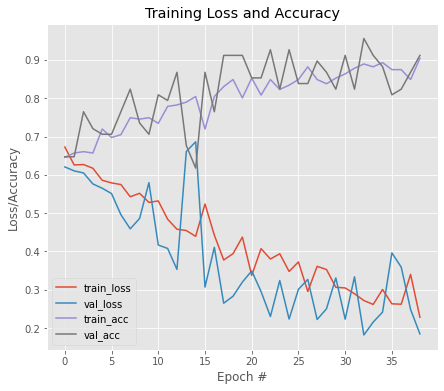


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:33
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4770 - accuracy: 0.8155
Epoch 1: val_loss improved from inf to 0.22012, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 7s 581ms/step - loss: 0.4770 - accuracy: 0.8155 - val_loss: 0.2201 - val_accuracy: 0.9265
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2831 - accuracy: 0.8487
Epoch 2: val_loss improved from 0.22012 to 0.10372, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 5s 621ms/step - loss: 0.2831 - accuracy: 0.8487 - val_loss: 0.1037 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2913 - accuracy: 0.8893
Epoch 3: val_loss did not improve from 0.10372
9/9 [==============================] - 5s 537ms/step - loss: 0.2913 - accuracy: 0.8893 - val_loss: 0.1167 - val_accuracy: 0.9853
Epoch 4/50
9/9 [===========

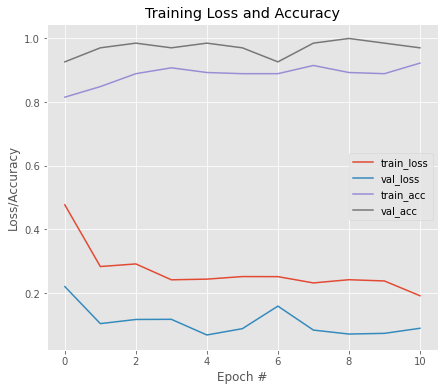


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:9
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4928 - accuracy: 0.8524
Epoch 1: val_loss improved from inf to 0.07362, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 7s 575ms/step - loss: 0.4928 - accuracy: 0.8524 - val_loss: 0.0736 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2360 - accuracy: 0.9004
Epoch 2: val_loss did not improve from 0.07362
9/9 [==============================] - 5s 517ms/step - loss: 0.2360 - accuracy: 0.9004 - val_loss: 0.0856 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2163 - accuracy: 0.9077
Epoch 3: val_loss improved from 0.07362 to 0.06568, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 5s 564ms/step - loss: 0.2163 - accuracy: 0.9077 - val_loss: 0.0657 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s -

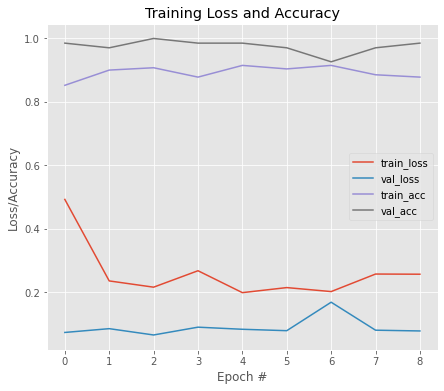


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3413 - accuracy: 0.8930
Epoch 1: val_loss improved from inf to 0.20785, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 7s 630ms/step - loss: 0.3413 - accuracy: 0.8930 - val_loss: 0.2078 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1343 - accuracy: 0.9557
Epoch 2: val_loss did not improve from 0.20785
9/9 [==============================] - 5s 522ms/step - loss: 0.1343 - accuracy: 0.9557 - val_loss: 0.3032 - val_accuracy: 0.8529
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1848 - accuracy: 0.9151
Epoch 3: val_loss improved from 0.20785 to 0.18581, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 5s 570ms/step - loss: 0.1848 - accuracy: 0.9151 - val_loss: 0.1858 - val_accuracy: 0.9118
Epoch 4/50
9/9 [===========================

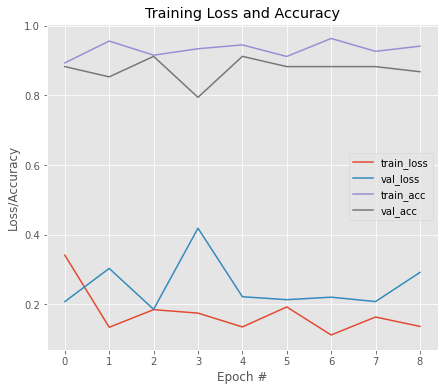


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3874 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 0.21777, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 7s 581ms/step - loss: 0.3874 - accuracy: 0.8967 - val_loss: 0.2178 - val_accuracy: 0.8971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1221 - accuracy: 0.9631
Epoch 2: val_loss improved from 0.21777 to 0.21275, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 5s 559ms/step - loss: 0.1221 - accuracy: 0.9631 - val_loss: 0.2127 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1815 - accuracy: 0.9373
Epoch 3: val_loss did not improve from 0.21275
9/9 [==============================] - 5s 520ms/step - loss: 0.1815 - accuracy: 0.9373 - val_loss: 0.6282 - val_accuracy: 0.7794
Epoch 4/50
9/9 [============================

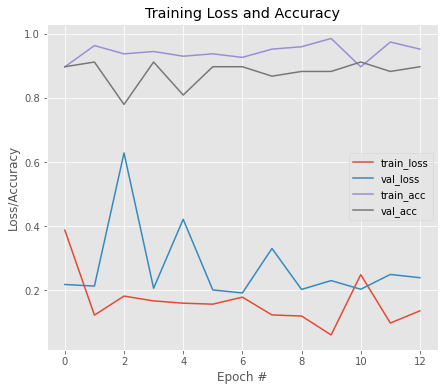


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:2
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8162 - accuracy: 0.9041
Epoch 1: val_loss improved from inf to 0.09427, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 7s 586ms/step - loss: 0.8162 - accuracy: 0.9041 - val_loss: 0.0943 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1320 - accuracy: 0.9446
Epoch 2: val_loss did not improve from 0.09427
9/9 [==============================] - 5s 515ms/step - loss: 0.1320 - accuracy: 0.9446 - val_loss: 0.1539 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1604 - accuracy: 0.9299
Epoch 3: val_loss did not improve from 0.09427
9/9 [==============================] - 5s 534ms/step - loss: 0.1604 - accuracy: 0.9299 - val_loss: 0.1202 - val_accuracy: 0.9412
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

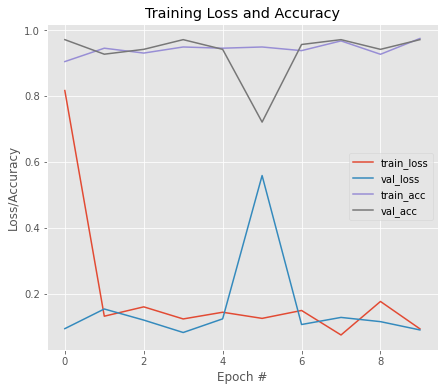


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2648 - accuracy: 0.9188
Epoch 1: val_loss improved from inf to 0.11948, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 7s 581ms/step - loss: 0.2648 - accuracy: 0.9188 - val_loss: 0.1195 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1489 - accuracy: 0.9446
Epoch 2: val_loss improved from 0.11948 to 0.10624, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 5s 565ms/step - loss: 0.1489 - accuracy: 0.9446 - val_loss: 0.1062 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1130 - accuracy: 0.9520
Epoch 3: val_loss improved from 0.10624 to 0.08859, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 5s 575ms/step - loss: 0.1130 - accuracy: 0.9520 - val_loss: 0.0886 - val_accuracy: 0.9412
Epoch 4/5

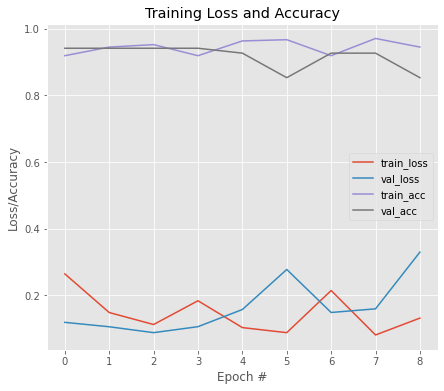


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2154 - accuracy: 0.9265
Epoch 1: val_loss improved from inf to 0.04701, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 7s 586ms/step - loss: 0.2154 - accuracy: 0.9265 - val_loss: 0.0470 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1028 - accuracy: 0.9596
Epoch 2: val_loss did not improve from 0.04701
9/9 [==============================] - 5s 519ms/step - loss: 0.1028 - accuracy: 0.9596 - val_loss: 0.1562 - val_accuracy: 0.9254
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1362 - accuracy: 0.9449
Epoch 3: val_loss improved from 0.04701 to 0.03648, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 5s 563ms/step - loss: 0.1362 - accuracy: 0.9449 - val_loss: 0.0365 - val_accuracy: 1.0000
Epoch 4/50
9/9 [============

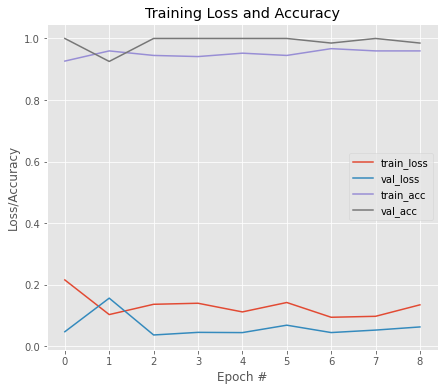


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3848 - accuracy: 0.8897
Epoch 1: val_loss improved from inf to 0.04842, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 7s 583ms/step - loss: 0.3848 - accuracy: 0.8897 - val_loss: 0.0484 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0902 - accuracy: 0.9669
Epoch 2: val_loss did not improve from 0.04842
9/9 [==============================] - 5s 518ms/step - loss: 0.0902 - accuracy: 0.9669 - val_loss: 0.0582 - val_accuracy: 0.9851
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1158 - accuracy: 0.9485
Epoch 3: val_loss did not improve from 0.04842
9/9 [==============================] - 5s 522ms/step - loss: 0.1158 - accuracy: 0.9485 - val_loss: 0.0494 - val_accuracy: 0.9851
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1232 - accuracy: 0.9228
Epo

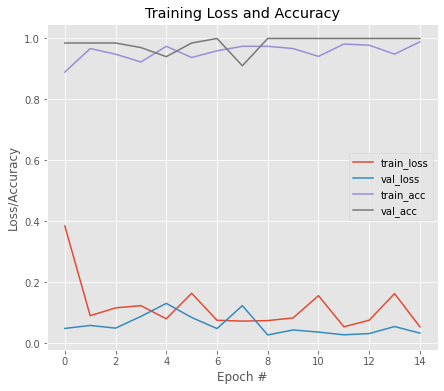


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:7
Average Accuracy:0.9617647051811218
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1576 - accuracy: 0.9351
Epoch 1: val_loss improved from inf to 0.23306, saving model to vgg19_wt.hdf5
11/11 [==============================] - 7s 589ms/step - loss: 0.1576 - accuracy: 0.9351 - val_loss: 0.2331 - val_accuracy: 0.9178
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1460 - accuracy: 0.9499
Epoch 2: val_loss improved from 0.23306 to 0.23220, saving model to vgg19_wt.hdf5
11/11 [==============================] - 6s 554ms/step - loss: 0.1460 - accuracy: 0.9499 - val_loss: 0.2322 - val_accuracy: 0.9178
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1552 - accuracy: 0.9410
Epoch 3: val_loss improved from 0.23220 to 0.23194, saving model to vgg19_wt.hdf5
11/11 [==========================

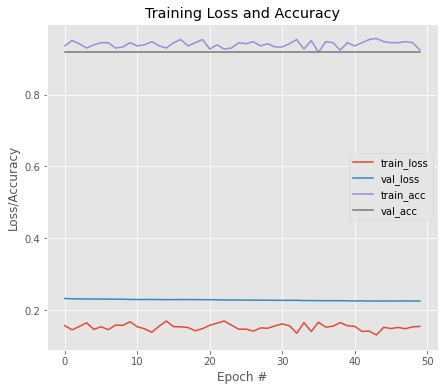


Model Performance Summary:

Best Validation accuracy:0.9178082346916199 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.9135 - accuracy: 0.7109
Epoch 1: val_loss improved from inf to 0.42689, saving model to vgg19_wt.hdf5
11/11 [==============================] - 8s 613ms/step - loss: 0.9135 - accuracy: 0.7109 - val_loss: 0.4269 - val_accuracy: 0.7466
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.4008 - accuracy: 0.8083
Epoch 2: val_loss improved from 0.42689 to 0.25516, saving model to vgg19_wt.hdf5
11/11 [==============================] - 7s 584ms/step - loss: 0.4008 - accuracy: 0.8083 - val_loss: 0.2552 - val_accuracy: 0.9110
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.3574 - accuracy: 0.8142
Epoch 3: val_loss improved from 0.25516 to 0.25052, saving model to vgg19_wt.hdf5
11/11 [==============================] - 7s 590ms/step - loss: 0.3574 - accuracy: 0

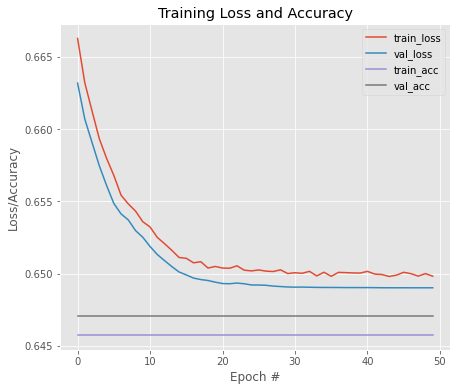


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6754 - accuracy: 0.6052
Epoch 1: val_loss improved from inf to 0.65127, saving model to resnet50_b_0.hdf5
9/9 [==============================] - 16s 677ms/step - loss: 0.6754 - accuracy: 0.6052 - val_loss: 0.6513 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5490 - accuracy: 0.7380
Epoch 2: val_loss did not improve from 0.65127
9/9 [==============================] - 5s 521ms/step - loss: 0.5490 - accuracy: 0.7380 - val_loss: 0.6734 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4809 - accuracy: 0.7749
Epoch 3: val_loss did not improve from 0.65127
9/9 [==============================] - 5s 506ms/step - loss: 0.4809 - accuracy: 0.7749 - val_loss: 0.6838 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.4336 - a

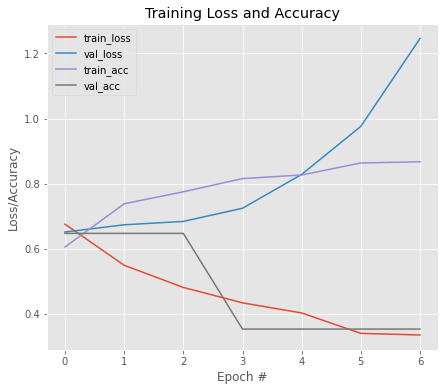


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3314 - accuracy: 0.8782
Epoch 1: val_loss improved from inf to 1.89903, saving model to resnet50_a_1.hdf5
9/9 [==============================] - 16s 695ms/step - loss: 0.3314 - accuracy: 0.8782 - val_loss: 1.8990 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2823 - accuracy: 0.8856
Epoch 2: val_loss did not improve from 1.89903
9/9 [==============================] - 5s 512ms/step - loss: 0.2823 - accuracy: 0.8856 - val_loss: 2.8293 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2609 - accuracy: 0.8930
Epoch 3: val_loss did not improve from 1.89903
9/9 [==============================] - 5s 512ms/step - loss: 0.2609 - accuracy: 0.8930 - val_loss: 3.5737 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

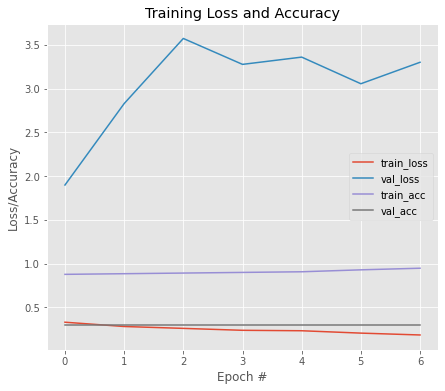


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2749 - accuracy: 0.9004
Epoch 1: val_loss improved from inf to 2.30284, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 16s 693ms/step - loss: 0.2749 - accuracy: 0.9004 - val_loss: 2.3028 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2208 - accuracy: 0.9225
Epoch 2: val_loss improved from 2.30284 to 1.91823, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 5s 602ms/step - loss: 0.2208 - accuracy: 0.9225 - val_loss: 1.9182 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2406 - accuracy: 0.9004
Epoch 3: val_loss did not improve from 1.91823
9/9 [==============================] - 5s 519ms/step - loss: 0.2406 - accuracy: 0.9004 - val_loss: 2.4626 - val_accuracy: 0.2941
Epoch 4/50
9/9 [====================

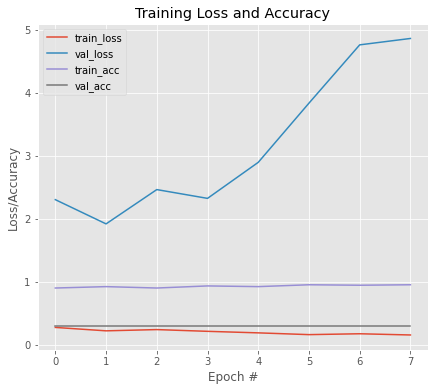


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1485 - accuracy: 0.9483
Epoch 1: val_loss improved from inf to 5.66271, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 16s 698ms/step - loss: 0.1485 - accuracy: 0.9483 - val_loss: 5.6627 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1326 - accuracy: 0.9557
Epoch 2: val_loss did not improve from 5.66271
9/9 [==============================] - 5s 502ms/step - loss: 0.1326 - accuracy: 0.9557 - val_loss: 6.1346 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0981 - accuracy: 0.9705
Epoch 3: val_loss improved from 5.66271 to 4.97888, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 6s 599ms/step - loss: 0.0981 - accuracy: 0.9705 - val_loss: 4.9789 - val_accuracy: 0.3824
Epoch 4/50
9/9 [====

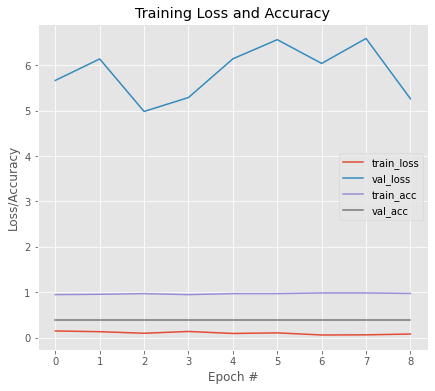


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1125 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 4.66664, saving model to resnet50_b_2.hdf5
9/9 [==============================] - 15s 689ms/step - loss: 0.1125 - accuracy: 0.9742 - val_loss: 4.6666 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1018 - accuracy: 0.9631
Epoch 2: val_loss did not improve from 4.66664
9/9 [==============================] - 5s 569ms/step - loss: 0.1018 - accuracy: 0.9631 - val_loss: 5.6034 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0748 - accuracy: 0.9779
Epoch 3: val_loss did not improve from 4.66664
9/9 [==============================] - 5s 519ms/step - loss: 0.0748 - accuracy: 0.9779 - val_loss: 6.1498 - val_accuracy: 0.3824
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0785 - 

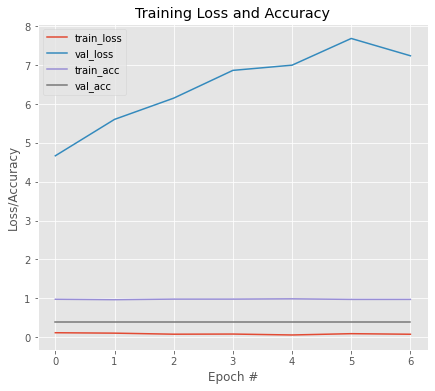


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1104 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 6.03537, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 16s 708ms/step - loss: 0.1104 - accuracy: 0.9594 - val_loss: 6.0354 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0898 - accuracy: 0.9705
Epoch 2: val_loss did not improve from 6.03537
9/9 [==============================] - 5s 511ms/step - loss: 0.0898 - accuracy: 0.9705 - val_loss: 6.2399 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0656 - accuracy: 0.9668
Epoch 3: val_loss did not improve from 6.03537
9/9 [==============================] - 5s 561ms/step - loss: 0.0656 - accuracy: 0.9668 - val_loss: 6.4096 - val_accuracy: 0.3676
Epoch 4/50
9/9 [==============================] - ETA: 0s -

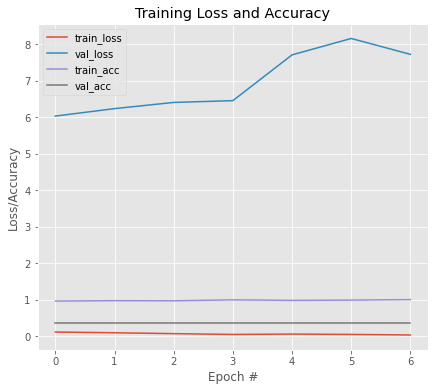


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0720 - accuracy: 0.9668
Epoch 1: val_loss improved from inf to 5.78061, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 15s 690ms/step - loss: 0.0720 - accuracy: 0.9668 - val_loss: 5.7806 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0916 - accuracy: 0.9705
Epoch 2: val_loss improved from 5.78061 to 4.19809, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 6s 604ms/step - loss: 0.0916 - accuracy: 0.9705 - val_loss: 4.1981 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0624 - accuracy: 0.9815
Epoch 3: val_loss did not improve from 4.19809
9/9 [==============================] - 5s 511ms/step - loss: 0.0624 - accuracy: 0.9815 - val_loss: 4.5388 - val_accuracy: 0.3676
Epoch 4/50
9/9 [====================

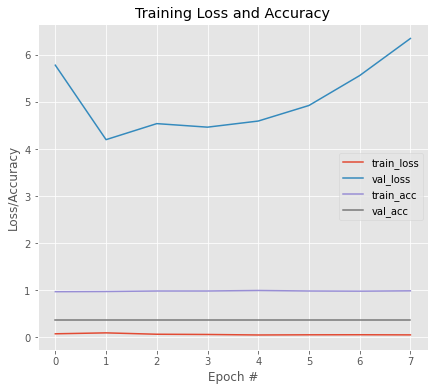


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0889 - accuracy: 0.9743
Epoch 1: val_loss improved from inf to 6.78321, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 16s 709ms/step - loss: 0.0889 - accuracy: 0.9743 - val_loss: 6.7832 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0507 - accuracy: 0.9816
Epoch 2: val_loss did not improve from 6.78321
9/9 [==============================] - 5s 512ms/step - loss: 0.0507 - accuracy: 0.9816 - val_loss: 7.4300 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0244 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 6.78321
9/9 [==============================] - 5s 515ms/step - loss: 0.0244 - accuracy: 0.9926 - val_loss: 7.0186 - val_accuracy: 0.3731
Epoch 4/50
9/9 [==============================] - ETA: 0s -

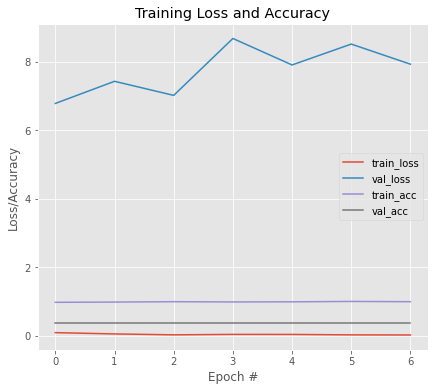


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0234 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 7.99989, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 16s 704ms/step - loss: 0.0234 - accuracy: 1.0000 - val_loss: 7.9999 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0453 - accuracy: 0.9816
Epoch 2: val_loss improved from 7.99989 to 6.64969, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 6s 606ms/step - loss: 0.0453 - accuracy: 0.9816 - val_loss: 6.6497 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0482 - accuracy: 0.9853
Epoch 3: val_loss improved from 6.64969 to 6.33918, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 6s 648ms/step - loss: 0.0482 - accuracy: 0.9853 - val_loss: 6.3392 - val_accuracy: 0.373

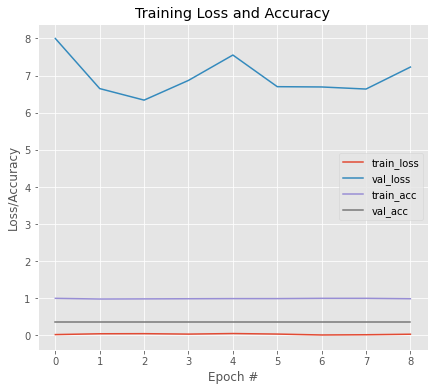


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Average Accuracy:0.41286216378211976
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.6518 - accuracy: 0.6460
Epoch 1: val_loss improved from inf to 0.65196, saving model to resnet50_wt.hdf5
11/11 [==============================] - 10s 673ms/step - loss: 0.6518 - accuracy: 0.6460 - val_loss: 0.6520 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.6513 - accuracy: 0.6460
Epoch 2: val_loss improved from 0.65196 to 0.65148, saving model to resnet50_wt.hdf5
11/11 [==============================] - 6s 572ms/step - loss: 0.6513 - accuracy: 0.6460 - val_loss: 0.6515 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.6507 - accuracy: 0.6460
Epoch 3: val_loss improved from 0.65148 to 0.65125, saving model to resnet50_wt.hdf5
11/11 [

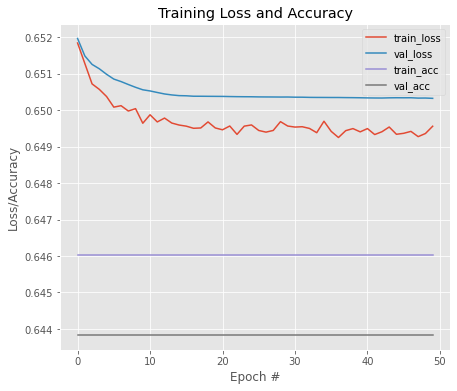


Model Performance Summary:

Best Validation accuracy:0.6438356041908264 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.4698 - accuracy: 0.8024
Epoch 1: val_loss improved from inf to 0.65161, saving model to resnet50_wt.hdf5
11/11 [==============================] - 17s 693ms/step - loss: 0.4698 - accuracy: 0.8024 - val_loss: 0.6516 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.3458 - accuracy: 0.8643
Epoch 2: val_loss did not improve from 0.65161
11/11 [==============================] - 6s 543ms/step - loss: 0.3458 - accuracy: 0.8643 - val_loss: 0.6521 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2921 - accuracy: 0.8879
Epoch 3: val_loss did not improve from 0.65161
11/11 [==============================] - 6s 531ms/step - loss: 0.2921 - accuracy: 0.8879 - val_loss: 0.6653 - val_accuracy: 0.6438
Epoch 4/50
11/11 [

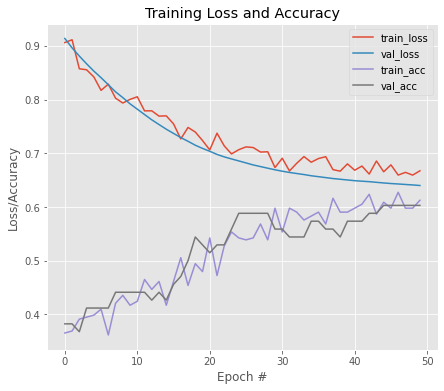


Model Performance Summary:

Best Validation accuracy:0.6029411554336548 at EPOCH:45
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8743 - accuracy: 0.6421
Epoch 1: val_loss improved from inf to 0.61052, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 26s 789ms/step - loss: 0.8743 - accuracy: 0.6421 - val_loss: 0.6105 - val_accuracy: 0.6324
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.7155 - accuracy: 0.6753
Epoch 2: val_loss improved from 0.61052 to 0.59867, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 6s 625ms/step - loss: 0.7155 - accuracy: 0.6753 - val_loss: 0.5987 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6867 - accuracy: 0.6790
Epoch 3: val_loss improved from 0.59867 to 0.59174, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 6s 619ms/step - loss: 0.6867 - accuracy: 0.6790 - val_loss: 0.5917 - val_accur

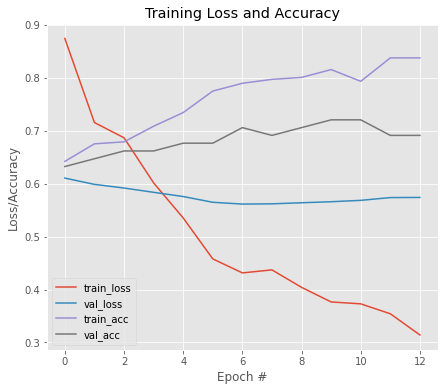


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:10
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3333 - accuracy: 0.8598
Epoch 1: val_loss improved from inf to 0.51210, saving model to DenseNet121_a_1.hdf5
9/9 [==============================] - 26s 810ms/step - loss: 0.3333 - accuracy: 0.8598 - val_loss: 0.5121 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3230 - accuracy: 0.8413
Epoch 2: val_loss did not improve from 0.51210
9/9 [==============================] - 5s 516ms/step - loss: 0.3230 - accuracy: 0.8413 - val_loss: 0.5190 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2825 - accuracy: 0.8635
Epoch 3: val_loss did not improve from 0.51210
9/9 [==============================] - 5s 509ms/step - loss: 0.2825 - accuracy: 0.8635 - val_loss: 0.5265 - val_accuracy: 0.7353
Epoch 4/50
9/9 [==============================] - ETA: 0s

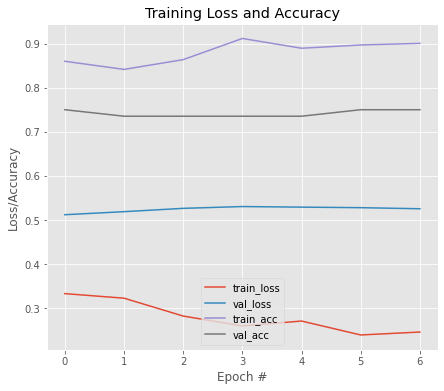


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3221 - accuracy: 0.8561
Epoch 1: val_loss improved from inf to 0.50912, saving model to DenseNet121_b_1.hdf5
9/9 [==============================] - 25s 816ms/step - loss: 0.3221 - accuracy: 0.8561 - val_loss: 0.5091 - val_accuracy: 0.7647
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2839 - accuracy: 0.8745
Epoch 2: val_loss did not improve from 0.50912
9/9 [==============================] - 5s 570ms/step - loss: 0.2839 - accuracy: 0.8745 - val_loss: 0.5163 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2815 - accuracy: 0.8819
Epoch 3: val_loss did not improve from 0.50912
9/9 [==============================] - 5s 514ms/step - loss: 0.2815 - accuracy: 0.8819 - val_loss: 0.5195 - val_accuracy: 0.7353
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.2366 - accuracy: 0.

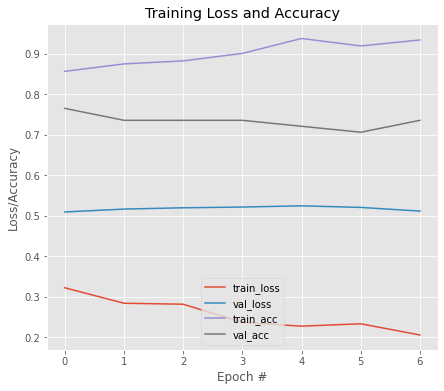


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2342 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 0.68853, saving model to DenseNet121_a_2.hdf5
9/9 [==============================] - 25s 819ms/step - loss: 0.2342 - accuracy: 0.8967 - val_loss: 0.6885 - val_accuracy: 0.6176
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1883 - accuracy: 0.9483
Epoch 2: val_loss did not improve from 0.68853
9/9 [==============================] - 5s 512ms/step - loss: 0.1883 - accuracy: 0.9483 - val_loss: 0.7167 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2097 - accuracy: 0.9114
Epoch 3: val_loss did not improve from 0.68853
9/9 [==============================] - 5s 508ms/step - loss: 0.2097 - accuracy: 0.9114 - val_loss: 0.7274 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s

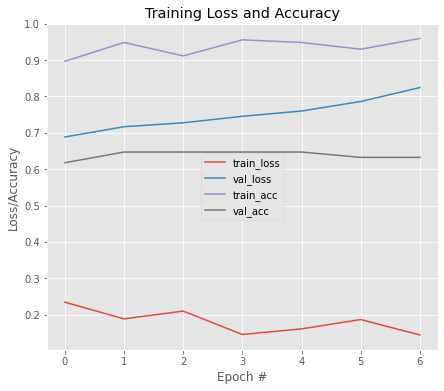


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1908 - accuracy: 0.9446
Epoch 1: val_loss improved from inf to 0.72806, saving model to DenseNet121_b_2.hdf5
9/9 [==============================] - 25s 824ms/step - loss: 0.1908 - accuracy: 0.9446 - val_loss: 0.7281 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1629 - accuracy: 0.9520
Epoch 2: val_loss did not improve from 0.72806
9/9 [==============================] - 5s 520ms/step - loss: 0.1629 - accuracy: 0.9520 - val_loss: 0.7385 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2004 - accuracy: 0.9151
Epoch 3: val_loss did not improve from 0.72806
9/9 [==============================] - 5s 531ms/step - loss: 0.2004 - accuracy: 0.9151 - val_loss: 0.7680 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1583 

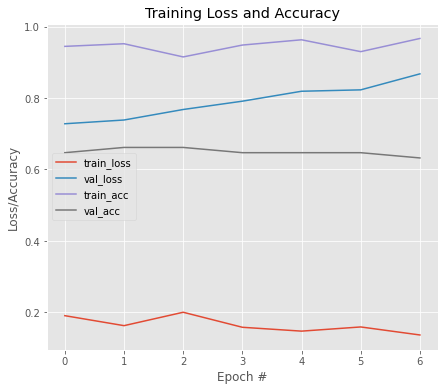


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:2
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1887 - accuracy: 0.9114
Epoch 1: val_loss improved from inf to 0.70123, saving model to DenseNet121_a_3.hdf5
9/9 [==============================] - 25s 818ms/step - loss: 0.1887 - accuracy: 0.9114 - val_loss: 0.7012 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1337 - accuracy: 0.9668
Epoch 2: val_loss did not improve from 0.70123
9/9 [==============================] - 5s 516ms/step - loss: 0.1337 - accuracy: 0.9668 - val_loss: 0.7108 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1369 - accuracy: 0.9410
Epoch 3: val_loss did not improve from 0.70123
9/9 [==============================] - 5s 516ms/step - loss: 0.1369 - accuracy: 0.9410 - val_loss: 0.7145 - val_accuracy: 0.7353
Epoch 4/50
9/9 [==============================] - ETA: 0s

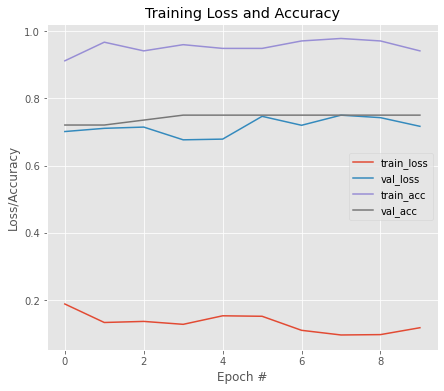


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1079 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.82735, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 25s 821ms/step - loss: 0.1079 - accuracy: 0.9631 - val_loss: 0.8274 - val_accuracy: 0.7353
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1438 - accuracy: 0.9520
Epoch 2: val_loss did not improve from 0.82735
9/9 [==============================] - 5s 512ms/step - loss: 0.1438 - accuracy: 0.9520 - val_loss: 0.8331 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1007 - accuracy: 0.9705
Epoch 3: val_loss improved from 0.82735 to 0.82036, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 6s 611ms/step - loss: 0.1007 - accuracy: 0.9705 - val_loss: 0.8204 - val_accuracy: 0.7500
Epoch 4/50
9/9 [=============================

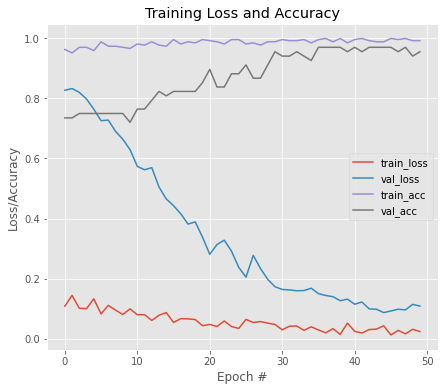


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:36
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0913 - accuracy: 0.9669
Epoch 1: val_loss improved from inf to 0.00539, saving model to DenseNet121_a_4.hdf5
9/9 [==============================] - 25s 900ms/step - loss: 0.0913 - accuracy: 0.9669 - val_loss: 0.0054 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0686 - accuracy: 0.9743
Epoch 2: val_loss did not improve from 0.00539
9/9 [==============================] - 5s 513ms/step - loss: 0.0686 - accuracy: 0.9743 - val_loss: 0.0109 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0472 - accuracy: 0.9890
Epoch 3: val_loss did not improve from 0.00539
9/9 [==============================] - 5s 554ms/step - loss: 0.0472 - accuracy: 0.9890 - val_loss: 0.0093 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s

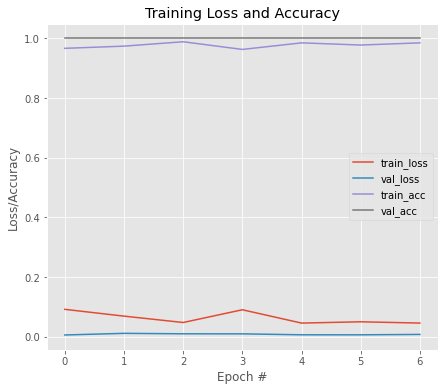


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0525 - accuracy: 0.9779
Epoch 1: val_loss improved from inf to 0.00777, saving model to DenseNet121_b_4.hdf5
9/9 [==============================] - 25s 835ms/step - loss: 0.0525 - accuracy: 0.9779 - val_loss: 0.0078 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0285 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.00777
9/9 [==============================] - 5s 523ms/step - loss: 0.0285 - accuracy: 0.9926 - val_loss: 0.0133 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0357 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 0.00777
9/9 [==============================] - 5s 520ms/step - loss: 0.0357 - accuracy: 0.9926 - val_loss: 0.0173 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0285 - accuracy: 0.9

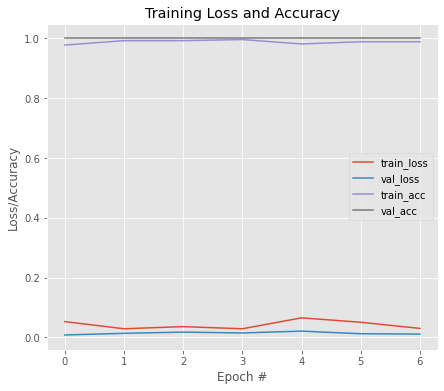


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8235293984413147
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0323 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.17427, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 14s 801ms/step - loss: 0.0323 - accuracy: 0.9971 - val_loss: 0.1743 - val_accuracy: 0.9384
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0412 - accuracy: 0.9853
Epoch 2: val_loss did not improve from 0.17427
11/11 [==============================] - 6s 532ms/step - loss: 0.0412 - accuracy: 0.9853 - val_loss: 0.1751 - val_accuracy: 0.9384
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0309 - accuracy: 0.9912
Epoch 3: val_loss did not improve from 0.17427
11/11 [==============================] - 6s 541ms/step - loss: 0.0309 - accuracy: 0.9912 - val_l

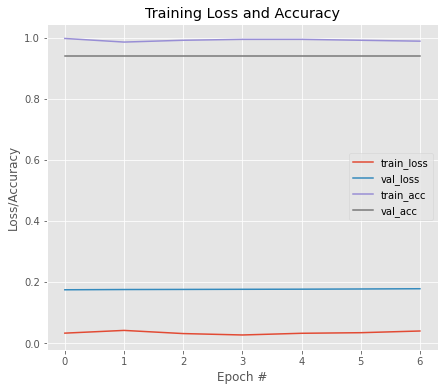


Model Performance Summary:

Best Validation accuracy:0.9383561611175537 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0456 - accuracy: 0.9823
Epoch 1: val_loss improved from inf to 0.22840, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 26s 792ms/step - loss: 0.0456 - accuracy: 0.9823 - val_loss: 0.2284 - val_accuracy: 0.9178
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0456 - accuracy: 0.9853
Epoch 2: val_loss improved from 0.22840 to 0.21768, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 7s 627ms/step - loss: 0.0456 - accuracy: 0.9853 - val_loss: 0.2177 - val_accuracy: 0.9178
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0333 - accuracy: 0.9912
Epoch 3: val_loss did not improve from 0.21768
11/11 [==============================] - 6s 537ms/step - loss: 0.0333 - accuracy: 0.9912 - val_loss: 0.23

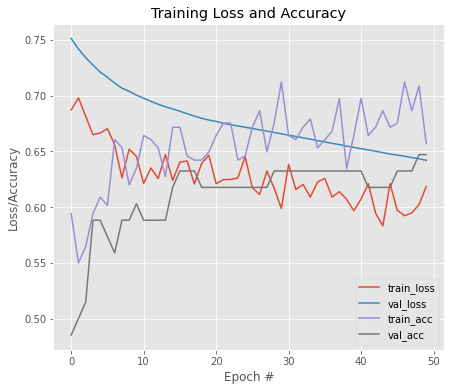


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6332 - accuracy: 0.6458
Epoch 1: val_loss improved from inf to 0.63091, saving model to MobileNet_b_0.hdf5
9/9 [==============================] - 9s 564ms/step - loss: 0.6332 - accuracy: 0.6458 - val_loss: 0.6309 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5919 - accuracy: 0.6863
Epoch 2: val_loss did not improve from 0.63091
9/9 [==============================] - 5s 496ms/step - loss: 0.5919 - accuracy: 0.6863 - val_loss: 0.7305 - val_accuracy: 0.5735
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6266 - accuracy: 0.6568
Epoch 3: val_loss did not improve from 0.63091
9/9 [==============================] - 5s 501ms/step - loss: 0.6266 - accuracy: 0.6568 - val_loss: 0.7515 - val_accuracy: 0.5441
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.4976 - 

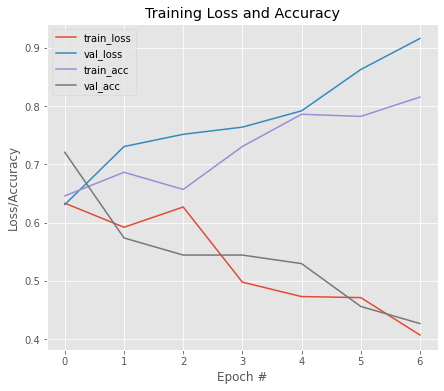


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4444 - accuracy: 0.7860
Epoch 1: val_loss improved from inf to 0.87013, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 9s 586ms/step - loss: 0.4444 - accuracy: 0.7860 - val_loss: 0.8701 - val_accuracy: 0.4118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4477 - accuracy: 0.7934
Epoch 2: val_loss improved from 0.87013 to 0.83799, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 5s 520ms/step - loss: 0.4477 - accuracy: 0.7934 - val_loss: 0.8380 - val_accuracy: 0.4559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4106 - accuracy: 0.7934
Epoch 3: val_loss improved from 0.83799 to 0.74859, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 5s 523ms/step - loss: 0.4106 - accuracy: 0.7934 - val_loss: 0.7486 - va

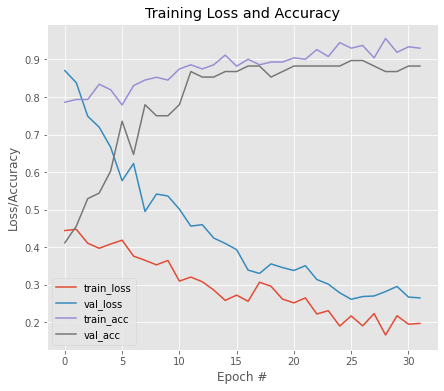


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:26
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2233 - accuracy: 0.9225
Epoch 1: val_loss improved from inf to 0.27250, saving model to MobileNet_b_1.hdf5
9/9 [==============================] - 9s 585ms/step - loss: 0.2233 - accuracy: 0.9225 - val_loss: 0.2725 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2150 - accuracy: 0.9151
Epoch 2: val_loss did not improve from 0.27250
9/9 [==============================] - 5s 540ms/step - loss: 0.2150 - accuracy: 0.9151 - val_loss: 0.2989 - val_accuracy: 0.8676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2011 - accuracy: 0.9262
Epoch 3: val_loss did not improve from 0.27250
9/9 [==============================] - 5s 500ms/step - loss: 0.2011 - accuracy: 0.9262 - val_loss: 0.3200 - val_accuracy: 0.8676
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1986 - 

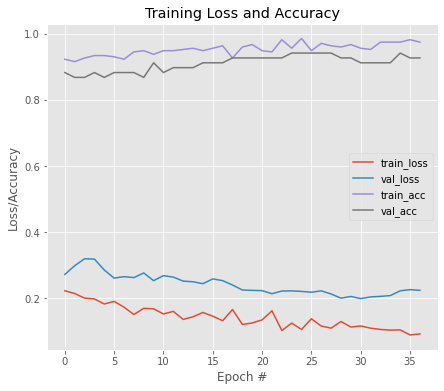


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:24
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1099 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 0.13078, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 9s 574ms/step - loss: 0.1099 - accuracy: 0.9594 - val_loss: 0.1308 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1274 - accuracy: 0.9668
Epoch 2: val_loss did not improve from 0.13078
9/9 [==============================] - 5s 513ms/step - loss: 0.1274 - accuracy: 0.9668 - val_loss: 0.1430 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1234 - accuracy: 0.9557
Epoch 3: val_loss improved from 0.13078 to 0.11768, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 5s 534ms/step - loss: 0.1234 - accuracy: 0.9557 - val_loss: 0.1177 - val_accuracy: 0.9559
Epoch 4/50
9/9 [===

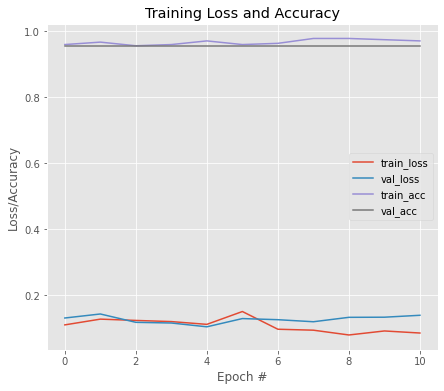


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0824 - accuracy: 0.9815
Epoch 1: val_loss improved from inf to 0.10274, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 9s 578ms/step - loss: 0.0824 - accuracy: 0.9815 - val_loss: 0.1027 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1091 - accuracy: 0.9742
Epoch 2: val_loss improved from 0.10274 to 0.10002, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 5s 535ms/step - loss: 0.1091 - accuracy: 0.9742 - val_loss: 0.1000 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0950 - accuracy: 0.9705
Epoch 3: val_loss did not improve from 0.10002
9/9 [==============================] - 5s 504ms/step - loss: 0.0950 - accuracy: 0.9705 - val_loss: 0.1219 - val_accuracy: 0.9559
Epoch 4/50
9/9 [====================

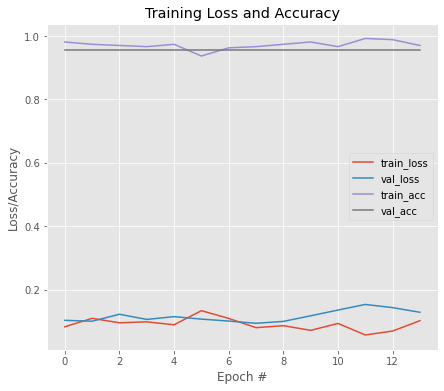


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0784 - accuracy: 0.9705
Epoch 1: val_loss improved from inf to 0.05234, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 9s 597ms/step - loss: 0.0784 - accuracy: 0.9705 - val_loss: 0.0523 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0936 - accuracy: 0.9668
Epoch 2: val_loss did not improve from 0.05234
9/9 [==============================] - 5s 511ms/step - loss: 0.0936 - accuracy: 0.9668 - val_loss: 0.0550 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0907 - accuracy: 0.9779
Epoch 3: val_loss did not improve from 0.05234
9/9 [==============================] - 5s 546ms/step - loss: 0.0907 - accuracy: 0.9779 - val_loss: 0.0543 - val_accuracy: 0.9853
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

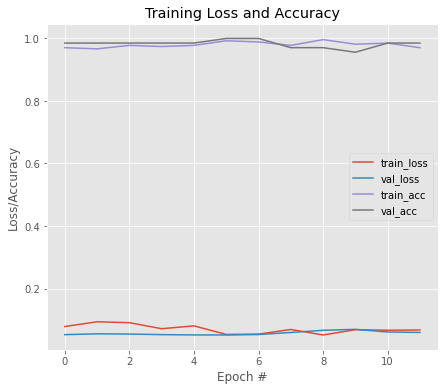


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0854 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 0.05149, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 9s 585ms/step - loss: 0.0854 - accuracy: 0.9742 - val_loss: 0.0515 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0735 - accuracy: 0.9779
Epoch 2: val_loss did not improve from 0.05149
9/9 [==============================] - 5s 505ms/step - loss: 0.0735 - accuracy: 0.9779 - val_loss: 0.0539 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0485 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.05149
9/9 [==============================] - 5s 496ms/step - loss: 0.0485 - accuracy: 0.9963 - val_loss: 0.0530 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0484 - accuracy: 0.9926

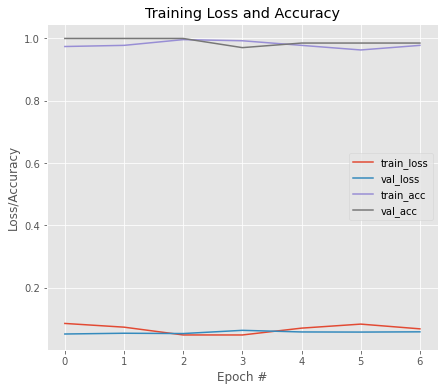


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0811 - accuracy: 0.9706
Epoch 1: val_loss improved from inf to 0.01979, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 9s 605ms/step - loss: 0.0811 - accuracy: 0.9706 - val_loss: 0.0198 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0498 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.01979 to 0.01942, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 5s 533ms/step - loss: 0.0498 - accuracy: 0.9963 - val_loss: 0.0194 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0728 - accuracy: 0.9890
Epoch 3: val_loss improved from 0.01942 to 0.01817, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 5s 530ms/step - loss: 0.0728 - accuracy: 0.9890 - val_loss: 0.0182 - val_accuracy: 1.

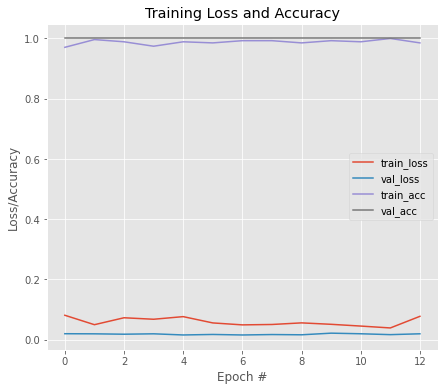


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0809 - accuracy: 0.9706
Epoch 1: val_loss improved from inf to 0.01703, saving model to MobileNet_b_4.hdf5
9/9 [==============================] - 9s 590ms/step - loss: 0.0809 - accuracy: 0.9706 - val_loss: 0.0170 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0663 - accuracy: 0.9890
Epoch 2: val_loss did not improve from 0.01703
9/9 [==============================] - 5s 548ms/step - loss: 0.0663 - accuracy: 0.9890 - val_loss: 0.0174 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0443 - accuracy: 0.9890
Epoch 3: val_loss did not improve from 0.01703
9/9 [==============================] - 5s 503ms/step - loss: 0.0443 - accuracy: 0.9890 - val_loss: 0.0191 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0412 - accuracy: 0.9926

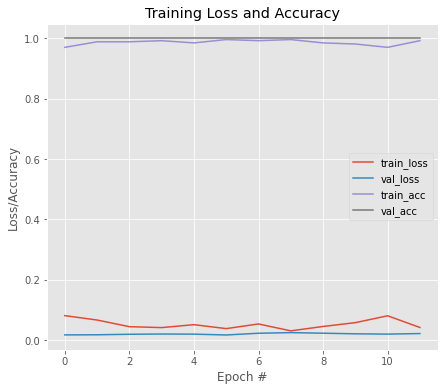


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9235294103622437
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0481 - accuracy: 0.9882
Epoch 1: val_loss improved from inf to 0.22293, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 7s 569ms/step - loss: 0.0481 - accuracy: 0.9882 - val_loss: 0.2229 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0427 - accuracy: 0.9971
Epoch 2: val_loss improved from 0.22293 to 0.22264, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 6s 546ms/step - loss: 0.0427 - accuracy: 0.9971 - val_loss: 0.2226 - val_accuracy: 0.9041
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0480 - accuracy: 0.9912
Epoch 3: val_loss improved from 0.22264 to 0.22247, saving model to MobileNet_wt.hdf5
11/11 [==============

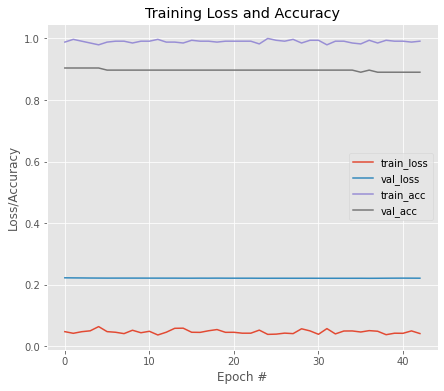


Model Performance Summary:

Best Validation accuracy:0.9041095972061157 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0578 - accuracy: 0.9823
Epoch 1: val_loss improved from inf to 0.22245, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 10s 588ms/step - loss: 0.0578 - accuracy: 0.9823 - val_loss: 0.2225 - val_accuracy: 0.9247
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0681 - accuracy: 0.9794
Epoch 2: val_loss did not improve from 0.22245
11/11 [==============================] - 6s 509ms/step - loss: 0.0681 - accuracy: 0.9794 - val_loss: 0.2453 - val_accuracy: 0.9178
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0710 - accuracy: 0.9764
Epoch 3: val_loss did not improve from 0.22245
11/11 [==============================] - 6s 513ms/step - loss: 0.0710 - accuracy: 0.9764 - val_loss: 0.2441 - val_accuracy: 0.9178
Epoch 4/50
11/11 

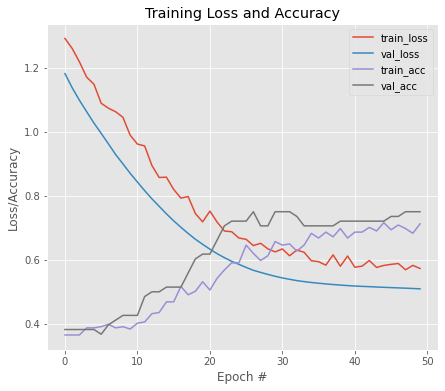


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:27
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6310 - accuracy: 0.6827
Epoch 1: val_loss improved from inf to 0.51153, saving model to MobileNetV2_b_0.hdf5
9/9 [==============================] - 13s 611ms/step - loss: 0.6310 - accuracy: 0.6827 - val_loss: 0.5115 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5810 - accuracy: 0.7011
Epoch 2: val_loss did not improve from 0.51153
9/9 [==============================] - 5s 501ms/step - loss: 0.5810 - accuracy: 0.7011 - val_loss: 0.5291 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5325 - accuracy: 0.7269
Epoch 3: val_loss did not improve from 0.51153
9/9 [==============================] - 5s 499ms/step - loss: 0.5325 - accuracy: 0.7269 - val_loss: 0.5578 - val_accuracy: 0.7059
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.5231 - accuracy: 0

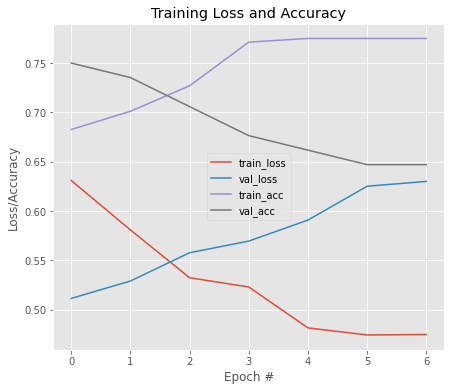


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4950 - accuracy: 0.7565
Epoch 1: val_loss improved from inf to 0.77785, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 13s 628ms/step - loss: 0.4950 - accuracy: 0.7565 - val_loss: 0.7779 - val_accuracy: 0.5294
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4567 - accuracy: 0.7601
Epoch 2: val_loss improved from 0.77785 to 0.74391, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 5s 547ms/step - loss: 0.4567 - accuracy: 0.7601 - val_loss: 0.7439 - val_accuracy: 0.5735
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4273 - accuracy: 0.8007
Epoch 3: val_loss improved from 0.74391 to 0.73493, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 5s 540ms/step - loss: 0.4273 - accuracy: 0.8007 - val_loss: 0.7349 - val_accu

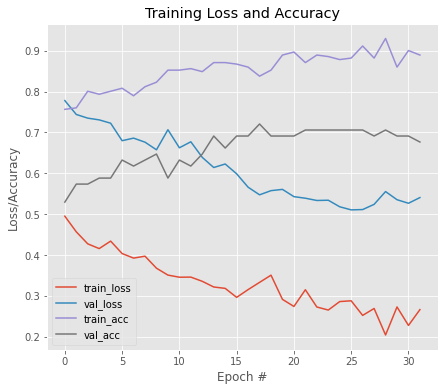


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:18
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2837 - accuracy: 0.8782
Epoch 1: val_loss improved from inf to 0.49937, saving model to MobileNetV2_b_1.hdf5
9/9 [==============================] - 13s 628ms/step - loss: 0.2837 - accuracy: 0.8782 - val_loss: 0.4994 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2497 - accuracy: 0.8856
Epoch 2: val_loss improved from 0.49937 to 0.49823, saving model to MobileNetV2_b_1.hdf5
9/9 [==============================] - 5s 586ms/step - loss: 0.2497 - accuracy: 0.8856 - val_loss: 0.4982 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2523 - accuracy: 0.9077
Epoch 3: val_loss did not improve from 0.49823
9/9 [==============================] - 5s 504ms/step - loss: 0.2523 - accuracy: 0.9077 - val_loss: 0.5032 - val_accuracy: 0.7206
Epoch 4/50
9/9 [===============

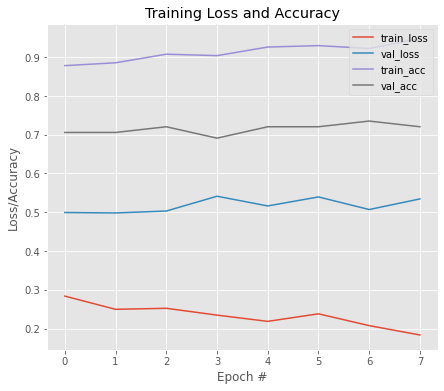


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:7
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1969 - accuracy: 0.9410
Epoch 1: val_loss improved from inf to 0.64230, saving model to MobileNetV2_a_2.hdf5
9/9 [==============================] - 13s 646ms/step - loss: 0.1969 - accuracy: 0.9410 - val_loss: 0.6423 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1906 - accuracy: 0.9299
Epoch 2: val_loss did not improve from 0.64230
9/9 [==============================] - 5s 507ms/step - loss: 0.1906 - accuracy: 0.9299 - val_loss: 0.6453 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2207 - accuracy: 0.9077
Epoch 3: val_loss did not improve from 0.64230
9/9 [==============================] - 5s 511ms/step - loss: 0.2207 - accuracy: 0.9077 - val_loss: 0.6615 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s

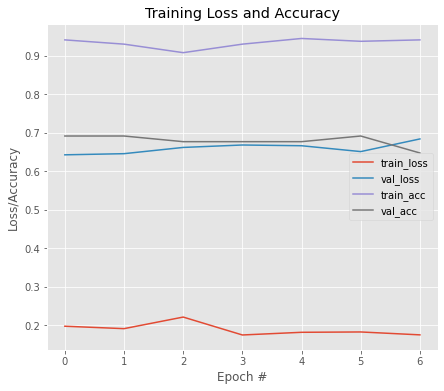


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1974 - accuracy: 0.9262
Epoch 1: val_loss improved from inf to 0.62820, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 13s 630ms/step - loss: 0.1974 - accuracy: 0.9262 - val_loss: 0.6282 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1720 - accuracy: 0.9446
Epoch 2: val_loss did not improve from 0.62820
9/9 [==============================] - 5s 501ms/step - loss: 0.1720 - accuracy: 0.9446 - val_loss: 0.6551 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1704 - accuracy: 0.9262
Epoch 3: val_loss did not improve from 0.62820
9/9 [==============================] - 5s 498ms/step - loss: 0.1704 - accuracy: 0.9262 - val_loss: 0.6547 - val_accuracy: 0.6912
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1857 

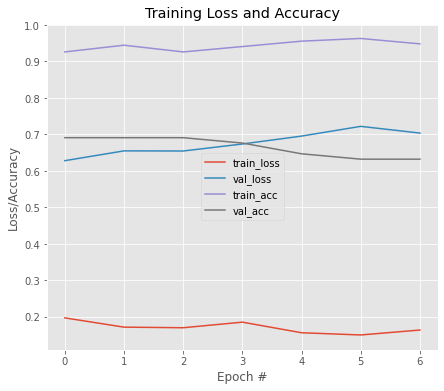


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1837 - accuracy: 0.9151
Epoch 1: val_loss improved from inf to 0.59693, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 13s 633ms/step - loss: 0.1837 - accuracy: 0.9151 - val_loss: 0.5969 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1708 - accuracy: 0.9373
Epoch 2: val_loss improved from 0.59693 to 0.56220, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 5s 588ms/step - loss: 0.1708 - accuracy: 0.9373 - val_loss: 0.5622 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1635 - accuracy: 0.9446
Epoch 3: val_loss improved from 0.56220 to 0.50676, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 5s 545ms/step - loss: 0.1635 - accuracy: 0.9446 - val_loss: 0.5

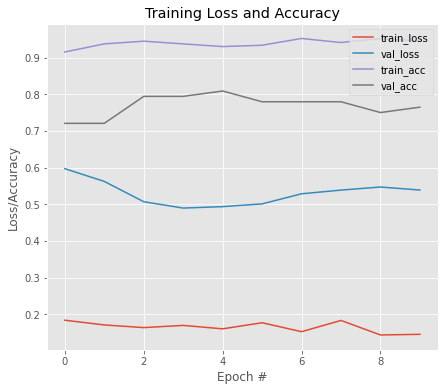


Model Performance Summary:

Best Validation accuracy:0.8088235259056091 at EPOCH:5
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1683 - accuracy: 0.9299
Epoch 1: val_loss improved from inf to 0.49493, saving model to MobileNetV2_b_3.hdf5
9/9 [==============================] - 13s 634ms/step - loss: 0.1683 - accuracy: 0.9299 - val_loss: 0.4949 - val_accuracy: 0.7941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1835 - accuracy: 0.9225
Epoch 2: val_loss improved from 0.49493 to 0.49057, saving model to MobileNetV2_b_3.hdf5
9/9 [==============================] - 5s 545ms/step - loss: 0.1835 - accuracy: 0.9225 - val_loss: 0.4906 - val_accuracy: 0.8235
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1335 - accuracy: 0.9631
Epoch 3: val_loss did not improve from 0.49057
9/9 [==============================] - 5s 497ms/step - loss: 0.1335 - accuracy: 0.9631 - val_loss: 0.4948 - val_accuracy: 0.7794
Epoch 4/50
9/9 [===============

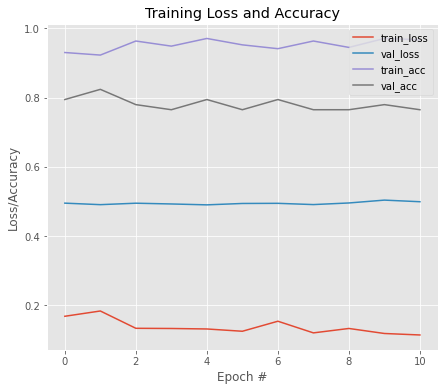


Model Performance Summary:

Best Validation accuracy:0.8235294222831726 at EPOCH:2
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1399 - accuracy: 0.9375
Epoch 1: val_loss improved from inf to 0.53860, saving model to MobileNetV2_a_4.hdf5
9/9 [==============================] - 13s 649ms/step - loss: 0.1399 - accuracy: 0.9375 - val_loss: 0.5386 - val_accuracy: 0.7313
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1274 - accuracy: 0.9596
Epoch 2: val_loss did not improve from 0.53860
9/9 [==============================] - 5s 508ms/step - loss: 0.1274 - accuracy: 0.9596 - val_loss: 0.5408 - val_accuracy: 0.7463
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1321 - accuracy: 0.9632
Epoch 3: val_loss did not improve from 0.53860
9/9 [==============================] - 5s 500ms/step - loss: 0.1321 - accuracy: 0.9632 - val_loss: 0.5421 - val_accuracy: 0.7313
Epoch 4/50
9/9 [==============================] - ETA: 0s

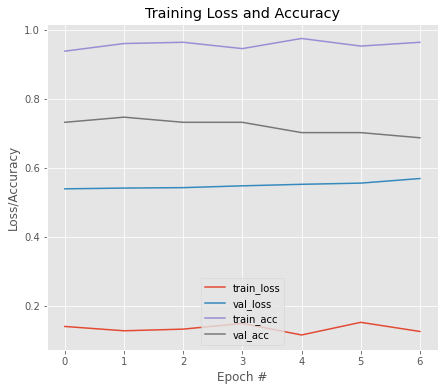


Model Performance Summary:

Best Validation accuracy:0.746268630027771 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1505 - accuracy: 0.9301
Epoch 1: val_loss improved from inf to 0.54512, saving model to MobileNetV2_b_4.hdf5
9/9 [==============================] - 13s 630ms/step - loss: 0.1505 - accuracy: 0.9301 - val_loss: 0.5451 - val_accuracy: 0.7612
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1299 - accuracy: 0.9375
Epoch 2: val_loss did not improve from 0.54512
9/9 [==============================] - 5s 515ms/step - loss: 0.1299 - accuracy: 0.9375 - val_loss: 0.5467 - val_accuracy: 0.7612
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1167 - accuracy: 0.9596
Epoch 3: val_loss did not improve from 0.54512
9/9 [==============================] - 5s 504ms/step - loss: 0.1167 - accuracy: 0.9596 - val_loss: 0.5466 - val_accuracy: 0.7463
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1605 -

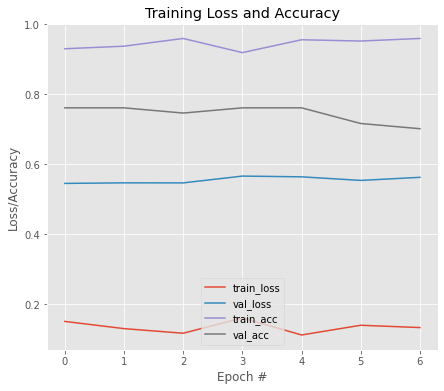


Model Performance Summary:

Best Validation accuracy:0.7611940503120422 at EPOCH:1
Average Accuracy:0.7522388100624084
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.5715 - accuracy: 0.7139
Epoch 1: val_loss improved from inf to 0.45762, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 9s 614ms/step - loss: 0.5715 - accuracy: 0.7139 - val_loss: 0.4576 - val_accuracy: 0.7603
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.5675 - accuracy: 0.7109
Epoch 2: val_loss improved from 0.45762 to 0.45725, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 6s 533ms/step - loss: 0.5675 - accuracy: 0.7109 - val_loss: 0.4572 - val_accuracy: 0.7671
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.5473 - accuracy: 0.7257
Epoch 3: val_loss did not improve from 0.45725
11/11 [==============================] - 

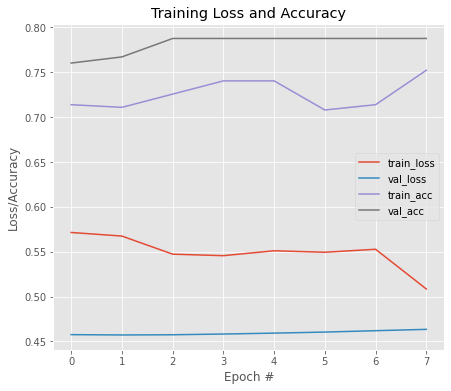


Model Performance Summary:

Best Validation accuracy:0.7876712083816528 at EPOCH:3
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1735 - accuracy: 0.9322
Epoch 1: val_loss improved from inf to 0.46034, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 14s 631ms/step - loss: 0.1735 - accuracy: 0.9322 - val_loss: 0.4603 - val_accuracy: 0.7740
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1570 - accuracy: 0.9440
Epoch 2: val_loss did not improve from 0.46034
11/11 [==============================] - 6s 514ms/step - loss: 0.1570 - accuracy: 0.9440 - val_loss: 0.4692 - val_accuracy: 0.7603
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1327 - accuracy: 0.9558
Epoch 3: val_loss improved from 0.46034 to 0.45737, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 6s 554ms/step - loss: 0.1327 - accuracy: 0.9558 - val_loss: 0.45

In [ ]:
for model in MODEL_LIST_1:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1)
  gc.collect()

83697664/83683744 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6660 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.65604, saving model to xception_a_0.hdf5
9/9 [==============================] - 7s 439ms/step - loss: 0.6660 - accuracy: 0.6494 - val_loss: 0.6560 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6617 - accuracy: 0.6494
Epoch 2: val_loss improved from 0.65604 to 0.65466, saving model to xception_a_0.hdf5
9/9 [==============================] - 3s 364ms/step - loss: 0.6617 - accuracy: 0.6494 - val_loss: 0.6547 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6689 - accuracy: 0.6494
Epoch 3: val_loss improved from 0.65466 to 0.65357, saving model to xception_a_0.hdf5
9/9 [==============================] - 3s 367ms/step - loss: 0.6689 - accuracy: 0.6494 - val_loss: 0.6536 - val_accuracy: 0.6471
Ep

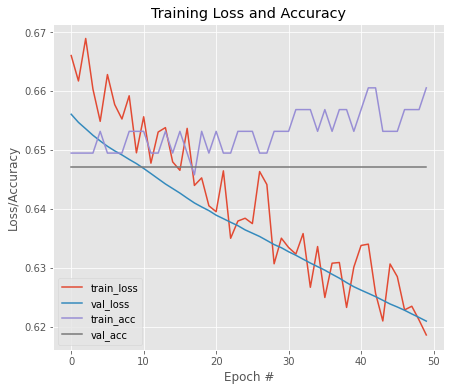


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6232 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.60506, saving model to xception_b_0.hdf5
9/9 [==============================] - 16s 895ms/step - loss: 0.6232 - accuracy: 0.6494 - val_loss: 0.6051 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5708 - accuracy: 0.7085
Epoch 2: val_loss improved from 0.60506 to 0.59755, saving model to xception_b_0.hdf5
9/9 [==============================] - 7s 779ms/step - loss: 0.5708 - accuracy: 0.7085 - val_loss: 0.5975 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5588 - accuracy: 0.7343
Epoch 3: val_loss improved from 0.59755 to 0.59207, saving model to xception_b_0.hdf5
9/9 [==============================] - 7s 780ms/step - loss: 0.5588 - accuracy: 0.7343 - val_loss: 0.5921 - val_accuracy: 0.647

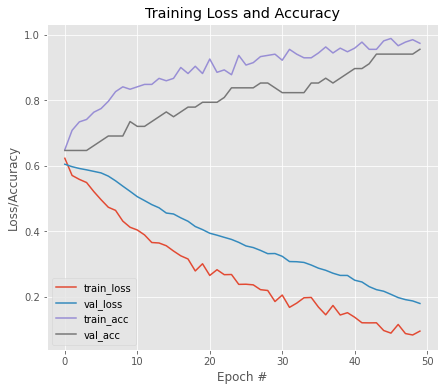


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:50
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1180 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.03748, saving model to xception_a_1.hdf5
9/9 [==============================] - 15s 860ms/step - loss: 0.1180 - accuracy: 0.9631 - val_loss: 0.0375 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1134 - accuracy: 0.9668
Epoch 2: val_loss did not improve from 0.03748
9/9 [==============================] - 7s 707ms/step - loss: 0.1134 - accuracy: 0.9668 - val_loss: 0.0392 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1318 - accuracy: 0.9631
Epoch 3: val_loss did not improve from 0.03748
9/9 [==============================] - 7s 702ms/step - loss: 0.1318 - accuracy: 0.9631 - val_loss: 0.0391 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s -

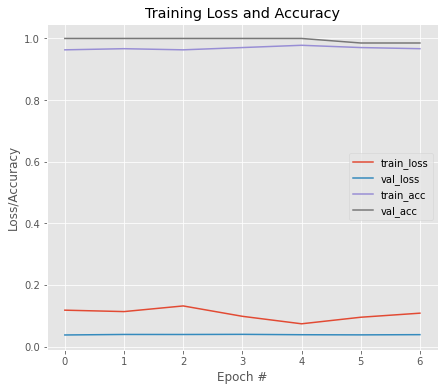


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1101 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.03590, saving model to xception_b_1.hdf5
9/9 [==============================] - 15s 858ms/step - loss: 0.1101 - accuracy: 0.9631 - val_loss: 0.0359 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1100 - accuracy: 0.9594
Epoch 2: val_loss improved from 0.03590 to 0.03502, saving model to xception_b_1.hdf5
9/9 [==============================] - 7s 779ms/step - loss: 0.1100 - accuracy: 0.9594 - val_loss: 0.0350 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0799 - accuracy: 0.9779
Epoch 3: val_loss improved from 0.03502 to 0.03322, saving model to xception_b_1.hdf5
9/9 [==============================] - 7s 824ms/step - loss: 0.0799 - accuracy: 0.9779 - val_loss: 0.0332 - val_accuracy: 1.0000
Epoch 4/50
9/

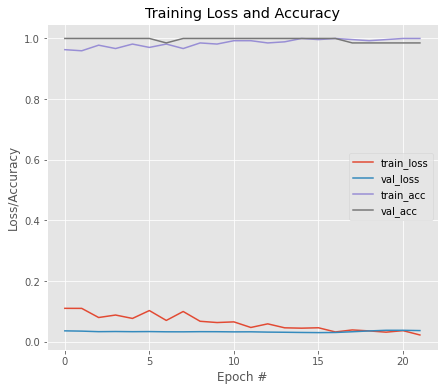


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0448 - accuracy: 0.9889
Epoch 1: val_loss improved from inf to 0.01320, saving model to xception_a_2.hdf5
9/9 [==============================] - 15s 865ms/step - loss: 0.0448 - accuracy: 0.9889 - val_loss: 0.0132 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0517 - accuracy: 0.9852
Epoch 2: val_loss did not improve from 0.01320
9/9 [==============================] - 7s 702ms/step - loss: 0.0517 - accuracy: 0.9852 - val_loss: 0.0133 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0276 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 0.01320
9/9 [==============================] - 7s 703ms/step - loss: 0.0276 - accuracy: 0.9926 - val_loss: 0.0137 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0251 - 

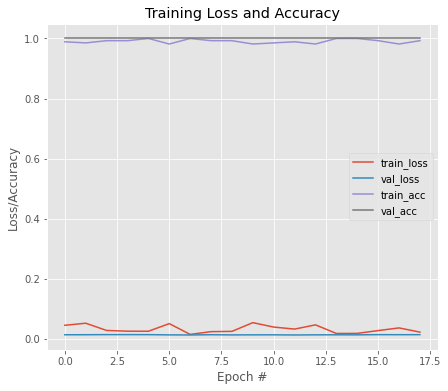


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0238 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.01185, saving model to xception_b_2.hdf5
9/9 [==============================] - 15s 900ms/step - loss: 0.0238 - accuracy: 0.9963 - val_loss: 0.0118 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0403 - accuracy: 0.9926
Epoch 2: val_loss improved from 0.01185 to 0.01080, saving model to xception_b_2.hdf5
9/9 [==============================] - 7s 778ms/step - loss: 0.0403 - accuracy: 0.9926 - val_loss: 0.0108 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0135 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.01080 to 0.01021, saving model to xception_b_2.hdf5
9/9 [==============================] - 7s 777ms/step - loss: 0.0135 - accuracy: 1.0000 - val_loss: 0.0102 - val_accuracy: 1.0000
Epoch 4/50
9/

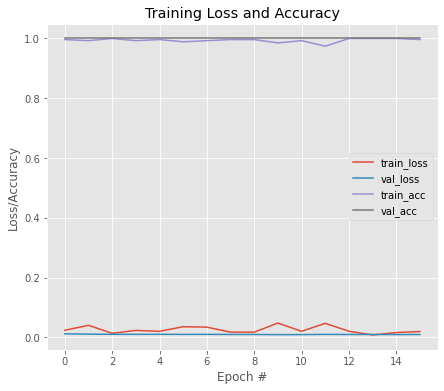


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0095 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00815, saving model to xception_a_3.hdf5
9/9 [==============================] - 15s 857ms/step - loss: 0.0095 - accuracy: 1.0000 - val_loss: 0.0081 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0207 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.00815
9/9 [==============================] - 7s 705ms/step - loss: 0.0207 - accuracy: 0.9926 - val_loss: 0.0093 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0384 - accuracy: 0.9889
Epoch 3: val_loss did not improve from 0.00815
9/9 [==============================] - 7s 703ms/step - loss: 0.0384 - accuracy: 0.9889 - val_loss: 0.0118 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0300 - 

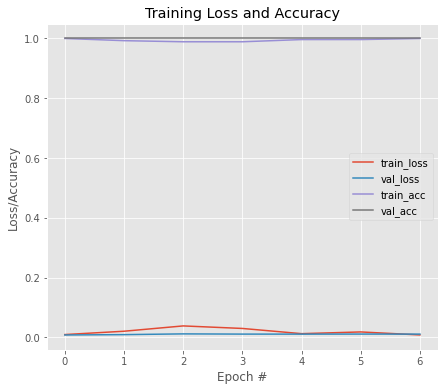


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0128 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00998, saving model to xception_b_3.hdf5
9/9 [==============================] - 15s 904ms/step - loss: 0.0128 - accuracy: 1.0000 - val_loss: 0.0100 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0248 - accuracy: 0.9852
Epoch 2: val_loss did not improve from 0.00998
9/9 [==============================] - 7s 704ms/step - loss: 0.0248 - accuracy: 0.9852 - val_loss: 0.0155 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0106 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00998
9/9 [==============================] - 7s 704ms/step - loss: 0.0106 - accuracy: 1.0000 - val_loss: 0.0167 - val_accuracy: 0.9853
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0159 - accuracy: 0.9963

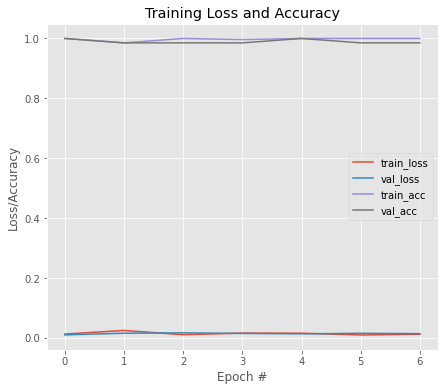


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00271, saving model to xception_a_4.hdf5
9/9 [==============================] - 16s 935ms/step - loss: 0.0058 - accuracy: 1.0000 - val_loss: 0.0027 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0125 - accuracy: 0.9963
Epoch 2: val_loss did not improve from 0.00271
9/9 [==============================] - 7s 706ms/step - loss: 0.0125 - accuracy: 0.9963 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0146 - accuracy: 0.9926
Epoch 3: val_loss improved from 0.00271 to 0.00252, saving model to xception_a_4.hdf5
9/9 [==============================] - 7s 779ms/step - loss: 0.0146 - accuracy: 0.9926 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 4/50
9/9 [====================

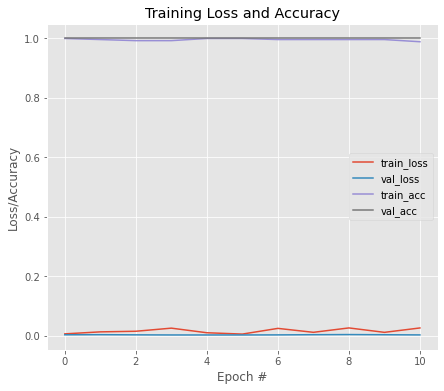


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0128 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.00216, saving model to xception_b_4.hdf5
9/9 [==============================] - 15s 861ms/step - loss: 0.0128 - accuracy: 0.9963 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0077 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00216
9/9 [==============================] - 7s 706ms/step - loss: 0.0077 - accuracy: 1.0000 - val_loss: 0.0029 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0358 - accuracy: 0.9816
Epoch 3: val_loss did not improve from 0.00216
9/9 [==============================] - 7s 703ms/step - loss: 0.0358 - accuracy: 0.9816 - val_loss: 0.0044 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0074 - accuracy: 1.0000

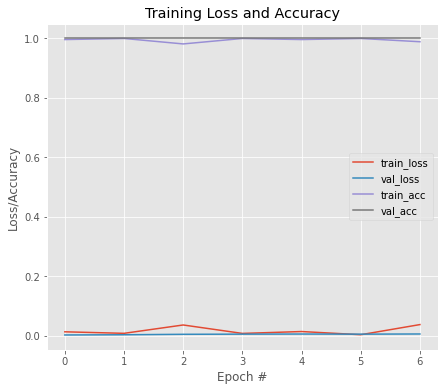


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9911764740943909
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0284 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.23381, saving model to xception_wt.hdf5
11/11 [==============================] - 7s 480ms/step - loss: 0.0284 - accuracy: 0.9971 - val_loss: 0.2338 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0272 - accuracy: 0.9971
Epoch 2: val_loss improved from 0.23381 to 0.23363, saving model to xception_wt.hdf5
11/11 [==============================] - 4s 407ms/step - loss: 0.0272 - accuracy: 0.9971 - val_loss: 0.2336 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0308 - accuracy: 0.9941
Epoch 3: val_loss improved from 0.23363 to 0.23298, saving model to xception_wt.hdf5
11/11 [=================

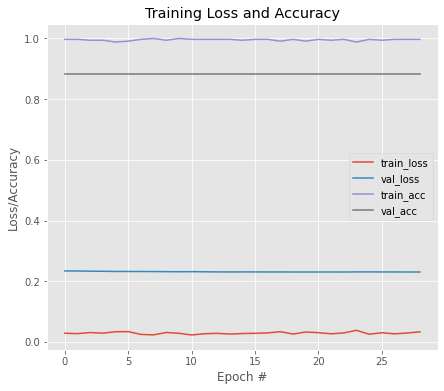


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0610 - accuracy: 0.9794
Epoch 1: val_loss improved from inf to 0.23930, saving model to xception_wt.hdf5
11/11 [==============================] - 17s 901ms/step - loss: 0.0610 - accuracy: 0.9794 - val_loss: 0.2393 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0444 - accuracy: 0.9882
Epoch 2: val_loss improved from 0.23930 to 0.23557, saving model to xception_wt.hdf5
11/11 [==============================] - 9s 826ms/step - loss: 0.0444 - accuracy: 0.9882 - val_loss: 0.2356 - val_accuracy: 0.8973
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0599 - accuracy: 0.9853
Epoch 3: val_loss did not improve from 0.23557
11/11 [==============================] - 8s 743ms/step - loss: 0.0599 - accuracy: 0.9853 - val_loss: 0.2389 - v

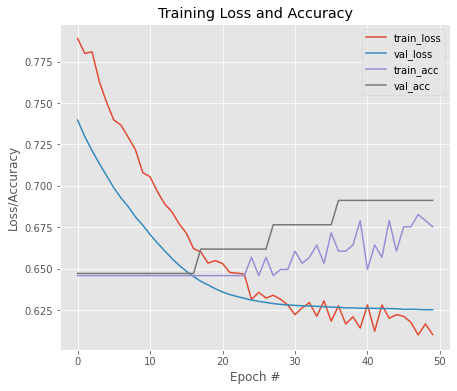


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:37
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7418 - accuracy: 0.4244
Epoch 1: val_loss improved from inf to 0.61188, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 42s 1s/step - loss: 0.7418 - accuracy: 0.4244 - val_loss: 0.6119 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6375 - accuracy: 0.6236
Epoch 2: val_loss improved from 0.61188 to 0.60248, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 8s 834ms/step - loss: 0.6375 - accuracy: 0.6236 - val_loss: 0.6025 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5849 - accuracy: 0.7122
Epoch 3: val_loss improved from 0.60248 to 0.58460, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 8s 830ms/step - loss: 0.5849 - accuracy: 0.7122 - val_loss: 0.5

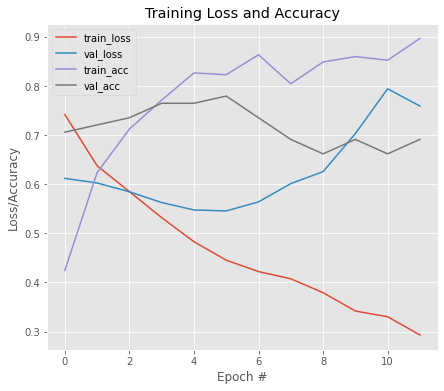


Model Performance Summary:

Best Validation accuracy:0.779411792755127 at EPOCH:6
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3233 - accuracy: 0.8635
Epoch 1: val_loss improved from inf to 1.31380, saving model to InceptionResNetV2_a_1.hdf5
9/9 [==============================] - 40s 1s/step - loss: 0.3233 - accuracy: 0.8635 - val_loss: 1.3138 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2611 - accuracy: 0.9004
Epoch 2: val_loss did not improve from 1.31380
9/9 [==============================] - 6s 599ms/step - loss: 0.2611 - accuracy: 0.9004 - val_loss: 1.5017 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2595 - accuracy: 0.9151
Epoch 3: val_loss did not improve from 1.31380
9/9 [==============================] - 6s 598ms/step - loss: 0.2595 - accuracy: 0.9151 - val_loss: 1.6192 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 

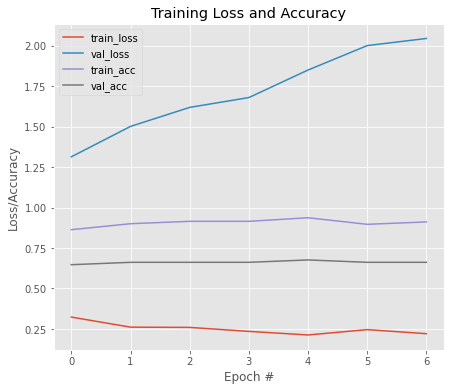


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:5
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2832 - accuracy: 0.8745
Epoch 1: val_loss improved from inf to 1.18424, saving model to InceptionResNetV2_b_1.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.2832 - accuracy: 0.8745 - val_loss: 1.1842 - val_accuracy: 0.6618
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2443 - accuracy: 0.9188
Epoch 2: val_loss did not improve from 1.18424
9/9 [==============================] - 6s 600ms/step - loss: 0.2443 - accuracy: 0.9188 - val_loss: 1.4609 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2323 - accuracy: 0.9188
Epoch 3: val_loss did not improve from 1.18424
9/9 [==============================] - 6s 630ms/step - loss: 0.2323 - accuracy: 0.9188 - val_loss: 1.4862 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.21

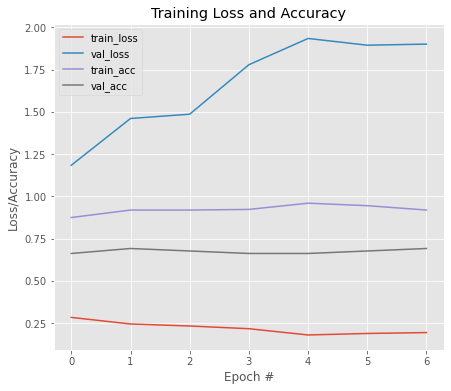


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:2
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1425 - accuracy: 0.9520
Epoch 1: val_loss improved from inf to 1.39781, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.1425 - accuracy: 0.9520 - val_loss: 1.3978 - val_accuracy: 0.5882
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1329 - accuracy: 0.9705
Epoch 2: val_loss improved from 1.39781 to 1.35467, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 7s 831ms/step - loss: 0.1329 - accuracy: 0.9705 - val_loss: 1.3547 - val_accuracy: 0.6324
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1121 - accuracy: 0.9705
Epoch 3: val_loss improved from 1.35467 to 1.28576, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 8s 833ms/step - loss: 0.1121 - accuracy: 0.9705 

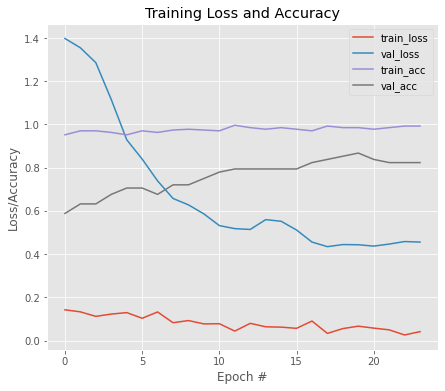


Model Performance Summary:

Best Validation accuracy:0.8676470518112183 at EPOCH:20
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0527 - accuracy: 0.9815
Epoch 1: val_loss improved from inf to 0.37697, saving model to InceptionResNetV2_b_2.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.0527 - accuracy: 0.9815 - val_loss: 0.3770 - val_accuracy: 0.8382
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0395 - accuracy: 0.9889
Epoch 2: val_loss did not improve from 0.37697
9/9 [==============================] - 6s 599ms/step - loss: 0.0395 - accuracy: 0.9889 - val_loss: 0.3790 - val_accuracy: 0.8676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0734 - accuracy: 0.9742
Epoch 3: val_loss did not improve from 0.37697
9/9 [==============================] - 6s 602ms/step - loss: 0.0734 - accuracy: 0.9742 - val_loss: 0.3863 - val_accuracy: 0.8088
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0

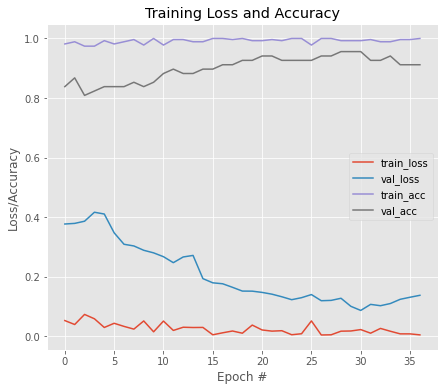


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:29
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1204 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.00830, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.1204 - accuracy: 0.9631 - val_loss: 0.0083 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0199 - accuracy: 0.9926
Epoch 2: val_loss improved from 0.00830 to 0.00747, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 8s 844ms/step - loss: 0.0199 - accuracy: 0.9926 - val_loss: 0.0075 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0700 - accuracy: 0.9815
Epoch 3: val_loss improved from 0.00747 to 0.00723, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 8s 846ms/step - loss: 0.0700 - accuracy: 0.9815

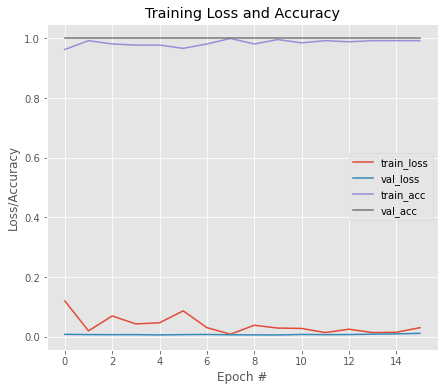


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0326 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.00811, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.0326 - accuracy: 0.9852 - val_loss: 0.0081 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0272 - accuracy: 0.9852
Epoch 2: val_loss did not improve from 0.00811
9/9 [==============================] - 6s 603ms/step - loss: 0.0272 - accuracy: 0.9852 - val_loss: 0.0089 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.00811
9/9 [==============================] - 6s 602ms/step - loss: 0.0109 - accuracy: 0.9963 - val_loss: 0.0101 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0119 - accuracy: 

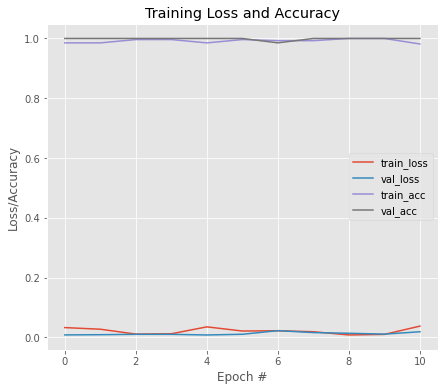


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0237 - accuracy: 0.9890
Epoch 1: val_loss improved from inf to 0.05313, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 40s 1s/step - loss: 0.0237 - accuracy: 0.9890 - val_loss: 0.0531 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0256 - accuracy: 0.9926
Epoch 2: val_loss improved from 0.05313 to 0.02131, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 8s 842ms/step - loss: 0.0256 - accuracy: 0.9926 - val_loss: 0.0213 - val_accuracy: 0.9851
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0365 - accuracy: 0.9853
Epoch 3: val_loss did not improve from 0.02131
9/9 [==============================] - 6s 603ms/step - loss: 0.0365 - accuracy: 0.9853 - val_loss: 0.0217 - val_accuracy: 0.9851
Epoch 4/50
9/9 [=====

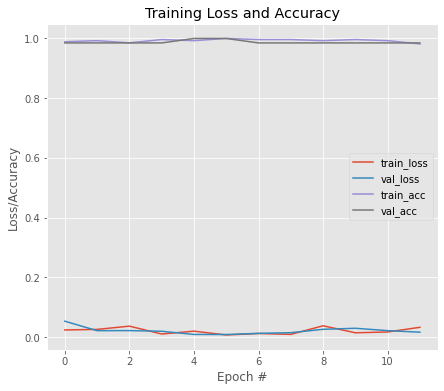


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:5
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0415 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.01996, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.0415 - accuracy: 0.9853 - val_loss: 0.0200 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0063 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.01996 to 0.01105, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 8s 847ms/step - loss: 0.0063 - accuracy: 1.0000 - val_loss: 0.0111 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0078 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.01105
9/9 [==============================] - 6s 602ms/step - loss: 0.0078 - accuracy: 0.9963 - val_loss: 0.0133 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=====================

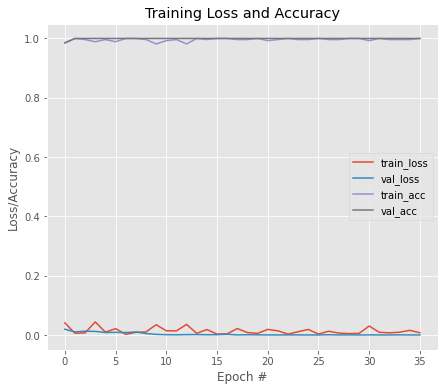


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Average Accuracy:0.8852941274642945
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0107 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.34161, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 18s 871ms/step - loss: 0.0107 - accuracy: 0.9971 - val_loss: 0.3416 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0168 - accuracy: 0.9971
Epoch 2: val_loss improved from 0.34161 to 0.34095, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 6s 511ms/step - loss: 0.0168 - accuracy: 0.9971 - val_loss: 0.3409 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0270 - accuracy: 0.9941
Epoch 3: val_loss improved from 0.34095 to 0.34048, saving model to InceptionResNetV2_wt.h

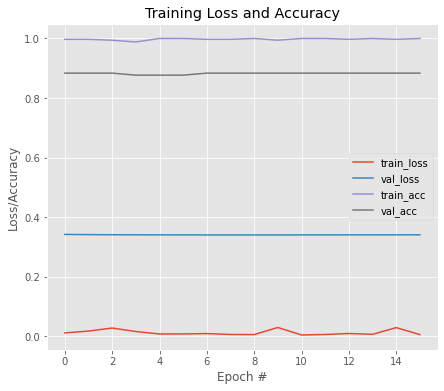


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0221 - accuracy: 0.9912
Epoch 1: val_loss improved from inf to 0.61229, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 42s 1s/step - loss: 0.0221 - accuracy: 0.9912 - val_loss: 0.6123 - val_accuracy: 0.8425
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0291 - accuracy: 0.9882
Epoch 2: val_loss did not improve from 0.61229
11/11 [==============================] - 7s 643ms/step - loss: 0.0291 - accuracy: 0.9882 - val_loss: 0.7251 - val_accuracy: 0.8425
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0153 - accuracy: 0.9941
Epoch 3: val_loss improved from 0.61229 to 0.54922, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 10s 914ms/step - loss: 0.0153 - accuracy: 0.9941 - val_

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1)
  gc.collect()


,Model,Accuracy,Sensitivity,AUC
0,xception_A_True_RIM-ONE_dl,0.897260,0.946809,0.877250
1,InceptionResNetV2_A_True_RIM-ONE_dl,0.883562,0.925532,0.866612
2,InceptionV3_A_True_RIM-ONE_dl,0.917808,0.914894,0.918985
3,vgg16_A_True_RIM-ONE_dl,0.917808,0.936170,0.910393
4,vgg19_A_True_RIM-ONE_dl,0.910959,0.957447,0.892185
5,resnet50_A_True_RIM-ONE_dl,0.643836,1.000000,0.500000
6,DenseNet121_A_True_RIM-ONE_dl,0.958904,0.957447,0.959493
7,MobileNet_A_True_RIM-ONE_dl,0.904110,0.925532,0.895458
8,MobileNetV2_A_True_RIM-ONE_dl,0.767123,0.829787,0.741817


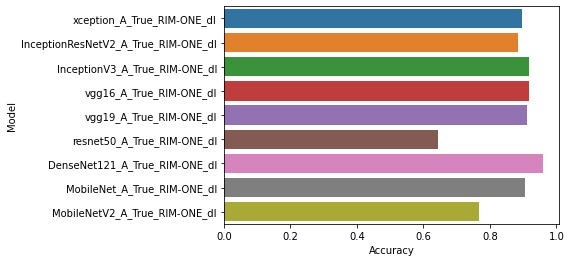

\begin{tabular}{lrrr}
\toprule
                              Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
         xception\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.946809 & 0.877250 \\
InceptionResNetV2\_A\_True\_RIM-ONE\_dl &  0.883562 &     0.925532 & 0.866612 \\
      InceptionV3\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.914894 & 0.918985 \\
            vgg16\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.936170 & 0.910393 \\
            vgg19\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.957447 & 0.892185 \\
         resnet50\_A\_True\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_True\_RIM-ONE\_dl &  0.958904 &     0.957447 & 0.959493 \\
        MobileNet\_A\_True\_RIM-ONE\_dl &  0.904110 &     0.925532 & 0.895458 \\
      MobileNetV2\_A\_True\_RIM-ONE\_dl &  0.767123 &     0.829787 & 0.741817 \\
\bottomrule
\end{tabular}



In [ ]:
plot_overall_performance()

Without Augmentation

87924736/87910968 [==============================] - 2s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7712 - accuracy: 0.4096
Epoch 1: val_loss improved from inf to 0.75243, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 8s 381ms/step - loss: 0.7712 - accuracy: 0.4096 - val_loss: 0.7524 - val_accuracy: 0.3971
Epoch 2/50
8/9 [=========================>....] - ETA: 0s - loss: 0.7478 - accuracy: 0.4609
Epoch 2: val_loss improved from 0.75243 to 0.73387, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 2s 184ms/step - loss: 0.7463 - accuracy: 0.4576 - val_loss: 0.7339 - val_accuracy: 0.4118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.7291 - accuracy: 0.4686
Epoch 3: val_loss improved from 0.73387 to 0.71929, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 1s 166ms/step - loss: 0.7291 - accuracy: 0.4686 - val_loss: 0.7193 - val_accuracy: 

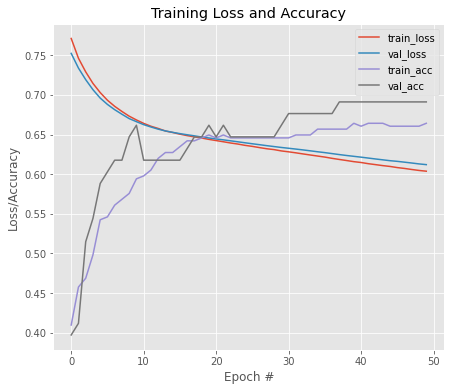


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:38
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5920 - accuracy: 0.6937
Epoch 1: val_loss improved from inf to 0.56327, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 17s 556ms/step - loss: 0.5920 - accuracy: 0.6937 - val_loss: 0.5633 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3989 - accuracy: 0.8745
Epoch 2: val_loss improved from 0.56327 to 0.53559, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 3s 357ms/step - loss: 0.3989 - accuracy: 0.8745 - val_loss: 0.5356 - val_accuracy: 0.7794
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3137 - accuracy: 0.9410
Epoch 3: val_loss improved from 0.53559 to 0.50688, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 3s 355ms/step - loss: 0.3137 - accuracy: 0.9410 - val_loss: 0.5069 - val_accur

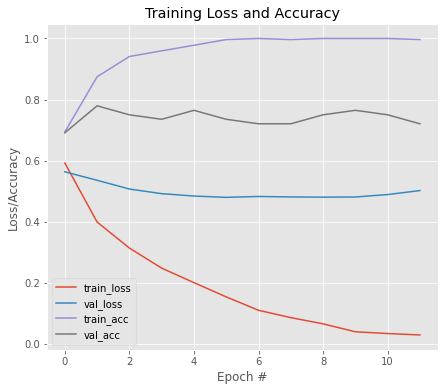


Model Performance Summary:

Best Validation accuracy:0.779411792755127 at EPOCH:2
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0982 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 0.34982, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 15s 529ms/step - loss: 0.0982 - accuracy: 0.9742 - val_loss: 0.3498 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0411 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.34982 to 0.32262, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 3s 361ms/step - loss: 0.0411 - accuracy: 0.9963 - val_loss: 0.3226 - val_accuracy: 0.8676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0228 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.32262 to 0.30938, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 4s 423ms/step - loss: 0.0228 - accuracy: 1.0000 - val_loss: 0.30

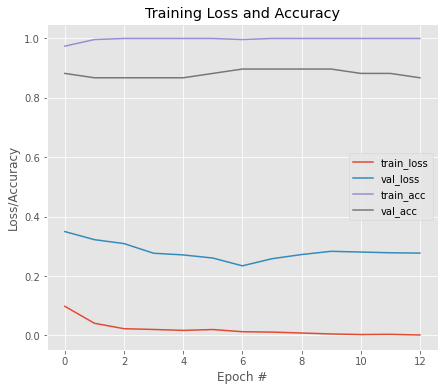


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:7
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.26132, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 14s 498ms/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.2613 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0055 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.26132 to 0.23591, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 3s 361ms/step - loss: 0.0055 - accuracy: 1.0000 - val_loss: 0.2359 - val_accuracy: 0.8971
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.23591
9/9 [==============================] - 2s 262ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 0.2771 - val_accuracy: 0.8824
Epoch 4/50
9/9 [===============

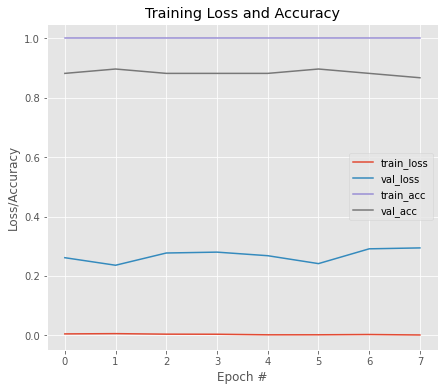


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:2
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.42426, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 14s 484ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.4243 - val_accuracy: 0.8676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.4610e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.42426 to 0.41404, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 3s 353ms/step - loss: 6.4610e-04 - accuracy: 1.0000 - val_loss: 0.4140 - val_accuracy: 0.8824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.41404 to 0.35639, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 3s 358ms/step - loss: 0.0015 - accuracy: 1.0000 - val_l

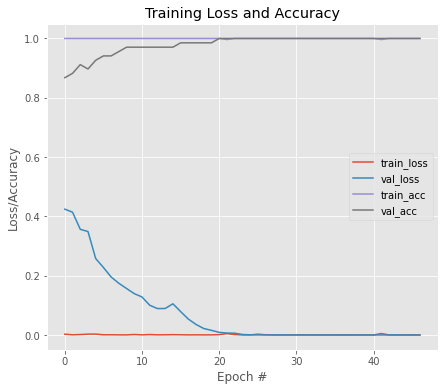


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:21
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.0559e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00004, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 14s 491ms/step - loss: 2.0559e-04 - accuracy: 1.0000 - val_loss: 3.6800e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 5.3822e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00004 to 0.00003, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 3s 363ms/step - loss: 5.3822e-05 - accuracy: 1.0000 - val_loss: 2.5742e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 8.5062e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00003
9/9 [==============================] - 2s 259ms/step - loss: 8.5062e-04 - accuracy: 1.0000 - val_loss: 5.7823e-05 - val_accuracy: 1.0000
Epoch 4/5

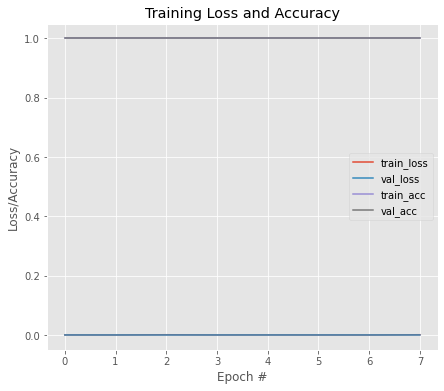


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 6.4089e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 14s 484ms/step - loss: 6.4089e-05 - accuracy: 1.0000 - val_loss: 1.4017e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
9/9 [==============================] - 2s 261ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 4.6237e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 6.2686e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
9/9 [==============================] - 2s 258ms/step - loss: 6.2686e-04 - accuracy: 1.0000 - val_loss: 3.8728e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [============================

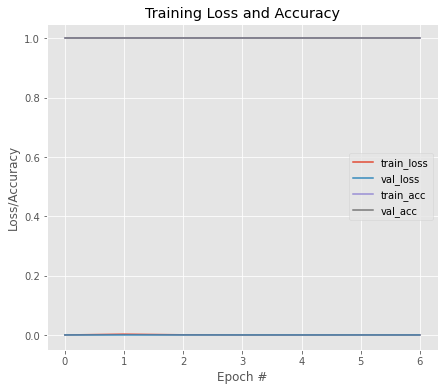


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 6.7184e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00002, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 14s 492ms/step - loss: 6.7184e-05 - accuracy: 1.0000 - val_loss: 1.5165e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.1401e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00002 to 0.00001, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 3s 371ms/step - loss: 3.1401e-04 - accuracy: 1.0000 - val_loss: 6.9544e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.0564e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 3s 370ms/step - loss: 2.0564e-04 - accuracy: 1.0000 - val_loss: 5.

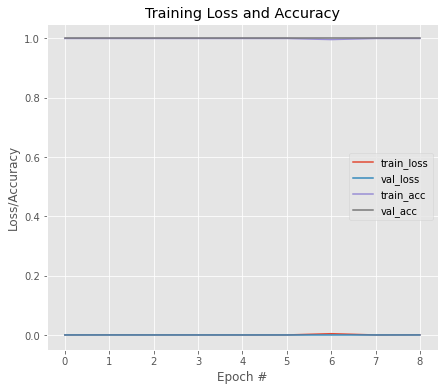


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.4639e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 15s 649ms/step - loss: 2.4639e-05 - accuracy: 1.0000 - val_loss: 2.8913e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 3s 365ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 2.6155e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 259ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 4.1901e-06 - val_accuracy: 1.0000
Epoch 4/50

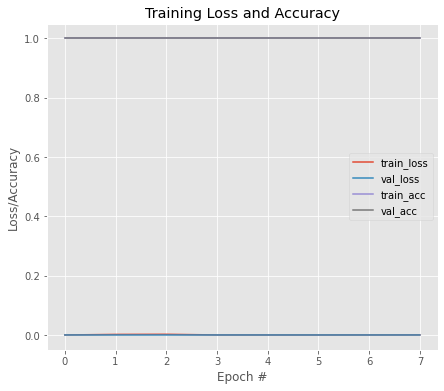


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.3898e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 14s 489ms/step - loss: 2.3898e-04 - accuracy: 1.0000 - val_loss: 3.0389e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 260ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 5.5530e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 5.2982e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 3s 354ms/step - loss: 5.2982e-04 - accuracy: 1.0000 - val_loss: 2.8343e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==

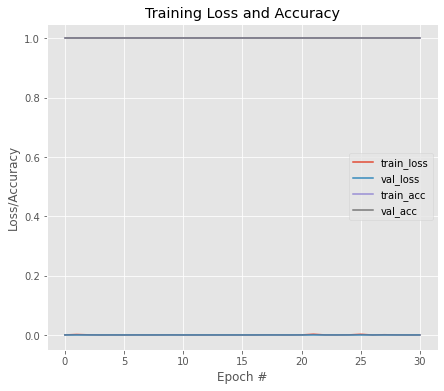


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9352941274642944
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.1429e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.51829, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 7s 351ms/step - loss: 1.1429e-05 - accuracy: 1.0000 - val_loss: 0.5183 - val_accuracy: 0.8493
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 1.0121e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.51829 to 0.51433, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 2s 164ms/step - loss: 1.0121e-05 - accuracy: 1.0000 - val_loss: 0.5143 - val_accuracy: 0.8493
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 9.2692e-06 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.51433 to 0.51148, saving model to InceptionV3_wt.

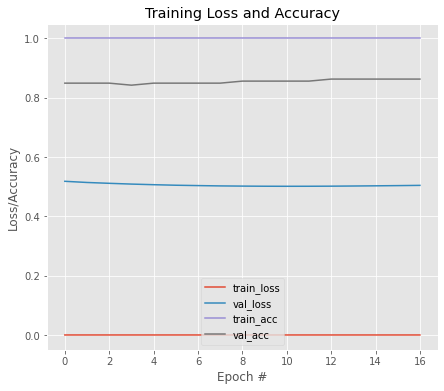


Model Performance Summary:

Best Validation accuracy:0.8630136847496033 at EPOCH:13
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0084 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.51267, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 15s 533ms/step - loss: 0.0084 - accuracy: 0.9971 - val_loss: 0.5127 - val_accuracy: 0.8562
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 7.6971e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.51267 to 0.50522, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 4s 354ms/step - loss: 7.6971e-04 - accuracy: 1.0000 - val_loss: 0.5052 - val_accuracy: 0.8493
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 8.6450e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.50522 to 0.49794, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 4s 360ms/s

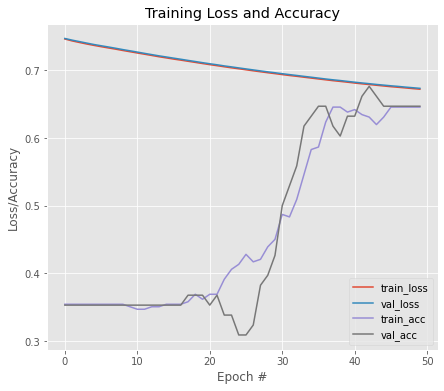


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:43
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6403 - accuracy: 0.6568
Epoch 1: val_loss improved from inf to 0.60984, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 6s 368ms/step - loss: 0.6403 - accuracy: 0.6568 - val_loss: 0.6098 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5908 - accuracy: 0.6937
Epoch 2: val_loss improved from 0.60984 to 0.59354, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 2s 273ms/step - loss: 0.5908 - accuracy: 0.6937 - val_loss: 0.5935 - val_accuracy: 0.7794
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5691 - accuracy: 0.7269
Epoch 3: val_loss improved from 0.59354 to 0.53633, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 2s 275ms/step - loss: 0.5691 - accuracy: 0.7269 - val_loss: 0.5363 - val_accuracy: 0.7500
Epoch 4

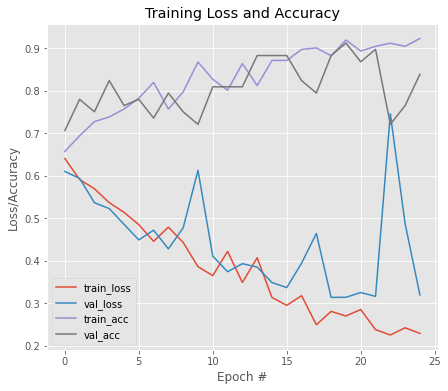


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:20
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5166 - accuracy: 0.8672
Epoch 1: val_loss improved from inf to 0.17979, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 4s 307ms/step - loss: 0.5166 - accuracy: 0.8672 - val_loss: 0.1798 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2027 - accuracy: 0.9336
Epoch 2: val_loss improved from 0.17979 to 0.10674, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 2s 271ms/step - loss: 0.2027 - accuracy: 0.9336 - val_loss: 0.1067 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2610 - accuracy: 0.9151
Epoch 3: val_loss did not improve from 0.10674
9/9 [==============================] - 2s 241ms/step - loss: 0.2610 - accuracy: 0.9151 - val_loss: 0.1250 - val_accuracy: 0.9706
Epoch 4/50
9/9 [===========

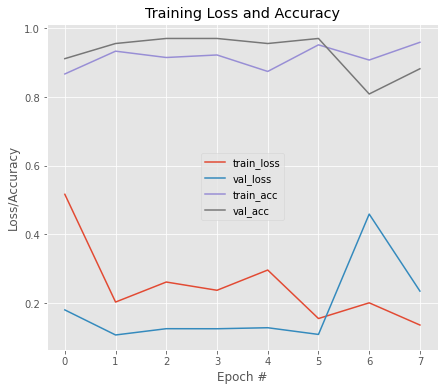


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5069 - accuracy: 0.8708
Epoch 1: val_loss improved from inf to 0.26001, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 4s 291ms/step - loss: 0.5069 - accuracy: 0.8708 - val_loss: 0.2600 - val_accuracy: 0.8971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2469 - accuracy: 0.9041
Epoch 2: val_loss improved from 0.26001 to 0.12982, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 2s 272ms/step - loss: 0.2469 - accuracy: 0.9041 - val_loss: 0.1298 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2130 - accuracy: 0.9151
Epoch 3: val_loss did not improve from 0.12982
9/9 [==============================] - 2s 239ms/step - loss: 0.2130 - accuracy: 0.9151 - val_loss: 0.2089 - val_accuracy: 0.9118
Epoch 4/50
9/9 [=============================

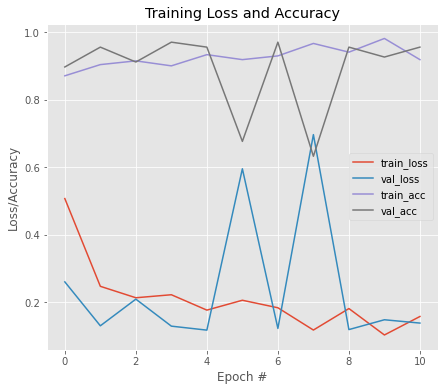


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:4
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4710 - accuracy: 0.8745
Epoch 1: val_loss improved from inf to 0.12089, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 4s 291ms/step - loss: 0.4710 - accuracy: 0.8745 - val_loss: 0.1209 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0856 - accuracy: 0.9815
Epoch 2: val_loss improved from 0.12089 to 0.09922, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 2s 270ms/step - loss: 0.0856 - accuracy: 0.9815 - val_loss: 0.0992 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0696 - accuracy: 0.9852
Epoch 3: val_loss did not improve from 0.09922
9/9 [==============================] - 2s 240ms/step - loss: 0.0696 - accuracy: 0.9852 - val_loss: 0.1059 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=============

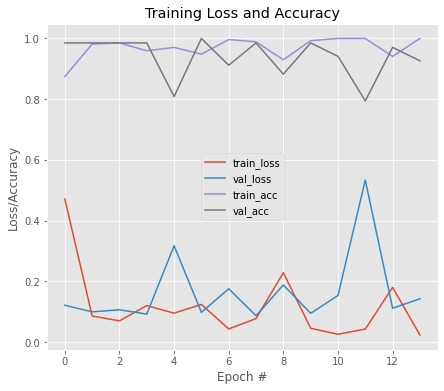


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6570 - accuracy: 0.9151
Epoch 1: val_loss improved from inf to 0.12104, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 4s 292ms/step - loss: 0.6570 - accuracy: 0.9151 - val_loss: 0.1210 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0292 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.12104
9/9 [==============================] - 2s 253ms/step - loss: 0.0292 - accuracy: 1.0000 - val_loss: 0.1229 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0394 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.12104
9/9 [==============================] - 2s 240ms/step - loss: 0.0394 - accuracy: 1.0000 - val_loss: 0.2226 - val_accuracy: 0.8824
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0492 - accuracy: 0.9889
Epo

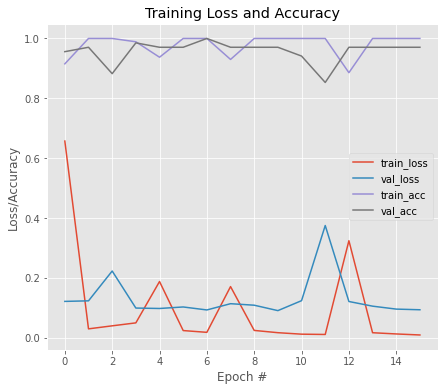


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:7
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3932 - accuracy: 0.9483
Epoch 1: val_loss improved from inf to 0.01710, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 4s 291ms/step - loss: 0.3932 - accuracy: 0.9483 - val_loss: 0.0171 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0333 - accuracy: 0.9963
Epoch 2: val_loss did not improve from 0.01710
9/9 [==============================] - 2s 241ms/step - loss: 0.0333 - accuracy: 0.9963 - val_loss: 0.0295 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0384 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.01710
9/9 [==============================] - 2s 241ms/step - loss: 0.0384 - accuracy: 0.9963 - val_loss: 0.0205 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0277 - accu

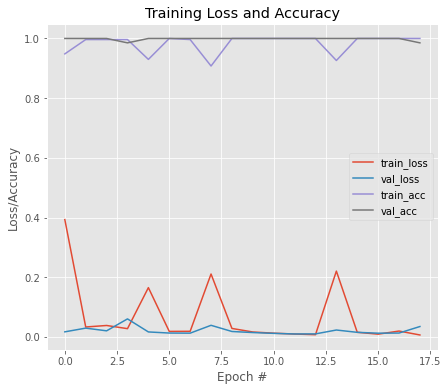


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6281 - accuracy: 0.9151
Epoch 1: val_loss improved from inf to 0.01062, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 4s 292ms/step - loss: 0.6281 - accuracy: 0.9151 - val_loss: 0.0106 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0099 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.01062 to 0.00938, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 2s 272ms/step - loss: 0.0099 - accuracy: 1.0000 - val_loss: 0.0094 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00938 to 0.00936, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 2s 271ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 0.0094 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

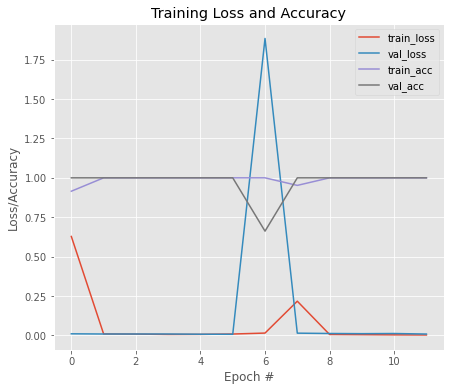


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6252 - accuracy: 0.9338
Epoch 1: val_loss improved from inf to 0.00469, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 5s 441ms/step - loss: 0.6252 - accuracy: 0.9338 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00469 to 0.00322, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 2s 272ms/step - loss: 0.0079 - accuracy: 1.0000 - val_loss: 0.0032 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0060 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00322 to 0.00259, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 3s 317ms/step - loss: 0.0060 - accuracy: 1.0000 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 4

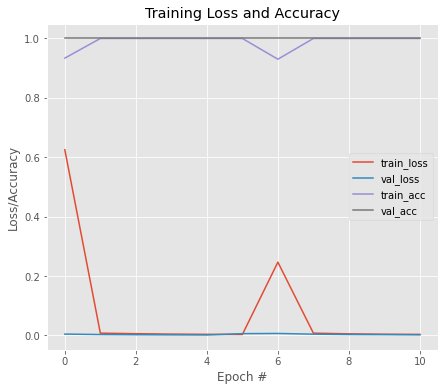


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8017 - accuracy: 0.9044
Epoch 1: val_loss improved from inf to 0.01165, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 4s 291ms/step - loss: 0.8017 - accuracy: 0.9044 - val_loss: 0.0117 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.01165 to 0.00460, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 2s 275ms/step - loss: 0.0073 - accuracy: 1.0000 - val_loss: 0.0046 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00460 to 0.00352, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 2s 274ms/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

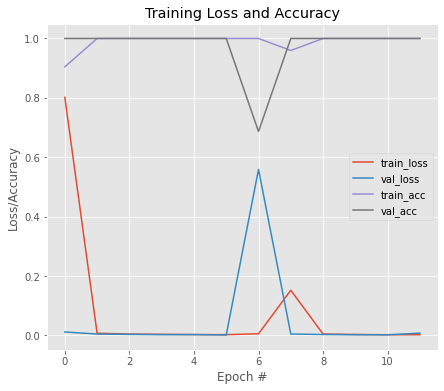


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9764705777168274
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0277 - accuracy: 0.9941
Epoch 1: val_loss improved from inf to 0.28112, saving model to vgg16_wt.hdf5
11/11 [==============================] - 3s 251ms/step - loss: 0.0277 - accuracy: 0.9941 - val_loss: 0.2811 - val_accuracy: 0.8699
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0277 - accuracy: 0.9941
Epoch 2: val_loss did not improve from 0.28112
11/11 [==============================] - 1s 126ms/step - loss: 0.0277 - accuracy: 0.9941 - val_loss: 0.2813 - val_accuracy: 0.8699
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0276 - accuracy: 0.9941
Epoch 3: val_loss did not improve from 0.28112
11/11 [==============================] - 1s 126ms/step - loss: 0.0276 - accuracy: 0.9941 - val_loss: 0.

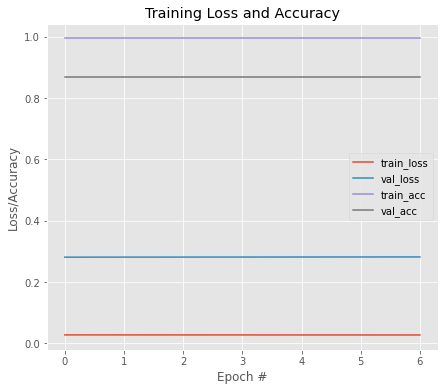


Model Performance Summary:

Best Validation accuracy:0.8698630332946777 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.2099 - accuracy: 0.7847
Epoch 1: val_loss improved from inf to 0.27905, saving model to vgg16_wt.hdf5
11/11 [==============================] - 5s 314ms/step - loss: 1.2099 - accuracy: 0.7847 - val_loss: 0.2790 - val_accuracy: 0.8699
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0720 - accuracy: 0.9912
Epoch 2: val_loss did not improve from 0.27905
11/11 [==============================] - 3s 263ms/step - loss: 0.0720 - accuracy: 0.9912 - val_loss: 0.3040 - val_accuracy: 0.8562
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.3705 - accuracy: 0.8732
Epoch 3: val_loss did not improve from 0.27905
11/11 [==============================] - 3s 261ms/step - loss: 0.3705 - accuracy: 0.8732 - val_loss: 0.3432 - val_accuracy: 0.8562
Epoch 4/50
11/11 [====

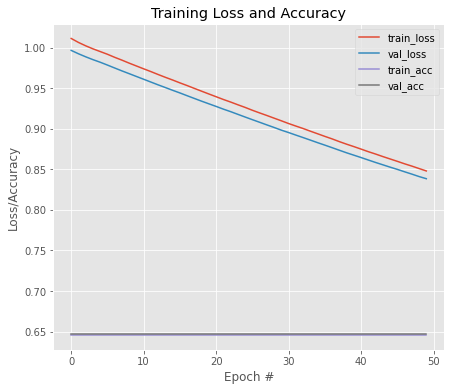


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6838 - accuracy: 0.6458
Epoch 1: val_loss improved from inf to 0.64062, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 5s 345ms/step - loss: 0.6838 - accuracy: 0.6458 - val_loss: 0.6406 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6344 - accuracy: 0.6384
Epoch 2: val_loss improved from 0.64062 to 0.60432, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 3s 326ms/step - loss: 0.6344 - accuracy: 0.6384 - val_loss: 0.6043 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6093 - accuracy: 0.6716
Epoch 3: val_loss improved from 0.60432 to 0.59130, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 3s 324ms/step - loss: 0.6093 - accuracy: 0.6716 - val_loss: 0.5913 - val_accuracy: 0.6618
Epoch 4/

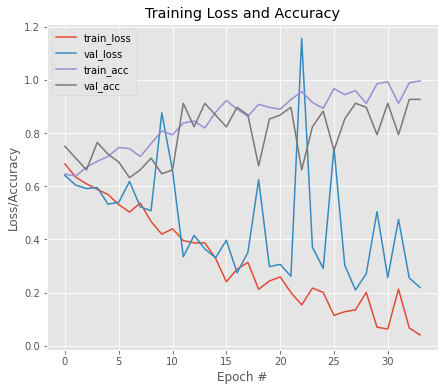


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:33
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4248 - accuracy: 0.9299
Epoch 1: val_loss improved from inf to 0.03007, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 5s 343ms/step - loss: 0.4248 - accuracy: 0.9299 - val_loss: 0.0301 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1183 - accuracy: 0.9742
Epoch 2: val_loss improved from 0.03007 to 0.01898, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 3s 324ms/step - loss: 0.1183 - accuracy: 0.9742 - val_loss: 0.0190 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0742 - accuracy: 0.9815
Epoch 3: val_loss did not improve from 0.01898
9/9 [==============================] - 3s 279ms/step - loss: 0.0742 - accuracy: 0.9815 - val_loss: 0.0791 - val_accuracy: 0.9559
Epoch 4/50
9/9 [===========

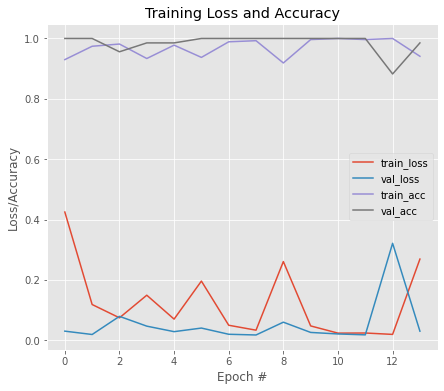


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6224 - accuracy: 0.8598
Epoch 1: val_loss improved from inf to 0.02871, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 5s 341ms/step - loss: 0.6224 - accuracy: 0.8598 - val_loss: 0.0287 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0344 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.02871 to 0.01880, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 3s 328ms/step - loss: 0.0344 - accuracy: 1.0000 - val_loss: 0.0188 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0253 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.01880 to 0.01748, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 3s 325ms/step - loss: 0.0253 - accuracy: 1.0000 - val_loss: 0.0175 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

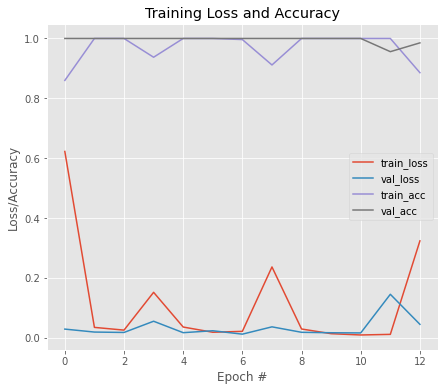


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4600 - accuracy: 0.9188
Epoch 1: val_loss improved from inf to 0.04450, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 5s 345ms/step - loss: 0.4600 - accuracy: 0.9188 - val_loss: 0.0445 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0117 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.04450 to 0.02951, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 3s 343ms/step - loss: 0.0117 - accuracy: 1.0000 - val_loss: 0.0295 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0084 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.02951 to 0.02796, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 3s 359ms/step - loss: 0.0084 - accuracy: 1.0000 - val_loss: 0.0280 - val_accuracy: 1.0000
Epoch 4

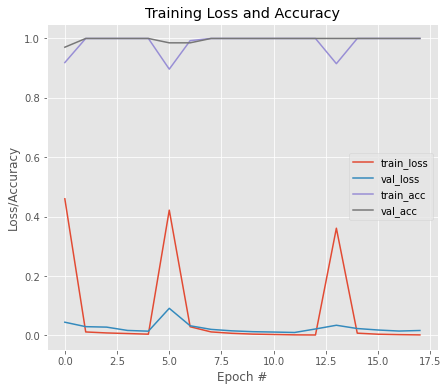


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.9875 - accuracy: 0.8635
Epoch 1: val_loss improved from inf to 0.04091, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 5s 343ms/step - loss: 0.9875 - accuracy: 0.8635 - val_loss: 0.0409 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0092 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.04091 to 0.03121, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 3s 329ms/step - loss: 0.0092 - accuracy: 1.0000 - val_loss: 0.0312 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.03121 to 0.02369, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 3s 327ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 0.0237 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=======

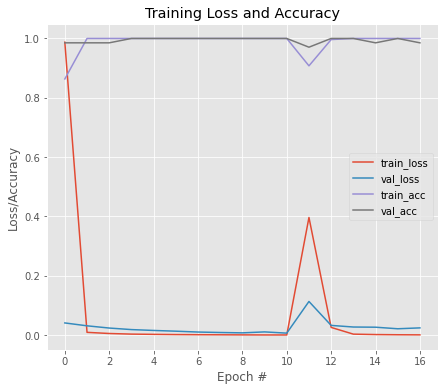


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:4
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5039 - accuracy: 0.9004
Epoch 1: val_loss improved from inf to 0.00970, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 5s 363ms/step - loss: 0.5039 - accuracy: 0.9004 - val_loss: 0.0097 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0107 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00970 to 0.00559, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 3s 343ms/step - loss: 0.0107 - accuracy: 1.0000 - val_loss: 0.0056 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0075 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00559 to 0.00335, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 3s 326ms/step - loss: 0.0075 - accuracy: 1.0000 - val_loss: 0.0034 - val_accuracy: 1.0000
Epoch 4

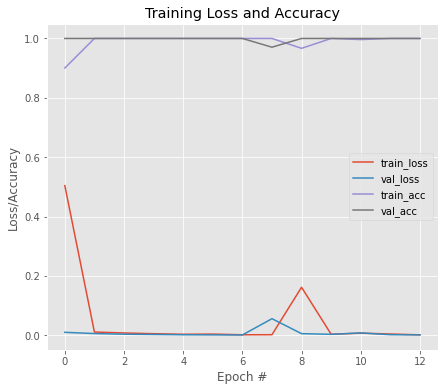


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3416 - accuracy: 0.9668
Epoch 1: val_loss improved from inf to 0.00481, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 5s 344ms/step - loss: 0.3416 - accuracy: 0.9668 - val_loss: 0.0048 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00481 to 0.00282, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 3s 344ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.0028 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00282 to 0.00153, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 3s 320ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

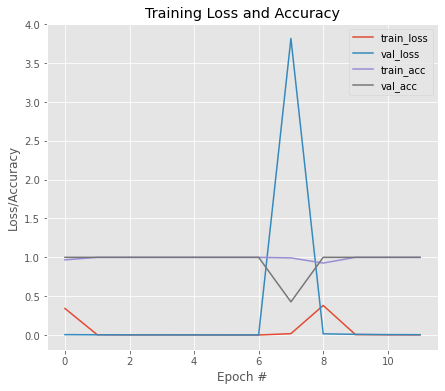


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8117 - accuracy: 0.9081
Epoch 1: val_loss improved from inf to 0.00224, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 5s 343ms/step - loss: 0.8117 - accuracy: 0.9081 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00224 to 0.00118, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 3s 327ms/step - loss: 0.0058 - accuracy: 1.0000 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00118 to 0.00082, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 3s 357ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 8.2181e-04 - val_accuracy: 1.0000
Epo

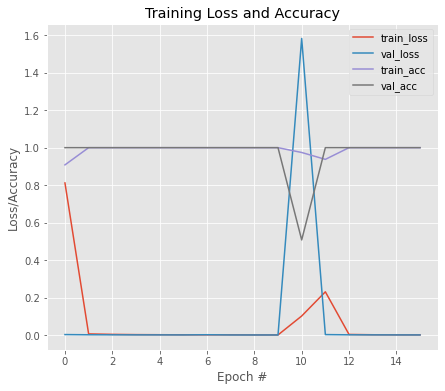


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4709 - accuracy: 0.9007
Epoch 1: val_loss improved from inf to 0.00676, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 5s 342ms/step - loss: 0.4709 - accuracy: 0.9007 - val_loss: 0.0068 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00676 to 0.00318, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 3s 329ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.0032 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00318 to 0.00162, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 3s 358ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

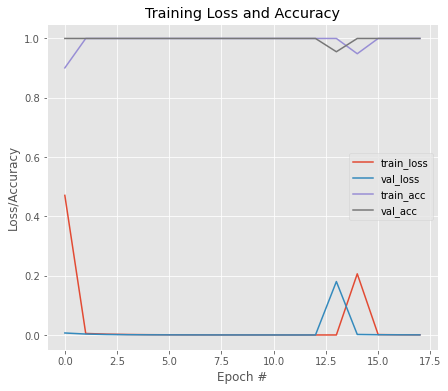


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9852941155433654
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0096 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.29438, saving model to vgg19_wt.hdf5
11/11 [==============================] - 3s 185ms/step - loss: 0.0096 - accuracy: 1.0000 - val_loss: 0.2944 - val_accuracy: 0.8767
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0095 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.29438 to 0.29416, saving model to vgg19_wt.hdf5
11/11 [==============================] - 2s 164ms/step - loss: 0.0095 - accuracy: 1.0000 - val_loss: 0.2942 - val_accuracy: 0.8767
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.29416 to 0.29406, saving model to vgg19_wt.hdf5
11/11 [==========================

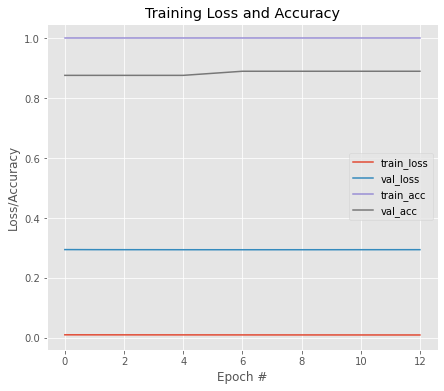


Model Performance Summary:

Best Validation accuracy:0.8904109597206116 at EPOCH:7
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.6314 - accuracy: 0.7168
Epoch 1: val_loss improved from inf to 0.49840, saving model to vgg19_wt.hdf5
11/11 [==============================] - 5s 366ms/step - loss: 1.6314 - accuracy: 0.7168 - val_loss: 0.4984 - val_accuracy: 0.7329
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.4480 - accuracy: 0.7876
Epoch 2: val_loss improved from 0.49840 to 0.45624, saving model to vgg19_wt.hdf5
11/11 [==============================] - 4s 339ms/step - loss: 0.4480 - accuracy: 0.7876 - val_loss: 0.4562 - val_accuracy: 0.7877
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.3622 - accuracy: 0.8407
Epoch 3: val_loss improved from 0.45624 to 0.40915, saving model to vgg19_wt.hdf5
11/11 [==============================] - 4s 344ms/step - loss: 0.3622 - accuracy: 0

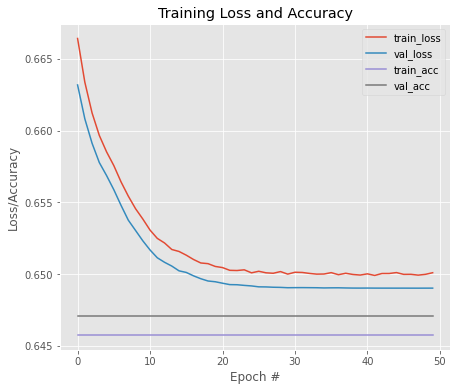


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6040 - accuracy: 0.6753
Epoch 1: val_loss improved from inf to 0.67193, saving model to resnet50_b_0.hdf5
9/9 [==============================] - 14s 416ms/step - loss: 0.6040 - accuracy: 0.6753 - val_loss: 0.6719 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3041 - accuracy: 0.9373
Epoch 2: val_loss did not improve from 0.67193
9/9 [==============================] - 2s 194ms/step - loss: 0.3041 - accuracy: 0.9373 - val_loss: 0.6804 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2006 - accuracy: 0.9852
Epoch 3: val_loss did not improve from 0.67193
9/9 [==============================] - 2s 193ms/step - loss: 0.2006 - accuracy: 0.9852 - val_loss: 0.7048 - val_accuracy: 0.3529
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1375 - a

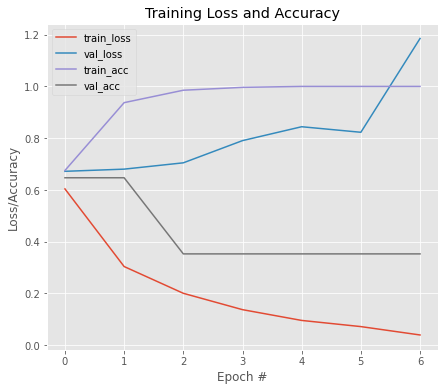


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0922 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 2.41039, saving model to resnet50_a_1.hdf5
9/9 [==============================] - 13s 387ms/step - loss: 0.0922 - accuracy: 0.9742 - val_loss: 2.4104 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0424 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 2.41039
9/9 [==============================] - 2s 196ms/step - loss: 0.0424 - accuracy: 0.9926 - val_loss: 3.4234 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0201 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 2.41039
9/9 [==============================] - 2s 197ms/step - loss: 0.0201 - accuracy: 1.0000 - val_loss: 3.8815 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

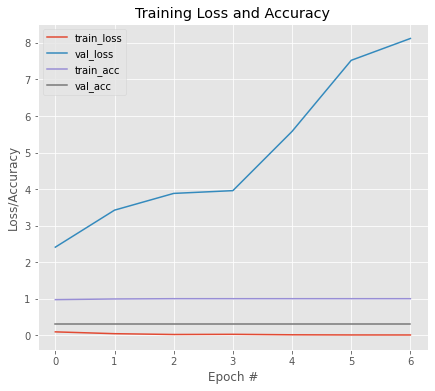


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0329 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.22507, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 13s 384ms/step - loss: 0.0329 - accuracy: 1.0000 - val_loss: 3.2251 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0123 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 3.22507
9/9 [==============================] - 2s 193ms/step - loss: 0.0123 - accuracy: 1.0000 - val_loss: 4.7009 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0106 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.22507
9/9 [==============================] - 2s 194ms/step - loss: 0.0106 - accuracy: 1.0000 - val_loss: 5.5485 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0071 - 

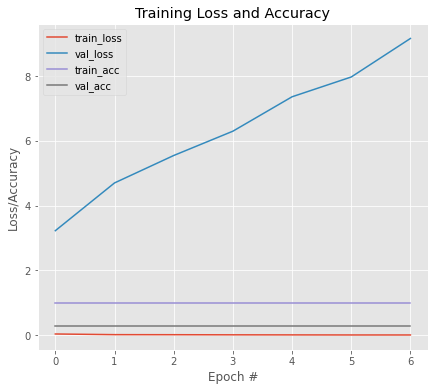


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0156 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 7.66912, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 13s 398ms/step - loss: 0.0156 - accuracy: 0.9963 - val_loss: 7.6691 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 7.66912
9/9 [==============================] - 2s 195ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 8.2893 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 7.66912
9/9 [==============================] - 2s 193ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 8.4061 - val_accuracy: 0.3824
Epoch 4/50
9/9 [==============================] - ETA: 0s -

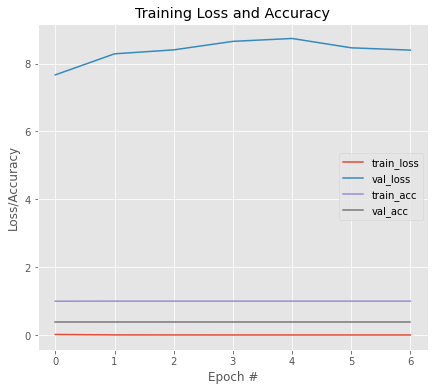


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 8.96599, saving model to resnet50_b_2.hdf5
9/9 [==============================] - 13s 381ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 8.9660 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 8.96599
9/9 [==============================] - 2s 195ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 9.0724 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 3: val_loss improved from 8.96599 to 8.78667, saving model to resnet50_b_2.hdf5
9/9 [==============================] - 2s 280ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 8.7867 - val_accuracy: 0.3824
Epoch 4/50
9/9 [====================

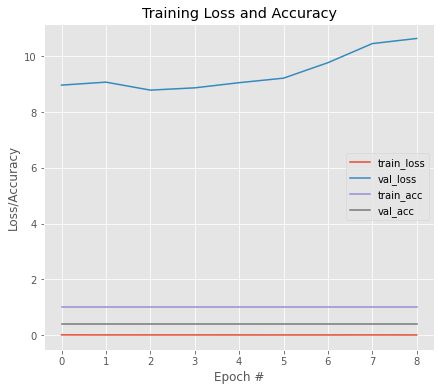


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.4268e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 10.07957, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 13s 386ms/step - loss: 4.4268e-04 - accuracy: 1.0000 - val_loss: 10.0796 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 10.07957
9/9 [==============================] - 2s 195ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 10.9825 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.3884e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 10.07957
9/9 [==============================] - 2s 195ms/step - loss: 3.3884e-04 - accuracy: 1.0000 - val_loss: 10.7375 - val_accuracy: 0.3676
Epoch 4/50
9/9 [=====================

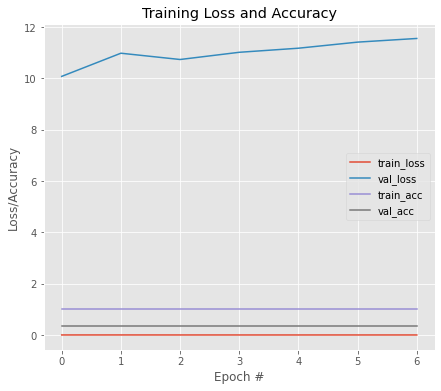


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.9757e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 10.79208, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 13s 384ms/step - loss: 4.9757e-04 - accuracy: 1.0000 - val_loss: 10.7921 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 7.9651e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 10.79208
9/9 [==============================] - 2s 196ms/step - loss: 7.9651e-05 - accuracy: 1.0000 - val_loss: 10.9486 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.3950e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 10.79208
9/9 [==============================] - 2s 193ms/step - loss: 7.3950e-05 - accuracy: 1.0000 - val_loss: 11.4355 - val_accuracy: 0.3676
Epoch 4/50
9/9 [=============================

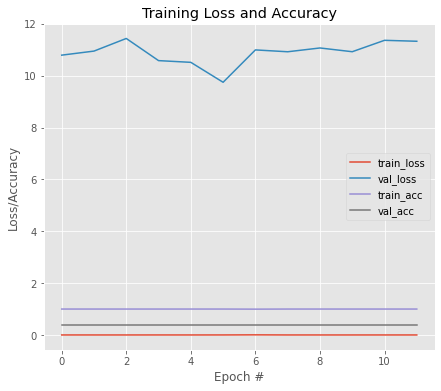


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.2573e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 10.68142, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 13s 440ms/step - loss: 5.2573e-05 - accuracy: 1.0000 - val_loss: 10.6814 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.1910e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 10.68142 to 10.26772, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 2s 283ms/step - loss: 1.1910e-04 - accuracy: 1.0000 - val_loss: 10.2677 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.1979e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 10.26772
9/9 [==============================] - 2s 196ms/step - loss: 3.1979e-05 - accuracy: 1.0000 - val_loss: 10.4058 - val_accura

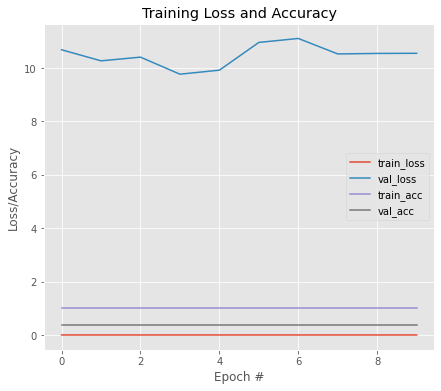


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.9439e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 9.93085, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 13s 380ms/step - loss: 2.9439e-05 - accuracy: 1.0000 - val_loss: 9.9308 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 8.1655e-06 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 9.93085
9/9 [==============================] - 2s 197ms/step - loss: 8.1655e-06 - accuracy: 1.0000 - val_loss: 10.2183 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.4675e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 9.93085
9/9 [==============================] - 2s 195ms/step - loss: 3.4675e-04 - accuracy: 1.0000 - val_loss: 10.8525 - val_accuracy: 0.3731
Epoch 4/50
9/9 [==============================] - 

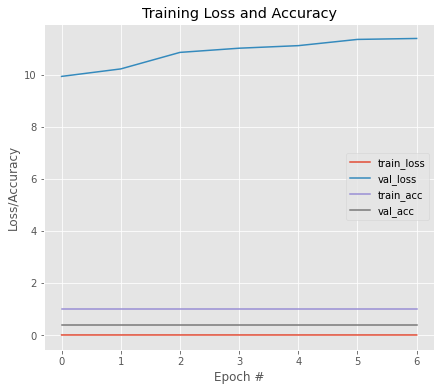


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Average Accuracy:0.41286216378211976
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.6699 - accuracy: 0.6460
Epoch 1: val_loss improved from inf to 0.66816, saving model to resnet50_wt.hdf5
11/11 [==============================] - 5s 230ms/step - loss: 0.6699 - accuracy: 0.6460 - val_loss: 0.6682 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.6662 - accuracy: 0.6460
Epoch 2: val_loss improved from 0.66816 to 0.66516, saving model to resnet50_wt.hdf5
11/11 [==============================] - 1s 135ms/step - loss: 0.6662 - accuracy: 0.6460 - val_loss: 0.6652 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.6632 - accuracy: 0.6460
Epoch 3: val_loss improved from 0.66516 to 0.66240, saving model to resnet50_wt.hdf5
11/11 [=

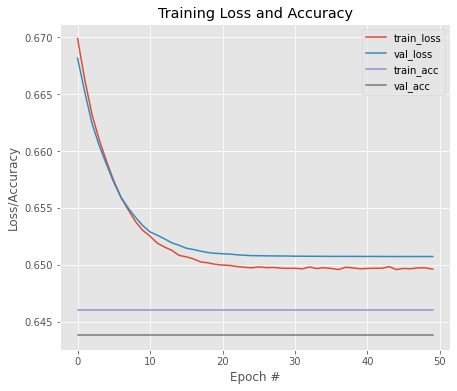


Model Performance Summary:

Best Validation accuracy:0.6438356041908264 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.2958 - accuracy: 0.9056
Epoch 1: val_loss improved from inf to 0.66050, saving model to resnet50_wt.hdf5
11/11 [==============================] - 13s 390ms/step - loss: 0.2958 - accuracy: 0.9056 - val_loss: 0.6605 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0866 - accuracy: 0.9971
Epoch 2: val_loss improved from 0.66050 to 0.65293, saving model to resnet50_wt.hdf5
11/11 [==============================] - 3s 275ms/step - loss: 0.0866 - accuracy: 0.9971 - val_loss: 0.6529 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0346 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.65293
11/11 [==============================] - 2s 215ms/step - loss: 0.0346 - accuracy: 1.0000 - val_loss: 0.7177 - v

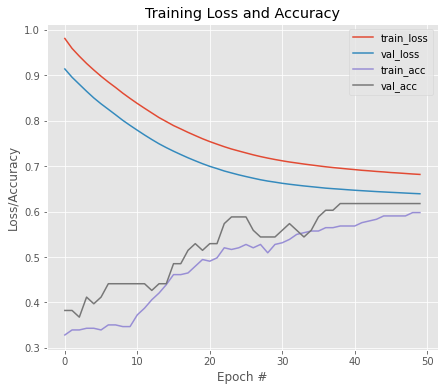


Model Performance Summary:

Best Validation accuracy:0.6176470518112183 at EPOCH:39
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.9449 - accuracy: 0.6531
Epoch 1: val_loss improved from inf to 0.61357, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 24s 589ms/step - loss: 0.9449 - accuracy: 0.6531 - val_loss: 0.6136 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5959 - accuracy: 0.6937
Epoch 2: val_loss improved from 0.61357 to 0.60377, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 3s 322ms/step - loss: 0.5959 - accuracy: 0.6937 - val_loss: 0.6038 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4459 - accuracy: 0.7565
Epoch 3: val_loss improved from 0.60377 to 0.60078, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 3s 318ms/step - loss: 0.4459 - accuracy: 0.7565 - val_loss: 0.6008 - val_accur

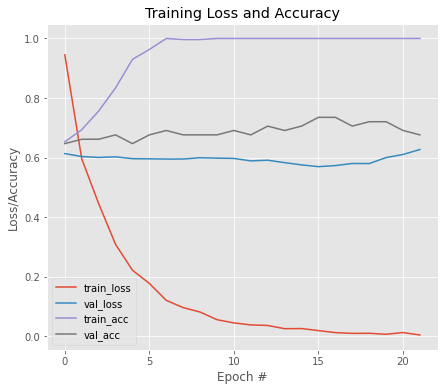


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:16
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1068 - accuracy: 0.9520
Epoch 1: val_loss improved from inf to 0.65139, saving model to DenseNet121_a_1.hdf5
9/9 [==============================] - 23s 521ms/step - loss: 0.1068 - accuracy: 0.9520 - val_loss: 0.6514 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0512 - accuracy: 0.9815
Epoch 2: val_loss did not improve from 0.65139
9/9 [==============================] - 2s 222ms/step - loss: 0.0512 - accuracy: 0.9815 - val_loss: 0.6729 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0195 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.65139
9/9 [==============================] - 2s 218ms/step - loss: 0.0195 - accuracy: 0.9963 - val_loss: 0.6852 - val_accuracy: 0.7206
Epoch 4/50
9/9 [==============================] - ETA: 0

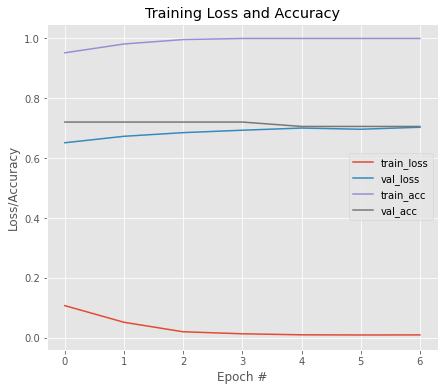


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0409 - accuracy: 0.9889
Epoch 1: val_loss improved from inf to 0.67217, saving model to DenseNet121_b_1.hdf5
9/9 [==============================] - 23s 585ms/step - loss: 0.0409 - accuracy: 0.9889 - val_loss: 0.6722 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.67217
9/9 [==============================] - 2s 217ms/step - loss: 0.0109 - accuracy: 1.0000 - val_loss: 0.6835 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0082 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.67217
9/9 [==============================] - 2s 219ms/step - loss: 0.0082 - accuracy: 1.0000 - val_loss: 0.6938 - val_accuracy: 0.7206
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0070 -

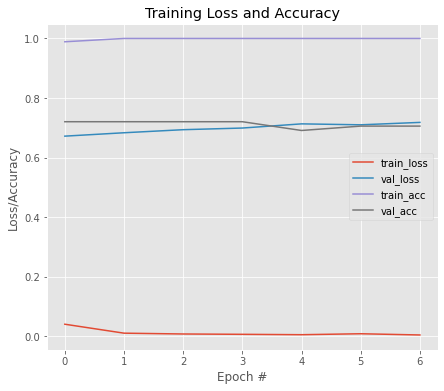


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.84233, saving model to DenseNet121_a_2.hdf5
9/9 [==============================] - 22s 523ms/step - loss: 0.0039 - accuracy: 1.0000 - val_loss: 0.8423 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.84233
9/9 [==============================] - 2s 223ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.8523 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.84233
9/9 [==============================] - 2s 220ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.8739 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s 

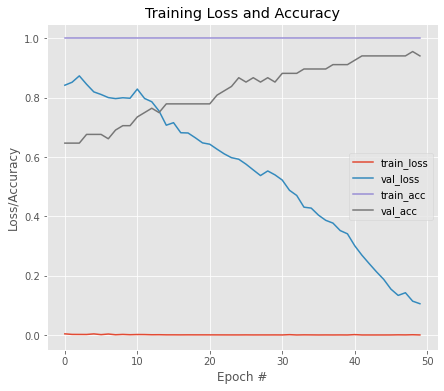


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.1367e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.06193, saving model to DenseNet121_b_2.hdf5
9/9 [==============================] - 22s 517ms/step - loss: 2.1367e-05 - accuracy: 1.0000 - val_loss: 0.0619 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.9556e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.06193
9/9 [==============================] - 2s 219ms/step - loss: 1.9556e-05 - accuracy: 1.0000 - val_loss: 0.0704 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.3300e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.06193
9/9 [==============================] - 2s 219ms/step - loss: 7.3300e-05 - accuracy: 1.0000 - val_loss: 0.0815 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] 

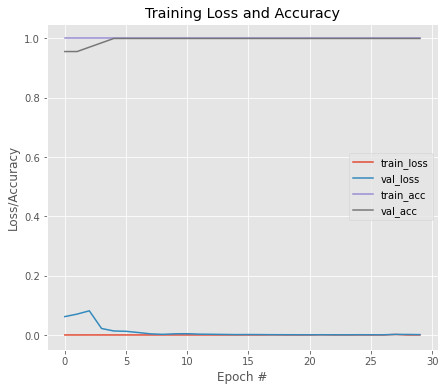


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:5
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0083 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_a_3.hdf5
9/9 [==============================] - 23s 523ms/step - loss: 0.0083 - accuracy: 0.9963 - val_loss: 4.1442e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0102 - accuracy: 0.9963
Epoch 2: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 219ms/step - loss: 0.0102 - accuracy: 0.9963 - val_loss: 5.9762e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.0036e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 219ms/step - loss: 1.0036e-04 - accuracy: 1.0000 - val_loss: 4.7946e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ET

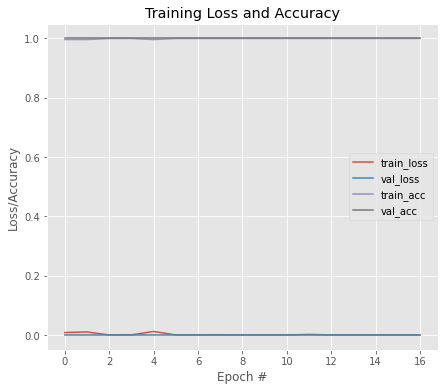


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.2855e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 22s 521ms/step - loss: 4.2855e-04 - accuracy: 1.0000 - val_loss: 3.6043e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.0097e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 3s 330ms/step - loss: 4.0097e-05 - accuracy: 1.0000 - val_loss: 2.8049e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.5878e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 3s 320ms/step - loss: 2.5878e-05 - accuracy: 1.0000 - val_loss: 2.

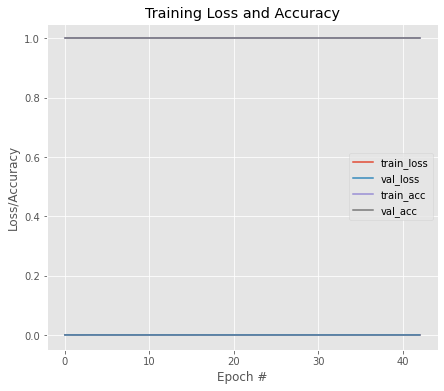


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.2811e-06 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_a_4.hdf5
9/9 [==============================] - 23s 657ms/step - loss: 1.2811e-06 - accuracy: 1.0000 - val_loss: 3.4695e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.4875e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to DenseNet121_a_4.hdf5
9/9 [==============================] - 3s 316ms/step - loss: 2.4875e-06 - accuracy: 1.0000 - val_loss: 2.5087e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.8853e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 218ms/step - loss: 3.8853e-05 - accuracy: 1.0000 - val_loss: 3.2560e-07 - val_accuracy: 1

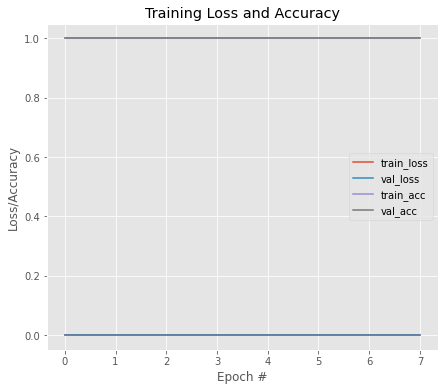


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.6515e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_b_4.hdf5
9/9 [==============================] - 22s 517ms/step - loss: 2.6515e-05 - accuracy: 1.0000 - val_loss: 2.9535e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.8656e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to DenseNet121_b_4.hdf5
9/9 [==============================] - 3s 331ms/step - loss: 4.8656e-06 - accuracy: 1.0000 - val_loss: 2.5621e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.8475e-06 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 2s 221ms/step - loss: 3.8475e-06 - accuracy: 1.0000 - val_loss: 3.9499e-07 - val_accuracy: 1.0000
Epoch 4/50

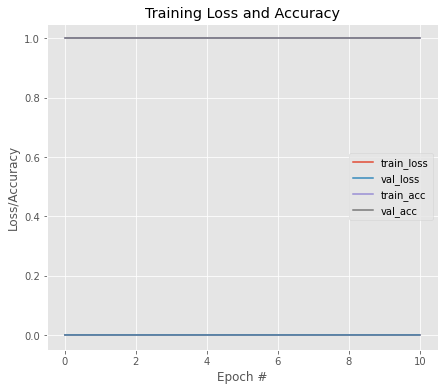


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8911764621734619
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.3442e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.44924, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 9s 341ms/step - loss: 1.3442e-04 - accuracy: 1.0000 - val_loss: 0.4492 - val_accuracy: 0.8767
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 1.3249e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.44924 to 0.44924, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 2s 150ms/step - loss: 1.3249e-04 - accuracy: 1.0000 - val_loss: 0.4492 - val_accuracy: 0.8767
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 1.3119e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.44924
11/11 [=============================

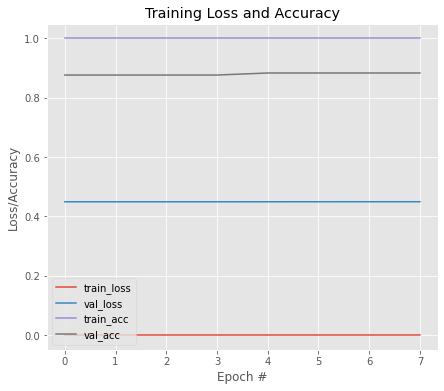


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:5
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0077 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.76521, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 24s 533ms/step - loss: 0.0077 - accuracy: 0.9971 - val_loss: 0.7652 - val_accuracy: 0.7808
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 8.6649e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.76521 to 0.63302, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 3s 313ms/step - loss: 8.6649e-04 - accuracy: 1.0000 - val_loss: 0.6330 - val_accuracy: 0.8082
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 1.3303e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.63302 to 0.61825, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 3s 313ms/st

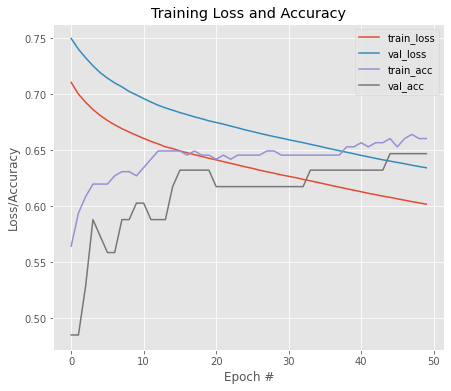


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:45
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6404 - accuracy: 0.6679
Epoch 1: val_loss improved from inf to 0.66826, saving model to MobileNet_b_0.hdf5
9/9 [==============================] - 6s 254ms/step - loss: 0.6404 - accuracy: 0.6679 - val_loss: 0.6683 - val_accuracy: 0.6029
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4922 - accuracy: 0.7491
Epoch 2: val_loss did not improve from 0.66826
9/9 [==============================] - 1s 160ms/step - loss: 0.4922 - accuracy: 0.7491 - val_loss: 0.7244 - val_accuracy: 0.5588
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4000 - accuracy: 0.8339
Epoch 3: val_loss did not improve from 0.66826
9/9 [==============================] - 1s 162ms/step - loss: 0.4000 - accuracy: 0.8339 - val_loss: 0.8300 - val_accuracy: 0.5588
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.3349 - 

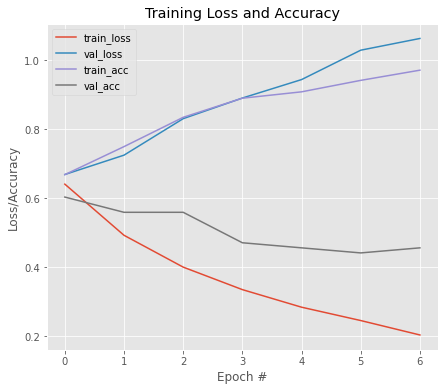


Model Performance Summary:

Best Validation accuracy:0.6029411554336548 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2273 - accuracy: 0.9520
Epoch 1: val_loss improved from inf to 1.16037, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 6s 245ms/step - loss: 0.2273 - accuracy: 0.9520 - val_loss: 1.1604 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1726 - accuracy: 0.9779
Epoch 2: val_loss improved from 1.16037 to 1.15774, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 2s 190ms/step - loss: 0.1726 - accuracy: 0.9779 - val_loss: 1.1577 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1405 - accuracy: 0.9815
Epoch 3: val_loss improved from 1.15774 to 1.09382, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 2s 190ms/step - loss: 0.1405 - accuracy: 0.9815 - val_loss: 1.0938 - v

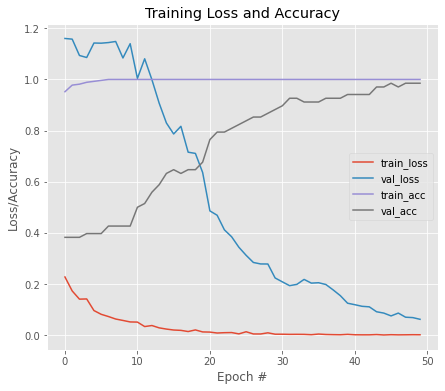


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:46
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 8.2006e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.06431, saving model to MobileNet_b_1.hdf5
9/9 [==============================] - 6s 243ms/step - loss: 8.2006e-04 - accuracy: 1.0000 - val_loss: 0.0643 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.9229e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.06431
9/9 [==============================] - 1s 164ms/step - loss: 6.9229e-04 - accuracy: 1.0000 - val_loss: 0.0923 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.5821e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.06431
9/9 [==============================] - 1s 173ms/step - loss: 7.5821e-04 - accuracy: 1.0000 - val_loss: 0.0767 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] - E

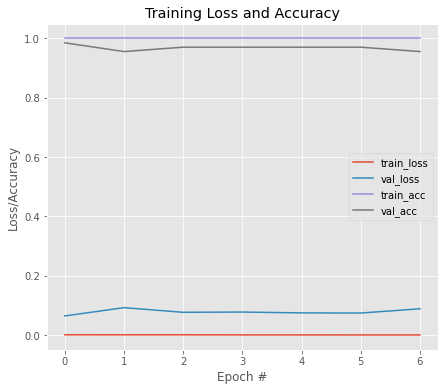


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0119 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.00010, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 6s 246ms/step - loss: 0.0119 - accuracy: 0.9963 - val_loss: 9.9654e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0082 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00010 to 0.00008, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 2s 189ms/step - loss: 0.0082 - accuracy: 1.0000 - val_loss: 8.3850e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00008
9/9 [==============================] - 1s 157ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 9.0813e-05 - val_accuracy: 1.0000
Epoch 4/

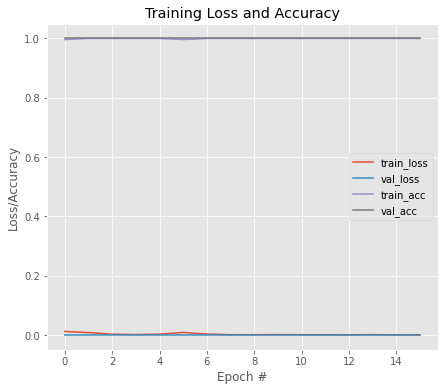


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 9.2552e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00007, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 6s 238ms/step - loss: 9.2552e-04 - accuracy: 1.0000 - val_loss: 7.0181e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00007
9/9 [==============================] - 1s 159ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 7.6701e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.7149e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00007 to 0.00006, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 2s 190ms/step - loss: 2.7149e-04 - accuracy: 1.0000 - val_loss: 6.3630e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======

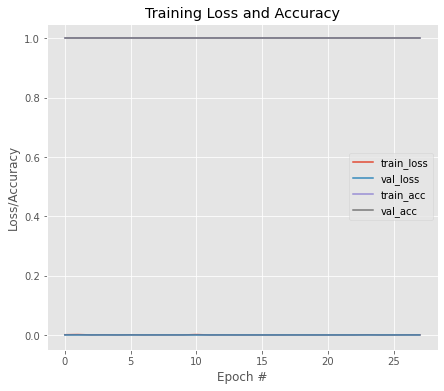


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 6s 241ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 1.1221e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.0797e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 2s 187ms/step - loss: 6.0797e-05 - accuracy: 1.0000 - val_loss: 1.0184e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.8001e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 2s 188ms/step - loss: 1.8001e-04 - accuracy: 1.0000 - val_loss: 9

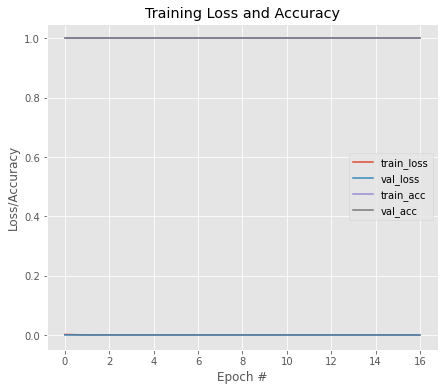


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.1571e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 6s 251ms/step - loss: 3.1571e-05 - accuracy: 1.0000 - val_loss: 6.7195e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.2337e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 2s 188ms/step - loss: 4.2337e-05 - accuracy: 1.0000 - val_loss: 6.3058e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 9.8363e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00000, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 2s 188ms/step - loss: 9.8363e-05 - accuracy: 1.0000 - val_loss: 4.7315e-0

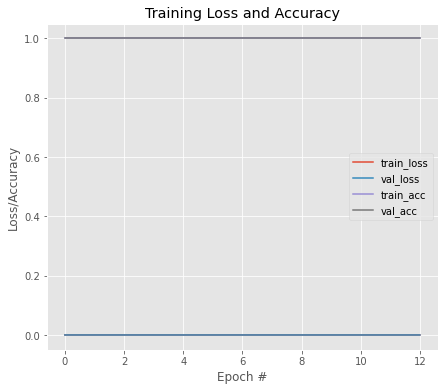


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.9714e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 6s 267ms/step - loss: 3.9714e-05 - accuracy: 1.0000 - val_loss: 3.7150e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.5939e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00000
9/9 [==============================] - 1s 161ms/step - loss: 6.5939e-05 - accuracy: 1.0000 - val_loss: 3.8787e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 6.7093e-06 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 1s 163ms/step - loss: 6.7093e-06 - accuracy: 1.0000 - val_loss: 3.9962e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======================

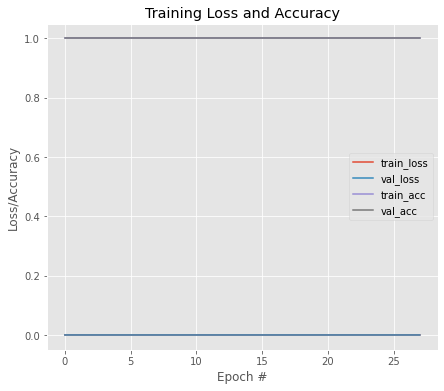


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.2441e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to MobileNet_b_4.hdf5
9/9 [==============================] - 6s 241ms/step - loss: 2.2441e-05 - accuracy: 1.0000 - val_loss: 1.1690e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.6680e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to MobileNet_b_4.hdf5
9/9 [==============================] - 2s 190ms/step - loss: 1.6680e-06 - accuracy: 1.0000 - val_loss: 1.0604e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.0595e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 1s 159ms/step - loss: 1.0595e-05 - accuracy: 1.0000 - val_loss: 1.1067e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 

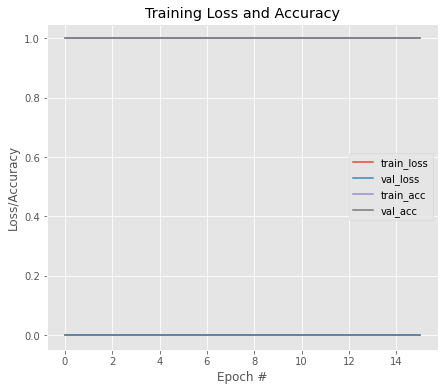


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9176470518112183
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.7391e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.45893, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 3s 122ms/step - loss: 1.7391e-05 - accuracy: 1.0000 - val_loss: 0.4589 - val_accuracy: 0.8630
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 1.5415e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.45893 to 0.45633, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 1s 69ms/step - loss: 1.5415e-05 - accuracy: 1.0000 - val_loss: 0.4563 - val_accuracy: 0.8630
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 1.4132e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.45633 to 0.45439, saving model to MobileNet_wt.hdf5
11

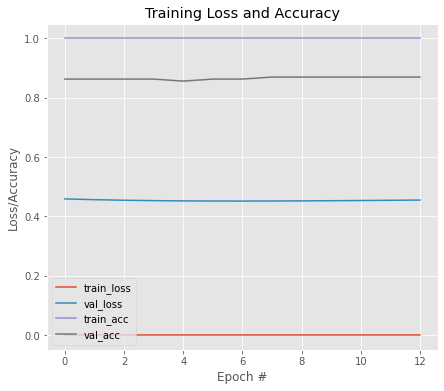


Model Performance Summary:

Best Validation accuracy:0.8698630332946777 at EPOCH:8
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 3.0889e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.42398, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 6s 245ms/step - loss: 3.0889e-04 - accuracy: 1.0000 - val_loss: 0.4240 - val_accuracy: 0.8767
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 4.0750e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.42398 to 0.38685, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 2s 186ms/step - loss: 4.0750e-04 - accuracy: 1.0000 - val_loss: 0.3868 - val_accuracy: 0.8767
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 4.3132e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.38685
11/11 [==============================] - 2s 164ms/step - loss: 4.3132e-05 - accuracy: 1.00

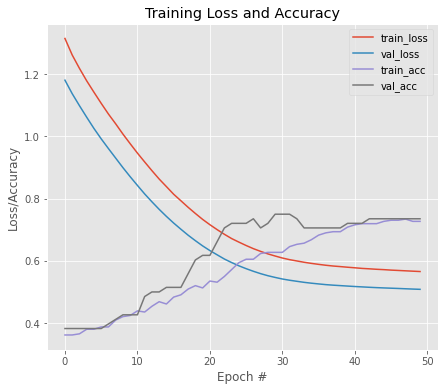


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:30
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6613 - accuracy: 0.6458
Epoch 1: val_loss improved from inf to 0.50349, saving model to MobileNetV2_b_0.hdf5
9/9 [==============================] - 10s 325ms/step - loss: 0.6613 - accuracy: 0.6458 - val_loss: 0.5035 - val_accuracy: 0.7794
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5114 - accuracy: 0.7491
Epoch 2: val_loss did not improve from 0.50349
9/9 [==============================] - 2s 176ms/step - loss: 0.5114 - accuracy: 0.7491 - val_loss: 0.5059 - val_accuracy: 0.7941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4483 - accuracy: 0.8007
Epoch 3: val_loss did not improve from 0.50349
9/9 [==============================] - 2s 172ms/step - loss: 0.4483 - accuracy: 0.8007 - val_loss: 0.5136 - val_accuracy: 0.7794
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.3938 - accuracy: 0

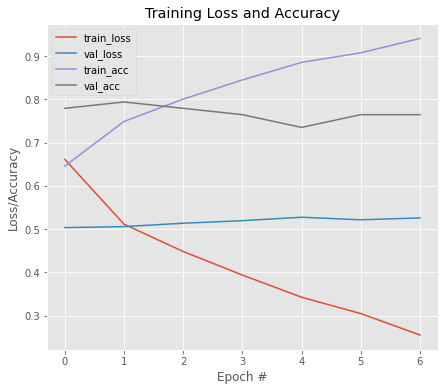


Model Performance Summary:

Best Validation accuracy:0.7941176295280457 at EPOCH:2
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2881 - accuracy: 0.9188
Epoch 1: val_loss improved from inf to 0.65063, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 10s 312ms/step - loss: 0.2881 - accuracy: 0.9188 - val_loss: 0.6506 - val_accuracy: 0.6176
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2234 - accuracy: 0.9373
Epoch 2: val_loss did not improve from 0.65063
9/9 [==============================] - 2s 174ms/step - loss: 0.2234 - accuracy: 0.9373 - val_loss: 0.6598 - val_accuracy: 0.6176
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1849 - accuracy: 0.9815
Epoch 3: val_loss did not improve from 0.65063
9/9 [==============================] - 2s 176ms/step - loss: 0.1849 - accuracy: 0.9815 - val_loss: 0.6611 - val_accuracy: 0.6176
Epoch 4/50
9/9 [==============================] - ETA: 0s

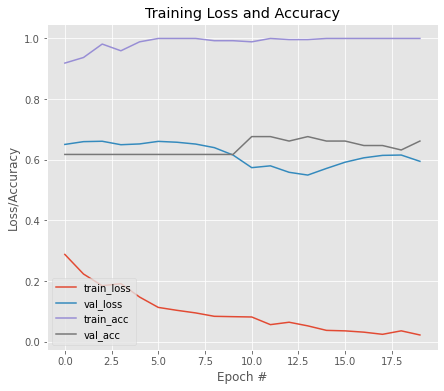


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:11
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0424 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.57329, saving model to MobileNetV2_b_1.hdf5
9/9 [==============================] - 10s 305ms/step - loss: 0.0424 - accuracy: 0.9963 - val_loss: 0.5733 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0336 - accuracy: 0.9963
Epoch 2: val_loss did not improve from 0.57329
9/9 [==============================] - 2s 176ms/step - loss: 0.0336 - accuracy: 0.9963 - val_loss: 0.5794 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0239 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.57329
9/9 [==============================] - 2s 172ms/step - loss: 0.0239 - accuracy: 1.0000 - val_loss: 0.6228 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0258

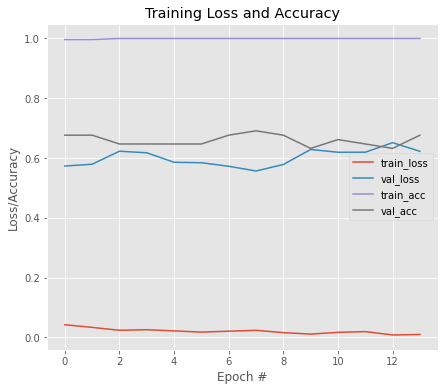


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:8
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0454 - accuracy: 0.9889
Epoch 1: val_loss improved from inf to 0.63811, saving model to MobileNetV2_a_2.hdf5
9/9 [==============================] - 10s 308ms/step - loss: 0.0454 - accuracy: 0.9889 - val_loss: 0.6381 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0294 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.63811
9/9 [==============================] - 2s 172ms/step - loss: 0.0294 - accuracy: 0.9926 - val_loss: 0.6721 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0164 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.63811
9/9 [==============================] - 2s 176ms/step - loss: 0.0164 - accuracy: 1.0000 - val_loss: 0.6646 - val_accuracy: 0.7206
Epoch 4/50
9/9 [==============================] - ETA: 0s

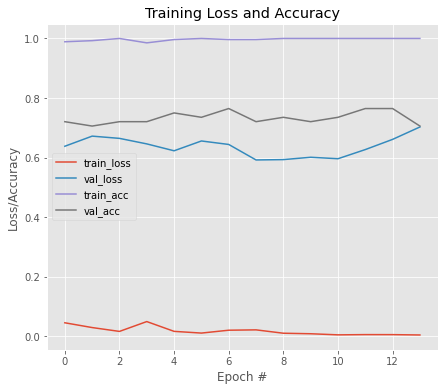


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:7
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0091 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.62459, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 10s 304ms/step - loss: 0.0091 - accuracy: 1.0000 - val_loss: 0.6246 - val_accuracy: 0.7647
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0071 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.62459
9/9 [==============================] - 2s 177ms/step - loss: 0.0071 - accuracy: 1.0000 - val_loss: 0.6563 - val_accuracy: 0.7647
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.62459
9/9 [==============================] - 2s 173ms/step - loss: 0.0040 - accuracy: 1.0000 - val_loss: 0.6455 - val_accuracy: 0.7647
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0041 

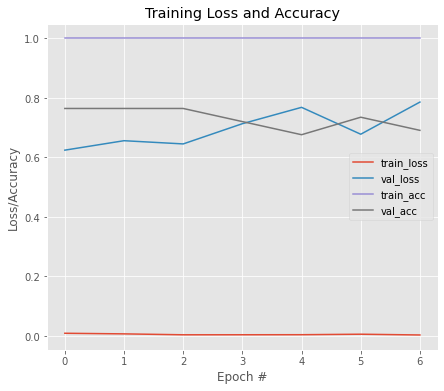


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0069 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.64432, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 10s 316ms/step - loss: 0.0069 - accuracy: 1.0000 - val_loss: 0.6443 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.64432 to 0.62949, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 2s 217ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.6295 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.62949
9/9 [==============================] - 2s 177ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 0.6631 - val_accuracy: 0.6912
Epoch 4/50
9/9 

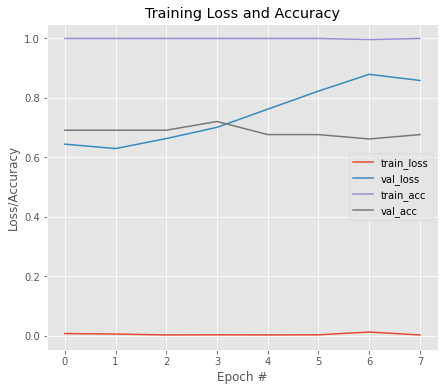


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.72018, saving model to MobileNetV2_b_3.hdf5
9/9 [==============================] - 10s 309ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 0.7202 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.72018
9/9 [==============================] - 2s 175ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.7573 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0045 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.72018
9/9 [==============================] - 2s 175ms/step - loss: 0.0045 - accuracy: 1.0000 - val_loss: 0.9194 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0023 -

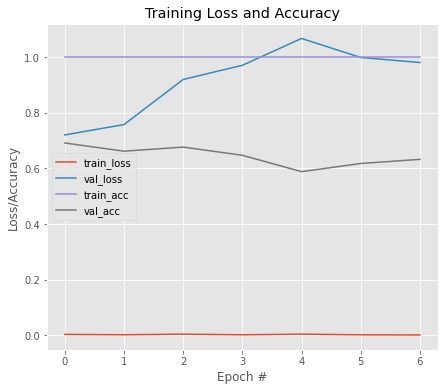


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 1.07970, saving model to MobileNetV2_a_4.hdf5
9/9 [==============================] - 10s 349ms/step - loss: 0.0039 - accuracy: 1.0000 - val_loss: 1.0797 - val_accuracy: 0.5522
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 7.7882e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.07970
9/9 [==============================] - 2s 173ms/step - loss: 7.7882e-04 - accuracy: 1.0000 - val_loss: 1.1293 - val_accuracy: 0.5672
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0010 - accuracy: 1.0000    
Epoch 3: val_loss did not improve from 1.07970
9/9 [==============================] - 2s 176ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 1.1125 - val_accuracy: 0.5522
Epoch 4/50
9/9 [=============================

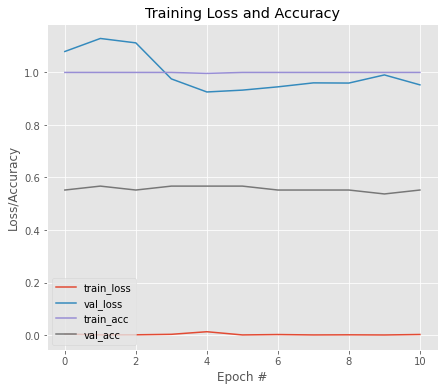


Model Performance Summary:

Best Validation accuracy:0.5671641826629639 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.83972, saving model to MobileNetV2_b_4.hdf5
9/9 [==============================] - 10s 307ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 0.8397 - val_accuracy: 0.6119
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.1736e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.83972
9/9 [==============================] - 2s 176ms/step - loss: 6.1736e-04 - accuracy: 1.0000 - val_loss: 0.8962 - val_accuracy: 0.5672
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000    
Epoch 3: val_loss did not improve from 0.83972
9/9 [==============================] - 2s 173ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.9165 - val_accuracy: 0.5522
Epoch 4/50
9/9 [==============================] - ETA: 0s - l

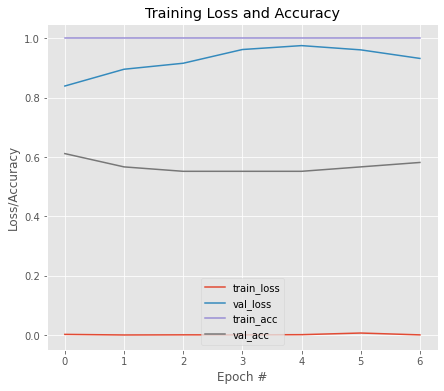


Model Performance Summary:

Best Validation accuracy:0.611940324306488 at EPOCH:1
Average Accuracy:0.7106233596801758
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
10/11 [==========================>...] - ETA: 0s - loss: 0.5314 - accuracy: 0.7427
Epoch 1: val_loss improved from inf to 0.55988, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 4s 172ms/step - loss: 0.5460 - accuracy: 0.7257 - val_loss: 0.5599 - val_accuracy: 0.6986
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.5411 - accuracy: 0.7345
Epoch 2: val_loss improved from 0.55988 to 0.55558, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 1s 82ms/step - loss: 0.5411 - accuracy: 0.7345 - val_loss: 0.5556 - val_accuracy: 0.6986
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.5380 - accuracy: 0.7375
Epoch 3: val_loss improved from 0.55558 to 0.55223, saving model to MobileNetV2_wt.hdf5
11

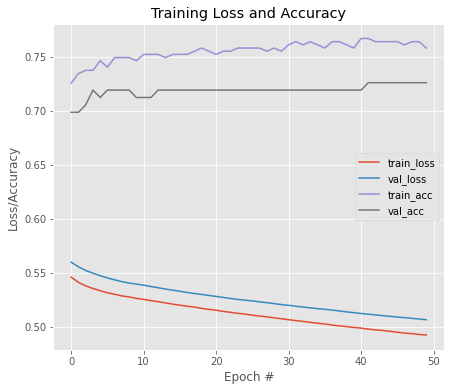


Model Performance Summary:

Best Validation accuracy:0.7260273694992065 at EPOCH:42
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.4915 - accuracy: 0.7699
Epoch 1: val_loss improved from inf to 0.52657, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 10s 307ms/step - loss: 0.4915 - accuracy: 0.7699 - val_loss: 0.5266 - val_accuracy: 0.7123
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.3029 - accuracy: 0.8909
Epoch 2: val_loss improved from 0.52657 to 0.52379, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 2s 212ms/step - loss: 0.3029 - accuracy: 0.8909 - val_loss: 0.5238 - val_accuracy: 0.6986
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2173 - accuracy: 0.9587
Epoch 3: val_loss improved from 0.52379 to 0.52093, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 2s 215ms/step - loss: 

In [ ]:
for model in MODEL_LIST_1:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1,data_aug=False,dataset = 'RIM-ONE_dl')
  gc.collect()

Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6690 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.65733, saving model to xception_a_0.hdf5
9/9 [==============================] - 6s 341ms/step - loss: 0.6690 - accuracy: 0.6494 - val_loss: 0.6573 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6663 - accuracy: 0.6494
Epoch 2: val_loss improved from 0.65733 to 0.65574, saving model to xception_a_0.hdf5
9/9 [==============================] - 2s 215ms/step - loss: 0.6663 - accuracy: 0.6494 - val_loss: 0.6557 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6643 - accuracy: 0.6494
Epoch 3: val_loss improved from 0.65574 to 0.65438, saving model to xception_a_0.hdf5
9/9 [==============================] - 2s 231ms/step - loss: 0.6643 - accuracy: 0.6494 - val_loss: 0.6544 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0

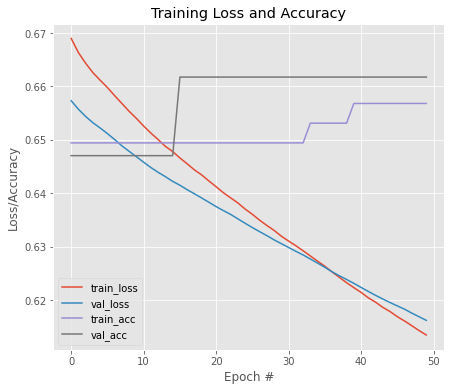


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:16
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6157 - accuracy: 0.6679
Epoch 1: val_loss improved from inf to 0.59971, saving model to xception_b_0.hdf5
9/9 [==============================] - 16s 933ms/step - loss: 0.6157 - accuracy: 0.6679 - val_loss: 0.5997 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5222 - accuracy: 0.7491
Epoch 2: val_loss improved from 0.59971 to 0.59002, saving model to xception_b_0.hdf5
9/9 [==============================] - 7s 785ms/step - loss: 0.5222 - accuracy: 0.7491 - val_loss: 0.5900 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4716 - accuracy: 0.8192
Epoch 3: val_loss improved from 0.59002 to 0.58306, saving model to xception_b_0.hdf5
9/9 [==============================] - 7s 787ms/step - loss: 0.4716 - accuracy: 0.8192 - val_loss: 0.5831 - val_accuracy: 0.67

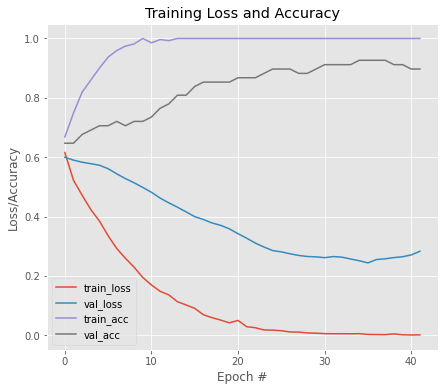


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:35
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0868 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 0.00050, saving model to xception_a_1.hdf5
9/9 [==============================] - 15s 874ms/step - loss: 0.0868 - accuracy: 0.9742 - val_loss: 4.9757e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0265 - accuracy: 0.9926
Epoch 2: val_loss improved from 0.00050 to 0.00046, saving model to xception_a_1.hdf5
9/9 [==============================] - 7s 787ms/step - loss: 0.0265 - accuracy: 0.9926 - val_loss: 4.6475e-04 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0212 - accuracy: 0.9926
Epoch 3: val_loss improved from 0.00046 to 0.00043, saving model to xception_a_1.hdf5
9/9 [==============================] - 7s 791ms/step - loss: 0.0212 - accuracy: 0.9926 - val_loss: 4.2

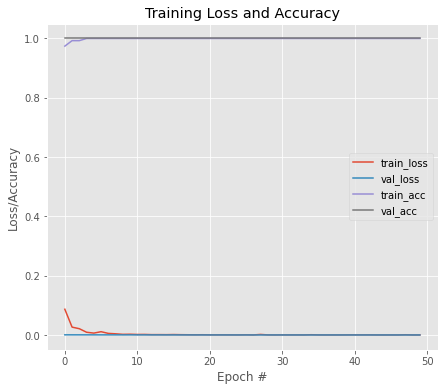


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.5848e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to xception_b_1.hdf5
9/9 [==============================] - 15s 879ms/step - loss: 2.5848e-04 - accuracy: 1.0000 - val_loss: 1.2149e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.0977e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
9/9 [==============================] - 6s 712ms/step - loss: 2.0977e-04 - accuracy: 1.0000 - val_loss: 1.2375e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 4.7624e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
9/9 [==============================] - 6s 708ms/step - loss: 4.7624e-05 - accuracy: 1.0000 - val_loss: 1.2576e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 

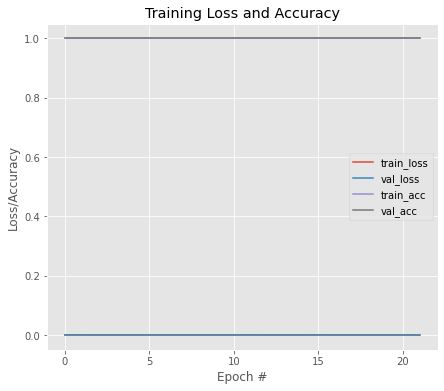


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.2176e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_a_2.hdf5
9/9 [==============================] - 15s 877ms/step - loss: 3.2176e-05 - accuracy: 1.0000 - val_loss: 3.5956e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.2008e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to xception_a_2.hdf5
9/9 [==============================] - 7s 789ms/step - loss: 1.2008e-05 - accuracy: 1.0000 - val_loss: 3.5412e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 4.7902e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to xception_a_2.hdf5
9/9 [==============================] - 7s 788ms/step - loss: 4.7902e-05 - accuracy: 1.0000 - val_l

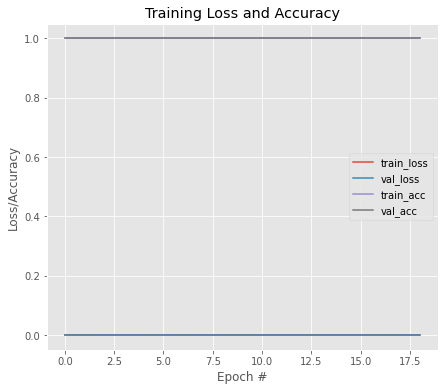


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.6731e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_b_2.hdf5
9/9 [==============================] - 15s 880ms/step - loss: 1.6731e-05 - accuracy: 1.0000 - val_loss: 1.9389e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 9.8123e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to xception_b_2.hdf5
9/9 [==============================] - 7s 835ms/step - loss: 9.8123e-06 - accuracy: 1.0000 - val_loss: 1.8022e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 5.9155e-06 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to xception_b_2.hdf5
9/9 [==============================] - 7s 789ms/step - loss: 5.9155e-06 - accuracy: 1.0000 - val_loss: 1.7531e-06 

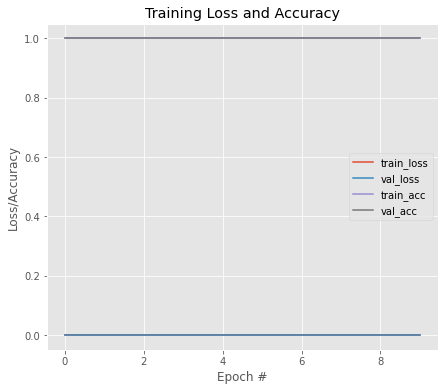


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.4357e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_a_3.hdf5
9/9 [==============================] - 15s 880ms/step - loss: 1.4357e-05 - accuracy: 1.0000 - val_loss: 9.2387e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 7.5092e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to xception_a_3.hdf5
9/9 [==============================] - 7s 785ms/step - loss: 7.5092e-06 - accuracy: 1.0000 - val_loss: 8.6251e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.1213e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 6s 710ms/step - loss: 1.1213e-05 - accuracy: 1.0000 - val_loss: 9.3088e-07 - val_accuracy: 1.0000


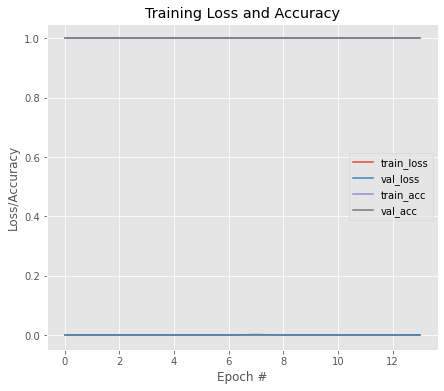


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.6469e-06 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_b_3.hdf5
9/9 [==============================] - 15s 887ms/step - loss: 4.6469e-06 - accuracy: 1.0000 - val_loss: 5.5397e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.3347e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to xception_b_3.hdf5
9/9 [==============================] - 7s 786ms/step - loss: 3.3347e-06 - accuracy: 1.0000 - val_loss: 5.1716e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.0067e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 6s 710ms/step - loss: 1.0067e-05 - accuracy: 1.0000 - val_loss: 5.2417e-07 - val_accuracy: 1.0000
Epoch 4/50
9/9 [

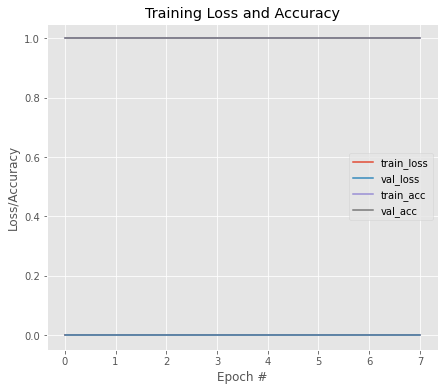


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.2779e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_a_4.hdf5
9/9 [==============================] - 16s 954ms/step - loss: 3.2779e-05 - accuracy: 1.0000 - val_loss: 5.1598e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.8884e-06 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00000
9/9 [==============================] - 6s 710ms/step - loss: 4.8884e-06 - accuracy: 1.0000 - val_loss: 5.2488e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.8733e-06 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 6s 713ms/step - loss: 7.8733e-06 - accuracy: 1.0000 - val_loss: 5.6580e-07 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======================

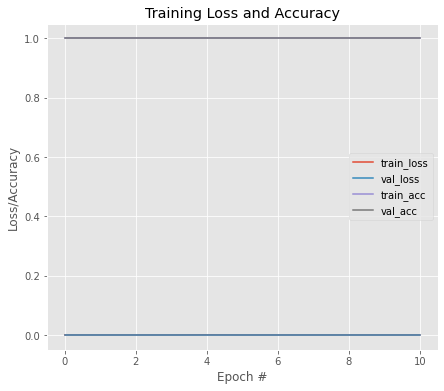


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.5665e-06 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to xception_b_4.hdf5
9/9 [==============================] - 15s 882ms/step - loss: 2.5665e-06 - accuracy: 1.0000 - val_loss: 4.5904e-07 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.0464e-06 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to xception_b_4.hdf5
9/9 [==============================] - 7s 788ms/step - loss: 3.0464e-06 - accuracy: 1.0000 - val_loss: 4.5193e-07 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.1730e-06 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to xception_b_4.hdf5
9/9 [==============================] - 7s 793ms/step - loss: 3.1730e-06 - accuracy: 1.0000 - val_loss: 4.3947e-07 

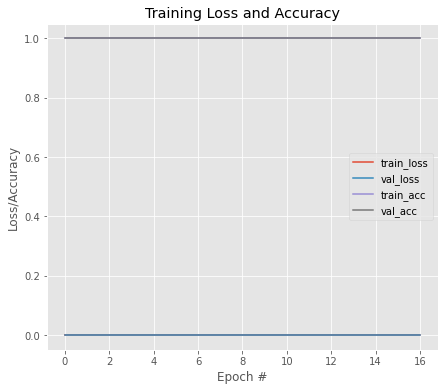


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9852941155433654
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 6.7967e-06 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.40639, saving model to xception_wt.hdf5
11/11 [==============================] - 6s 344ms/step - loss: 6.7967e-06 - accuracy: 1.0000 - val_loss: 0.4064 - val_accuracy: 0.8425
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 6.5858e-06 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.40639
11/11 [==============================] - 2s 199ms/step - loss: 6.5858e-06 - accuracy: 1.0000 - val_loss: 0.4074 - val_accuracy: 0.8425
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 6.4160e-06 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.40639
11/11 [==============================] - 2s 198ms/step - loss: 6.4160e-06 - accu

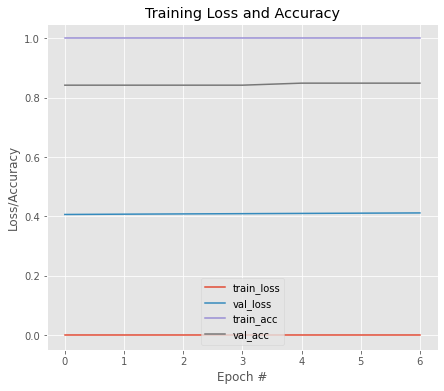


Model Performance Summary:

Best Validation accuracy:0.8493150472640991 at EPOCH:5
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 6.7305e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.42924, saving model to xception_wt.hdf5
11/11 [==============================] - 17s 915ms/step - loss: 6.7305e-05 - accuracy: 1.0000 - val_loss: 0.4292 - val_accuracy: 0.8493
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 4.7509e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.42924
11/11 [==============================] - 8s 751ms/step - loss: 4.7509e-05 - accuracy: 1.0000 - val_loss: 0.4491 - val_accuracy: 0.8493
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 8.8229e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.42924
11/11 [==============================] - 8s 750ms/step - loss: 8.8229e-05 - accuracy: 1.0000 - val_loss: 0.4442 - val_accuracy: 0

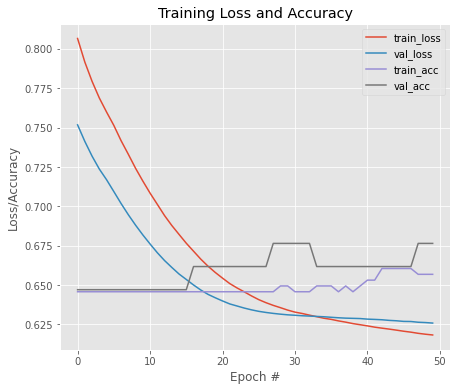


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:28
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7162 - accuracy: 0.4723
Epoch 1: val_loss improved from inf to 0.60984, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 41s 1s/step - loss: 0.7162 - accuracy: 0.4723 - val_loss: 0.6098 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5572 - accuracy: 0.7565
Epoch 2: val_loss improved from 0.60984 to 0.58850, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 7s 839ms/step - loss: 0.5572 - accuracy: 0.7565 - val_loss: 0.5885 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4519 - accuracy: 0.8893
Epoch 3: val_loss improved from 0.58850 to 0.56927, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 7s 838ms/step - loss: 0.4519 - accuracy: 0.8893 - val_loss: 0.5

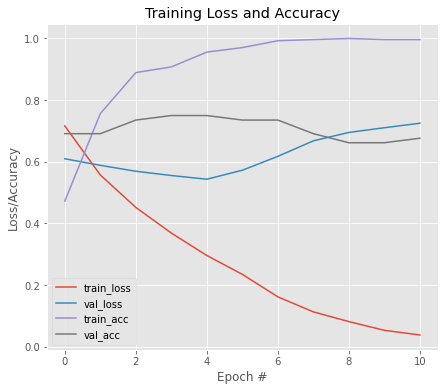


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:4
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1044 - accuracy: 0.9668
Epoch 1: val_loss improved from inf to 1.17797, saving model to InceptionResNetV2_a_1.hdf5
9/9 [==============================] - 40s 1s/step - loss: 0.1044 - accuracy: 0.9668 - val_loss: 1.1780 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0463 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 1.17797
9/9 [==============================] - 5s 607ms/step - loss: 0.0463 - accuracy: 0.9926 - val_loss: 1.3235 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0331 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 1.17797
9/9 [==============================] - 5s 607ms/step - loss: 0.0331 - accuracy: 0.9963 - val_loss: 1.5639 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.

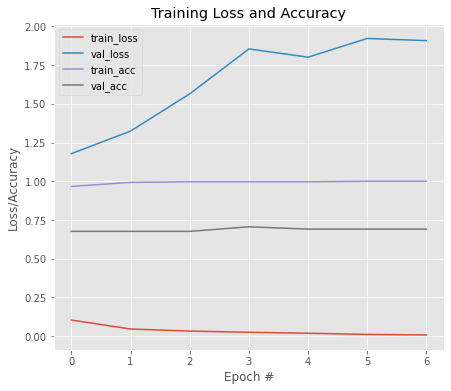


Model Performance Summary:

Best Validation accuracy:0.7058823704719543 at EPOCH:4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0536 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 1.79278, saving model to InceptionResNetV2_b_1.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.0536 - accuracy: 0.9926 - val_loss: 1.7928 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0175 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.79278
9/9 [==============================] - 5s 608ms/step - loss: 0.0175 - accuracy: 1.0000 - val_loss: 2.0088 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0241 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 1.79278
9/9 [==============================] - 5s 606ms/step - loss: 0.0241 - accuracy: 0.9963 - val_loss: 2.1374 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.00

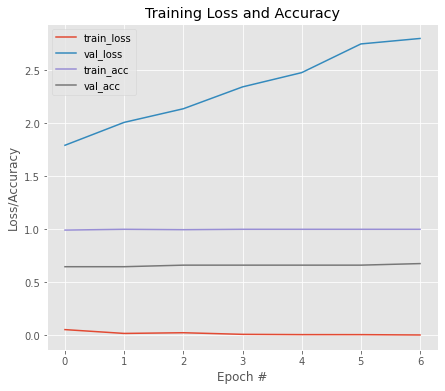


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:7
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0067 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 2.19683, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 40s 1s/step - loss: 0.0067 - accuracy: 1.0000 - val_loss: 2.1968 - val_accuracy: 0.6324
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 2: val_loss improved from 2.19683 to 2.16920, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 7s 839ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 2.1692 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_loss improved from 2.16920 to 1.98764, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 7s 841ms/step - loss: 0.0024 - accuracy: 1.0000 

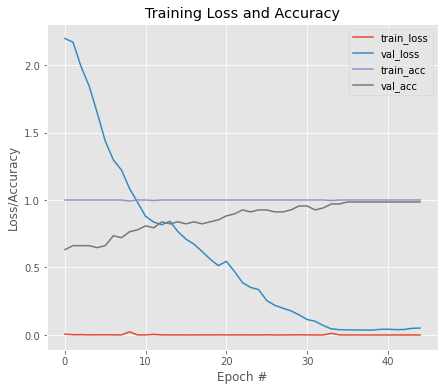


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:36
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.3071e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.03645, saving model to InceptionResNetV2_b_2.hdf5
9/9 [==============================] - 39s 1s/step - loss: 4.3071e-05 - accuracy: 1.0000 - val_loss: 0.0365 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.03645
9/9 [==============================] - 5s 606ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.0397 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.5553e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.03645
9/9 [==============================] - 5s 607ms/step - loss: 2.5553e-05 - accuracy: 1.0000 - val_loss: 0.0466 - val_accuracy: 0.9853
Epoch 4/50
9/9 [==============================] - ETA

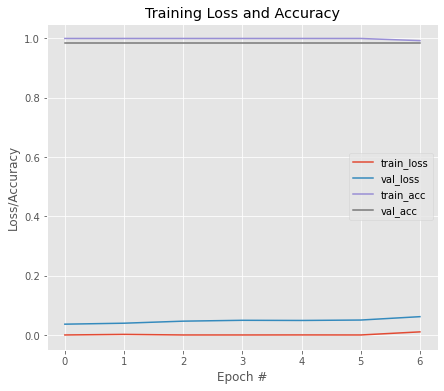


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 8.7658e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 39s 1s/step - loss: 8.7658e-05 - accuracy: 1.0000 - val_loss: 3.0328e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0043 - accuracy: 0.9963    
Epoch 2: val_loss did not improve from 0.00000
9/9 [==============================] - 5s 608ms/step - loss: 0.0043 - accuracy: 0.9963 - val_loss: 3.5763e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 6.4480e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 5s 607ms/step - loss: 6.4480e-04 - accuracy: 1.0000 - val_loss: 3.0574e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [======

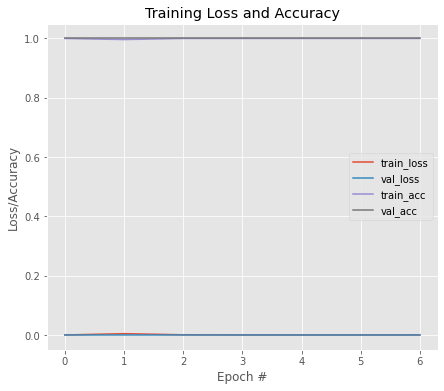


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.0316e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 39s 1s/step - loss: 5.0316e-04 - accuracy: 1.0000 - val_loss: 3.1257e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.5854e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 7s 875ms/step - loss: 4.5854e-05 - accuracy: 1.0000 - val_loss: 2.7067e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 9.4613e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
9/9 [==============================] - 5s 606ms/step - loss: 9.4613e-04 - accuracy: 1.0000 - val_loss: 4.8944e-06 - val_accuracy: 1.0000
E

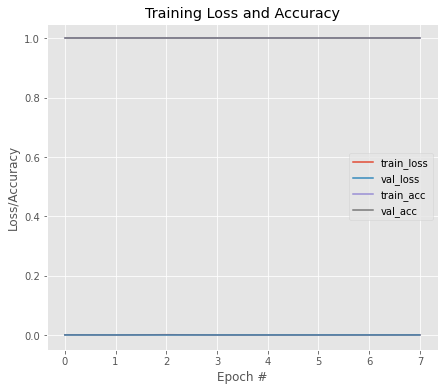


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.7343e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00137, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 40s 1s/step - loss: 5.7343e-05 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.00137 to 0.00040, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 7s 840ms/step - loss: 0.0033 - accuracy: 0.9963 - val_loss: 3.9679e-04 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.7257e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00040 to 0.00031, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 7s 842ms/step - loss: 7.7257e-05 - accuracy: 1.

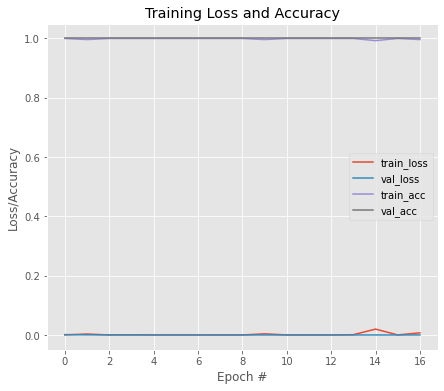


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 9.7145e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.9491e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 7s 837ms/step - loss: 1.9491e-05 - accuracy: 1.0000 - val_loss: 8.0812e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 0.9963
Epoch 3: val_loss improved from 0.00001 to 0.00000, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 7s 849ms/step - loss: 0.0073 - accuracy: 0.9963 - val_loss: 3.0

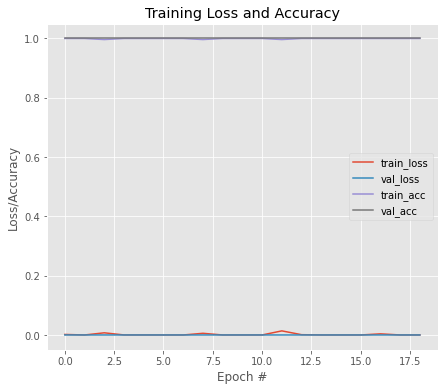


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8823529362678528
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0361 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 1.00758, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 17s 759ms/step - loss: 0.0361 - accuracy: 0.9853 - val_loss: 1.0076 - val_accuracy: 0.8425
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0353 - accuracy: 0.9853
Epoch 2: val_loss improved from 1.00758 to 1.00109, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 4s 382ms/step - loss: 0.0353 - accuracy: 0.9853 - val_loss: 1.0011 - val_accuracy: 0.8425
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0346 - accuracy: 0.9853
Epoch 3: val_loss improved from 1.00109 to 0.99582, saving model to InceptionResNetV2_wt.h

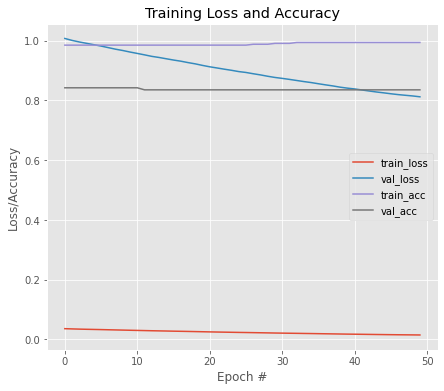


Model Performance Summary:

Best Validation accuracy:0.8424657583236694 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 8.3041e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 1.01529, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 41s 1s/step - loss: 8.3041e-05 - accuracy: 1.0000 - val_loss: 1.0153 - val_accuracy: 0.8425
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 2.1253e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.01529
11/11 [==============================] - 7s 652ms/step - loss: 2.1253e-05 - accuracy: 1.0000 - val_loss: 1.0468 - val_accuracy: 0.8356
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 2.7387e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 1.01529
11/11 [==============================] - 7s 650ms/step - loss: 2.7387e-04 - accuracy: 1.0000 - val_loss: 1.0975 - val_accur

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1,data_aug=False,dataset = 'RIM-ONE_dl')
  gc.collect()

,Model,Accuracy,Sensitivity,AUC
0,xception_A_True_RIM-ONE_dl,0.897260,0.946809,0.877250
1,InceptionResNetV2_A_True_RIM-ONE_dl,0.883562,0.925532,0.866612
2,InceptionV3_A_True_RIM-ONE_dl,0.917808,0.914894,0.918985
3,vgg16_A_True_RIM-ONE_dl,0.917808,0.936170,0.910393
4,vgg19_A_True_RIM-ONE_dl,0.910959,0.957447,0.892185
5,resnet50_A_True_RIM-ONE_dl,0.643836,1.000000,0.500000
6,DenseNet121_A_True_RIM-ONE_dl,0.958904,0.957447,0.959493
7,MobileNet_A_True_RIM-ONE_dl,0.904110,0.925532,0.895458
8,MobileNetV2_A_True_RIM-ONE_dl,0.767123,0.829787,0.741817
9,InceptionV3_A_False_RIM-ONE_dl,0.849315,0.872340,0.840016


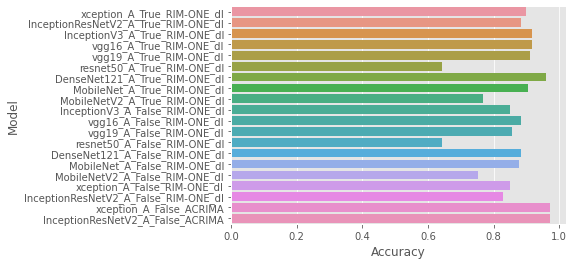

\begin{tabular}{lrrr}
\toprule
                               Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
          xception\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.946809 & 0.877250 \\
 InceptionResNetV2\_A\_True\_RIM-ONE\_dl &  0.883562 &     0.925532 & 0.866612 \\
       InceptionV3\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.914894 & 0.918985 \\
             vgg16\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.936170 & 0.910393 \\
             vgg19\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.957447 & 0.892185 \\
          resnet50\_A\_True\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
       DenseNet121\_A\_True\_RIM-ONE\_dl &  0.958904 &     0.957447 & 0.959493 \\
         MobileNet\_A\_True\_RIM-ONE\_dl &  0.904110 &     0.925532 & 0.895458 \\
       MobileNetV2\_A\_True\_RIM-ONE\_dl &  0.767123 &     0.829787 & 0.741817 \\
      InceptionV3\_A\_False\_RIM-ONE\_dl &  0.849315 &     0.872340 & 0.840016 \\
            vgg16\_A\_False\_RIM-ONE\_dl &  0.883562 &     0.9

In [ ]:
plot_overall_performance()

ACRIMA DATASET

Without Augmentation

In [ ]:
(tranx2,trainy2),(testx2,testy2) = get_acrima_dataset(299,299,test_train_ratio = 0.2)

Height:299 Width:299


Starting fold 0
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.7335 - accuracy: 0.4989
Epoch 1: val_loss improved from inf to 0.72091, saving model to InceptionV3_a_0.hdf5
15/15 [==============================] - 12s 442ms/step - loss: 0.7335 - accuracy: 0.4989 - val_loss: 0.7209 - val_accuracy: 0.4956
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.7299 - accuracy: 0.5078
Epoch 2: val_loss improved from 0.72091 to 0.71817, saving model to InceptionV3_a_0.hdf5
15/15 [==============================] - 3s 179ms/step - loss: 0.7299 - accuracy: 0.5078 - val_loss: 0.7182 - val_accuracy: 0.4956
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.7273 - accuracy: 0.5078
Epoch 3: val_loss improved from 0.71817 to 0.71595, saving model to InceptionV3_a_0.hdf5
15/15 [==============================] - 3s 177ms/step - loss: 0.7273 - accuracy: 0.5078 - val_loss: 0.7159 - val_accuracy: 0.4956
Epoch 4/50
15/15 [===========================

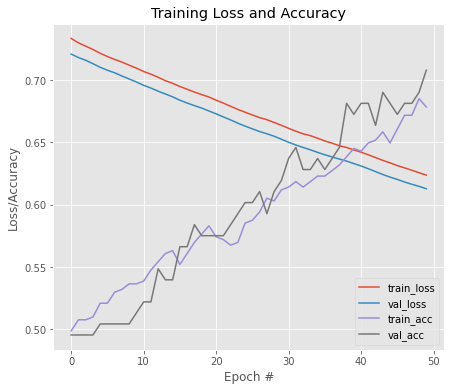


Model Performance Summary:

Best Validation accuracy:0.7079645991325378 at EPOCH:50
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4994 - accuracy: 0.7627
Epoch 1: val_loss improved from inf to 0.69727, saving model to InceptionV3_b_0.hdf5
15/15 [==============================] - 25s 707ms/step - loss: 0.4994 - accuracy: 0.7627 - val_loss: 0.6973 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2708 - accuracy: 0.9401
Epoch 2: val_loss did not improve from 0.69727
15/15 [==============================] - 7s 454ms/step - loss: 0.2708 - accuracy: 0.9401 - val_loss: 0.7448 - val_accuracy: 0.5664
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.1690 - accuracy: 0.9800
Epoch 3: val_loss did not improve from 0.69727
15/15 [==============================] - 7s 454ms/step - loss: 0.1690 - accuracy: 0.9800 - val_loss: 0.8225 - val_accuracy: 0.5664
Epoch 4/50
15/15 [==============================] - ETA: 0s 

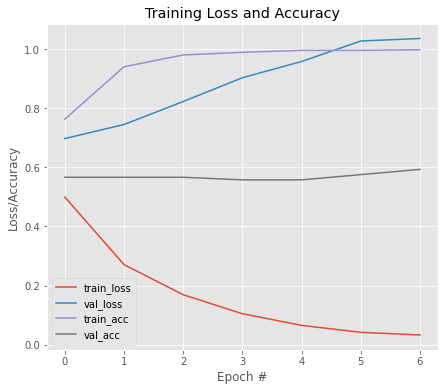


Model Performance Summary:

Best Validation accuracy:0.5929203629493713 at EPOCH:7
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0441 - accuracy: 0.9911
Epoch 1: val_loss improved from inf to 1.22315, saving model to InceptionV3_a_1.hdf5
15/15 [==============================] - 19s 619ms/step - loss: 0.0441 - accuracy: 0.9911 - val_loss: 1.2231 - val_accuracy: 0.5929
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0181 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.22315
15/15 [==============================] - 7s 462ms/step - loss: 0.0181 - accuracy: 1.0000 - val_loss: 1.3283 - val_accuracy: 0.6018
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0138 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 1.22315
15/15 [==============================] - 7s 467ms/step - loss: 0.0138 - accuracy: 1.0000 - val_loss: 1.4750 - val_accuracy: 0.6018
Epoch 4/50
15/15 [===========================

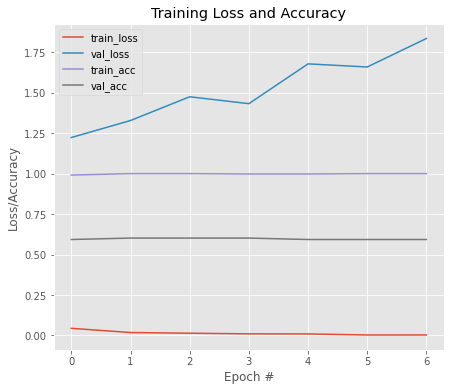


Model Performance Summary:

Best Validation accuracy:0.6017699241638184 at EPOCH:2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0126 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 1.55138, saving model to InceptionV3_b_1.hdf5
15/15 [==============================] - 19s 602ms/step - loss: 0.0126 - accuracy: 0.9978 - val_loss: 1.5514 - val_accuracy: 0.5929
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0045 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.55138
15/15 [==============================] - 7s 461ms/step - loss: 0.0045 - accuracy: 1.0000 - val_loss: 1.5789 - val_accuracy: 0.6018
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0084 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 1.55138
15/15 [==============================] - 7s 464ms/step - loss: 0.0084 - accuracy: 0.9978 - val_loss: 1.7640 - val_accuracy: 0.6018
Epoch 4/50
15/15 [==============================] - ETA: 0s -

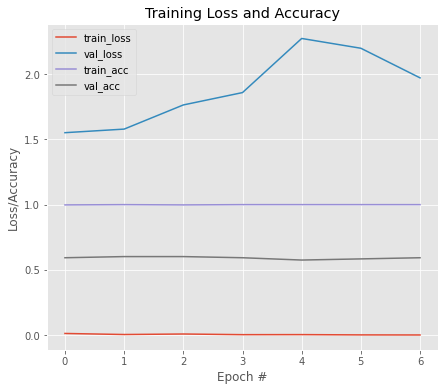


Model Performance Summary:

Best Validation accuracy:0.6017699241638184 at EPOCH:2
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 2.19917, saving model to InceptionV3_a_2.hdf5
15/15 [==============================] - 19s 600ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 2.1992 - val_accuracy: 0.6372
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss improved from 2.19917 to 1.54490, saving model to InceptionV3_a_2.hdf5
15/15 [==============================] - 8s 517ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.5449 - val_accuracy: 0.6726
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0081 - accuracy: 0.9933
Epoch 3: val_loss did not improve from 1.54490
15/15 [==============================] - 7s 463ms/step - loss: 0.0081 - accuracy: 0.9933 - val_loss: 1.5763 - val_accuracy: 0.6903
Epo

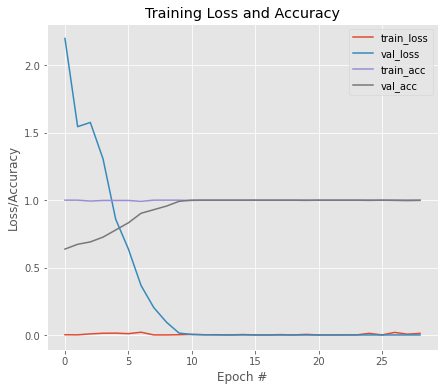


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:11
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0147 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00002, saving model to InceptionV3_b_2.hdf5
15/15 [==============================] - 19s 600ms/step - loss: 0.0147 - accuracy: 0.9978 - val_loss: 1.7345e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.6390e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00002 to 0.00002, saving model to InceptionV3_b_2.hdf5
15/15 [==============================] - 8s 518ms/step - loss: 1.6390e-04 - accuracy: 1.0000 - val_loss: 1.6419e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0159 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 0.00002
15/15 [==============================] - 7s 466ms/step - loss: 0.0159 - accuracy: 0.9956 - val_loss: 1.6987e-05 - val_accuracy: 1.0000
Epoch 4/50
15

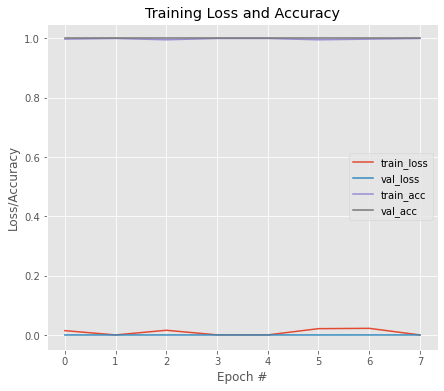


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0175 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00007, saving model to InceptionV3_a_3.hdf5
15/15 [==============================] - 19s 597ms/step - loss: 0.0175 - accuracy: 0.9978 - val_loss: 6.6499e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0122 - accuracy: 0.9956
Epoch 2: val_loss improved from 0.00007 to 0.00005, saving model to InceptionV3_a_3.hdf5
15/15 [==============================] - 8s 523ms/step - loss: 0.0122 - accuracy: 0.9956 - val_loss: 4.7968e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.4502e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00005 to 0.00004, saving model to InceptionV3_a_3.hdf5
15/15 [==============================] - 8s 519ms/step - loss: 1.4502e-04 - accuracy: 1.0000 - 

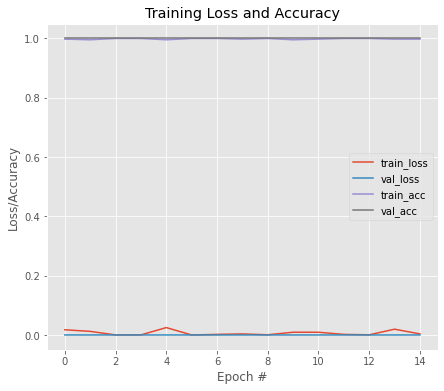


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 0.9978    
Epoch 1: val_loss improved from inf to 0.00001, saving model to InceptionV3_b_3.hdf5
15/15 [==============================] - 19s 604ms/step - loss: 0.0051 - accuracy: 0.9978 - val_loss: 6.4182e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.6412e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 7s 466ms/step - loss: 1.6412e-04 - accuracy: 1.0000 - val_loss: 6.6893e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 7.7464e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 7s 473ms/step - loss: 7.7464e-05 - accuracy: 1.0000 - val_loss: 6.5480e-06 - val_accuracy: 1.0000
Epoch 4/50
15/15 [==========================

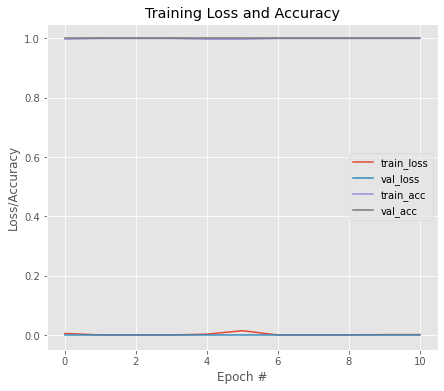


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.7267e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to InceptionV3_a_4.hdf5
15/15 [==============================] - 23s 895ms/step - loss: 5.7267e-04 - accuracy: 1.0000 - val_loss: 5.9603e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.2507e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 7s 464ms/step - loss: 3.2507e-04 - accuracy: 1.0000 - val_loss: 6.5574e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 3.0081e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 7s 469ms/step - loss: 3.0081e-05 - accuracy: 1.0000 - val_loss: 6.2882e-06 - val_accuracy: 1.0000
Epoch 4/50
15/15 [======

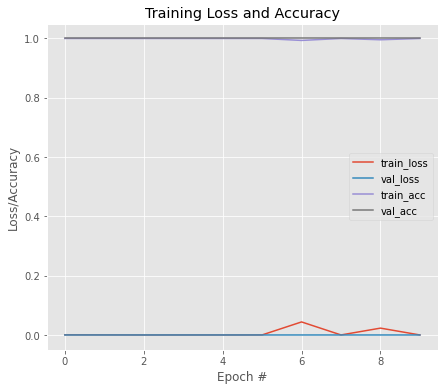


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.0713e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to InceptionV3_b_4.hdf5
15/15 [==============================] - 19s 602ms/step - loss: 2.0713e-05 - accuracy: 1.0000 - val_loss: 7.3621e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 7.7732e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to InceptionV3_b_4.hdf5
15/15 [==============================] - 8s 519ms/step - loss: 7.7732e-04 - accuracy: 1.0000 - val_loss: 6.1955e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 8.7978e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00000, saving model to InceptionV3_b_4.hdf5
15/15 [==============================] - 8s 525ms/step - loss: 8.7978e-04 - accuracy: 1.0000 - 

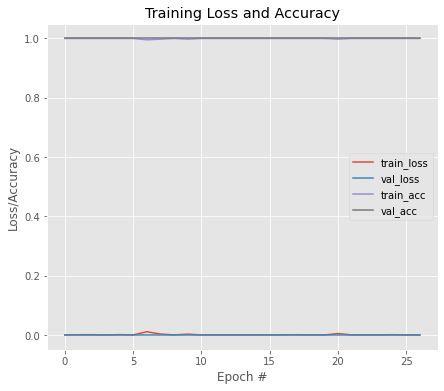


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8389380574226379
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 0.9982
Epoch 1: val_loss improved from inf to 0.04480, saving model to InceptionV3_wt.hdf5
18/18 [==============================] - 11s 432ms/step - loss: 0.0014 - accuracy: 0.9982 - val_loss: 0.0448 - val_accuracy: 0.9716
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 0.9982
Epoch 2: val_loss did not improve from 0.04480
18/18 [==============================] - 3s 160ms/step - loss: 0.0014 - accuracy: 0.9982 - val_loss: 0.0448 - val_accuracy: 0.9716
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 0.9982
Epoch 3: val_loss did not improve from 0.04480
18/18 [==============================] - 3s 160ms/step - loss: 0.0013 - accuracy: 0.9982 - val_l

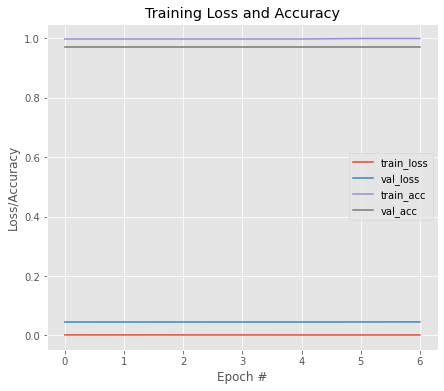


Model Performance Summary:

Best Validation accuracy:0.9716312289237976 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0184 - accuracy: 0.9965
Epoch 1: val_loss improved from inf to 0.05598, saving model to InceptionV3_wt.hdf5
18/18 [==============================] - 23s 753ms/step - loss: 0.0184 - accuracy: 0.9965 - val_loss: 0.0560 - val_accuracy: 0.9787
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 3.6488e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.05598 to 0.05106, saving model to InceptionV3_wt.hdf5
18/18 [==============================] - 10s 532ms/step - loss: 3.6488e-04 - accuracy: 1.0000 - val_loss: 0.0511 - val_accuracy: 0.9787
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 0.9965
Epoch 3: val_loss improved from 0.05106 to 0.04598, saving model to InceptionV3_wt.hdf5
18/18 [==============================] - 10s 538ms/step

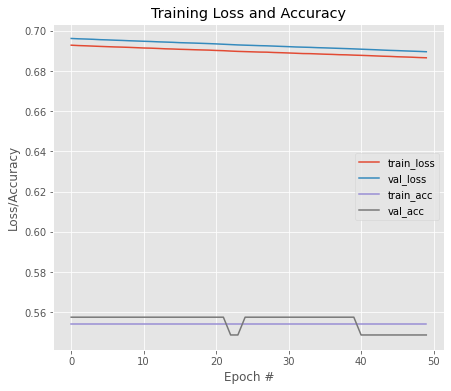


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.6039 - accuracy: 0.6630
Epoch 1: val_loss improved from inf to 0.44356, saving model to vgg16_b_0.hdf5
15/15 [==============================] - 14s 590ms/step - loss: 0.6039 - accuracy: 0.6630 - val_loss: 0.4436 - val_accuracy: 0.8407
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.4371 - accuracy: 0.8337
Epoch 2: val_loss improved from 0.44356 to 0.31169, saving model to vgg16_b_0.hdf5
15/15 [==============================] - 7s 493ms/step - loss: 0.4371 - accuracy: 0.8337 - val_loss: 0.3117 - val_accuracy: 0.8850
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2887 - accuracy: 0.9002
Epoch 3: val_loss improved from 0.31169 to 0.28327, saving model to vgg16_b_0.hdf5
15/15 [==============================] - 8s 503ms/step - loss: 0.2887 - accuracy: 0.9002 - val_loss: 0.2833 - val_accuracy: 0.

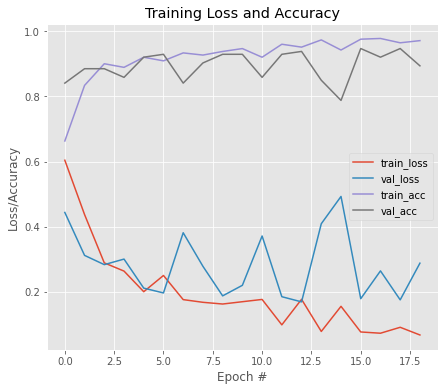


Model Performance Summary:

Best Validation accuracy:0.9469026327133179 at EPOCH:16
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2249 - accuracy: 0.9579
Epoch 1: val_loss improved from inf to 0.04975, saving model to vgg16_a_1.hdf5
15/15 [==============================] - 9s 508ms/step - loss: 0.2249 - accuracy: 0.9579 - val_loss: 0.0497 - val_accuracy: 0.9823
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0828 - accuracy: 0.9756
Epoch 2: val_loss did not improve from 0.04975
15/15 [==============================] - 7s 471ms/step - loss: 0.0828 - accuracy: 0.9756 - val_loss: 0.0514 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0689 - accuracy: 0.9734
Epoch 3: val_loss did not improve from 0.04975
15/15 [==============================] - 7s 477ms/step - loss: 0.0689 - accuracy: 0.9734 - val_loss: 0.0828 - val_accuracy: 0.9469
Epoch 4/50
15/15 [==============================] -

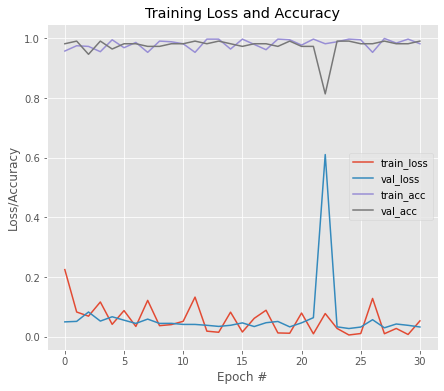


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2739 - accuracy: 0.9446
Epoch 1: val_loss improved from inf to 0.04527, saving model to vgg16_b_1.hdf5
15/15 [==============================] - 9s 510ms/step - loss: 0.2739 - accuracy: 0.9446 - val_loss: 0.0453 - val_accuracy: 0.9735
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0072 - accuracy: 0.9978
Epoch 2: val_loss improved from 0.04527 to 0.03802, saving model to vgg16_b_1.hdf5
15/15 [==============================] - 7s 496ms/step - loss: 0.0072 - accuracy: 0.9978 - val_loss: 0.0380 - val_accuracy: 0.9823
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 0.03802
15/15 [==============================] - 7s 473ms/step - loss: 0.0064 - accuracy: 0.9978 - val_loss: 0.0407 - val_accuracy: 0.9823
Epoch 4/50
15/15 [===============

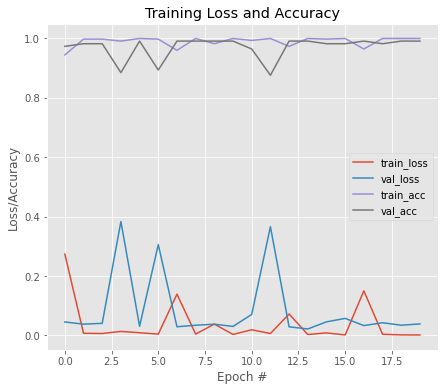


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:5
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.3436 - accuracy: 0.9645
Epoch 1: val_loss improved from inf to 0.00341, saving model to vgg16_a_2.hdf5
15/15 [==============================] - 9s 509ms/step - loss: 0.3436 - accuracy: 0.9645 - val_loss: 0.0034 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0116 - accuracy: 0.9956
Epoch 2: val_loss did not improve from 0.00341
15/15 [==============================] - 7s 475ms/step - loss: 0.0116 - accuracy: 0.9956 - val_loss: 0.0103 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0270 - accuracy: 0.9889
Epoch 3: val_loss improved from 0.00341 to 0.00218, saving model to vgg16_a_2.hdf5
15/15 [==============================] - 7s 492ms/step - loss: 0.0270 - accuracy: 0.9889 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 4/50
15/15 

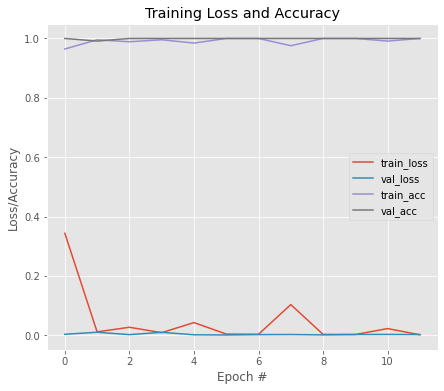


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.1839 - accuracy: 0.9756
Epoch 1: val_loss improved from inf to 0.00116, saving model to vgg16_b_2.hdf5
15/15 [==============================] - 9s 513ms/step - loss: 0.1839 - accuracy: 0.9756 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00116
15/15 [==============================] - 7s 476ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00116 to 0.00071, saving model to vgg16_b_2.hdf5
15/15 [==============================] - 7s 495ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 7.1003e-04 - val_accuracy: 1.0000
Epoch 4/50
15/15 [=========================

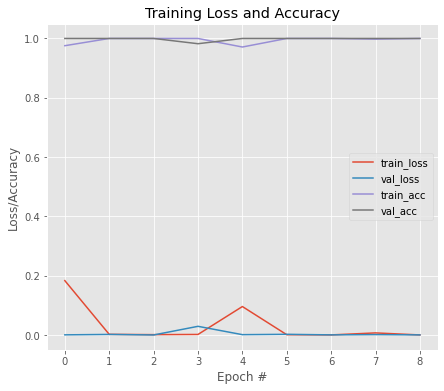


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0436 - accuracy: 0.9845
Epoch 1: val_loss improved from inf to 0.02522, saving model to vgg16_a_3.hdf5
15/15 [==============================] - 9s 511ms/step - loss: 0.0436 - accuracy: 0.9845 - val_loss: 0.0252 - val_accuracy: 0.9912
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.02522 to 0.00055, saving model to vgg16_a_3.hdf5
15/15 [==============================] - 7s 497ms/step - loss: 0.0050 - accuracy: 1.0000 - val_loss: 5.4696e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00055 to 0.00013, saving model to vgg16_a_3.hdf5
15/15 [==============================] - 7s 497ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 1.3075e-04 - val_accu

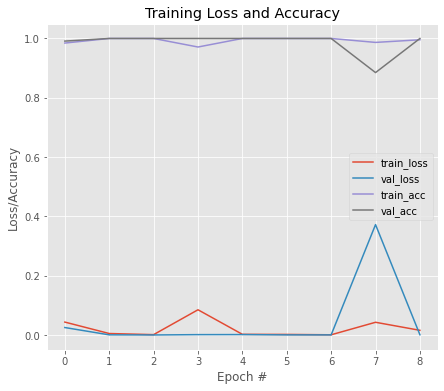


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.1474 - accuracy: 0.9823
Epoch 1: val_loss improved from inf to 0.00020, saving model to vgg16_b_3.hdf5
15/15 [==============================] - 9s 506ms/step - loss: 0.1474 - accuracy: 0.9823 - val_loss: 2.0029e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 8.4061e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00020
15/15 [==============================] - 7s 476ms/step - loss: 8.4061e-04 - accuracy: 1.0000 - val_loss: 2.1588e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 6.4558e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00020 to 0.00009, saving model to vgg16_b_3.hdf5
15/15 [==============================] - 7s 497ms/step - loss: 6.4558e-04 - accuracy: 1.0000 - val_loss: 9.4060e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [=

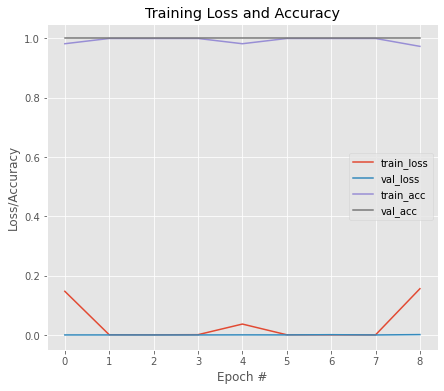


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2593 - accuracy: 0.9558
Epoch 1: val_loss improved from inf to 0.00107, saving model to vgg16_a_4.hdf5
15/15 [==============================] - 13s 780ms/step - loss: 0.2593 - accuracy: 0.9558 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00107 to 0.00066, saving model to vgg16_a_4.hdf5
15/15 [==============================] - 7s 497ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 6.6333e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 7.6625e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00066 to 0.00048, saving model to vgg16_a_4.hdf5
15/15 [==============================] - 7s 493ms/step - loss: 7.6625e-04 - accuracy: 1.0000 - val_loss: 4.7684e-04 -

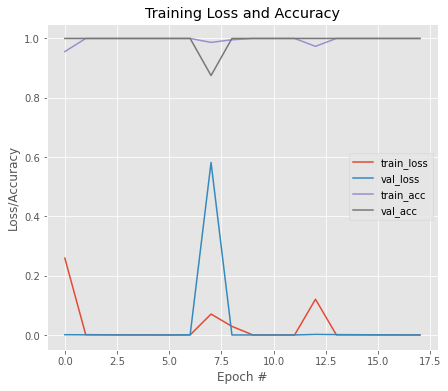


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2702 - accuracy: 0.9646
Epoch 1: val_loss improved from inf to 0.00092, saving model to vgg16_b_4.hdf5
15/15 [==============================] - 9s 510ms/step - loss: 0.2702 - accuracy: 0.9646 - val_loss: 9.1667e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 8.0511e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00092 to 0.00079, saving model to vgg16_b_4.hdf5
15/15 [==============================] - 7s 521ms/step - loss: 8.0511e-04 - accuracy: 1.0000 - val_loss: 7.9125e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 3.5524e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00079 to 0.00046, saving model to vgg16_b_4.hdf5
15/15 [==============================] - 7s 527ms/step - loss: 3.5524e-04 - accuracy: 1.0000 - val_loss: 4.6270e-04 - val_

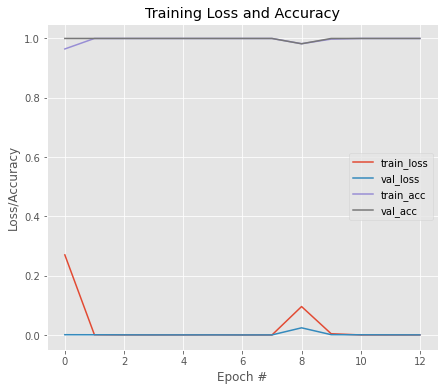


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9876106142997741
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.08331, saving model to vgg16_wt.hdf5
18/18 [==============================] - 8s 436ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0833 - val_accuracy: 0.9645
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.08331
18/18 [==============================] - 4s 209ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0837 - val_accuracy: 0.9645
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.08331
18/18 [==============================] - 4s 207ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.

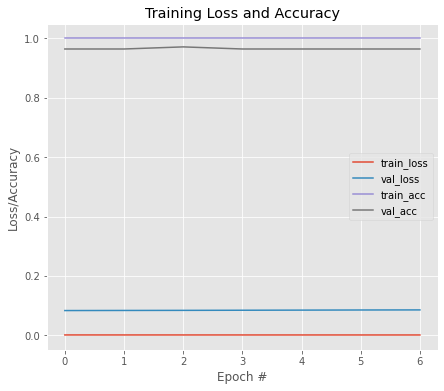


Model Performance Summary:

Best Validation accuracy:0.9716312289237976 at EPOCH:3
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.9305 - accuracy: 0.9078
Epoch 1: val_loss improved from inf to 0.10825, saving model to vgg16_wt.hdf5
18/18 [==============================] - 14s 697ms/step - loss: 0.9305 - accuracy: 0.9078 - val_loss: 0.1082 - val_accuracy: 0.9504
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0232 - accuracy: 0.9947
Epoch 2: val_loss did not improve from 0.10825
18/18 [==============================] - 9s 496ms/step - loss: 0.0232 - accuracy: 0.9947 - val_loss: 0.3297 - val_accuracy: 0.9007
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0761 - accuracy: 0.9663
Epoch 3: val_loss improved from 0.10825 to 0.08230, saving model to vgg16_wt.hdf5
18/18 [==============================] - 9s 511ms/step - loss: 0.0761 - accuracy: 0.9663 - val_loss: 0.0823 - val_acc

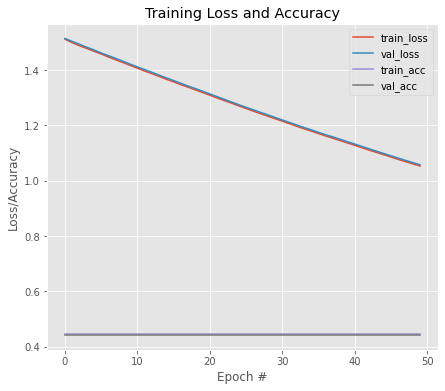


Model Performance Summary:

Best Validation accuracy:0.44247788190841675 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.6595 - accuracy: 0.6319
Epoch 1: val_loss improved from inf to 0.46387, saving model to vgg19_b_0.hdf5
15/15 [==============================] - 11s 603ms/step - loss: 0.6595 - accuracy: 0.6319 - val_loss: 0.4639 - val_accuracy: 0.8761
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.4835 - accuracy: 0.7871
Epoch 2: val_loss improved from 0.46387 to 0.34295, saving model to vgg19_b_0.hdf5
15/15 [==============================] - 9s 592ms/step - loss: 0.4835 - accuracy: 0.7871 - val_loss: 0.3430 - val_accuracy: 0.9027
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.3357 - accuracy: 0.8758
Epoch 3: val_loss improved from 0.34295 to 0.27512, saving model to vgg19_b_0.hdf5
15/15 [==============================] - 9s 599ms/step - loss: 0.3357 - accuracy: 0.8758 - val_loss: 0.2751 - val_accuracy: 0

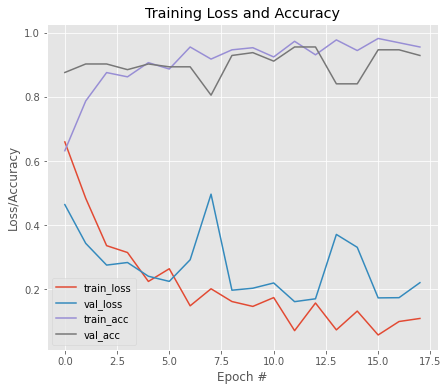


Model Performance Summary:

Best Validation accuracy:0.9557521939277649 at EPOCH:12
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.1792 - accuracy: 0.9401
Epoch 1: val_loss improved from inf to 0.06169, saving model to vgg19_a_1.hdf5
15/15 [==============================] - 11s 605ms/step - loss: 0.1792 - accuracy: 0.9401 - val_loss: 0.0617 - val_accuracy: 0.9823
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.1196 - accuracy: 0.9645
Epoch 2: val_loss improved from 0.06169 to 0.04354, saving model to vgg19_a_1.hdf5
15/15 [==============================] - 9s 590ms/step - loss: 0.1196 - accuracy: 0.9645 - val_loss: 0.0435 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0519 - accuracy: 0.9845
Epoch 3: val_loss did not improve from 0.04354
15/15 [==============================] - 9s 569ms/step - loss: 0.0519 - accuracy: 0.9845 - val_loss: 0.1818 - val_accuracy: 0.9381
Epoch 4/50
15/

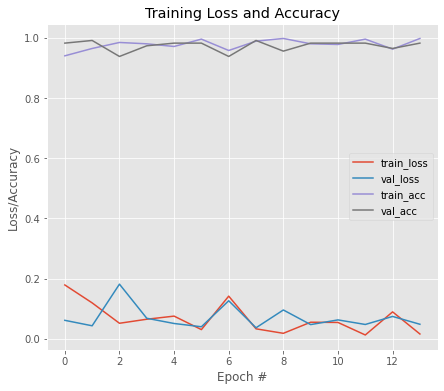


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2497 - accuracy: 0.9512
Epoch 1: val_loss improved from inf to 0.03941, saving model to vgg19_b_1.hdf5
15/15 [==============================] - 11s 607ms/step - loss: 0.2497 - accuracy: 0.9512 - val_loss: 0.0394 - val_accuracy: 0.9912
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0509 - accuracy: 0.9800
Epoch 2: val_loss did not improve from 0.03941
15/15 [==============================] - 8s 564ms/step - loss: 0.0509 - accuracy: 0.9800 - val_loss: 0.0478 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0191 - accuracy: 0.9933
Epoch 3: val_loss did not improve from 0.03941
15/15 [==============================] - 8s 566ms/step - loss: 0.0191 - accuracy: 0.9933 - val_loss: 0.0611 - val_accuracy: 0.9735
Epoch 4/50
15/15 [==============================] - ETA: 0s - loss: 

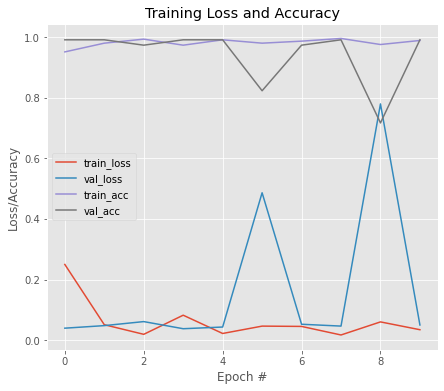


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.3429 - accuracy: 0.9512
Epoch 1: val_loss improved from inf to 0.00604, saving model to vgg19_a_2.hdf5
15/15 [==============================] - 11s 608ms/step - loss: 0.3429 - accuracy: 0.9512 - val_loss: 0.0060 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0178 - accuracy: 0.9933
Epoch 2: val_loss did not improve from 0.00604
15/15 [==============================] - 8s 565ms/step - loss: 0.0178 - accuracy: 0.9933 - val_loss: 0.0094 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0257 - accuracy: 0.9867
Epoch 3: val_loss improved from 0.00604 to 0.00418, saving model to vgg19_a_2.hdf5
15/15 [==============================] - 9s 593ms/step - loss: 0.0257 - accuracy: 0.9867 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 4/50
15/15

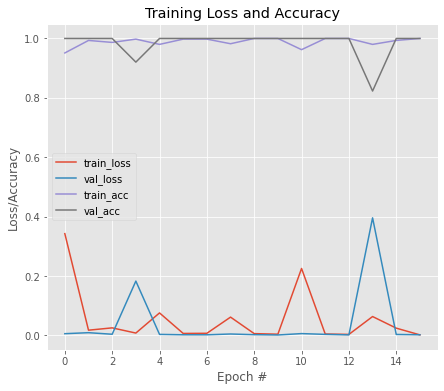


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2860 - accuracy: 0.9512
Epoch 1: val_loss improved from inf to 0.00262, saving model to vgg19_b_2.hdf5
15/15 [==============================] - 11s 605ms/step - loss: 0.2860 - accuracy: 0.9512 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00262 to 0.00141, saving model to vgg19_b_2.hdf5
15/15 [==============================] - 9s 589ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00141 to 0.00103, saving model to vgg19_b_2.hdf5
15/15 [==============================] - 9s 591ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 4/50

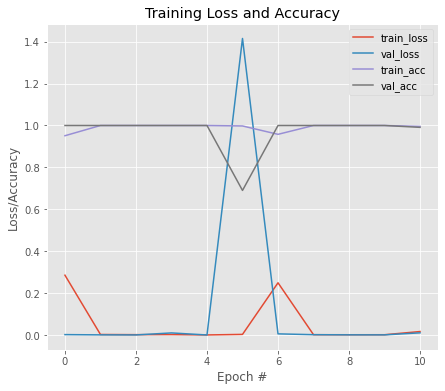


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.1638 - accuracy: 0.9645
Epoch 1: val_loss improved from inf to 0.00193, saving model to vgg19_a_3.hdf5
15/15 [==============================] - 11s 607ms/step - loss: 0.1638 - accuracy: 0.9645 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00193 to 0.00132, saving model to vgg19_a_3.hdf5
15/15 [==============================] - 9s 590ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00132 to 0.00061, saving model to vgg19_a_3.hdf5
15/15 [==============================] - 9s 591ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 6.1320e-04 - val_accurac

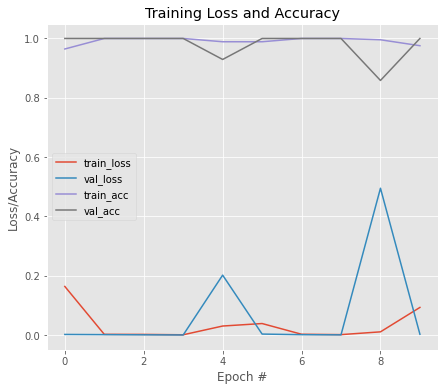


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0287 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00066, saving model to vgg19_b_3.hdf5
15/15 [==============================] - 11s 602ms/step - loss: 0.0287 - accuracy: 0.9978 - val_loss: 6.6218e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00066 to 0.00024, saving model to vgg19_b_3.hdf5
15/15 [==============================] - 9s 587ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 2.3513e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00024 to 0.00023, saving model to vgg19_b_3.hdf5
15/15 [==============================] - 9s 588ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 2.2843e-04 - val_accuracy: 1.000

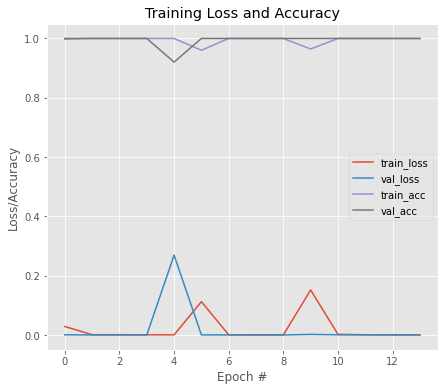


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2421 - accuracy: 0.9712
Epoch 1: val_loss improved from inf to 0.00067, saving model to vgg19_a_4.hdf5
15/15 [==============================] - 11s 606ms/step - loss: 0.2421 - accuracy: 0.9712 - val_loss: 6.6782e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 9.8009e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00067 to 0.00056, saving model to vgg19_a_4.hdf5
15/15 [==============================] - 9s 587ms/step - loss: 9.8009e-04 - accuracy: 1.0000 - val_loss: 5.6258e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 5.2115e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00056 to 0.00031, saving model to vgg19_a_4.hdf5
15/15 [==============================] - 9s 588ms/step - loss: 5.2115e-04 - accuracy: 1.0000 - val_loss: 

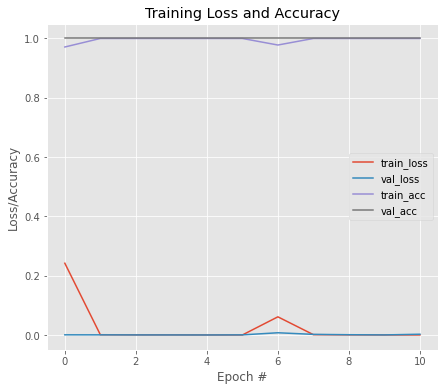


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.2416 - accuracy: 0.9712
Epoch 1: val_loss improved from inf to 0.00060, saving model to vgg19_b_4.hdf5
15/15 [==============================] - 11s 606ms/step - loss: 0.2416 - accuracy: 0.9712 - val_loss: 6.0182e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.3940e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00060 to 0.00041, saving model to vgg19_b_4.hdf5
15/15 [==============================] - 9s 587ms/step - loss: 3.3940e-04 - accuracy: 1.0000 - val_loss: 4.0636e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 2.3937e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00041 to 0.00029, saving model to vgg19_b_4.hdf5
15/15 [==============================] - 9s 589ms/step - loss: 2.3937e-04 - accuracy: 1.0000 - val_loss: 2.8839e-04 - val

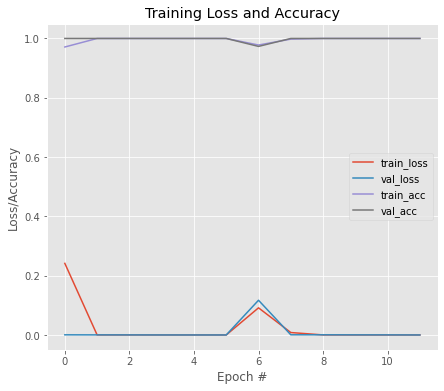


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9893805265426636
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.19757, saving model to vgg19_wt.hdf5
18/18 [==============================] - 5s 269ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.1976 - val_accuracy: 0.9504
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.19757
18/18 [==============================] - 4s 243ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.1979 - val_accuracy: 0.9504
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.19757
18/18 [==============================] - 4s 244ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.

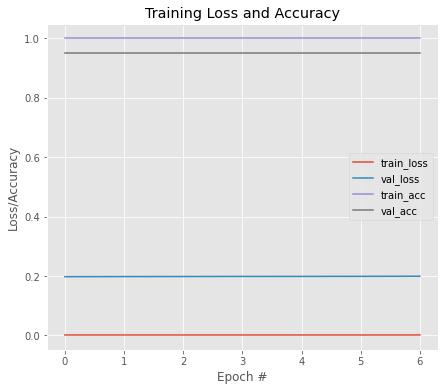


Model Performance Summary:

Best Validation accuracy:0.9503546357154846 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.7995 - accuracy: 0.8848
Epoch 1: val_loss improved from inf to 0.14577, saving model to vgg19_wt.hdf5
18/18 [==============================] - 13s 624ms/step - loss: 0.7995 - accuracy: 0.8848 - val_loss: 0.1458 - val_accuracy: 0.9433
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0250 - accuracy: 0.9947
Epoch 2: val_loss did not improve from 0.14577
18/18 [==============================] - 10s 591ms/step - loss: 0.0250 - accuracy: 0.9947 - val_loss: 0.1915 - val_accuracy: 0.9433
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.3011 - accuracy: 0.9379
Epoch 3: val_loss did not improve from 0.14577
18/18 [==============================] - 10s 581ms/step - loss: 0.3011 - accuracy: 0.9379 - val_loss: 0.1809 - val_accuracy: 0.9220
Epoch 4/50
18/18 [=

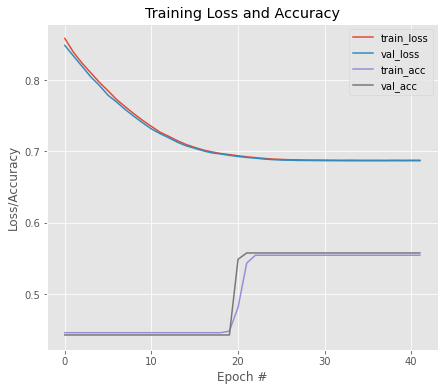


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:22
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4012 - accuracy: 0.8448
Epoch 1: val_loss improved from inf to 0.68610, saving model to resnet50_b_0.hdf5
15/15 [==============================] - 19s 494ms/step - loss: 0.4012 - accuracy: 0.8448 - val_loss: 0.6861 - val_accuracy: 0.5575
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.1634 - accuracy: 0.9778
Epoch 2: val_loss improved from 0.68610 to 0.68605, saving model to resnet50_b_0.hdf5
15/15 [==============================] - 6s 389ms/step - loss: 0.1634 - accuracy: 0.9778 - val_loss: 0.6861 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0926 - accuracy: 0.9933
Epoch 3: val_loss did not improve from 0.68605
15/15 [==============================] - 5s 339ms/step - loss: 0.0926 - accuracy: 0.9933 - val_loss: 0.6880 - val_accuracy: 0.5575
Epoch 4/50
15/15 [======

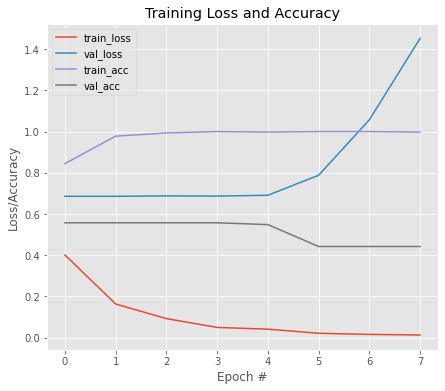


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:1
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0244 - accuracy: 0.9911
Epoch 1: val_loss improved from inf to 2.12985, saving model to resnet50_a_1.hdf5
15/15 [==============================] - 17s 452ms/step - loss: 0.0244 - accuracy: 0.9911 - val_loss: 2.1299 - val_accuracy: 0.4867
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0076 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 2.12985
15/15 [==============================] - 5s 338ms/step - loss: 0.0076 - accuracy: 0.9978 - val_loss: 2.3156 - val_accuracy: 0.4867
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0081 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 2.12985
15/15 [==============================] - 5s 339ms/step - loss: 0.0081 - accuracy: 0.9956 - val_loss: 2.4776 - val_accuracy: 0.4867
Epoch 4/50
15/15 [==============================

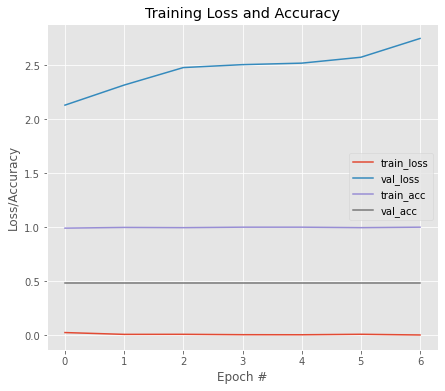


Model Performance Summary:

Best Validation accuracy:0.48672565817832947 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.31435, saving model to resnet50_b_1.hdf5
15/15 [==============================] - 17s 450ms/step - loss: 0.0031 - accuracy: 1.0000 - val_loss: 3.3144 - val_accuracy: 0.4867
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0045 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 3.31435
15/15 [==============================] - 5s 334ms/step - loss: 0.0045 - accuracy: 1.0000 - val_loss: 3.9376 - val_accuracy: 0.4867
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.31435
15/15 [==============================] - 5s 335ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 3.5900 - val_accuracy: 0.4867
Epoch 4/50
15/15 [==============================] - ETA: 0s - l

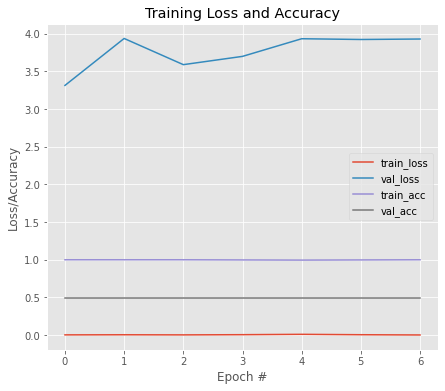


Model Performance Summary:

Best Validation accuracy:0.48672565817832947 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.79488, saving model to resnet50_a_2.hdf5
15/15 [==============================] - 16s 450ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 4.7949 - val_accuracy: 0.4336
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 4.79488
15/15 [==============================] - 5s 336ms/step - loss: 0.0058 - accuracy: 0.9978 - val_loss: 4.9335 - val_accuracy: 0.4336
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0120 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 4.79488
15/15 [==============================] - 5s 337ms/step - loss: 0.0120 - accuracy: 0.9978 - val_loss: 5.3301 - val_accuracy: 0.4336
Epoch 4/50
15/15 [=============================

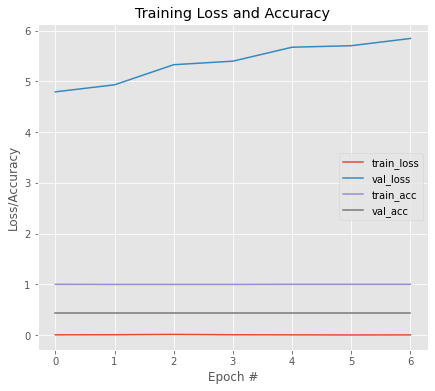


Model Performance Summary:

Best Validation accuracy:0.4336283206939697 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0038 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 5.24397, saving model to resnet50_b_2.hdf5
15/15 [==============================] - 17s 452ms/step - loss: 0.0038 - accuracy: 0.9978 - val_loss: 5.2440 - val_accuracy: 0.4336
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 2: val_loss improved from 5.24397 to 4.73685, saving model to resnet50_b_2.hdf5
15/15 [==============================] - 6s 386ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 4.7368 - val_accuracy: 0.4336
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0055 - accuracy: 0.9978
Epoch 3: val_loss improved from 4.73685 to 4.42408, saving model to resnet50_b_2.hdf5
15/15 [==============================] - 6s 386ms/step - loss: 0.0055 - accuracy: 0.9978 - val_loss: 4.4241 - val_acc

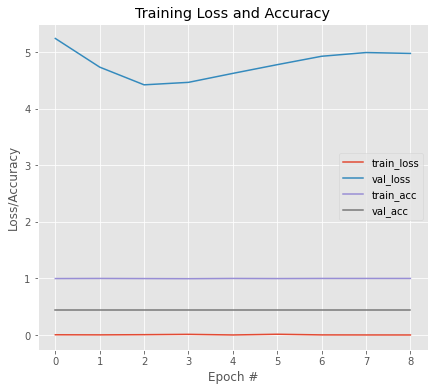


Model Performance Summary:

Best Validation accuracy:0.4336283206939697 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 4.2402e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.73208, saving model to resnet50_a_3.hdf5
15/15 [==============================] - 16s 447ms/step - loss: 4.2402e-04 - accuracy: 1.0000 - val_loss: 4.7321 - val_accuracy: 0.3894
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 4.73208
15/15 [==============================] - 5s 350ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 5.2318 - val_accuracy: 0.3894
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0173 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 4.73208
15/15 [==============================] - 5s 343ms/step - loss: 0.0173 - accuracy: 0.9956 - val_loss: 4.7607 - val_accuracy: 0.3894
Epoch 4/50
15/15 [======================

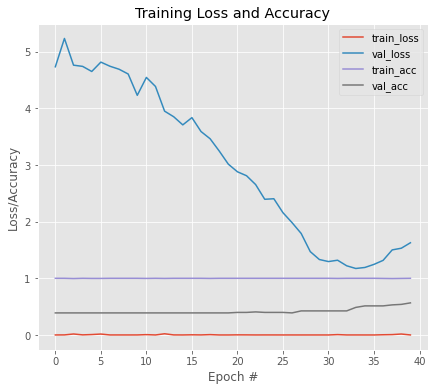


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:40
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.7413e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 1.18647, saving model to resnet50_b_3.hdf5
15/15 [==============================] - 17s 453ms/step - loss: 5.7413e-04 - accuracy: 1.0000 - val_loss: 1.1865 - val_accuracy: 0.4956
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.1836e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.18647
15/15 [==============================] - 5s 339ms/step - loss: 3.1836e-05 - accuracy: 1.0000 - val_loss: 1.2617 - val_accuracy: 0.5044
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 6.2561e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 1.18647
15/15 [==============================] - 5s 339ms/step - loss: 6.2561e-04 - accuracy: 1.0000 - val_loss: 1.4354 - val_accuracy: 0.5221
Epoch 4/50
15/15 [=====================

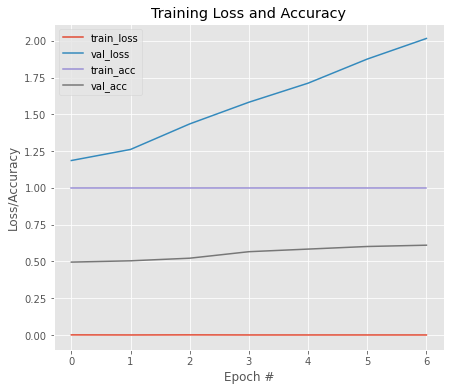


Model Performance Summary:

Best Validation accuracy:0.6106194853782654 at EPOCH:7
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 6.5785e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 2.30331, saving model to resnet50_a_4.hdf5
15/15 [==============================] - 18s 561ms/step - loss: 6.5785e-05 - accuracy: 1.0000 - val_loss: 2.3033 - val_accuracy: 0.5179
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.5216e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.30331
15/15 [==============================] - 5s 337ms/step - loss: 3.5216e-05 - accuracy: 1.0000 - val_loss: 2.3348 - val_accuracy: 0.5179
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 2.30331
15/15 [==============================] - 5s 339ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 2.3722 - val_accuracy: 0.5179
Epoch 4/50
15/15 [==============

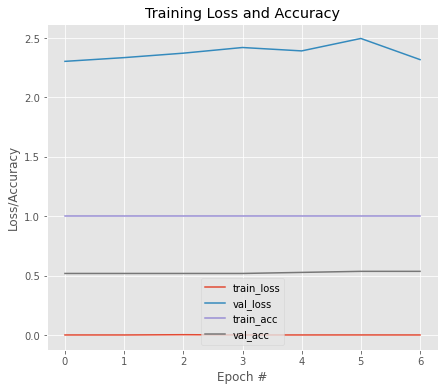


Model Performance Summary:

Best Validation accuracy:0.5357142686843872 at EPOCH:6
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.2039e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 2.38264, saving model to resnet50_b_4.hdf5
15/15 [==============================] - 17s 455ms/step - loss: 5.2039e-05 - accuracy: 1.0000 - val_loss: 2.3826 - val_accuracy: 0.5268
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.5498e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.38264
15/15 [==============================] - 5s 339ms/step - loss: 2.5498e-05 - accuracy: 1.0000 - val_loss: 2.4410 - val_accuracy: 0.5268
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 5.7329e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 2.38264 to 2.23572, saving model to resnet50_b_4.hdf5
15/15 [==============================] - 6s 388ms/step - loss: 5.7329e-04 - accuracy: 1.0000 - val_loss: 2.2357 - val_accuracy: 0.5268
E

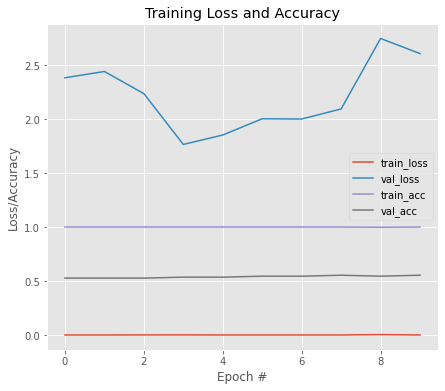


Model Performance Summary:

Best Validation accuracy:0.5535714030265808 at EPOCH:8
Average Accuracy:0.5284133970737457
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 1.2666 - accuracy: 0.4663
Epoch 1: val_loss improved from inf to 1.24454, saving model to resnet50_wt.hdf5
18/18 [==============================] - 7s 266ms/step - loss: 1.2666 - accuracy: 0.4663 - val_loss: 1.2445 - val_accuracy: 0.4965
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 1.2377 - accuracy: 0.4610
Epoch 2: val_loss improved from 1.24454 to 1.22027, saving model to resnet50_wt.hdf5
18/18 [==============================] - 3s 152ms/step - loss: 1.2377 - accuracy: 0.4610 - val_loss: 1.2203 - val_accuracy: 0.4965
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 1.2120 - accuracy: 0.4663
Epoch 3: val_loss improved from 1.22027 to 1.19476, saving model to resnet50_wt.hdf5
18/18 [==

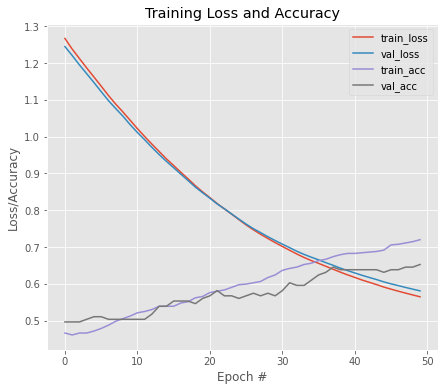


Model Performance Summary:

Best Validation accuracy:0.652482271194458 at EPOCH:50
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 3.3786e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.67539, saving model to resnet50_wt.hdf5
18/18 [==============================] - 19s 506ms/step - loss: 3.3786e-04 - accuracy: 1.0000 - val_loss: 0.6754 - val_accuracy: 0.6383
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 3.1126e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.67539
18/18 [==============================] - 6s 348ms/step - loss: 3.1126e-04 - accuracy: 1.0000 - val_loss: 0.9232 - val_accuracy: 0.6241
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0061 - accuracy: 0.9982
Epoch 3: val_loss improved from 0.67539 to 0.50934, saving model to resnet50_wt.hdf5
18/18 [==============================] - 7s 394ms/step - loss: 0.0061 - accuracy: 0.9982 - val_

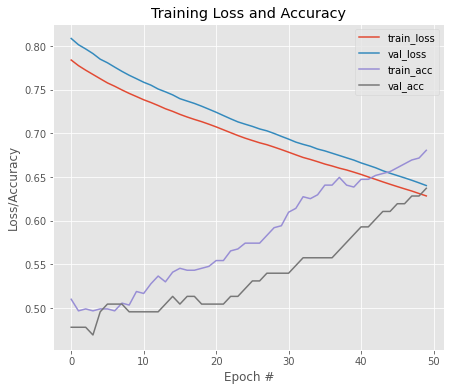


Model Performance Summary:

Best Validation accuracy:0.6371681690216064 at EPOCH:50
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.5115 - accuracy: 0.7428
Epoch 1: val_loss improved from inf to 0.59892, saving model to DenseNet121_b_0.hdf5
15/15 [==============================] - 31s 656ms/step - loss: 0.5115 - accuracy: 0.7428 - val_loss: 0.5989 - val_accuracy: 0.6903
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2452 - accuracy: 0.9335
Epoch 2: val_loss improved from 0.59892 to 0.58011, saving model to DenseNet121_b_0.hdf5
15/15 [==============================] - 6s 430ms/step - loss: 0.2452 - accuracy: 0.9335 - val_loss: 0.5801 - val_accuracy: 0.6991
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.1646 - accuracy: 0.9690
Epoch 3: val_loss improved from 0.58011 to 0.57749, saving model to DenseNet121_b_0.hdf5
15/15 [==============================] - 6s 432ms/step - loss: 0.1646 - accuracy: 0.9690 - val_loss: 0.5775

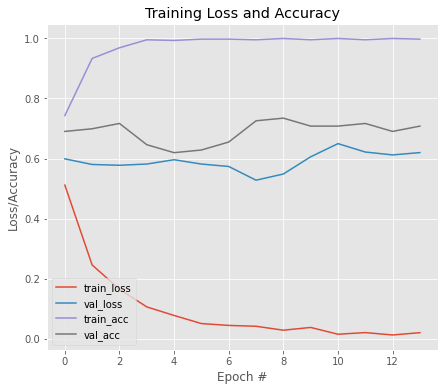


Model Performance Summary:

Best Validation accuracy:0.7345132827758789 at EPOCH:9
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0443 - accuracy: 0.9911
Epoch 1: val_loss improved from inf to 0.37814, saving model to DenseNet121_a_1.hdf5
15/15 [==============================] - 28s 552ms/step - loss: 0.0443 - accuracy: 0.9911 - val_loss: 0.3781 - val_accuracy: 0.8496
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0266 - accuracy: 0.9911
Epoch 2: val_loss improved from 0.37814 to 0.37221, saving model to DenseNet121_a_1.hdf5
15/15 [==============================] - 6s 435ms/step - loss: 0.0266 - accuracy: 0.9911 - val_loss: 0.3722 - val_accuracy: 0.8407
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0243 - accuracy: 0.9933
Epoch 3: val_loss did not improve from 0.37221
15/15 [==============================] - 6s 375ms/step - loss: 0.0243 - accuracy: 0.9933 - val_loss: 0.3812 - val_accuracy: 0.8230
Epo

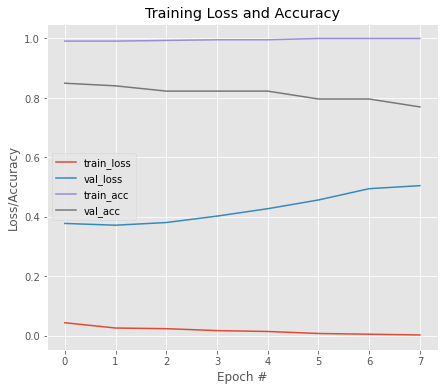


Model Performance Summary:

Best Validation accuracy:0.8495575189590454 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0068 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.39512, saving model to DenseNet121_b_1.hdf5
15/15 [==============================] - 27s 602ms/step - loss: 0.0068 - accuracy: 0.9978 - val_loss: 0.3951 - val_accuracy: 0.8319
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0104 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 0.39512
15/15 [==============================] - 6s 372ms/step - loss: 0.0104 - accuracy: 0.9978 - val_loss: 0.4603 - val_accuracy: 0.8053
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.39512
15/15 [==============================] - 6s 375ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 0.5110 - val_accuracy: 0.7699
Epoch 4/50
15/15 [==============================] - ETA: 0s -

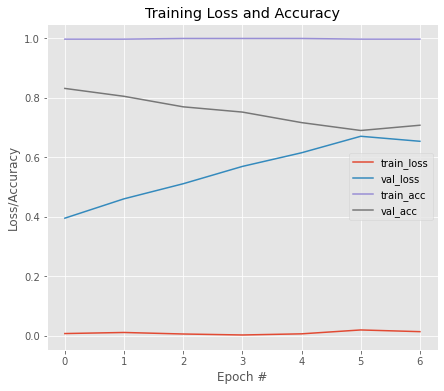


Model Performance Summary:

Best Validation accuracy:0.8318583965301514 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0060 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.62963, saving model to DenseNet121_a_2.hdf5
15/15 [==============================] - 27s 555ms/step - loss: 0.0060 - accuracy: 1.0000 - val_loss: 0.6296 - val_accuracy: 0.6726
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0145 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 0.62963
15/15 [==============================] - 6s 374ms/step - loss: 0.0145 - accuracy: 0.9978 - val_loss: 0.7273 - val_accuracy: 0.6460
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.62963
15/15 [==============================] - 6s 374ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 0.7206 - val_accuracy: 0.6460
Epoch 4/50
15/15 [===========================

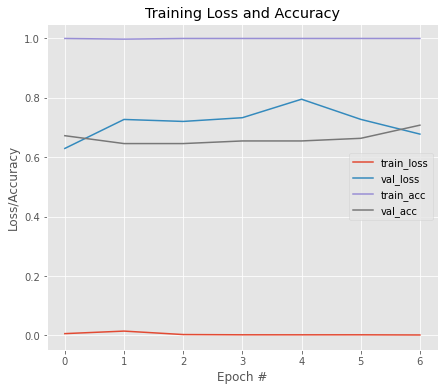


Model Performance Summary:

Best Validation accuracy:0.7079645991325378 at EPOCH:7
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.82847, saving model to DenseNet121_b_2.hdf5
15/15 [==============================] - 27s 549ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.8285 - val_accuracy: 0.6460
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 9.8702e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.82847
15/15 [==============================] - 6s 371ms/step - loss: 9.8702e-04 - accuracy: 1.0000 - val_loss: 0.9092 - val_accuracy: 0.6460
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.82847
15/15 [==============================] - 6s 371ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 1.0386 - val_accuracy: 0.6372
Epoch 4/50
15/15 [==============================] - E

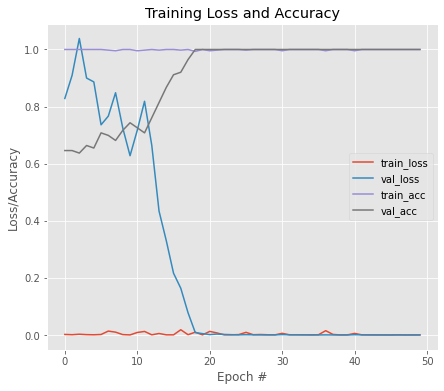


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:19
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 1.6104e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00018, saving model to DenseNet121_a_3.hdf5
15/15 [==============================] - 27s 557ms/step - loss: 1.6104e-04 - accuracy: 1.0000 - val_loss: 1.7855e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.6138e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00018 to 0.00003, saving model to DenseNet121_a_3.hdf5
15/15 [==============================] - 6s 432ms/step - loss: 2.6138e-04 - accuracy: 1.0000 - val_loss: 3.1658e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 6.0816e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00003
15/15 [==============================] - 6s 395ms/step - loss: 6.0816e-04 - accuracy: 1.0000 - val_loss: 2.4548e-04 - va

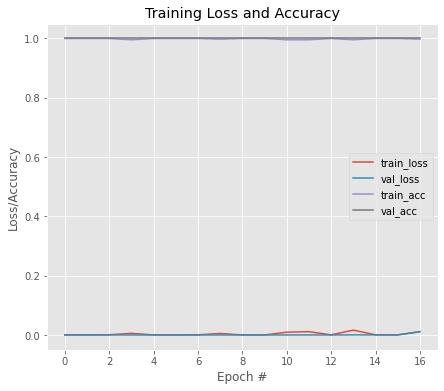


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0117 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.14349, saving model to DenseNet121_b_3.hdf5
15/15 [==============================] - 27s 557ms/step - loss: 0.0117 - accuracy: 0.9978 - val_loss: 0.1435 - val_accuracy: 0.9558
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 9.5462e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.14349 to 0.02850, saving model to DenseNet121_b_3.hdf5
15/15 [==============================] - 6s 435ms/step - loss: 9.5462e-04 - accuracy: 1.0000 - val_loss: 0.0285 - val_accuracy: 0.9823
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0080 - accuracy: 0.9978
Epoch 3: val_loss improved from 0.02850 to 0.02298, saving model to DenseNet121_b_3.hdf5
15/15 [==============================] - 7s 440ms/step - loss: 0.0080 - accuracy: 0.9978 - val_loss: 0.0230 - val_a

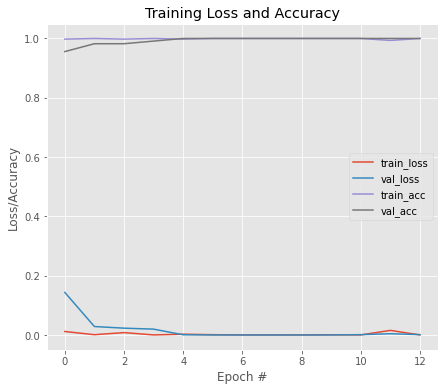


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:5
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0114 - accuracy: 0.9934
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_a_4.hdf5
15/15 [==============================] - 30s 795ms/step - loss: 0.0114 - accuracy: 0.9934 - val_loss: 4.7055e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to DenseNet121_a_4.hdf5
15/15 [==============================] - 7s 437ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 4.2691e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.2249e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
15/15 [==============================] - 6s 376ms/step - loss: 1.2249e-04 - accuracy: 1.0000 - val_loss: 4.2979e-06 - val_accuracy: 1.000

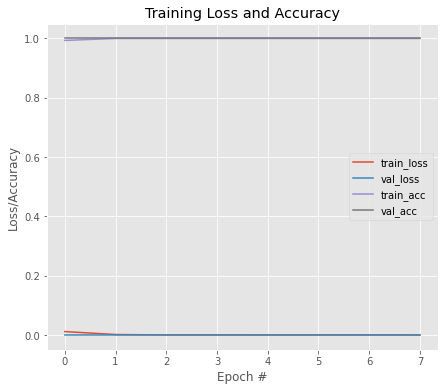


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.8681e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to DenseNet121_b_4.hdf5
15/15 [==============================] - 27s 551ms/step - loss: 2.8681e-05 - accuracy: 1.0000 - val_loss: 4.2585e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.7274e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00000
15/15 [==============================] - 6s 373ms/step - loss: 3.7274e-04 - accuracy: 1.0000 - val_loss: 2.0761e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.3278e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
15/15 [==============================] - 6s 394ms/step - loss: 1.3278e-04 - accuracy: 1.0000 - val_loss: 4.5001e-06 - val_accuracy: 1.0000
Epoch 4/50
15/15 [======================

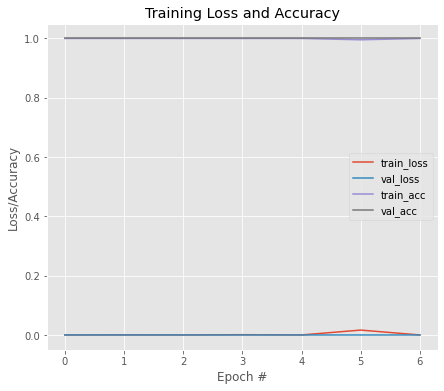


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9132743358612061
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 3.7667e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.04821, saving model to DenseNet121_wt.hdf5
18/18 [==============================] - 12s 392ms/step - loss: 3.7667e-05 - accuracy: 1.0000 - val_loss: 0.0482 - val_accuracy: 0.9787
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 3.4271e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.04821 to 0.04554, saving model to DenseNet121_wt.hdf5
18/18 [==============================] - 3s 163ms/step - loss: 3.4271e-05 - accuracy: 1.0000 - val_loss: 0.0455 - val_accuracy: 0.9787
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 3.1888e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.04554 to 0.04345, saving model to DenseNet121_wt

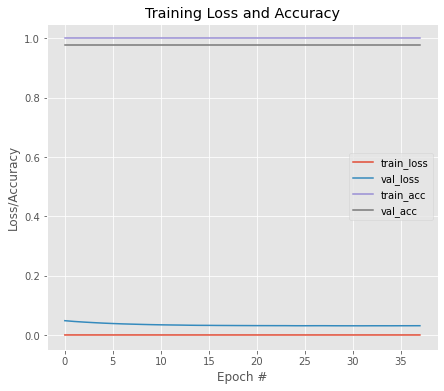


Model Performance Summary:

Best Validation accuracy:0.978723406791687 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 8.5821e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.04533, saving model to DenseNet121_wt.hdf5
18/18 [==============================] - 31s 725ms/step - loss: 8.5821e-04 - accuracy: 1.0000 - val_loss: 0.0453 - val_accuracy: 0.9716
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 1.5227e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.04533 to 0.02660, saving model to DenseNet121_wt.hdf5
18/18 [==============================] - 8s 434ms/step - loss: 1.5227e-04 - accuracy: 1.0000 - val_loss: 0.0266 - val_accuracy: 0.9787
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 1.1303e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.02660
18/18 [==============================] - 7s 386ms/step - loss: 1.1303e-04 - accuracy: 

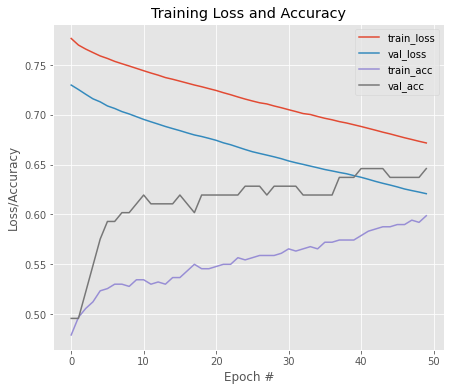


Model Performance Summary:

Best Validation accuracy:0.6460176706314087 at EPOCH:41
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4676 - accuracy: 0.7827
Epoch 1: val_loss improved from inf to 1.10860, saving model to MobileNet_b_0.hdf5
15/15 [==============================] - 8s 263ms/step - loss: 0.4676 - accuracy: 0.7827 - val_loss: 1.1086 - val_accuracy: 0.5575
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2924 - accuracy: 0.8891
Epoch 2: val_loss did not improve from 1.10860
15/15 [==============================] - 3s 195ms/step - loss: 0.2924 - accuracy: 0.8891 - val_loss: 1.6401 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2086 - accuracy: 0.9401
Epoch 3: val_loss did not improve from 1.10860
15/15 [==============================] - 3s 197ms/step - loss: 0.2086 - accuracy: 0.9401 - val_loss: 2.1073 - val_accuracy: 0.5575
Epoch 4/50
15/15 [==============================] - ETA: 0s - l

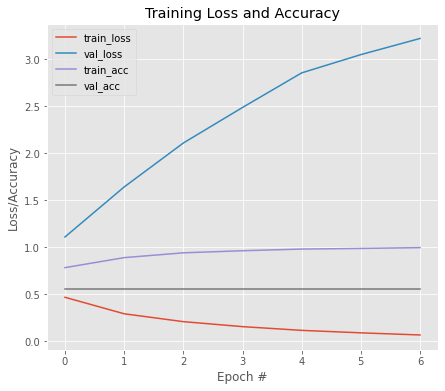


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:1
Starting fold 1
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0797 - accuracy: 0.9844
Epoch 1: val_loss improved from inf to 4.16553, saving model to MobileNet_a_1.hdf5
15/15 [==============================] - 8s 246ms/step - loss: 0.0850 - accuracy: 0.9778 - val_loss: 4.1655 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0599 - accuracy: 0.9933
Epoch 2: val_loss did not improve from 4.16553
15/15 [==============================] - 3s 195ms/step - loss: 0.0599 - accuracy: 0.9933 - val_loss: 4.1657 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0437 - accuracy: 0.9933
Epoch 3: val_loss improved from 4.16553 to 4.10804, saving model to MobileNet_a_1.hdf5
15/15 [==============================] - 3s 212ms/step - loss: 0.0437 - accuracy: 0.9933 - val_loss: 4.1080 - val_accuracy: 0.5133
Epoch 4/

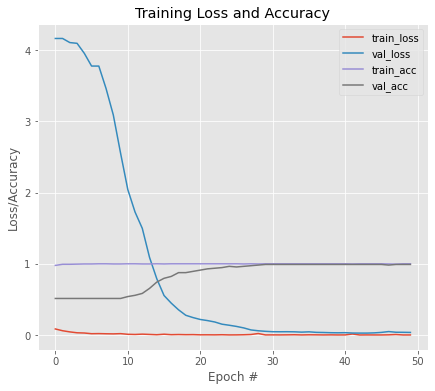


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:30
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 6.3287e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.04819, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 8s 245ms/step - loss: 7.0840e-04 - accuracy: 1.0000 - val_loss: 0.0482 - val_accuracy: 0.9735
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 0.9978
Epoch 2: val_loss improved from 0.04819 to 0.04152, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 3s 210ms/step - loss: 0.0026 - accuracy: 0.9978 - val_loss: 0.0415 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 7.9443e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.04152 to 0.03796, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 3s 216ms/step - loss: 7.9443e-04 - accuracy: 1.0000 - val_loss

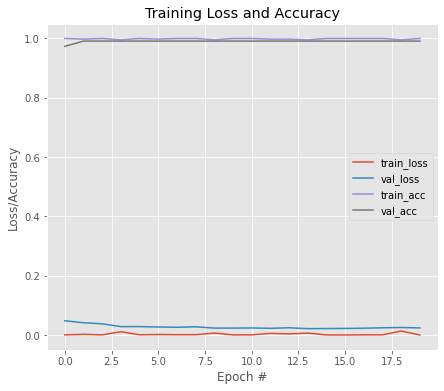


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:2
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0199 - accuracy: 0.9956
Epoch 1: val_loss improved from inf to 0.00004, saving model to MobileNet_a_2.hdf5
15/15 [==============================] - 8s 246ms/step - loss: 0.0199 - accuracy: 0.9956 - val_loss: 4.2390e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0145 - accuracy: 0.9933
Epoch 2: val_loss did not improve from 0.00004
15/15 [==============================] - 3s 195ms/step - loss: 0.0145 - accuracy: 0.9933 - val_loss: 4.9667e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 0.00004
15/15 [==============================] - 3s 199ms/step - loss: 0.0037 - accuracy: 0.9978 - val_loss: 4.8057e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [===================

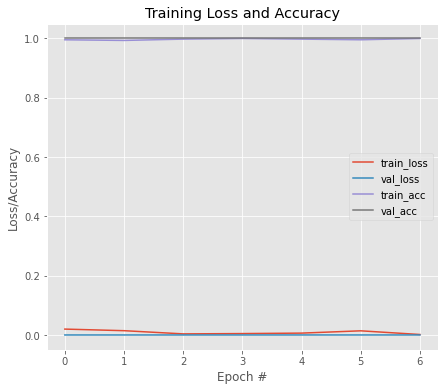


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00003, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 8s 243ms/step - loss: 0.0079 - accuracy: 0.9978 - val_loss: 3.4828e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00003 to 0.00003, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 3s 214ms/step - loss: 0.0036 - accuracy: 1.0000 - val_loss: 3.0947e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00003 to 0.00003, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 3s 215ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 2.8140e-05 - val_accu

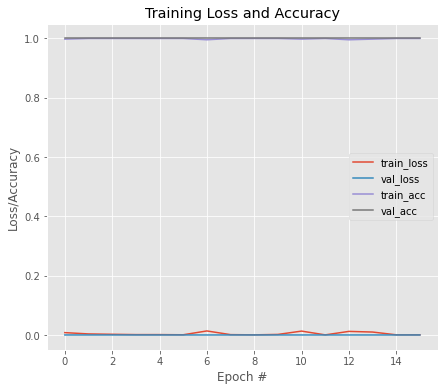


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_a_3.hdf5
15/15 [==============================] - 8s 242ms/step - loss: 0.0058 - accuracy: 0.9978 - val_loss: 1.2713e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.6169e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 192ms/step - loss: 1.6169e-04 - accuracy: 1.0000 - val_loss: 1.2895e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 194ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.2949e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [=========================

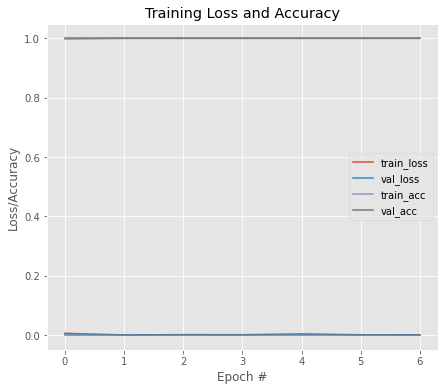


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.2116e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00002, saving model to MobileNet_b_3.hdf5
15/15 [==============================] - 8s 242ms/step - loss: 5.2116e-04 - accuracy: 1.0000 - val_loss: 1.6121e-05 - val_accuracy: 1.0000
Epoch 2/50
14/15 [===========================>..] - ETA: 0s - loss: 5.8971e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00002 to 0.00001, saving model to MobileNet_b_3.hdf5
15/15 [==============================] - 3s 210ms/step - loss: 6.1212e-04 - accuracy: 1.0000 - val_loss: 1.3999e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.5111e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 195ms/step - loss: 1.5111e-04 - accuracy: 1.0000 - val_loss: 1.4774e-05 - val_accuracy: 1.0000
Epo

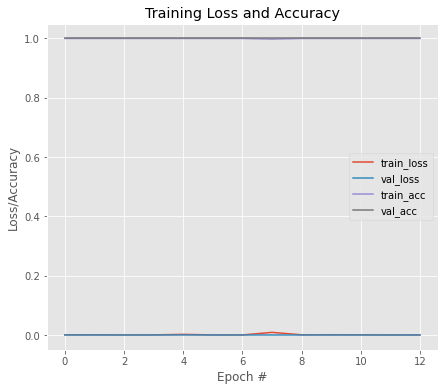


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.4299e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_a_4.hdf5
15/15 [==============================] - 8s 290ms/step - loss: 2.4299e-04 - accuracy: 1.0000 - val_loss: 9.4801e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.7626e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_a_4.hdf5
15/15 [==============================] - 3s 211ms/step - loss: 2.7626e-04 - accuracy: 1.0000 - val_loss: 7.6622e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.1432e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 191ms/step - loss: 1.1432e-04 - accuracy: 1.0000 - val_loss: 7.7474e-06 - val_accu

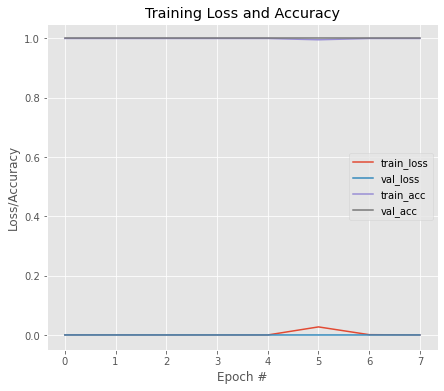


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 6.8139e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_b_4.hdf5
15/15 [==============================] - 8s 261ms/step - loss: 6.8139e-05 - accuracy: 1.0000 - val_loss: 6.5532e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 7.5736e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 201ms/step - loss: 7.5736e-04 - accuracy: 1.0000 - val_loss: 7.0300e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 8.8640e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_b_4.hdf5
15/15 [==============================] - 3s 212ms/step - loss: 8.8640e-05 - accuracy: 1.0000 - val_loss: 6.3978e-06 - val_accuracy: 1.0000
Epo

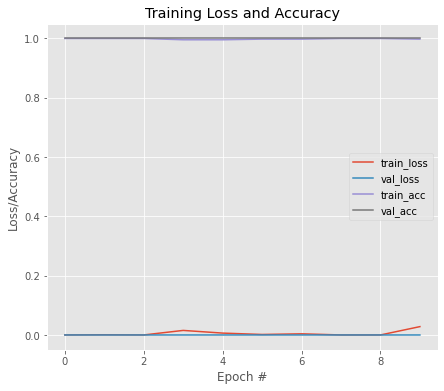


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9097345113754273
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 6.6028e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.06132, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 3s 116ms/step - loss: 6.6028e-05 - accuracy: 1.0000 - val_loss: 0.0613 - val_accuracy: 0.9645
Epoch 2/50
17/18 [===========================>..] - ETA: 0s - loss: 6.6052e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.06132 to 0.06127, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 1s 62ms/step - loss: 6.4399e-05 - accuracy: 1.0000 - val_loss: 0.0613 - val_accuracy: 0.9645
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 6.3206e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.06127 to 0.06125, saving model to MobileNet_wt.hdf5
18

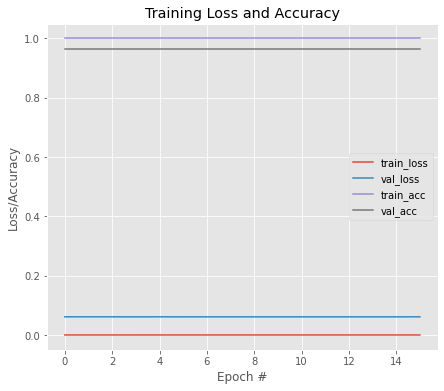


Model Performance Summary:

Best Validation accuracy:0.9645389914512634 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 2.8863e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.05297, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 9s 266ms/step - loss: 2.8863e-04 - accuracy: 1.0000 - val_loss: 0.0530 - val_accuracy: 0.9787
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.05297
18/18 [==============================] - 4s 199ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 0.0540 - val_accuracy: 0.9787
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.05297 to 0.05285, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 4s 215ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0

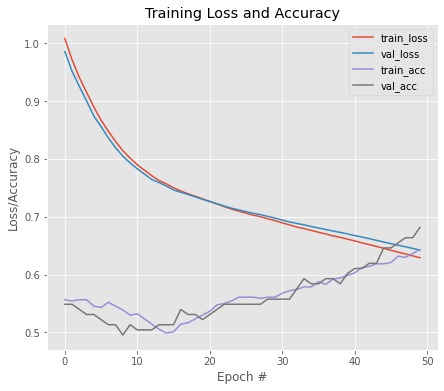


Model Performance Summary:

Best Validation accuracy:0.6814159154891968 at EPOCH:50
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4469 - accuracy: 0.8004
Epoch 1: val_loss improved from inf to 0.71306, saving model to MobileNetV2_b_0.hdf5
15/15 [==============================] - 13s 322ms/step - loss: 0.4469 - accuracy: 0.8004 - val_loss: 0.7131 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2915 - accuracy: 0.9268
Epoch 2: val_loss did not improve from 0.71306
15/15 [==============================] - 3s 211ms/step - loss: 0.2915 - accuracy: 0.9268 - val_loss: 0.8024 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2074 - accuracy: 0.9623
Epoch 3: val_loss did not improve from 0.71306
15/15 [==============================] - 3s 214ms/step - loss: 0.2074 - accuracy: 0.9623 - val_loss: 0.9117 - val_accuracy: 0.5487
Epoch 4/50
15/15 [==============================] - ETA: 0s 

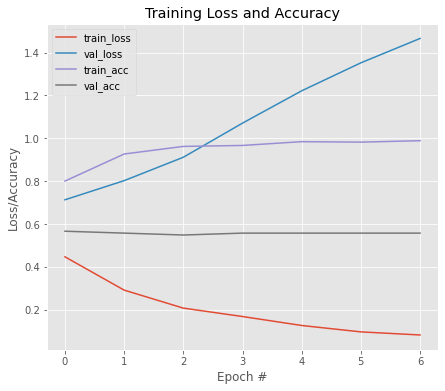


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Starting fold 1
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0608 - accuracy: 0.9955
Epoch 1: val_loss improved from inf to 1.95437, saving model to MobileNetV2_a_1.hdf5
15/15 [==============================] - 12s 297ms/step - loss: 0.0686 - accuracy: 0.9911 - val_loss: 1.9544 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0478 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 1.95437
15/15 [==============================] - 3s 219ms/step - loss: 0.0478 - accuracy: 0.9978 - val_loss: 2.0859 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0437 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 1.95437
15/15 [==============================] - 3s 217ms/step - loss: 0.0437 - accuracy: 0.9956 - val_loss: 2.1997 - val_accuracy: 0.5133
Epoch 4/50
15/15 [===========================

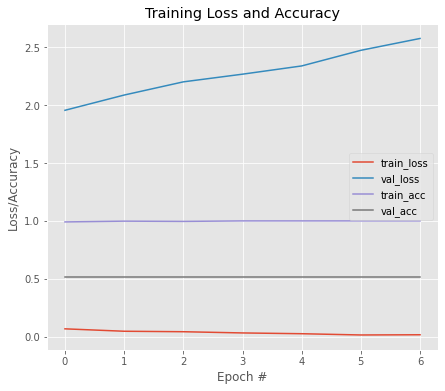


Model Performance Summary:

Best Validation accuracy:0.5132743120193481 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0416 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 2.39518, saving model to MobileNetV2_b_1.hdf5
15/15 [==============================] - 12s 298ms/step - loss: 0.0416 - accuracy: 0.9978 - val_loss: 2.3952 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0226 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.39518
15/15 [==============================] - 3s 218ms/step - loss: 0.0226 - accuracy: 1.0000 - val_loss: 2.7027 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0259 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 2.39518
15/15 [==============================] - 3s 214ms/step - loss: 0.0259 - accuracy: 0.9978 - val_loss: 2.7960 - val_accuracy: 0.5133
Epoch 4/50
14/15 [===========================>..] - ETA: 0s -

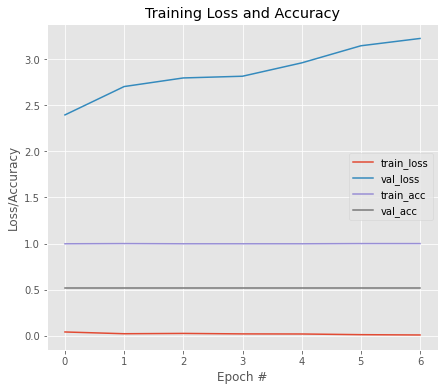


Model Performance Summary:

Best Validation accuracy:0.5132743120193481 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0155 - accuracy: 0.9933
Epoch 1: val_loss improved from inf to 3.29783, saving model to MobileNetV2_a_2.hdf5
15/15 [==============================] - 12s 298ms/step - loss: 0.0155 - accuracy: 0.9933 - val_loss: 3.2978 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0101 - accuracy: 0.9978
Epoch 2: val_loss improved from 3.29783 to 3.20968, saving model to MobileNetV2_a_2.hdf5
15/15 [==============================] - 4s 241ms/step - loss: 0.0101 - accuracy: 0.9978 - val_loss: 3.2097 - val_accuracy: 0.5664
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0135 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 3.20968
15/15 [==============================] - 3s 219ms/step - loss: 0.0135 - accuracy: 0.9978 - val_loss: 3.2287 - val_accuracy: 0.5664
Epo

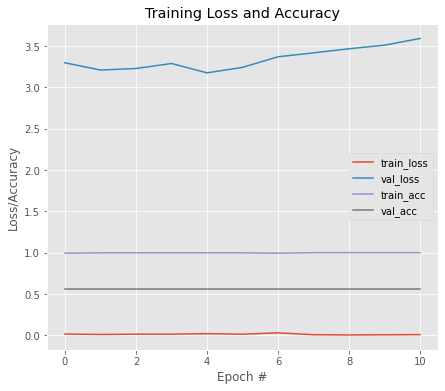


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0120 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.44994, saving model to MobileNetV2_b_2.hdf5
15/15 [==============================] - 12s 297ms/step - loss: 0.0120 - accuracy: 1.0000 - val_loss: 3.4499 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 1.0000
Epoch 2: val_loss improved from 3.44994 to 3.44808, saving model to MobileNetV2_b_2.hdf5
15/15 [==============================] - 4s 242ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 3.4481 - val_accuracy: 0.5664
Epoch 3/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0057 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.44808
15/15 [==============================] - 3s 213ms/step - loss: 0.0059 - accuracy: 1.0000 - val_loss: 3.5277 - val_accuracy: 0.5664
Epoch 4/50
15/15 [=

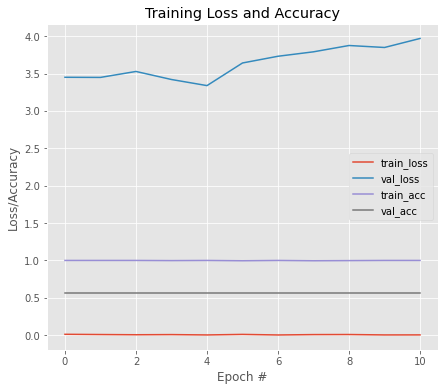


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Starting fold 3
Epoch 1/50


In [ ]:
for model in MODEL_LIST_1:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx2,trainy2,testx2,testy2,data_aug=False,dataset = 'ACRIMA')
  gc.collect()

83697664/83683744 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.8408 - accuracy: 0.4457
Epoch 1: val_loss improved from inf to 0.85284, saving model to xception_a_0.hdf5
15/15 [==============================] - 10s 415ms/step - loss: 0.8408 - accuracy: 0.4457 - val_loss: 0.8528 - val_accuracy: 0.4425
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.8247 - accuracy: 0.4457
Epoch 2: val_loss improved from 0.85284 to 0.84097, saving model to xception_a_0.hdf5
15/15 [==============================] - 4s 297ms/step - loss: 0.8247 - accuracy: 0.4457 - val_loss: 0.8410 - val_accuracy: 0.4425
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.8123 - accuracy: 0.4435
Epoch 3: val_loss improved from 0.84097 to 0.82962, saving model to xception_a_0.hdf5
15/15 [==============================] - 4s 300ms/step - loss: 0.8123 - accuracy: 0.4435 - val_loss: 0.8296 - val_accura

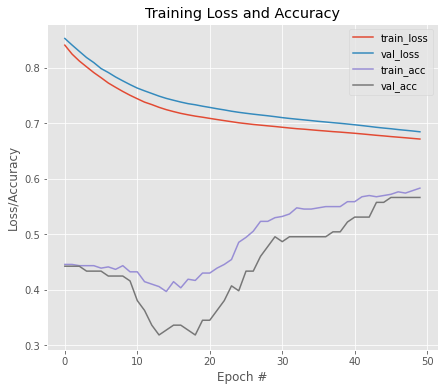


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:46
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.5675 - accuracy: 0.7206
Epoch 1: val_loss improved from inf to 0.67267, saving model to xception_b_0.hdf5
15/15 [==============================] - 29s 1s/step - loss: 0.5675 - accuracy: 0.7206 - val_loss: 0.6727 - val_accuracy: 0.5752
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.4403 - accuracy: 0.9002
Epoch 2: val_loss improved from 0.67267 to 0.66034, saving model to xception_b_0.hdf5
15/15 [==============================] - 19s 1s/step - loss: 0.4403 - accuracy: 0.9002 - val_loss: 0.6603 - val_accuracy: 0.5664
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.3416 - accuracy: 0.9468
Epoch 3: val_loss improved from 0.66034 to 0.64465, saving model to xception_b_0.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.3416 - accuracy: 0.9468 - val_loss: 0.6447 - val_accuracy:

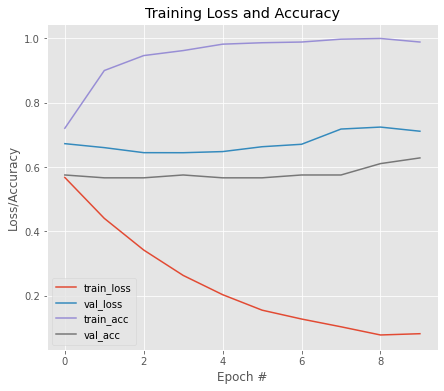


Model Performance Summary:

Best Validation accuracy:0.6283186078071594 at EPOCH:10
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0829 - accuracy: 0.9800
Epoch 1: val_loss improved from inf to 0.79962, saving model to xception_a_1.hdf5
15/15 [==============================] - 25s 1s/step - loss: 0.0829 - accuracy: 0.9800 - val_loss: 0.7996 - val_accuracy: 0.5752
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0492 - accuracy: 0.9933
Epoch 2: val_loss improved from 0.79962 to 0.74923, saving model to xception_a_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0492 - accuracy: 0.9933 - val_loss: 0.7492 - val_accuracy: 0.6018
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0279 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.74923 to 0.67689, saving model to xception_a_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0279 - accuracy: 1.0000 - val_loss: 0.6769

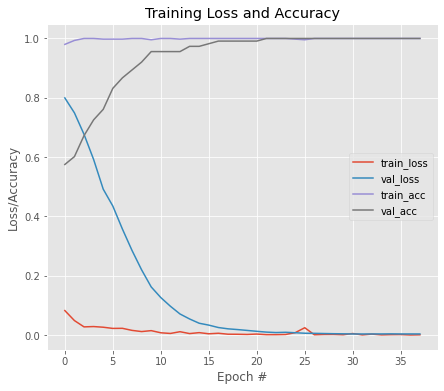


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:22
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00384, saving model to xception_b_1.hdf5
15/15 [==============================] - 26s 1s/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0038 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00384 to 0.00374, saving model to xception_b_1.hdf5
15/15 [==============================] - 19s 1s/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 0.0037 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0112 - accuracy: 0.9978
Epoch 3: val_loss improved from 0.00374 to 0.00363, saving model to xception_b_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0112 - accuracy: 0.9978 - val_loss: 0.0036 - val_accuracy: 1.0000
Epoch 4

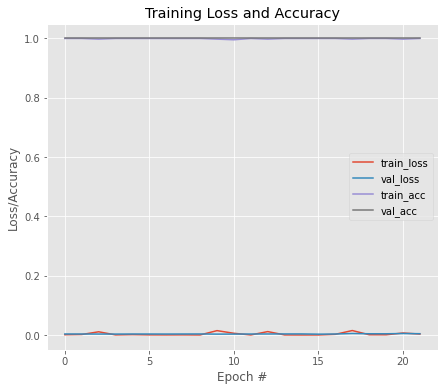


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0221 - accuracy: 0.9933
Epoch 1: val_loss improved from inf to 0.00014, saving model to xception_a_2.hdf5
15/15 [==============================] - 26s 1s/step - loss: 0.0221 - accuracy: 0.9933 - val_loss: 1.4221e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00014
15/15 [==============================] - 18s 1s/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.4283e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0095 - accuracy: 0.9978
Epoch 3: val_loss improved from 0.00014 to 0.00014, saving model to xception_a_2.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0095 - accuracy: 0.9978 - val_loss: 1.4111e-04 - val_accuracy: 1.0000
Epoch 4/50
15/15 [=

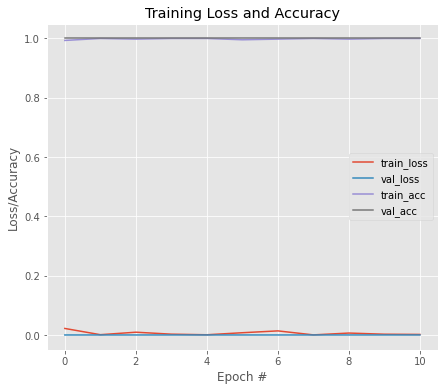


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00012, saving model to xception_b_2.hdf5
15/15 [==============================] - 26s 1s/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 1.1631e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 5.0781e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00012 to 0.00011, saving model to xception_b_2.hdf5
15/15 [==============================] - 19s 1s/step - loss: 5.0781e-04 - accuracy: 1.0000 - val_loss: 1.0924e-04 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00011 to 0.00010, saving model to xception_b_2.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 9.8763e-05 - val_accur

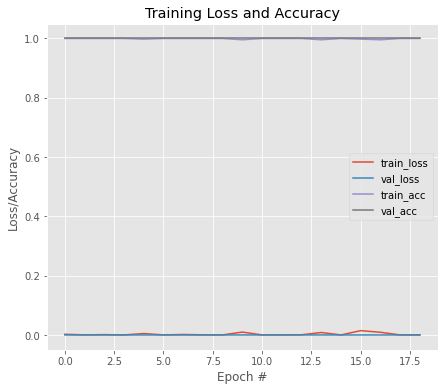


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0063 - accuracy: 0.9956
Epoch 1: val_loss improved from inf to 0.00004, saving model to xception_a_3.hdf5
15/15 [==============================] - 25s 1s/step - loss: 0.0063 - accuracy: 0.9956 - val_loss: 4.4854e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.2035e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00004
15/15 [==============================] - 17s 1s/step - loss: 1.2035e-04 - accuracy: 1.0000 - val_loss: 4.6213e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 4.6216e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00004
15/15 [==============================] - 17s 1s/step - loss: 4.6216e-04 - accuracy: 1.0000 - val_loss: 4.5994e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [========================

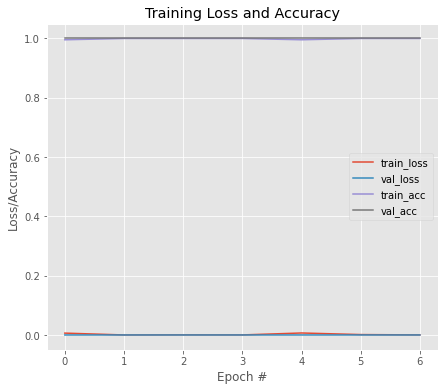


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.3936e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00003, saving model to xception_b_3.hdf5
15/15 [==============================] - 25s 1s/step - loss: 2.3936e-04 - accuracy: 1.0000 - val_loss: 3.3192e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.9067e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00003 to 0.00003, saving model to xception_b_3.hdf5
15/15 [==============================] - 18s 1s/step - loss: 1.9067e-04 - accuracy: 1.0000 - val_loss: 2.6741e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 6.9007e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00003 to 0.00002, saving model to xception_b_3.hdf5
15/15 [==============================] - 18s 1s/step - loss: 6.9007e-05 - accuracy: 1.0000 - val_loss: 2.4802

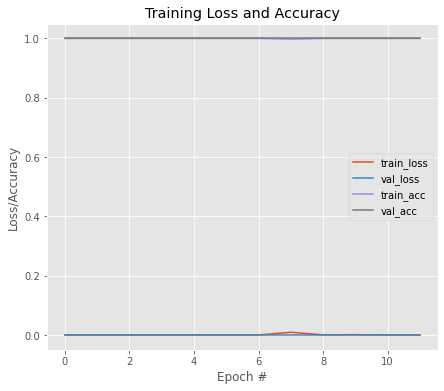


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 1.0363e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to xception_a_4.hdf5
15/15 [==============================] - 27s 1s/step - loss: 1.0363e-04 - accuracy: 1.0000 - val_loss: 1.3621e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 7.5571e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to xception_a_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 7.5571e-05 - accuracy: 1.0000 - val_loss: 1.1661e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 4.6402e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to xception_a_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 4.6402e-05 - accuracy: 1.0000 - 

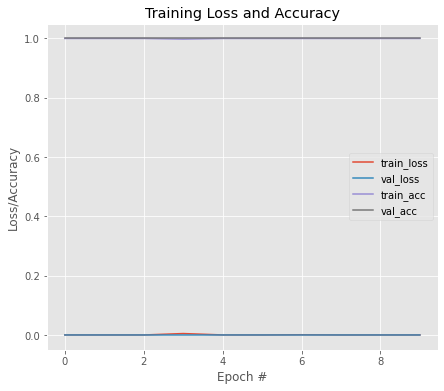


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 6.1616e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to xception_b_4.hdf5
15/15 [==============================] - 25s 1s/step - loss: 6.1616e-05 - accuracy: 1.0000 - val_loss: 8.0529e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.2449e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to xception_b_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 2.2449e-05 - accuracy: 1.0000 - val_loss: 7.5176e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 0.9978
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to xception_b_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0035 - accuracy: 0.9978 - val_loss: 7.2174e-06 - v

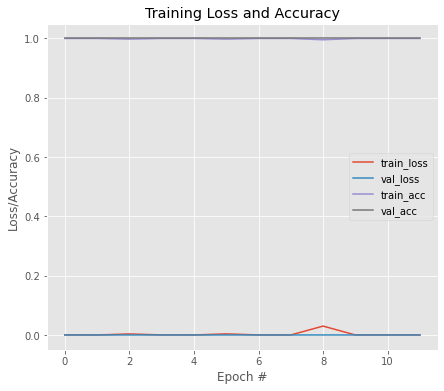


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9256637215614318
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 7.8239e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.16137, saving model to xception_wt.hdf5
18/18 [==============================] - 11s 477ms/step - loss: 7.8239e-04 - accuracy: 1.0000 - val_loss: 0.1614 - val_accuracy: 0.9504
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 7.6592e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.16137
18/18 [==============================] - 6s 330ms/step - loss: 7.6592e-04 - accuracy: 1.0000 - val_loss: 0.1617 - val_accuracy: 0.9504
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 7.5559e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.16137
18/18 [==============================] - 6s 329ms/step - loss: 7.5559e-04 - acc

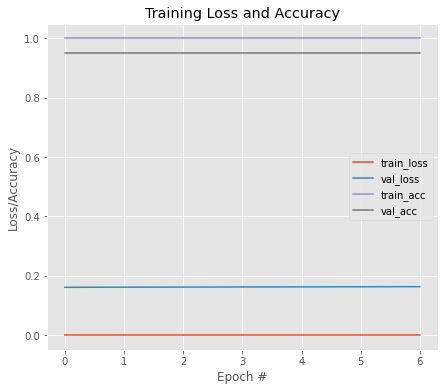


Model Performance Summary:

Best Validation accuracy:0.9503546357154846 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 0.9982
Epoch 1: val_loss improved from inf to 0.14661, saving model to xception_wt.hdf5
18/18 [==============================] - 31s 1s/step - loss: 0.0058 - accuracy: 0.9982 - val_loss: 0.1466 - val_accuracy: 0.9574
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 5.6729e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.14661
18/18 [==============================] - 21s 1s/step - loss: 5.6729e-04 - accuracy: 1.0000 - val_loss: 0.1536 - val_accuracy: 0.9574
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 5.4740e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.14661
18/18 [==============================] - 21s 1s/step - loss: 5.4740e-04 - accuracy: 1.0000 - val_loss: 0.1474 - val_accuracy: 0.9574
Epoch 4/5

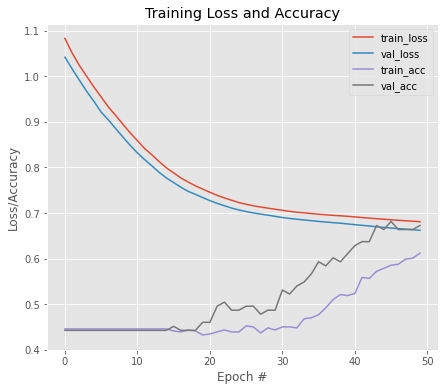


Model Performance Summary:

Best Validation accuracy:0.6814159154891968 at EPOCH:46
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.5441 - accuracy: 0.7095
Epoch 1: val_loss improved from inf to 0.72082, saving model to InceptionResNetV2_b_0.hdf5
15/15 [==============================] - 55s 2s/step - loss: 0.5441 - accuracy: 0.7095 - val_loss: 0.7208 - val_accuracy: 0.5575
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.3221 - accuracy: 0.9135
Epoch 2: val_loss did not improve from 0.72082
15/15 [==============================] - 16s 1s/step - loss: 0.3221 - accuracy: 0.9135 - val_loss: 0.7555 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2056 - accuracy: 0.9667
Epoch 3: val_loss did not improve from 0.72082
15/15 [==============================] - 17s 1s/step - loss: 0.2056 - accuracy: 0.9667 - val_loss: 0.8381 - val_accuracy: 0.5575
Epoch 4/50
15/15 [==============================] - ETA: 0s -

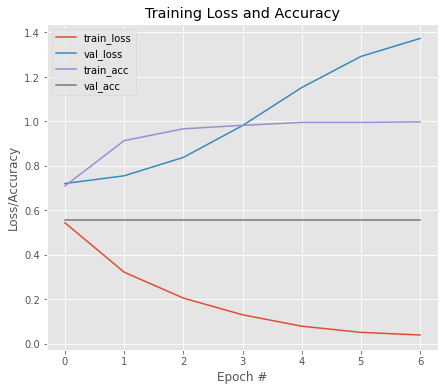


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:1
Starting fold 1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0440 - accuracy: 0.9911
Epoch 1: val_loss improved from inf to 1.44122, saving model to InceptionResNetV2_a_1.hdf5
15/15 [==============================] - 49s 1s/step - loss: 0.0440 - accuracy: 0.9911 - val_loss: 1.4412 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0201 - accuracy: 1.0000
Epoch 2: val_loss improved from 1.44122 to 1.44049, saving model to InceptionResNetV2_a_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0201 - accuracy: 1.0000 - val_loss: 1.4405 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0187 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 1.44049
15/15 [==============================] - 17s 1s/step - loss: 0.0187 - accuracy: 0.9956 - val_loss: 1.4803 - val_accuracy: 0.513

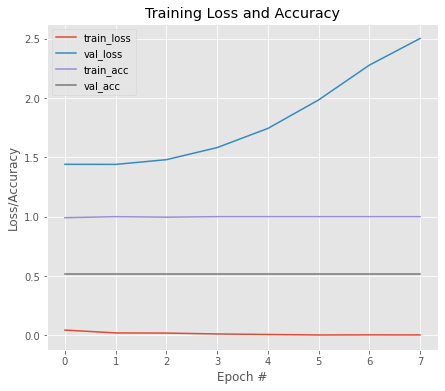


Model Performance Summary:

Best Validation accuracy:0.5132743120193481 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0129 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 1.65451, saving model to InceptionResNetV2_b_1.hdf5
15/15 [==============================] - 49s 1s/step - loss: 0.0129 - accuracy: 1.0000 - val_loss: 1.6545 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 0.9978
Epoch 2: val_loss improved from 1.65451 to 1.61587, saving model to InceptionResNetV2_b_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0100 - accuracy: 0.9978 - val_loss: 1.6159 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0077 - accuracy: 0.9978
Epoch 3: val_loss improved from 1.61587 to 1.58971, saving model to InceptionResNetV2_b_1.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0077 - accuracy: 0.9978 - val_lo

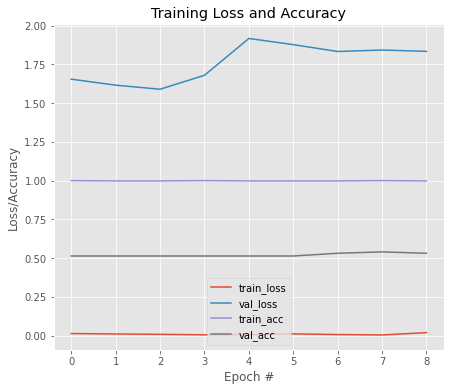


Model Performance Summary:

Best Validation accuracy:0.5398229956626892 at EPOCH:8
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0059 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 1.38622, saving model to InceptionResNetV2_a_2.hdf5
15/15 [==============================] - 49s 1s/step - loss: 0.0059 - accuracy: 0.9978 - val_loss: 1.3862 - val_accuracy: 0.6372
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 1.38622
15/15 [==============================] - 16s 1s/step - loss: 0.0047 - accuracy: 0.9978 - val_loss: 1.3979 - val_accuracy: 0.6460
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 3: val_loss improved from 1.38622 to 1.28526, saving model to InceptionResNetV2_a_2.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 1.2853 - val_accuracy: 0.654

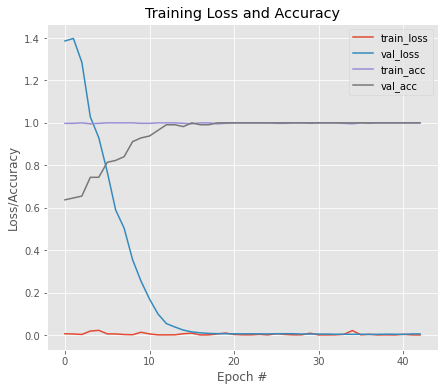


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:16
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 1.4601e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00017, saving model to InceptionResNetV2_b_2.hdf5
15/15 [==============================] - 49s 1s/step - loss: 1.4601e-04 - accuracy: 1.0000 - val_loss: 1.7320e-04 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.1961e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00017 to 0.00007, saving model to InceptionResNetV2_b_2.hdf5
15/15 [==============================] - 18s 1s/step - loss: 1.1961e-04 - accuracy: 1.0000 - val_loss: 7.0912e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 7.9641e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00007 to 0.00003, saving model to InceptionResNetV2_b_2.hdf5
15/15 [==============================] - 18s 1s/step - loss: 7.9641e-04 - accurac

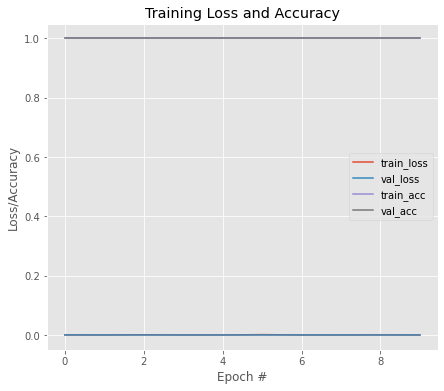


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.3566e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_a_3.hdf5
15/15 [==============================] - 49s 1s/step - loss: 2.3566e-04 - accuracy: 1.0000 - val_loss: 2.8684e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 0.00000
15/15 [==============================] - 16s 1s/step - loss: 0.0024 - accuracy: 0.9978 - val_loss: 3.1216e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 3.5332e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00000
15/15 [==============================] - 16s 1s/step - loss: 3.5332e-04 - accuracy: 1.0000 - val_loss: 3.5003e-06 - val_accuracy: 1.0000
Epoch 4/50
15/15 [===============

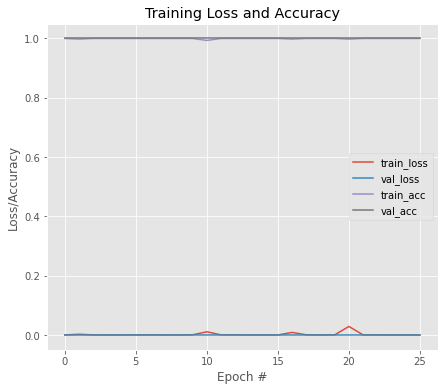


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 1.3302e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_b_3.hdf5
15/15 [==============================] - 49s 1s/step - loss: 1.3302e-05 - accuracy: 1.0000 - val_loss: 7.9543e-07 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 4.4603e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to InceptionResNetV2_b_3.hdf5
15/15 [==============================] - 18s 1s/step - loss: 4.4603e-05 - accuracy: 1.0000 - val_loss: 7.8383e-07 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 8.4846e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to InceptionResNetV2_b_3.hdf5
15/15 [==============================] - 19s 1s/step - loss: 8.4846e-05 - accuracy

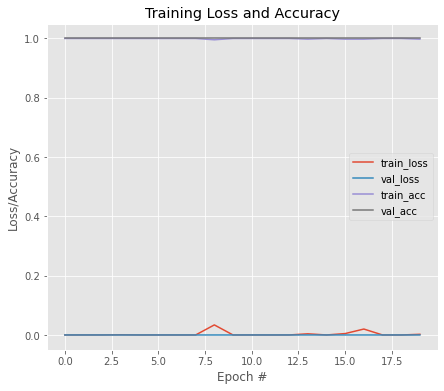


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.0115e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_a_4.hdf5
15/15 [==============================] - 53s 2s/step - loss: 5.0115e-05 - accuracy: 1.0000 - val_loss: 1.9786e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 3.6716e-05 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00000
15/15 [==============================] - 17s 1s/step - loss: 3.6716e-05 - accuracy: 1.0000 - val_loss: 4.4565e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0085 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 0.00000
15/15 [==============================] - 17s 1s/step - loss: 0.0085 - accuracy: 0.9978 - val_loss: 4.4618e-06 - val_accuracy: 1.0000
Epoch 4/50
15/15 [===============

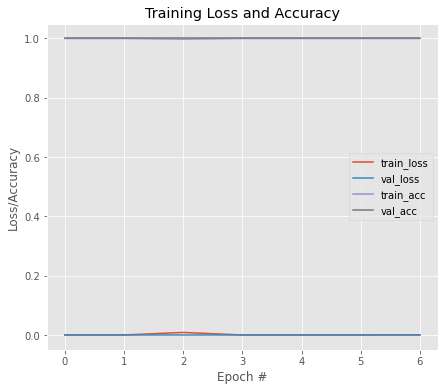


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 6.0379e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00000, saving model to InceptionResNetV2_b_4.hdf5
15/15 [==============================] - 49s 1s/step - loss: 6.0379e-04 - accuracy: 1.0000 - val_loss: 4.3830e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.4915e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00000 to 0.00000, saving model to InceptionResNetV2_b_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 2.4915e-05 - accuracy: 1.0000 - val_loss: 2.0265e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 0.9978
Epoch 3: val_loss improved from 0.00000 to 0.00000, saving model to InceptionResNetV2_b_4.hdf5
15/15 [==============================] - 18s 1s/step - loss: 0.0031 - accuracy: 0.9978

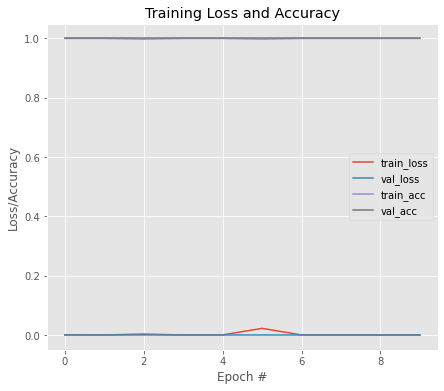


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8194690227508545
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.12830, saving model to InceptionResNetV2_wt.hdf5
18/18 [==============================] - 23s 836ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.1283 - val_accuracy: 0.9645
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.12830
18/18 [==============================] - 7s 413ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.1291 - val_accuracy: 0.9645
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.12830
18/18 [==============================] - 7s 413ms/step - loss: 0.0018 - accuracy: 1.0000 -

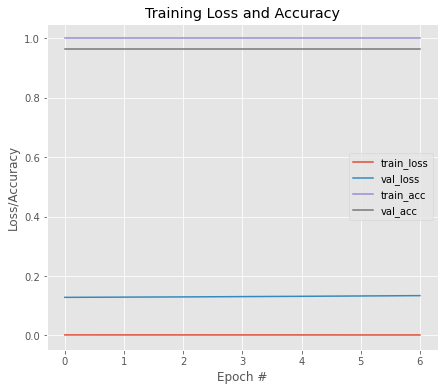


Model Performance Summary:

Best Validation accuracy:0.9645389914512634 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.10102, saving model to InceptionResNetV2_wt.hdf5
18/18 [==============================] - 56s 2s/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.1010 - val_accuracy: 0.9716
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 7.5574e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.10102
18/18 [==============================] - 20s 1s/step - loss: 7.5574e-04 - accuracy: 1.0000 - val_loss: 0.1377 - val_accuracy: 0.9645
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 7.5022e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.10102 to 0.08482, saving model to InceptionResNetV2_wt.hdf5
18/18 [==============================] - 23s 1s/step - loss: 7.5022e-04 - accuracy: 1.

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx2,trainy2,testx2,testy2,data_aug=False,dataset = 'ACRIMA')
  gc.collect()

Starting fold 0
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 0.7731 - accuracy: 0.4869
Epoch 1: val_loss improved from inf to 0.72988, saving model to MobileNet_a_0.hdf5
15/15 [==============================] - 4s 127ms/step - loss: 0.7767 - accuracy: 0.4789 - val_loss: 0.7299 - val_accuracy: 0.4956
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.7700 - accuracy: 0.4967
Epoch 2: val_loss improved from 0.72988 to 0.72539, saving model to MobileNet_a_0.hdf5
15/15 [==============================] - 1s 69ms/step - loss: 0.7700 - accuracy: 0.4967 - val_loss: 0.7254 - val_accuracy: 0.4956
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.7660 - accuracy: 0.5055
Epoch 3: val_loss improved from 0.72539 to 0.72064, saving model to MobileNet_a_0.hdf5
15/15 [==============================] - 1s 71ms/step - loss: 0.7660 - accuracy: 0.5055 - val_loss: 0.7206 - val_accuracy: 0.5221
Epoch 4/50
15/15 [==============================] - ET

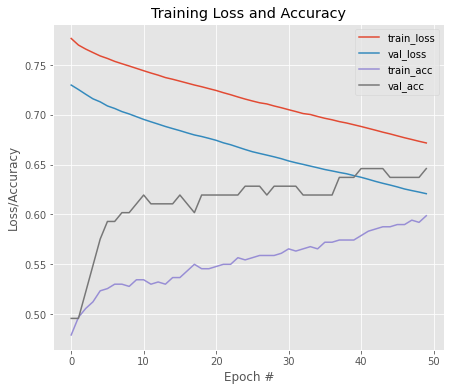


Model Performance Summary:

Best Validation accuracy:0.6460176706314087 at EPOCH:41
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4676 - accuracy: 0.7827
Epoch 1: val_loss improved from inf to 1.10851, saving model to MobileNet_b_0.hdf5
15/15 [==============================] - 10s 259ms/step - loss: 0.4676 - accuracy: 0.7827 - val_loss: 1.1085 - val_accuracy: 0.5575
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2924 - accuracy: 0.8891
Epoch 2: val_loss did not improve from 1.10851
15/15 [==============================] - 3s 187ms/step - loss: 0.2924 - accuracy: 0.8891 - val_loss: 1.6406 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2086 - accuracy: 0.9401
Epoch 3: val_loss did not improve from 1.10851
15/15 [==============================] - 3s 188ms/step - loss: 0.2086 - accuracy: 0.9401 - val_loss: 2.1083 - val_accuracy: 0.5575
Epoch 4/50
15/15 [==============================] - ETA: 0s - 

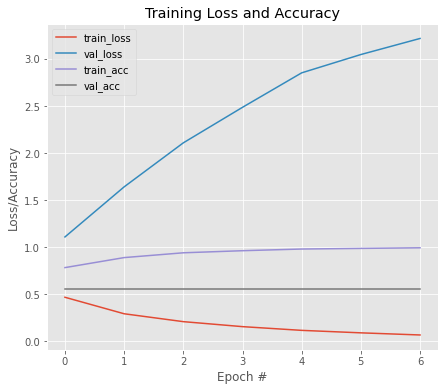


Model Performance Summary:

Best Validation accuracy:0.5575221180915833 at EPOCH:1
Starting fold 1
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0797 - accuracy: 0.9844
Epoch 1: val_loss improved from inf to 4.16567, saving model to MobileNet_a_1.hdf5
15/15 [==============================] - 7s 237ms/step - loss: 0.0850 - accuracy: 0.9778 - val_loss: 4.1657 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0599 - accuracy: 0.9933
Epoch 2: val_loss improved from 4.16567 to 4.16564, saving model to MobileNet_a_1.hdf5
15/15 [==============================] - 3s 198ms/step - loss: 0.0599 - accuracy: 0.9933 - val_loss: 4.1656 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0436 - accuracy: 0.9933
Epoch 3: val_loss improved from 4.16564 to 4.10918, saving model to MobileNet_a_1.hdf5
15/15 [==============================] - 3s 204ms/step - loss: 0.0436 - accuracy: 0.9933 - val_loss

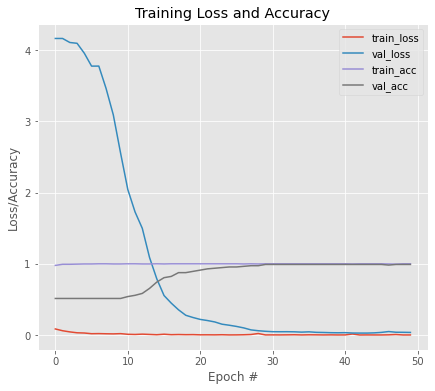


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:30
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 6.3249e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.04808, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 8s 238ms/step - loss: 7.0891e-04 - accuracy: 1.0000 - val_loss: 0.0481 - val_accuracy: 0.9912
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 0.9978
Epoch 2: val_loss improved from 0.04808 to 0.04147, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 3s 208ms/step - loss: 0.0026 - accuracy: 0.9978 - val_loss: 0.0415 - val_accuracy: 0.9912
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 7.9705e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.04147 to 0.03800, saving model to MobileNet_b_1.hdf5
15/15 [==============================] - 3s 209ms/step - loss: 7.9705e-04 - accuracy: 1.0000 - val_loss

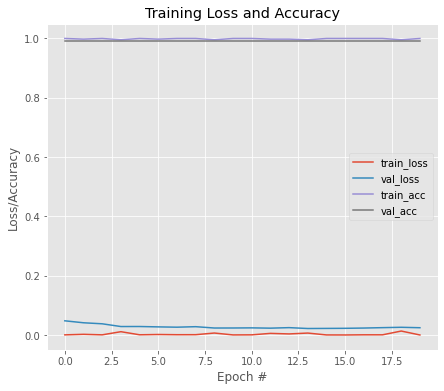


Model Performance Summary:

Best Validation accuracy:0.991150438785553 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0200 - accuracy: 0.9956
Epoch 1: val_loss improved from inf to 0.00004, saving model to MobileNet_a_2.hdf5
15/15 [==============================] - 8s 241ms/step - loss: 0.0200 - accuracy: 0.9956 - val_loss: 4.2764e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0146 - accuracy: 0.9956
Epoch 2: val_loss did not improve from 0.00004
15/15 [==============================] - 3s 195ms/step - loss: 0.0146 - accuracy: 0.9956 - val_loss: 5.0228e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0038 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 0.00004
15/15 [==============================] - 3s 190ms/step - loss: 0.0038 - accuracy: 0.9978 - val_loss: 4.8468e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [===================

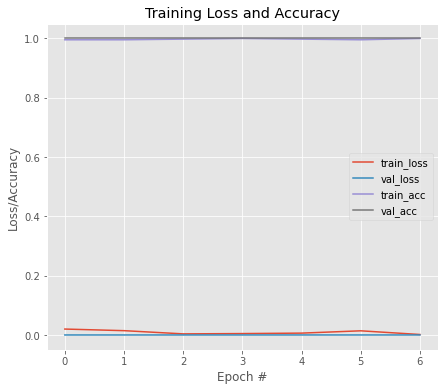


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0081 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00004, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 8s 241ms/step - loss: 0.0081 - accuracy: 0.9978 - val_loss: 3.5069e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00004 to 0.00003, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 3s 211ms/step - loss: 0.0036 - accuracy: 1.0000 - val_loss: 3.1076e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00003 to 0.00003, saving model to MobileNet_b_2.hdf5
15/15 [==============================] - 3s 208ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 2.8308e-05 - val_accu

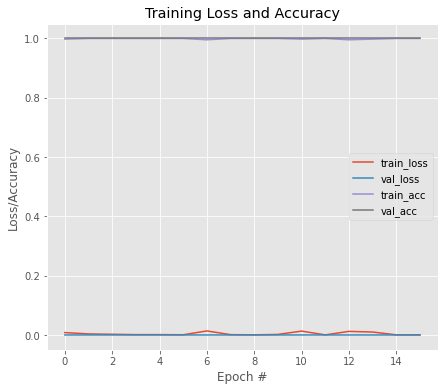


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0058 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_a_3.hdf5
15/15 [==============================] - 8s 240ms/step - loss: 0.0058 - accuracy: 0.9978 - val_loss: 1.2603e-05 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.6209e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 191ms/step - loss: 1.6209e-04 - accuracy: 1.0000 - val_loss: 1.2788e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 193ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.2837e-05 - val_accuracy: 1.0000
Epoch 4/50
15/15 [=========================

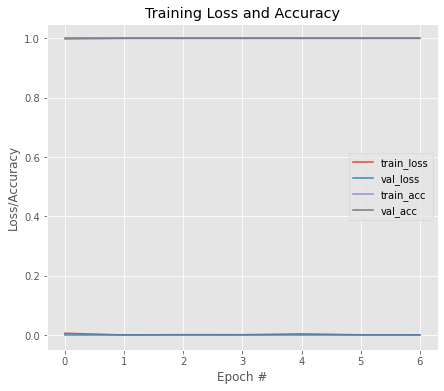


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 5.2019e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00002, saving model to MobileNet_b_3.hdf5
15/15 [==============================] - 8s 244ms/step - loss: 5.2019e-04 - accuracy: 1.0000 - val_loss: 1.6230e-05 - val_accuracy: 1.0000
Epoch 2/50
14/15 [===========================>..] - ETA: 0s - loss: 5.8743e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00002 to 0.00001, saving model to MobileNet_b_3.hdf5
15/15 [==============================] - 3s 206ms/step - loss: 6.1029e-04 - accuracy: 1.0000 - val_loss: 1.3900e-05 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.5062e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 196ms/step - loss: 1.5062e-04 - accuracy: 1.0000 - val_loss: 1.4724e-05 - val_accuracy: 1.0000
Epo

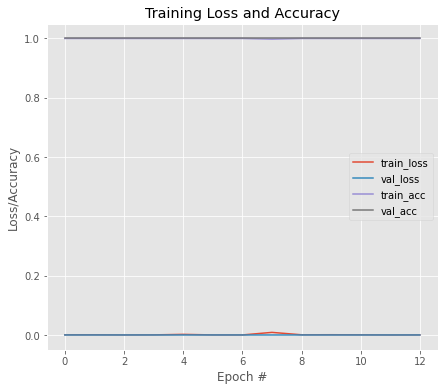


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 2.4091e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_a_4.hdf5
15/15 [==============================] - 8s 296ms/step - loss: 2.4091e-04 - accuracy: 1.0000 - val_loss: 9.3800e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 2.7797e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_a_4.hdf5
15/15 [==============================] - 3s 212ms/step - loss: 2.7797e-04 - accuracy: 1.0000 - val_loss: 7.6165e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.1542e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 193ms/step - loss: 1.1542e-04 - accuracy: 1.0000 - val_loss: 7.7080e-06 - val_accu

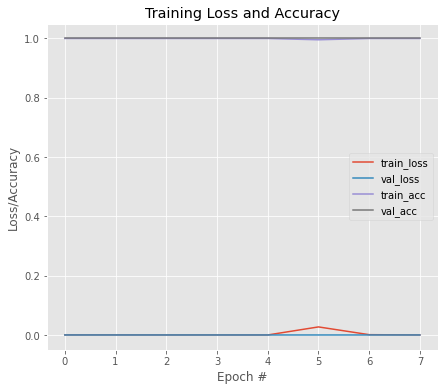


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 6.7477e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00001, saving model to MobileNet_b_4.hdf5
15/15 [==============================] - 8s 265ms/step - loss: 6.7477e-05 - accuracy: 1.0000 - val_loss: 6.5904e-06 - val_accuracy: 1.0000
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 7.7614e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00001
15/15 [==============================] - 3s 204ms/step - loss: 7.7614e-04 - accuracy: 1.0000 - val_loss: 6.9534e-06 - val_accuracy: 1.0000
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 8.8482e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to MobileNet_b_4.hdf5
15/15 [==============================] - 3s 212ms/step - loss: 8.8482e-05 - accuracy: 1.0000 - val_loss: 6.3254e-06 - val_accuracy: 1.0000
Epo

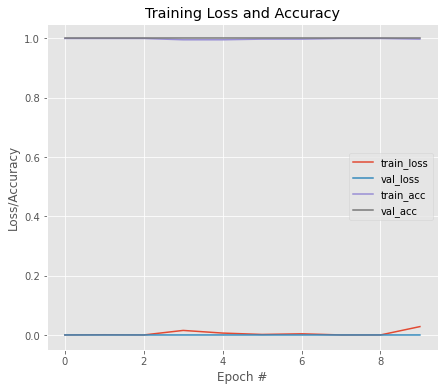


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9097345113754273
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 6.6062e-05 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.06122, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 4s 125ms/step - loss: 6.6062e-05 - accuracy: 1.0000 - val_loss: 0.0612 - val_accuracy: 0.9645
Epoch 2/50
17/18 [===========================>..] - ETA: 0s - loss: 6.6083e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.06122 to 0.06118, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 1s 62ms/step - loss: 6.4437e-05 - accuracy: 1.0000 - val_loss: 0.0612 - val_accuracy: 0.9645
Epoch 3/50
17/18 [===========================>..] - ETA: 0s - loss: 5.9880e-05 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.06118 to 0.06116, saving model to MobileNet_wt.hdf5
18

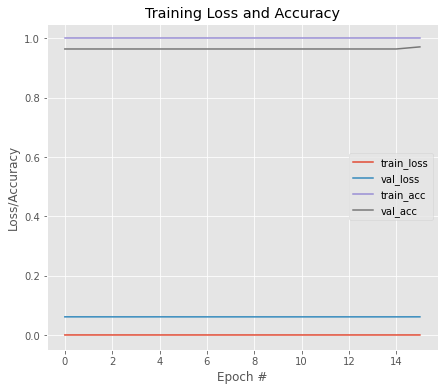


Model Performance Summary:

Best Validation accuracy:0.9716312289237976 at EPOCH:16
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 2.8755e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.05310, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 9s 269ms/step - loss: 2.8755e-04 - accuracy: 1.0000 - val_loss: 0.0531 - val_accuracy: 0.9787
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.05310
18/18 [==============================] - 4s 204ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 0.0541 - val_accuracy: 0.9787
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.05310 to 0.05293, saving model to MobileNet_wt.hdf5
18/18 [==============================] - 4s 211ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 

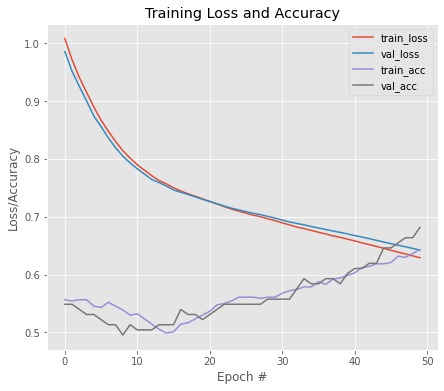


Model Performance Summary:

Best Validation accuracy:0.6814159154891968 at EPOCH:50
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.4469 - accuracy: 0.8004
Epoch 1: val_loss improved from inf to 0.71308, saving model to MobileNetV2_b_0.hdf5
15/15 [==============================] - 13s 319ms/step - loss: 0.4469 - accuracy: 0.8004 - val_loss: 0.7131 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.2915 - accuracy: 0.9268
Epoch 2: val_loss did not improve from 0.71308
15/15 [==============================] - 3s 217ms/step - loss: 0.2915 - accuracy: 0.9268 - val_loss: 0.8030 - val_accuracy: 0.5575
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.2074 - accuracy: 0.9623
Epoch 3: val_loss did not improve from 0.71308
15/15 [==============================] - 3s 223ms/step - loss: 0.2074 - accuracy: 0.9623 - val_loss: 0.9123 - val_accuracy: 0.5487
Epoch 4/50
15/15 [==============================] - ETA: 0s 

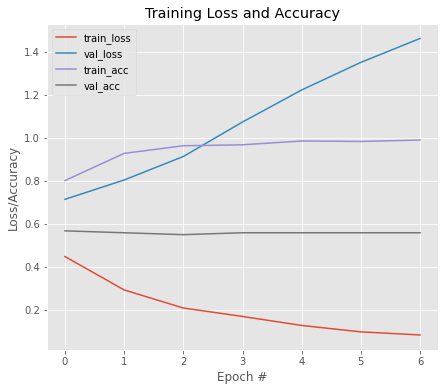


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Starting fold 1
Epoch 1/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0609 - accuracy: 0.9955
Epoch 1: val_loss improved from inf to 1.91829, saving model to MobileNetV2_a_1.hdf5
15/15 [==============================] - 12s 293ms/step - loss: 0.0689 - accuracy: 0.9911 - val_loss: 1.9183 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0479 - accuracy: 0.9978
Epoch 2: val_loss did not improve from 1.91829
15/15 [==============================] - 3s 213ms/step - loss: 0.0479 - accuracy: 0.9978 - val_loss: 2.0436 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0436 - accuracy: 0.9956
Epoch 3: val_loss did not improve from 1.91829
15/15 [==============================] - 3s 213ms/step - loss: 0.0436 - accuracy: 0.9956 - val_loss: 2.1695 - val_accuracy: 0.5133
Epoch 4/50
15/15 [===========================

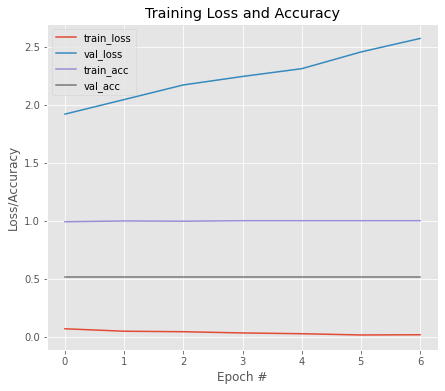


Model Performance Summary:

Best Validation accuracy:0.5132743120193481 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0419 - accuracy: 0.9956
Epoch 1: val_loss improved from inf to 2.36954, saving model to MobileNetV2_b_1.hdf5
15/15 [==============================] - 12s 292ms/step - loss: 0.0419 - accuracy: 0.9956 - val_loss: 2.3695 - val_accuracy: 0.5133
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0226 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.36954
15/15 [==============================] - 3s 216ms/step - loss: 0.0226 - accuracy: 1.0000 - val_loss: 2.6920 - val_accuracy: 0.5133
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0260 - accuracy: 0.9978
Epoch 3: val_loss did not improve from 2.36954
15/15 [==============================] - 3s 213ms/step - loss: 0.0260 - accuracy: 0.9978 - val_loss: 2.7897 - val_accuracy: 0.5133
Epoch 4/50
14/15 [===========================>..] - ETA: 0s -

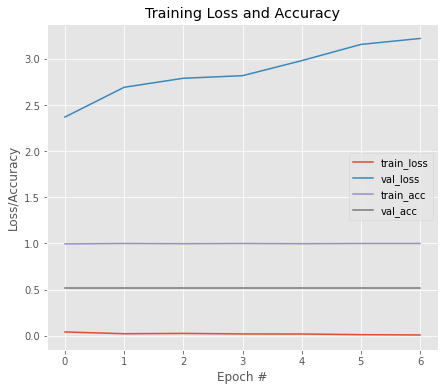


Model Performance Summary:

Best Validation accuracy:0.5132743120193481 at EPOCH:1
Starting fold 2
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0154 - accuracy: 0.9933
Epoch 1: val_loss improved from inf to 3.28101, saving model to MobileNetV2_a_2.hdf5
15/15 [==============================] - 12s 297ms/step - loss: 0.0154 - accuracy: 0.9933 - val_loss: 3.2810 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0102 - accuracy: 0.9978
Epoch 2: val_loss improved from 3.28101 to 3.20998, saving model to MobileNetV2_a_2.hdf5
15/15 [==============================] - 4s 236ms/step - loss: 0.0102 - accuracy: 0.9978 - val_loss: 3.2100 - val_accuracy: 0.5664
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0135 - accuracy: 0.9978
Epoch 3: val_loss improved from 3.20998 to 3.20907, saving model to MobileNetV2_a_2.hdf5
15/15 [==============================] - 4s 243ms/step - loss: 0.0135 - accuracy: 0.9978 - v

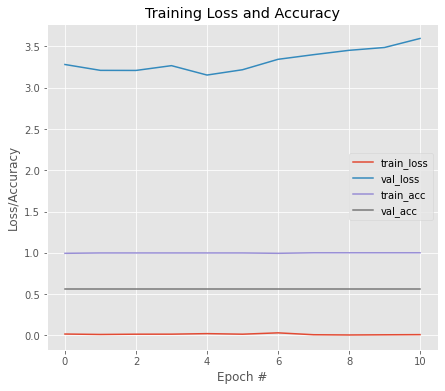


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0117 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.46597, saving model to MobileNetV2_b_2.hdf5
15/15 [==============================] - 12s 291ms/step - loss: 0.0117 - accuracy: 1.0000 - val_loss: 3.4660 - val_accuracy: 0.5664
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 1.0000
Epoch 2: val_loss improved from 3.46597 to 3.44935, saving model to MobileNetV2_b_2.hdf5
15/15 [==============================] - 4s 236ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 3.4493 - val_accuracy: 0.5664
Epoch 3/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0057 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.44935
15/15 [==============================] - 3s 213ms/step - loss: 0.0059 - accuracy: 1.0000 - val_loss: 3.5317 - val_accuracy: 0.5664
Epoch 4/50
15/15 [=

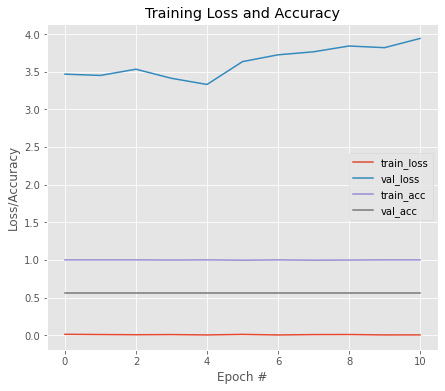


Model Performance Summary:

Best Validation accuracy:0.5663716793060303 at EPOCH:1
Starting fold 3
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.61880, saving model to MobileNetV2_a_3.hdf5
15/15 [==============================] - 12s 294ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 3.6188 - val_accuracy: 0.6106
Epoch 2/50
14/15 [===========================>..] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 3.61880
15/15 [==============================] - 3s 213ms/step - loss: 0.0139 - accuracy: 0.9978 - val_loss: 3.6304 - val_accuracy: 0.6106
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0055 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.61880
15/15 [==============================] - 3s 210ms/step - loss: 0.0055 - accuracy: 1.0000 - val_loss: 3.6722 - val_accuracy: 0.6106
Epoch 4/50
15/15 [===========================

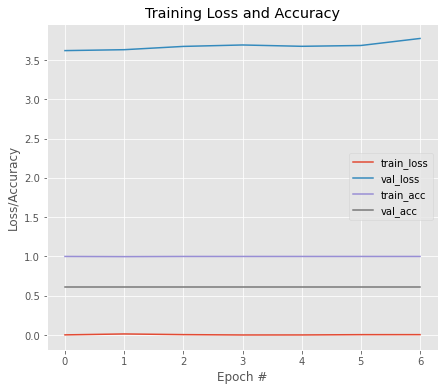


Model Performance Summary:

Best Validation accuracy:0.6106194853782654 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0062 - accuracy: 0.9978
Epoch 1: val_loss improved from inf to 4.26881, saving model to MobileNetV2_b_3.hdf5
15/15 [==============================] - 12s 331ms/step - loss: 0.0062 - accuracy: 0.9978 - val_loss: 4.2688 - val_accuracy: 0.6106
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 2: val_loss improved from 4.26881 to 4.22644, saving model to MobileNetV2_b_3.hdf5
15/15 [==============================] - 4s 243ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 4.2264 - val_accuracy: 0.6106
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.22644
15/15 [==============================] - 3s 216ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 4.2644 - val_accuracy: 0.6106
Epoch 4/50
15/15 [=

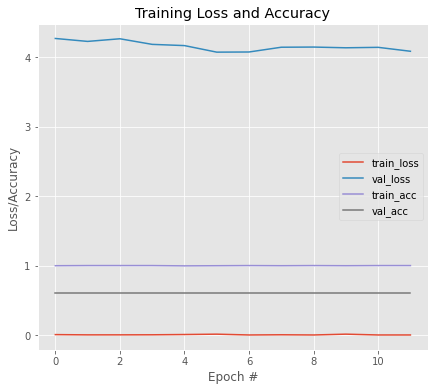


Model Performance Summary:

Best Validation accuracy:0.6106194853782654 at EPOCH:1
Starting fold 4
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 5.15707, saving model to MobileNetV2_a_4.hdf5
15/15 [==============================] - 13s 357ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 5.1571 - val_accuracy: 0.5268
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0255 - accuracy: 0.9956
Epoch 2: val_loss improved from 5.15707 to 4.92773, saving model to MobileNetV2_a_4.hdf5
15/15 [==============================] - 4s 238ms/step - loss: 0.0255 - accuracy: 0.9956 - val_loss: 4.9277 - val_accuracy: 0.5268
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.92773
15/15 [==============================] - 3s 214ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 4.9768 - val_accuracy: 0.5268
Epo

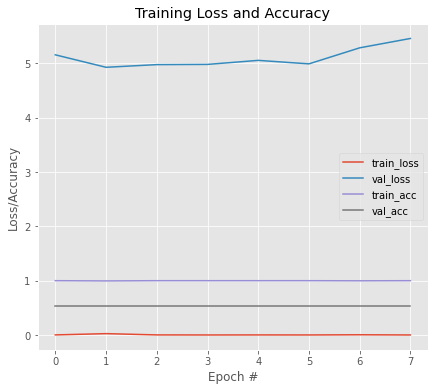


Model Performance Summary:

Best Validation accuracy:0.5267857313156128 at EPOCH:1
Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 8.6974e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 5.20348, saving model to MobileNetV2_b_4.hdf5
15/15 [==============================] - 13s 299ms/step - loss: 8.6974e-04 - accuracy: 1.0000 - val_loss: 5.2035 - val_accuracy: 0.5268
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 0.0270 - accuracy: 0.9956
Epoch 2: val_loss did not improve from 5.20348
15/15 [==============================] - 3s 217ms/step - loss: 0.0270 - accuracy: 0.9956 - val_loss: 5.2673 - val_accuracy: 0.5268
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 5.20348
15/15 [==============================] - 3s 211ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 5.2939 - val_accuracy: 0.5268
Epoch 4/50
14/15 [===========================>..] - E

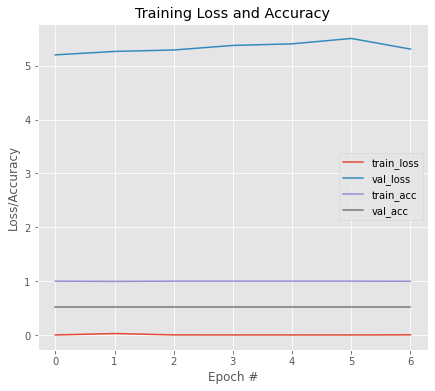


Model Performance Summary:

Best Validation accuracy:0.5267857313156128 at EPOCH:1
Average Accuracy:0.5566845774650574
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
17/18 [===========================>..] - ETA: 0s - loss: 4.8565 - accuracy: 0.5508
Epoch 1: val_loss improved from inf to 4.29694, saving model to MobileNetV2_wt.hdf5
18/18 [==============================] - 5s 153ms/step - loss: 4.8111 - accuracy: 0.5550 - val_loss: 4.2969 - val_accuracy: 0.5887
Epoch 2/50
17/18 [===========================>..] - ETA: 0s - loss: 4.7640 - accuracy: 0.5526
Epoch 2: val_loss improved from 4.29694 to 4.21715, saving model to MobileNetV2_wt.hdf5
18/18 [==============================] - 1s 75ms/step - loss: 4.7150 - accuracy: 0.5550 - val_loss: 4.2171 - val_accuracy: 0.5887
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 4.6317 - accuracy: 0.5550
Epoch 3: val_loss improved from 4.21715 to 4.14120, saving model to MobileNetV2_wt.hdf5
1

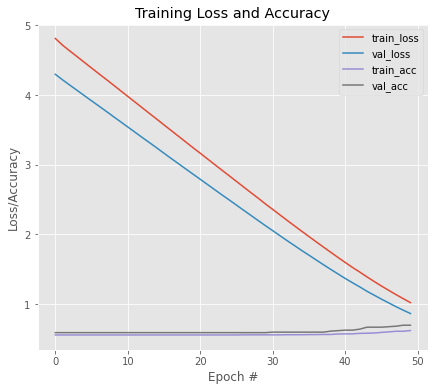


Model Performance Summary:

Best Validation accuracy:0.695035457611084 at EPOCH:49
 Training Model with pretraned layer trainable
Epoch 1/50
18/18 [==============================] - ETA: 0s - loss: 0.2007 - accuracy: 0.9078
Epoch 1: val_loss improved from inf to 1.22354, saving model to MobileNetV2_wt.hdf5
18/18 [==============================] - 13s 314ms/step - loss: 0.2007 - accuracy: 0.9078 - val_loss: 1.2235 - val_accuracy: 0.6596
Epoch 2/50
18/18 [==============================] - ETA: 0s - loss: 0.0297 - accuracy: 0.9947
Epoch 2: val_loss did not improve from 1.22354
18/18 [==============================] - 4s 219ms/step - loss: 0.0297 - accuracy: 0.9947 - val_loss: 1.3206 - val_accuracy: 0.6383
Epoch 3/50
18/18 [==============================] - ETA: 0s - loss: 0.0450 - accuracy: 0.9823
Epoch 3: val_loss improved from 1.22354 to 1.13983, saving model to MobileNetV2_wt.hdf5
18/18 [==============================] - 4s 239ms/step - loss: 0.0450 - accuracy: 0.9823 - val_loss: 1.13

In [ ]:
for model in MODEL_LIST_3:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx2,trainy2,testx2,testy2,data_aug=False,dataset = 'ACRIMA')
  gc.collect()

,Model,Accuracy,Sensitivity,AUC
0,xception_A_True_RIM-ONE_dl,0.897260,0.946809,0.877250
1,InceptionResNetV2_A_True_RIM-ONE_dl,0.883562,0.925532,0.866612
2,InceptionV3_A_True_RIM-ONE_dl,0.917808,0.914894,0.918985
3,vgg16_A_True_RIM-ONE_dl,0.917808,0.936170,0.910393
4,vgg19_A_True_RIM-ONE_dl,0.910959,0.957447,0.892185
5,resnet50_A_True_RIM-ONE_dl,0.643836,1.000000,0.500000
6,DenseNet121_A_True_RIM-ONE_dl,0.958904,0.957447,0.959493
7,MobileNet_A_True_RIM-ONE_dl,0.904110,0.925532,0.895458
8,MobileNetV2_A_True_RIM-ONE_dl,0.767123,0.829787,0.741817
9,InceptionV3_A_False_RIM-ONE_dl,0.849315,0.872340,0.840016


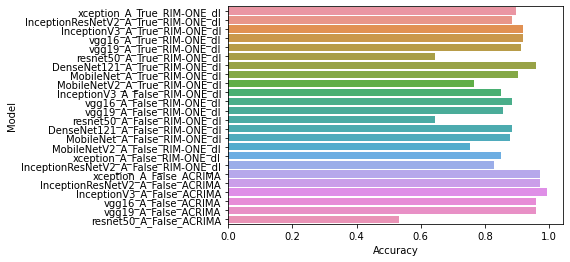

\begin{tabular}{lrrr}
\toprule
                               Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
          xception\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.946809 & 0.877250 \\
 InceptionResNetV2\_A\_True\_RIM-ONE\_dl &  0.883562 &     0.925532 & 0.866612 \\
       InceptionV3\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.914894 & 0.918985 \\
             vgg16\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.936170 & 0.910393 \\
             vgg19\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.957447 & 0.892185 \\
          resnet50\_A\_True\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
       DenseNet121\_A\_True\_RIM-ONE\_dl &  0.958904 &     0.957447 & 0.959493 \\
         MobileNet\_A\_True\_RIM-ONE\_dl &  0.904110 &     0.925532 & 0.895458 \\
       MobileNetV2\_A\_True\_RIM-ONE\_dl &  0.767123 &     0.829787 & 0.741817 \\
      InceptionV3\_A\_False\_RIM-ONE\_dl &  0.849315 &     0.872340 & 0.840016 \\
            vgg16\_A\_False\_RIM-ONE\_dl &  0.883562 &     0.9

In [ ]:
plot_overall_performance()

RIMONE V2

Without Data Augmentation

In [ ]:
(tranx3,trainy3),(testx3,testy3) = get_rim_one_db_r2(299,299,test_train_ratio = 0.2)

Height:299 Width:299 test_train_ratio:0.2


Starting fold 0
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6980 - accuracy: 0.5258
Epoch 1: val_loss improved from inf to 0.69276, saving model to InceptionV3_a_0.hdf5
10/10 [==============================] - 11s 589ms/step - loss: 0.6980 - accuracy: 0.5258 - val_loss: 0.6928 - val_accuracy: 0.5479
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.6949 - accuracy: 0.5120
Epoch 2: val_loss did not improve from 0.69276
10/10 [==============================] - 2s 149ms/step - loss: 0.6949 - accuracy: 0.5120 - val_loss: 0.6955 - val_accuracy: 0.5342
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.6904 - accuracy: 0.5292
Epoch 3: val_loss did not improve from 0.69276
10/10 [==============================] - 1s 147ms/step - loss: 0.6904 - accuracy: 0.5292 - val_loss: 0.6950 - val_accuracy: 0.5479
Epoch 4/50
10/10 [==============================] - ETA: 0s - loss: 0.6884 - accuracy: 0.5258
Epoch 4: val_loss did not improve f

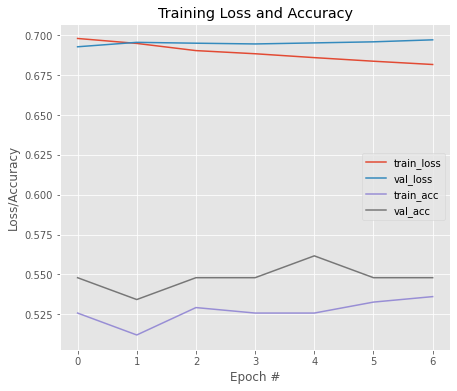


Model Performance Summary:

Best Validation accuracy:0.5616438388824463 at EPOCH:5
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.5856 - accuracy: 0.6735
Epoch 1: val_loss improved from inf to 0.66580, saving model to InceptionV3_b_0.hdf5
10/10 [==============================] - 22s 830ms/step - loss: 0.5856 - accuracy: 0.6735 - val_loss: 0.6658 - val_accuracy: 0.6164
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.3816 - accuracy: 0.8763
Epoch 2: val_loss improved from 0.66580 to 0.62448, saving model to InceptionV3_b_0.hdf5
10/10 [==============================] - 5s 521ms/step - loss: 0.3816 - accuracy: 0.8763 - val_loss: 0.6245 - val_accuracy: 0.6986
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.2776 - accuracy: 0.9519
Epoch 3: val_loss improved from 0.62448 to 0.59537, saving model to InceptionV3_b_0.hdf5
10/10 [==============================] - 5s 523ms/step - loss: 0.2776 - accuracy: 0.9519 - val_loss: 0.5954 

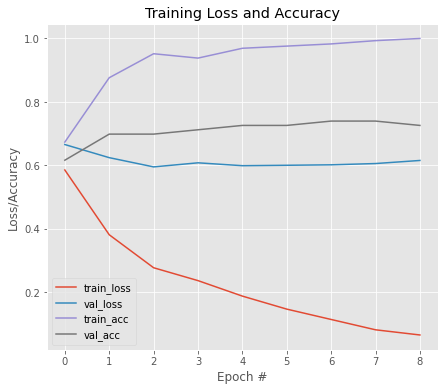


Model Performance Summary:

Best Validation accuracy:0.7397260069847107 at EPOCH:7
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1710 - accuracy: 0.9381
Epoch 1: val_loss improved from inf to 0.47030, saving model to InceptionV3_a_1.hdf5
10/10 [==============================] - 17s 699ms/step - loss: 0.1710 - accuracy: 0.9381 - val_loss: 0.4703 - val_accuracy: 0.7945
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0870 - accuracy: 0.9794
Epoch 2: val_loss improved from 0.47030 to 0.44149, saving model to InceptionV3_a_1.hdf5
10/10 [==============================] - 5s 522ms/step - loss: 0.0870 - accuracy: 0.9794 - val_loss: 0.4415 - val_accuracy: 0.7808
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0612 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.44149
10/10 [==============================] - 4s 433ms/step - loss: 0.0612 - accuracy: 0.9966 - val_loss: 0.4422 - val_accuracy: 0.8082
Epo

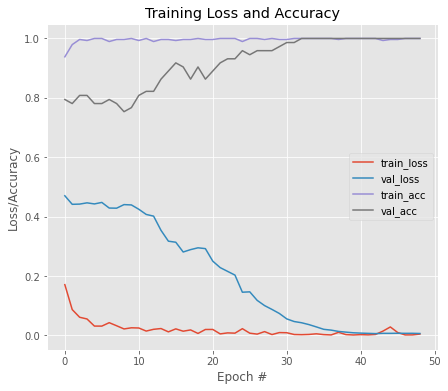


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:33
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00665, saving model to InceptionV3_b_1.hdf5
10/10 [==============================] - 17s 663ms/step - loss: 0.0049 - accuracy: 1.0000 - val_loss: 0.0067 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00665 to 0.00590, saving model to InceptionV3_b_1.hdf5
10/10 [==============================] - 5s 531ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.0059 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00590
10/10 [==============================] - 4s 442ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.0059 - val_accuracy: 1.0000
Epoch 4/50
10/10 [===============

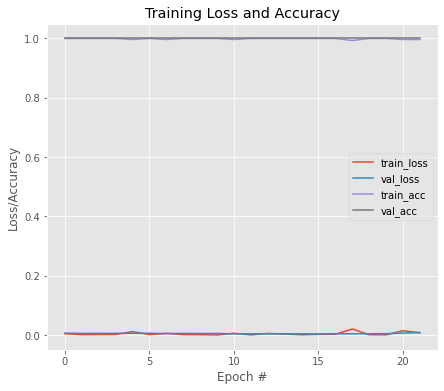


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0162 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.04490, saving model to InceptionV3_a_2.hdf5
10/10 [==============================] - 17s 665ms/step - loss: 0.0162 - accuracy: 0.9966 - val_loss: 0.0449 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0134 - accuracy: 0.9897
Epoch 2: val_loss improved from 0.04490 to 0.00471, saving model to InceptionV3_a_2.hdf5
10/10 [==============================] - 5s 531ms/step - loss: 0.0134 - accuracy: 0.9897 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00471 to 0.00331, saving model to InceptionV3_a_2.hdf5
10/10 [==============================] - 5s 529ms/step - loss: 0.0030 - accuracy: 1.0000 - val_loss: 0.0033

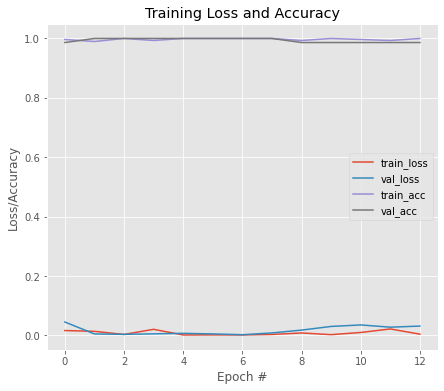


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.01341, saving model to InceptionV3_b_2.hdf5
10/10 [==============================] - 17s 668ms/step - loss: 0.0064 - accuracy: 0.9966 - val_loss: 0.0134 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 4.5287e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.01341
10/10 [==============================] - 4s 437ms/step - loss: 4.5287e-04 - accuracy: 1.0000 - val_loss: 0.0201 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.01341
10/10 [==============================] - 4s 439ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.0145 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================] - ETA: 0s - loss: 

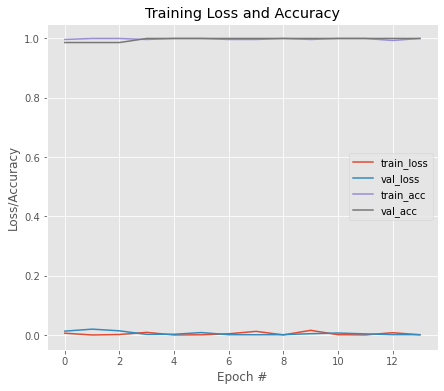


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:4
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.00011, saving model to InceptionV3_a_3.hdf5
10/10 [==============================] - 17s 666ms/step - loss: 0.0041 - accuracy: 0.9966 - val_loss: 1.0987e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00011 to 0.00009, saving model to InceptionV3_a_3.hdf5
10/10 [==============================] - 5s 526ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 9.4068e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 3.1437e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00009 to 0.00009, saving model to InceptionV3_a_3.hdf5
10/10 [==============================] - 5s 530ms/step - loss: 3.1437e-04 - accuracy: 1.0000 - 

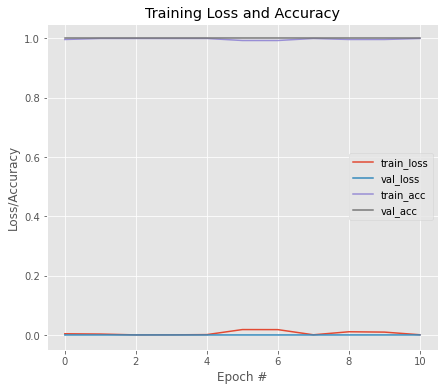


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 7.1970e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00007, saving model to InceptionV3_b_3.hdf5
10/10 [==============================] - 17s 657ms/step - loss: 7.1970e-04 - accuracy: 1.0000 - val_loss: 6.5195e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 1.7815e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00007 to 0.00005, saving model to InceptionV3_b_3.hdf5
10/10 [==============================] - 5s 528ms/step - loss: 1.7815e-04 - accuracy: 1.0000 - val_loss: 4.8736e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00005 to 0.00002, saving model to InceptionV3_b_3.hdf5
10/10 [==============================] - 5s 529ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss

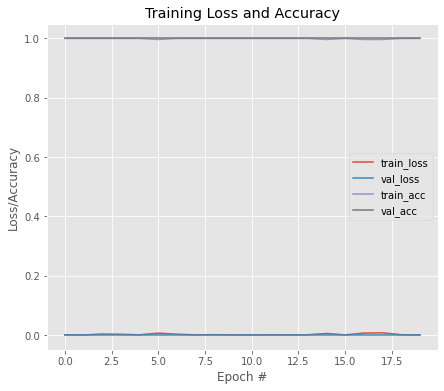


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 8.0038e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00002, saving model to InceptionV3_a_4.hdf5
10/10 [==============================] - 20s 1s/step - loss: 8.0038e-04 - accuracy: 1.0000 - val_loss: 1.5394e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 1.9672e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00002 to 0.00001, saving model to InceptionV3_a_4.hdf5
10/10 [==============================] - 5s 531ms/step - loss: 1.9672e-04 - accuracy: 1.0000 - val_loss: 1.3432e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0078 - accuracy: 0.9966
Epoch 3: val_loss improved from 0.00001 to 0.00001, saving model to InceptionV3_a_4.hdf5
10/10 [==============================] - 5s 530ms/step - loss: 0.0078 - accuracy: 0.99

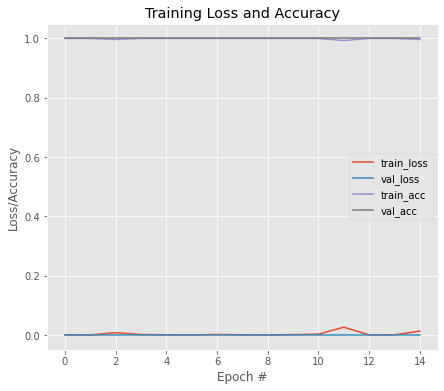


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0167 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.00003, saving model to InceptionV3_b_4.hdf5
10/10 [==============================] - 17s 664ms/step - loss: 0.0167 - accuracy: 0.9966 - val_loss: 2.8441e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0090 - accuracy: 0.9966    
Epoch 2: val_loss improved from 0.00003 to 0.00002, saving model to InceptionV3_b_4.hdf5
10/10 [==============================] - 5s 526ms/step - loss: 0.0090 - accuracy: 0.9966 - val_loss: 2.1179e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.00002
10/10 [==============================] - 4s 437ms/step - loss: 0.0050 - accuracy: 0.9966 - val_loss: 2.5549e-05 - val_accuracy: 1.0000
Epoch 4/50
10/10 [

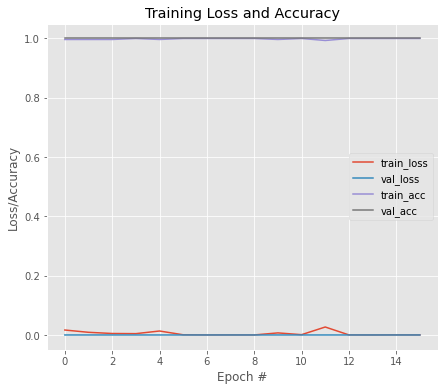


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9479452013969422
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 9.4182e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.30167, saving model to InceptionV3_wt.hdf5
12/12 [==============================] - 10s 480ms/step - loss: 9.4182e-04 - accuracy: 1.0000 - val_loss: 0.3017 - val_accuracy: 0.9121
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 9.1500e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.30167
12/12 [==============================] - 2s 153ms/step - loss: 9.1500e-04 - accuracy: 1.0000 - val_loss: 0.3020 - val_accuracy: 0.9121
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 8.9630e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.30167
12/12 [==============================] - 2s 153ms/step - loss: 8.9630e-04 - 

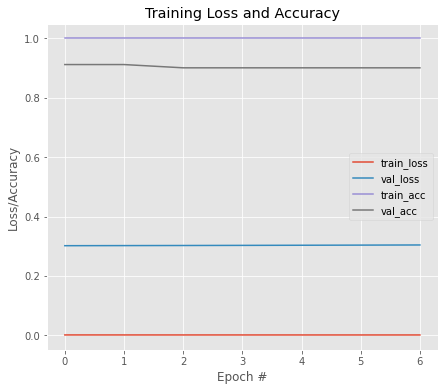


Model Performance Summary:

Best Validation accuracy:0.9120879173278809 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0136 - accuracy: 0.9973
Epoch 1: val_loss improved from inf to 0.45271, saving model to InceptionV3_wt.hdf5
12/12 [==============================] - 20s 829ms/step - loss: 0.0136 - accuracy: 0.9973 - val_loss: 0.4527 - val_accuracy: 0.8462
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.45271
12/12 [==============================] - 5s 452ms/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.4865 - val_accuracy: 0.8462
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.45271
12/12 [==============================] - 5s 453ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.5360 - val_accuracy: 0.8462
Epoch 4/50
12/1

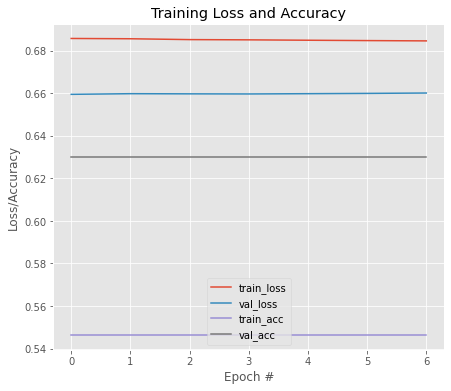


Model Performance Summary:

Best Validation accuracy:0.6301369667053223 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6815 - accuracy: 0.5945
Epoch 1: val_loss improved from inf to 0.63464, saving model to vgg16_b_0.hdf5
10/10 [==============================] - 12s 635ms/step - loss: 0.6815 - accuracy: 0.5945 - val_loss: 0.6346 - val_accuracy: 0.6712
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.6305 - accuracy: 0.6598
Epoch 2: val_loss improved from 0.63464 to 0.60631, saving model to vgg16_b_0.hdf5
10/10 [==============================] - 5s 482ms/step - loss: 0.6305 - accuracy: 0.6598 - val_loss: 0.6063 - val_accuracy: 0.7260
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.5727 - accuracy: 0.7216
Epoch 3: val_loss did not improve from 0.60631
10/10 [==============================] - 4s 446ms/step - loss: 0.5727 - accuracy: 0.7216 - val_loss: 0.6837 - val_accuracy: 0.6027
Epoch 4/50
10/10 [=============

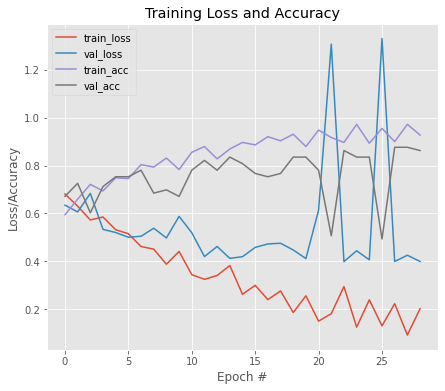


Model Performance Summary:

Best Validation accuracy:0.8767123222351074 at EPOCH:27
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.2551 - accuracy: 0.9038
Epoch 1: val_loss improved from inf to 0.08530, saving model to vgg16_a_1.hdf5
10/10 [==============================] - 6s 514ms/step - loss: 0.2551 - accuracy: 0.9038 - val_loss: 0.0853 - val_accuracy: 0.9726
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.2187 - accuracy: 0.9072
Epoch 2: val_loss did not improve from 0.08530
10/10 [==============================] - 5s 456ms/step - loss: 0.2187 - accuracy: 0.9072 - val_loss: 0.1203 - val_accuracy: 0.9726
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.1663 - accuracy: 0.9588
Epoch 3: val_loss did not improve from 0.08530
10/10 [==============================] - 5s 454ms/step - loss: 0.1663 - accuracy: 0.9588 - val_loss: 0.1201 - val_accuracy: 0.9726
Epoch 4/50
10/10 [==============================] -

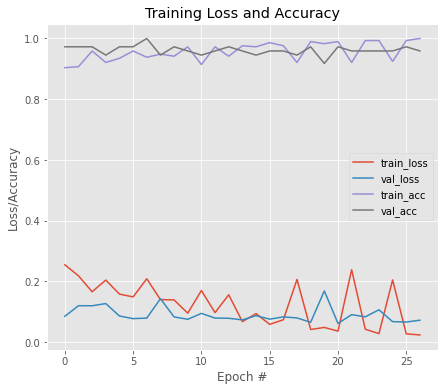


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:7
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.3472 - accuracy: 0.9347
Epoch 1: val_loss improved from inf to 0.08022, saving model to vgg16_b_1.hdf5
10/10 [==============================] - 6s 514ms/step - loss: 0.3472 - accuracy: 0.9347 - val_loss: 0.0802 - val_accuracy: 0.9726
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0451 - accuracy: 0.9863
Epoch 2: val_loss did not improve from 0.08022
10/10 [==============================] - 5s 459ms/step - loss: 0.0451 - accuracy: 0.9863 - val_loss: 0.1988 - val_accuracy: 0.9041
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0452 - accuracy: 0.9931
Epoch 3: val_loss improved from 0.08022 to 0.07082, saving model to vgg16_b_1.hdf5
10/10 [==============================] - 5s 491ms/step - loss: 0.0452 - accuracy: 0.9931 - val_loss: 0.0708 - val_accuracy: 0.9589
Epoch 4/50
10/10 [=============================

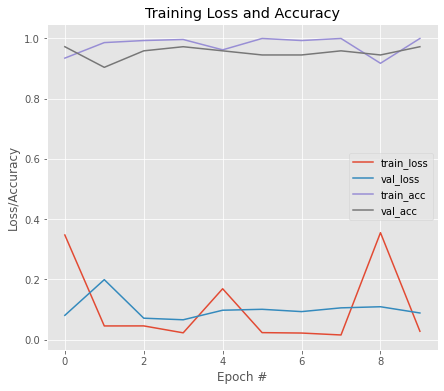


Model Performance Summary:

Best Validation accuracy:0.9726027250289917 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.4842 - accuracy: 0.9244
Epoch 1: val_loss improved from inf to 0.01635, saving model to vgg16_a_2.hdf5
10/10 [==============================] - 6s 512ms/step - loss: 0.4842 - accuracy: 0.9244 - val_loss: 0.0163 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0338 - accuracy: 0.9931
Epoch 2: val_loss improved from 0.01635 to 0.01353, saving model to vgg16_a_2.hdf5
10/10 [==============================] - 5s 487ms/step - loss: 0.0338 - accuracy: 0.9931 - val_loss: 0.0135 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0296 - accuracy: 0.9966
Epoch 3: val_loss improved from 0.01353 to 0.00929, saving model to vgg16_a_2.hdf5
10/10 [==============================] - 5s 499ms/step - loss: 0.0296 - accuracy: 0.9966 - val_loss: 0.0093 - v

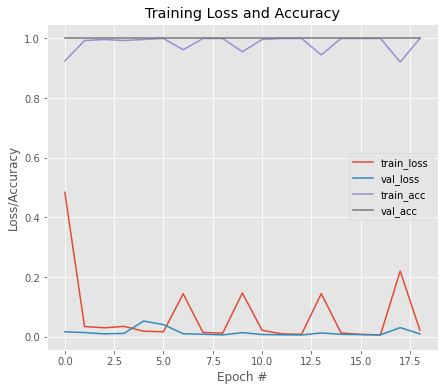


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6252 - accuracy: 0.9519
Epoch 1: val_loss improved from inf to 0.01294, saving model to vgg16_b_2.hdf5
10/10 [==============================] - 7s 515ms/step - loss: 0.6252 - accuracy: 0.9519 - val_loss: 0.0129 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0115 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.01294 to 0.00814, saving model to vgg16_b_2.hdf5
10/10 [==============================] - 5s 493ms/step - loss: 0.0115 - accuracy: 1.0000 - val_loss: 0.0081 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0082 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00814
10/10 [==============================] - 5s 460ms/step - loss: 0.0082 - accuracy: 1.0000 - val_loss: 0.0082 - val_accuracy: 1.0000
Epoch 4/50
10/10 [=============================

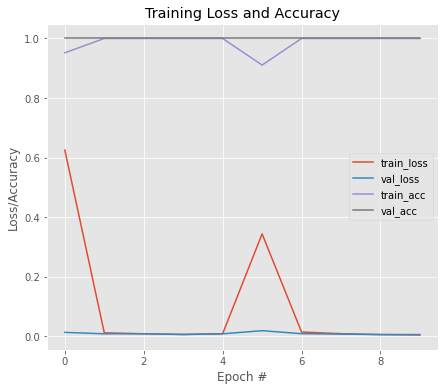


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.4761 - accuracy: 0.9244
Epoch 1: val_loss improved from inf to 0.00350, saving model to vgg16_a_3.hdf5
10/10 [==============================] - 6s 515ms/step - loss: 0.4761 - accuracy: 0.9244 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0072 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00350 to 0.00293, saving model to vgg16_a_3.hdf5
10/10 [==============================] - 5s 489ms/step - loss: 0.0072 - accuracy: 1.0000 - val_loss: 0.0029 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0054 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00293 to 0.00237, saving model to vgg16_a_3.hdf5
10/10 [==============================] - 5s 504ms/step - loss: 0.0054 - accuracy: 1.0000 - val_loss: 0.0024 - val_accuracy: 1.

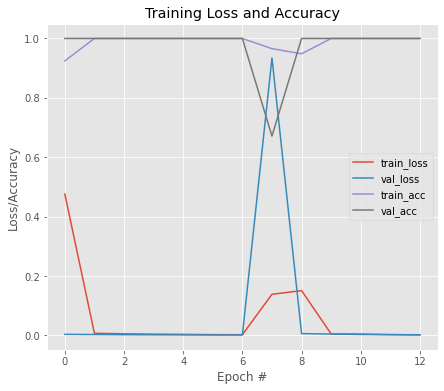


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.5368 - accuracy: 0.9072
Epoch 1: val_loss improved from inf to 0.00672, saving model to vgg16_b_3.hdf5
10/10 [==============================] - 7s 513ms/step - loss: 0.5368 - accuracy: 0.9072 - val_loss: 0.0067 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00672 to 0.00421, saving model to vgg16_b_3.hdf5
10/10 [==============================] - 5s 489ms/step - loss: 0.0048 - accuracy: 1.0000 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00421 to 0.00329, saving model to vgg16_b_3.hdf5
10/10 [==============================] - 5s 485ms/step - loss: 0.0039 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 4/50


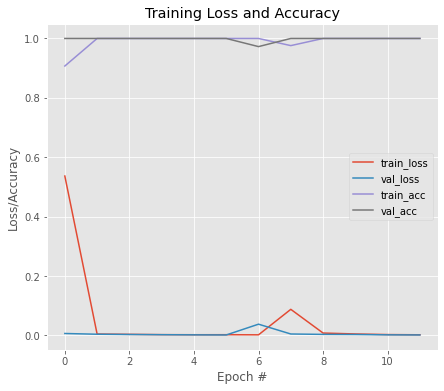


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.5945 - accuracy: 0.9144
Epoch 1: val_loss improved from inf to 0.00625, saving model to vgg16_a_4.hdf5
10/10 [==============================] - 10s 868ms/step - loss: 0.5945 - accuracy: 0.9144 - val_loss: 0.0063 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00625 to 0.00447, saving model to vgg16_a_4.hdf5
10/10 [==============================] - 5s 491ms/step - loss: 0.0031 - accuracy: 1.0000 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00447 to 0.00328, saving model to vgg16_a_4.hdf5
10/10 [==============================] - 5s 489ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 1

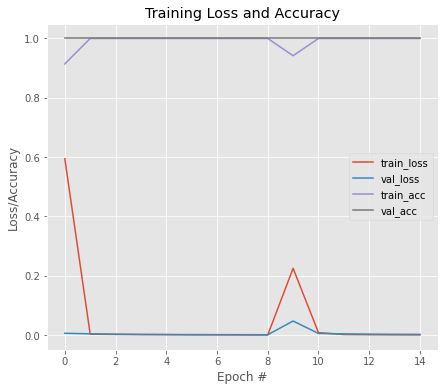


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.7884 - accuracy: 0.9349
Epoch 1: val_loss improved from inf to 0.00981, saving model to vgg16_b_4.hdf5
10/10 [==============================] - 7s 517ms/step - loss: 0.7884 - accuracy: 0.9349 - val_loss: 0.0098 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00981 to 0.00586, saving model to vgg16_b_4.hdf5
10/10 [==============================] - 5s 490ms/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 0.0059 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00586 to 0.00430, saving model to vgg16_b_4.hdf5
10/10 [==============================] - 6s 565ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 0.0043 - val_accuracy: 1.0000
Epoch 4/50


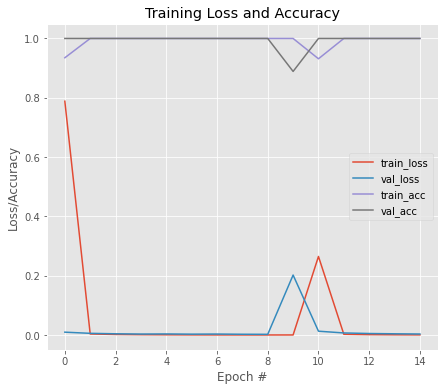


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9698630094528198
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.35137, saving model to vgg16_wt.hdf5
12/12 [==============================] - 7s 588ms/step - loss: 0.0049 - accuracy: 1.0000 - val_loss: 0.3514 - val_accuracy: 0.9231
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.35137
12/12 [==============================] - 2s 203ms/step - loss: 0.0049 - accuracy: 1.0000 - val_loss: 0.3520 - val_accuracy: 0.9231
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.35137
12/12 [==============================] - 2s 204ms/step - loss: 0.0049 - accuracy: 1.0000 - val_loss: 0.

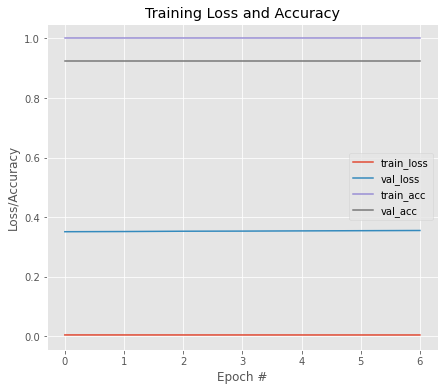


Model Performance Summary:

Best Validation accuracy:0.9230769276618958 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.8362 - accuracy: 0.6016
Epoch 1: val_loss improved from inf to 0.68910, saving model to vgg16_wt.hdf5
12/12 [==============================] - 10s 708ms/step - loss: 0.8362 - accuracy: 0.6016 - val_loss: 0.6891 - val_accuracy: 0.5495
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.6525 - accuracy: 0.5824
Epoch 2: val_loss improved from 0.68910 to 0.62024, saving model to vgg16_wt.hdf5
12/12 [==============================] - 6s 498ms/step - loss: 0.6525 - accuracy: 0.5824 - val_loss: 0.6202 - val_accuracy: 0.7363
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.5858 - accuracy: 0.6813
Epoch 3: val_loss improved from 0.62024 to 0.52177, saving model to vgg16_wt.hdf5
12/12 [==============================] - 6s 523ms/step - loss: 0.5858 - accuracy: 

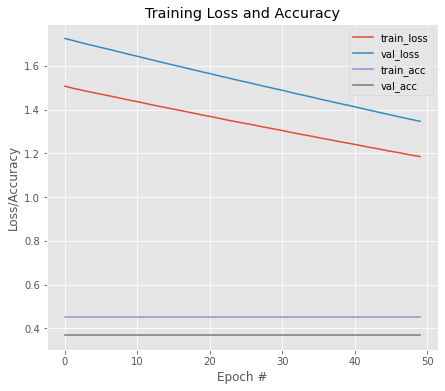


Model Performance Summary:

Best Validation accuracy:0.36986300349235535 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.8320 - accuracy: 0.5052
Epoch 1: val_loss improved from inf to 0.59777, saving model to vgg19_b_0.hdf5
10/10 [==============================] - 8s 605ms/step - loss: 0.8320 - accuracy: 0.5052 - val_loss: 0.5978 - val_accuracy: 0.6712
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.6237 - accuracy: 0.6701
Epoch 2: val_loss did not improve from 0.59777
10/10 [==============================] - 5s 537ms/step - loss: 0.6237 - accuracy: 0.6701 - val_loss: 0.6380 - val_accuracy: 0.6164
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.5979 - accuracy: 0.6873
Epoch 3: val_loss improved from 0.59777 to 0.56880, saving model to vgg19_b_0.hdf5
10/10 [==============================] - 6s 579ms/step - loss: 0.5979 - accuracy: 0.6873 - val_loss: 0.5688 - val_accuracy: 0.7260
Epoch 4/50
10/10 [=============

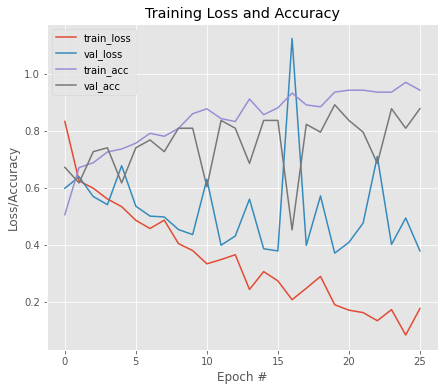


Model Performance Summary:

Best Validation accuracy:0.8904109597206116 at EPOCH:20
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6041 - accuracy: 0.8660
Epoch 1: val_loss improved from inf to 0.11594, saving model to vgg19_a_1.hdf5
10/10 [==============================] - 8s 611ms/step - loss: 0.6041 - accuracy: 0.8660 - val_loss: 0.1159 - val_accuracy: 0.9589
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.1835 - accuracy: 0.9210
Epoch 2: val_loss improved from 0.11594 to 0.07139, saving model to vgg19_a_1.hdf5
10/10 [==============================] - 6s 636ms/step - loss: 0.1835 - accuracy: 0.9210 - val_loss: 0.0714 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.1676 - accuracy: 0.9347
Epoch 3: val_loss improved from 0.07139 to 0.06592, saving model to vgg19_a_1.hdf5
10/10 [==============================] - 6s 638ms/step - loss: 0.1676 - accuracy: 0.9347 - val_loss: 0.0659 - 

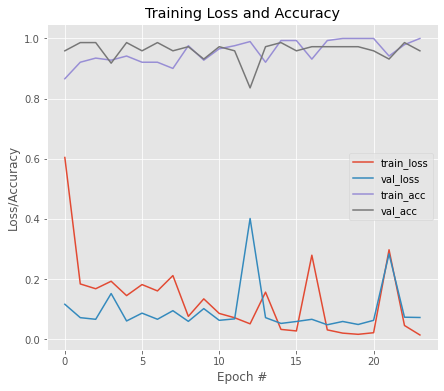


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.5260 - accuracy: 0.9210
Epoch 1: val_loss improved from inf to 0.07650, saving model to vgg19_b_1.hdf5
10/10 [==============================] - 8s 618ms/step - loss: 0.5260 - accuracy: 0.9210 - val_loss: 0.0765 - val_accuracy: 0.9452
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0255 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.07650 to 0.05514, saving model to vgg19_b_1.hdf5
10/10 [==============================] - 6s 594ms/step - loss: 0.0255 - accuracy: 1.0000 - val_loss: 0.0551 - val_accuracy: 0.9589
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0310 - accuracy: 0.9931
Epoch 3: val_loss did not improve from 0.05514
10/10 [==============================] - 6s 550ms/step - loss: 0.0310 - accuracy: 0.9931 - val_loss: 0.0587 - val_accuracy: 0.9589
Epoch 4/50
10/10 [==============

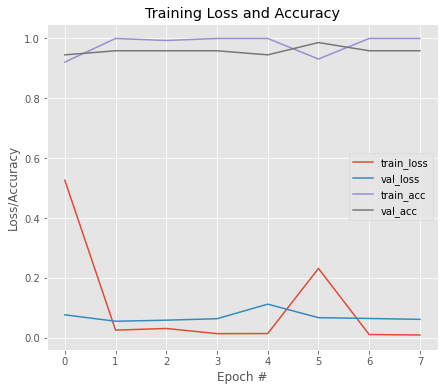


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:6
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.4654 - accuracy: 0.9210
Epoch 1: val_loss improved from inf to 0.01307, saving model to vgg19_a_2.hdf5
10/10 [==============================] - 8s 669ms/step - loss: 0.4654 - accuracy: 0.9210 - val_loss: 0.0131 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0253 - accuracy: 0.9966
Epoch 2: val_loss did not improve from 0.01307
10/10 [==============================] - 6s 550ms/step - loss: 0.0253 - accuracy: 0.9966 - val_loss: 0.0165 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0188 - accuracy: 0.9931
Epoch 3: val_loss improved from 0.01307 to 0.01299, saving model to vgg19_a_2.hdf5
10/10 [==============================] - 6s 587ms/step - loss: 0.0188 - accuracy: 0.9931 - val_loss: 0.0130 - val_accuracy: 1.0000
Epoch 4/50
10/10

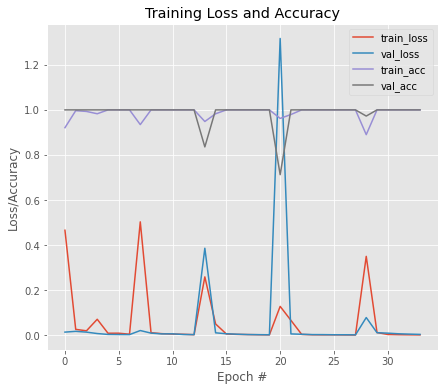


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.7760 - accuracy: 0.9347
Epoch 1: val_loss improved from inf to 0.01089, saving model to vgg19_b_2.hdf5
10/10 [==============================] - 8s 612ms/step - loss: 0.7760 - accuracy: 0.9347 - val_loss: 0.0109 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.01089 to 0.00791, saving model to vgg19_b_2.hdf5
10/10 [==============================] - 6s 589ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.0079 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 8.8563e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00791 to 0.00592, saving model to vgg19_b_2.hdf5
10/10 [==============================] - 6s 590ms/step - loss: 8.8563e-04 - accuracy: 1.0000 - val_loss: 0.0059 - val_accuracy: 1.0000
Epo

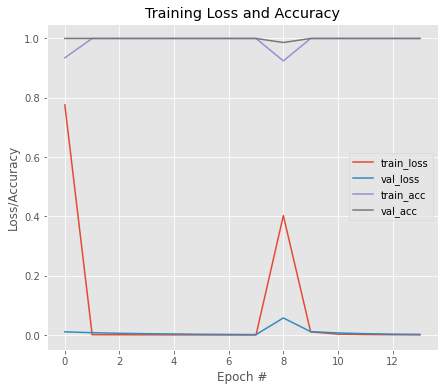


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 1.4389 - accuracy: 0.9313
Epoch 1: val_loss improved from inf to 0.00162, saving model to vgg19_a_3.hdf5
10/10 [==============================] - 8s 611ms/step - loss: 1.4389 - accuracy: 0.9313 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00162 to 0.00109, saving model to vgg19_a_3.hdf5
10/10 [==============================] - 6s 586ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00109 to 0.00082, saving model to vgg19_a_3.hdf5
10/10 [==============================] - 6s 592ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 8.2274e-04 - val_accuracy

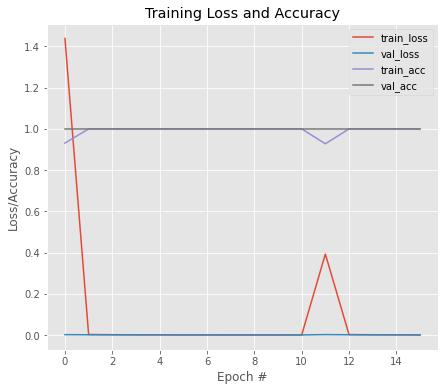


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.5581 - accuracy: 0.9416
Epoch 1: val_loss improved from inf to 0.00197, saving model to vgg19_b_3.hdf5
10/10 [==============================] - 8s 607ms/step - loss: 0.5581 - accuracy: 0.9416 - val_loss: 0.0020 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00197 to 0.00136, saving model to vgg19_b_3.hdf5
10/10 [==============================] - 6s 581ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00136 to 0.00111, saving model to vgg19_b_3.hdf5
10/10 [==============================] - 6s 579ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 4/50


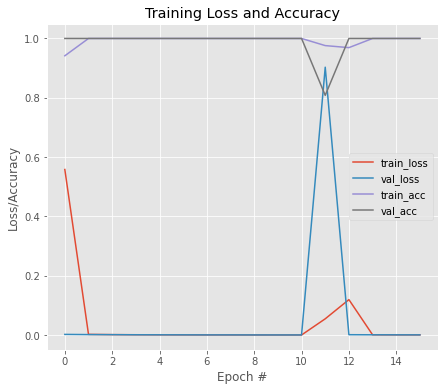


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.3066 - accuracy: 0.9349
Epoch 1: val_loss improved from inf to 0.00188, saving model to vgg19_a_4.hdf5
10/10 [==============================] - 8s 618ms/step - loss: 0.3066 - accuracy: 0.9349 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 5.9920e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00188 to 0.00138, saving model to vgg19_a_4.hdf5
10/10 [==============================] - 6s 586ms/step - loss: 5.9920e-04 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 3.8912e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00138 to 0.00106, saving model to vgg19_a_4.hdf5
10/10 [==============================] - 6s 589ms/step - loss: 3.8912e-04 - accuracy: 1.0000 - val_loss: 0.0011 - 

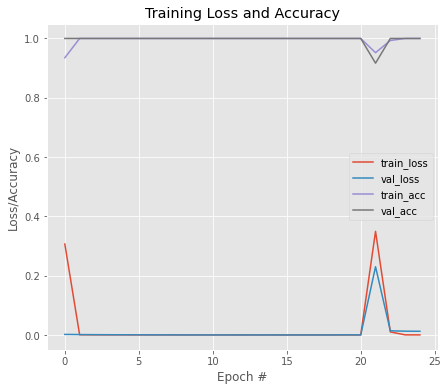


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.4236 - accuracy: 0.9521
Epoch 1: val_loss improved from inf to 0.02671, saving model to vgg19_b_4.hdf5
10/10 [==============================] - 8s 610ms/step - loss: 0.4236 - accuracy: 0.9521 - val_loss: 0.0267 - val_accuracy: 0.9861
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.02671 to 0.00079, saving model to vgg19_b_4.hdf5
10/10 [==============================] - 6s 582ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 7.8725e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 4.6008e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00079 to 0.00058, saving model to vgg19_b_4.hdf5
10/10 [==============================] - 6s 584ms/step - loss: 4.6008e-04 - accuracy: 1.0000 - val_loss: 5.8141e-04 - val_accuracy: 1.

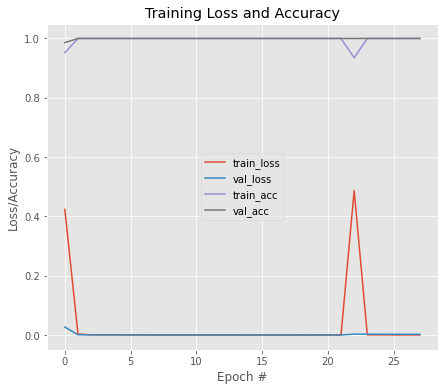


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Average Accuracy:0.9753424644470214
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 5.0679e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.53227, saving model to vgg19_wt.hdf5
12/12 [==============================] - 4s 278ms/step - loss: 5.0679e-04 - accuracy: 1.0000 - val_loss: 0.5323 - val_accuracy: 0.9011
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 5.0259e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.53227
12/12 [==============================] - 3s 240ms/step - loss: 5.0259e-04 - accuracy: 1.0000 - val_loss: 0.5335 - val_accuracy: 0.9011
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 5.0176e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.53227
12/12 [==============================] - 3s 240ms/step - loss: 5.0176e-04 - accurac

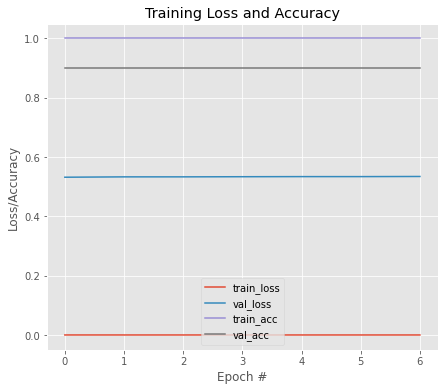


Model Performance Summary:

Best Validation accuracy:0.901098906993866 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 1.3632 - accuracy: 0.8654
Epoch 1: val_loss improved from inf to 0.35059, saving model to vgg19_wt.hdf5
12/12 [==============================] - 9s 623ms/step - loss: 1.3632 - accuracy: 0.8654 - val_loss: 0.3506 - val_accuracy: 0.8571
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0497 - accuracy: 0.9890
Epoch 2: val_loss improved from 0.35059 to 0.29078, saving model to vgg19_wt.hdf5
12/12 [==============================] - 7s 600ms/step - loss: 0.0497 - accuracy: 0.9890 - val_loss: 0.2908 - val_accuracy: 0.9121
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0123 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.29078
12/12 [==============================] - 7s 567ms/step - loss: 0.0123 - accuracy: 1.0000 - val_loss: 0.3257 - val_accur

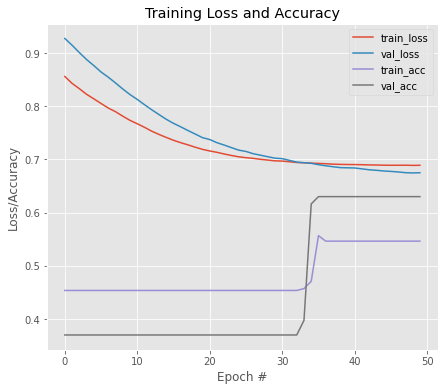


Model Performance Summary:

Best Validation accuracy:0.6301369667053223 at EPOCH:36
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6216 - accuracy: 0.6838
Epoch 1: val_loss improved from inf to 0.71329, saving model to resnet50_b_0.hdf5
10/10 [==============================] - 17s 653ms/step - loss: 0.6216 - accuracy: 0.6838 - val_loss: 0.7133 - val_accuracy: 0.3699
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.2832 - accuracy: 0.9347
Epoch 2: val_loss did not improve from 0.71329
10/10 [==============================] - 3s 329ms/step - loss: 0.2832 - accuracy: 0.9347 - val_loss: 0.7543 - val_accuracy: 0.3699
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.1758 - accuracy: 0.9759
Epoch 3: val_loss did not improve from 0.71329
10/10 [==============================] - 3s 329ms/step - loss: 0.1758 - accuracy: 0.9759 - val_loss: 0.8470 - val_accuracy: 0.3699
Epoch 4/50
10/10 [==============================] - ETA: 0s - l

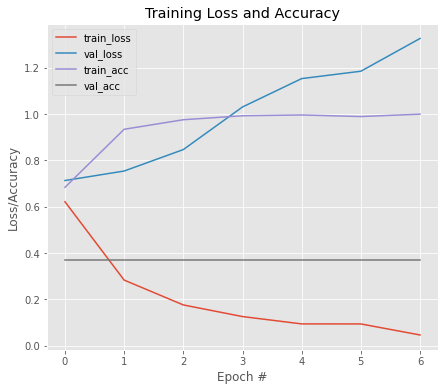


Model Performance Summary:

Best Validation accuracy:0.36986300349235535 at EPOCH:1
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1248 - accuracy: 0.9656
Epoch 1: val_loss improved from inf to 1.62785, saving model to resnet50_a_1.hdf5
10/10 [==============================] - 15s 510ms/step - loss: 0.1248 - accuracy: 0.9656 - val_loss: 1.6278 - val_accuracy: 0.3562
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0472 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 1.62785
10/10 [==============================] - 3s 327ms/step - loss: 0.0472 - accuracy: 0.9931 - val_loss: 1.7668 - val_accuracy: 0.3562
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0346 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 1.62785
10/10 [==============================] - 3s 329ms/step - loss: 0.0346 - accuracy: 1.0000 - val_loss: 1.8866 - val_accuracy: 0.3562
Epoch 4/50
10/10 [=============================

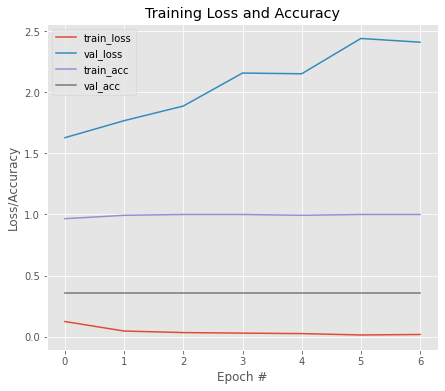


Model Performance Summary:

Best Validation accuracy:0.3561643958091736 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0664 - accuracy: 0.9931
Epoch 1: val_loss improved from inf to 1.64007, saving model to resnet50_b_1.hdf5
10/10 [==============================] - 15s 520ms/step - loss: 0.0664 - accuracy: 0.9931 - val_loss: 1.6401 - val_accuracy: 0.3562
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0197 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.64007
10/10 [==============================] - 3s 328ms/step - loss: 0.0197 - accuracy: 1.0000 - val_loss: 1.8800 - val_accuracy: 0.3562
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0212 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 1.64007
10/10 [==============================] - 3s 331ms/step - loss: 0.0212 - accuracy: 0.9966 - val_loss: 1.8835 - val_accuracy: 0.3562
Epoch 4/50
10/10 [==============================] - ETA: 0s - lo

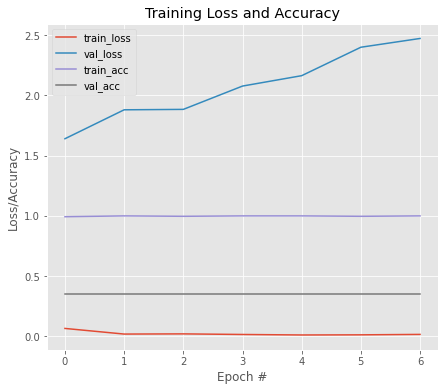


Model Performance Summary:

Best Validation accuracy:0.3561643958091736 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0246 - accuracy: 0.9931
Epoch 1: val_loss improved from inf to 2.88327, saving model to resnet50_a_2.hdf5
10/10 [==============================] - 15s 517ms/step - loss: 0.0246 - accuracy: 0.9931 - val_loss: 2.8833 - val_accuracy: 0.4932
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0069 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.88327
10/10 [==============================] - 3s 328ms/step - loss: 0.0069 - accuracy: 1.0000 - val_loss: 2.9486 - val_accuracy: 0.4932
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0158 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 2.88327
10/10 [==============================] - 3s 327ms/step - loss: 0.0158 - accuracy: 0.9966 - val_loss: 2.8848 - val_accuracy: 0.4932
Epoch 4/50
10/10 [==============================

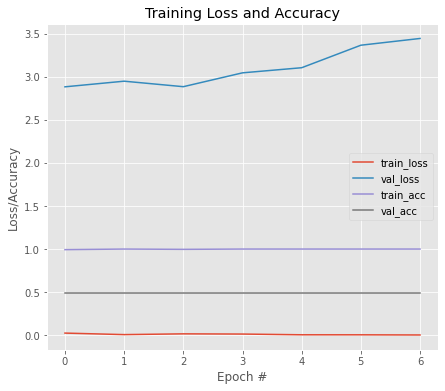


Model Performance Summary:

Best Validation accuracy:0.4931506812572479 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.35874, saving model to resnet50_b_2.hdf5
10/10 [==============================] - 15s 547ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 3.3587 - val_accuracy: 0.4932
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 3.35874
10/10 [==============================] - 3s 327ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 3.5536 - val_accuracy: 0.4932
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 3.35874
10/10 [==============================] - 3s 328ms/step - loss: 0.0053 - accuracy: 0.9966 - val_loss: 3.7280 - val_accuracy: 0.4932
Epoch 4/50
10/10 [==============================] - ETA: 0s - lo

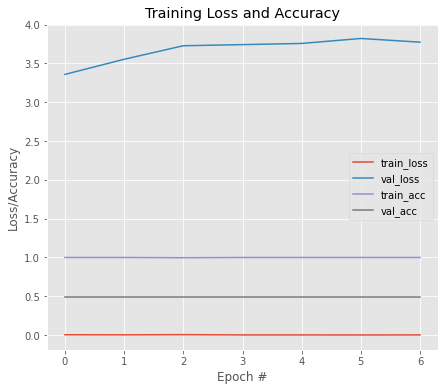


Model Performance Summary:

Best Validation accuracy:0.4931506812572479 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.74158, saving model to resnet50_a_3.hdf5
10/10 [==============================] - 15s 516ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 4.7416 - val_accuracy: 0.4110
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 8.2654e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 4.74158
10/10 [==============================] - 3s 354ms/step - loss: 8.2654e-04 - accuracy: 1.0000 - val_loss: 4.8008 - val_accuracy: 0.4110
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0275 - accuracy: 0.9931
Epoch 3: val_loss improved from 4.74158 to 4.51660, saving model to resnet50_a_3.hdf5
10/10 [==============================] - 4s 418ms/step - loss: 0.0275 - accuracy: 0.9931 - val_loss: 4.5166 - val_accuracy: 0.4110
E

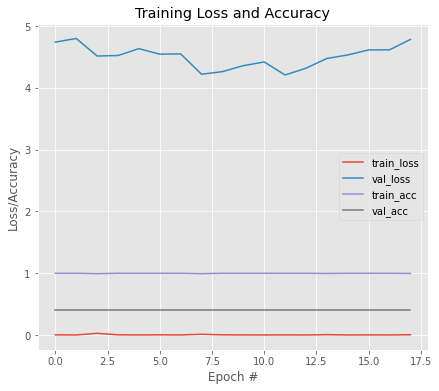


Model Performance Summary:

Best Validation accuracy:0.4109589159488678 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0042 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 5.17142, saving model to resnet50_b_3.hdf5
10/10 [==============================] - 15s 506ms/step - loss: 0.0042 - accuracy: 1.0000 - val_loss: 5.1714 - val_accuracy: 0.4110
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 3.9167e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 5.17142
10/10 [==============================] - 3s 328ms/step - loss: 3.9167e-04 - accuracy: 1.0000 - val_loss: 5.2518 - val_accuracy: 0.4110
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 5.17142
10/10 [==============================] - 3s 329ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 5.3988 - val_accuracy: 0.4110
Epoch 4/50
10/10 [==============================] - ETA:

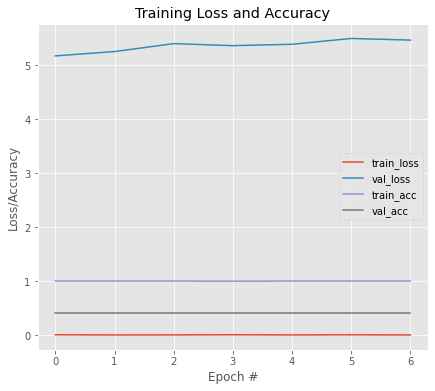


Model Performance Summary:

Best Validation accuracy:0.4109589159488678 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 3.2453e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.42084, saving model to resnet50_a_4.hdf5
10/10 [==============================] - 16s 666ms/step - loss: 3.2453e-04 - accuracy: 1.0000 - val_loss: 4.4208 - val_accuracy: 0.5556
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0060 - accuracy: 0.9966
Epoch 2: val_loss did not improve from 4.42084
10/10 [==============================] - 3s 328ms/step - loss: 0.0060 - accuracy: 0.9966 - val_loss: 4.5265 - val_accuracy: 0.5556
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 3.0976e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.42084
10/10 [==============================] - 3s 329ms/step - loss: 3.0976e-04 - accuracy: 1.0000 - val_loss: 4.5357 - val_accuracy: 0.5556
Epoch 4/50
10/10 [==============

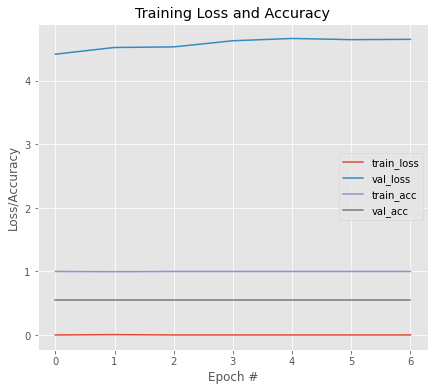


Model Performance Summary:

Best Validation accuracy:0.5555555820465088 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 1.2532e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.29775, saving model to resnet50_b_4.hdf5
10/10 [==============================] - 15s 513ms/step - loss: 1.2532e-04 - accuracy: 1.0000 - val_loss: 4.2977 - val_accuracy: 0.5556
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 7.2747e-05 - accuracy: 1.0000
Epoch 2: val_loss improved from 4.29775 to 4.24368, saving model to resnet50_b_4.hdf5
10/10 [==============================] - 4s 408ms/step - loss: 7.2747e-05 - accuracy: 1.0000 - val_loss: 4.2437 - val_accuracy: 0.5556
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 4.8308e-05 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.24368
10/10 [==============================] - 3s 329ms/step - loss: 4.8308e-05 - accuracy: 1.0000 - val_loss: 4.2825 - val_accuracy: 0.5556
E

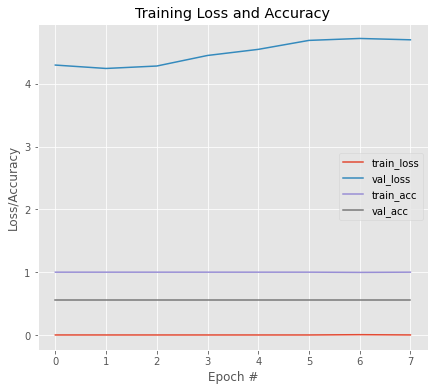


Model Performance Summary:

Best Validation accuracy:0.5555555820465088 at EPOCH:1
Average Accuracy:0.4371385157108307
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 5.1694 - accuracy: 0.4368
Epoch 1: val_loss improved from inf to 4.87040, saving model to resnet50_wt.hdf5
12/12 [==============================] - 7s 345ms/step - loss: 5.1694 - accuracy: 0.4368 - val_loss: 4.8704 - val_accuracy: 0.4505
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 4.8618 - accuracy: 0.4368
Epoch 2: val_loss improved from 4.87040 to 4.61332, saving model to resnet50_wt.hdf5
12/12 [==============================] - 2s 162ms/step - loss: 4.8618 - accuracy: 0.4368 - val_loss: 4.6133 - val_accuracy: 0.4505
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 4.5985 - accuracy: 0.4368
Epoch 3: val_loss improved from 4.61332 to 4.36493, saving model to resnet50_wt.hdf5
12/12 [==

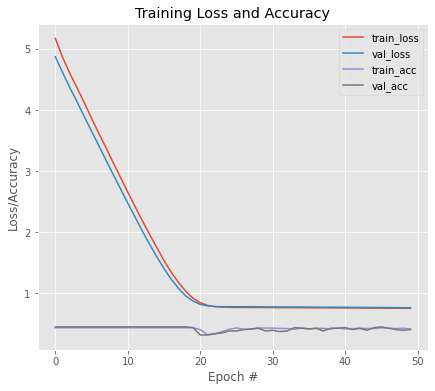


Model Performance Summary:

Best Validation accuracy:0.450549453496933 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 4.6151e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.20947, saving model to resnet50_wt.hdf5
12/12 [==============================] - 16s 559ms/step - loss: 4.6151e-04 - accuracy: 1.0000 - val_loss: 4.2095 - val_accuracy: 0.4505
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 1.0348e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 4.20947 to 4.18498, saving model to resnet50_wt.hdf5
12/12 [==============================] - 5s 406ms/step - loss: 1.0348e-04 - accuracy: 1.0000 - val_loss: 4.1850 - val_accuracy: 0.4505
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 1.5903e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.18498
12/12 [==============================] - 4s 342ms/step - loss: 1.5903e-04 - accuracy: 1.0000

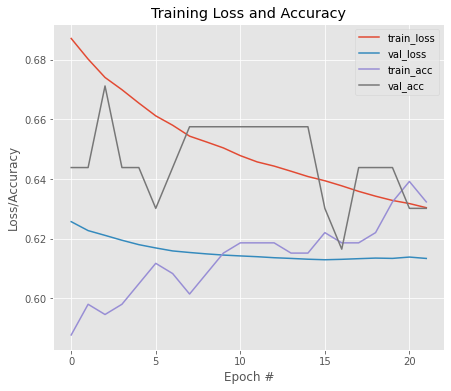


Model Performance Summary:

Best Validation accuracy:0.6712328791618347 at EPOCH:3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.7977 - accuracy: 0.5430
Epoch 1: val_loss improved from inf to 0.60956, saving model to DenseNet121_b_0.hdf5
10/10 [==============================] - 29s 927ms/step - loss: 0.7977 - accuracy: 0.5430 - val_loss: 0.6096 - val_accuracy: 0.6712
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.5046 - accuracy: 0.7182
Epoch 2: val_loss did not improve from 0.60956
10/10 [==============================] - 4s 364ms/step - loss: 0.5046 - accuracy: 0.7182 - val_loss: 0.6386 - val_accuracy: 0.6301
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.3515 - accuracy: 0.8522
Epoch 3: val_loss did not improve from 0.60956
10/10 [==============================] - 4s 362ms/step - loss: 0.3515 - accuracy: 0.8522 - val_loss: 0.6858 - val_accuracy: 0.5890
Epoch 4/50
10/10 [==============================] - ETA: 0s -

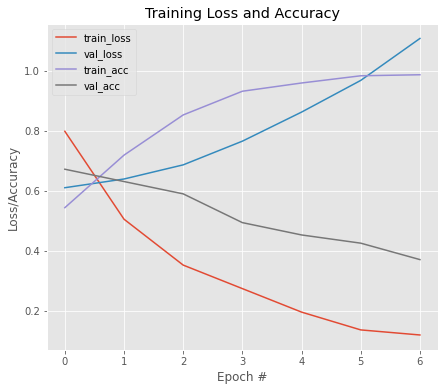


Model Performance Summary:

Best Validation accuracy:0.6712328791618347 at EPOCH:1
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.2345 - accuracy: 0.9072
Epoch 1: val_loss improved from inf to 1.18961, saving model to DenseNet121_a_1.hdf5
10/10 [==============================] - 26s 653ms/step - loss: 0.2345 - accuracy: 0.9072 - val_loss: 1.1896 - val_accuracy: 0.3699
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.1100 - accuracy: 0.9691
Epoch 2: val_loss did not improve from 1.18961
10/10 [==============================] - 4s 360ms/step - loss: 0.1100 - accuracy: 0.9691 - val_loss: 1.4030 - val_accuracy: 0.3562
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.1083 - accuracy: 0.9828
Epoch 3: val_loss did not improve from 1.18961
10/10 [==============================] - 4s 395ms/step - loss: 0.1083 - accuracy: 0.9828 - val_loss: 1.5694 - val_accuracy: 0.3562
Epoch 4/50
10/10 [===========================

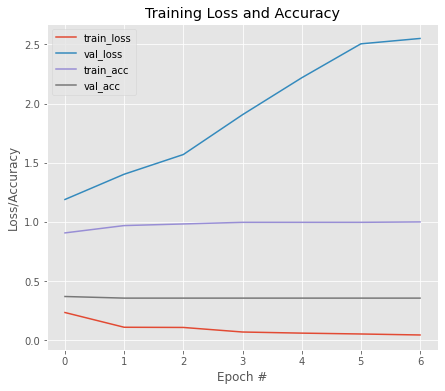


Model Performance Summary:

Best Validation accuracy:0.36986300349235535 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1152 - accuracy: 0.9691
Epoch 1: val_loss improved from inf to 1.31176, saving model to DenseNet121_b_1.hdf5
10/10 [==============================] - 25s 654ms/step - loss: 0.1152 - accuracy: 0.9691 - val_loss: 1.3118 - val_accuracy: 0.3699
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0673 - accuracy: 0.9897
Epoch 2: val_loss did not improve from 1.31176
10/10 [==============================] - 4s 362ms/step - loss: 0.0673 - accuracy: 0.9897 - val_loss: 1.4332 - val_accuracy: 0.3562
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0671 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 1.31176
10/10 [==============================] - 4s 361ms/step - loss: 0.0671 - accuracy: 0.9966 - val_loss: 1.5958 - val_accuracy: 0.3562
Epoch 4/50
10/10 [==============================] - ETA: 0s 

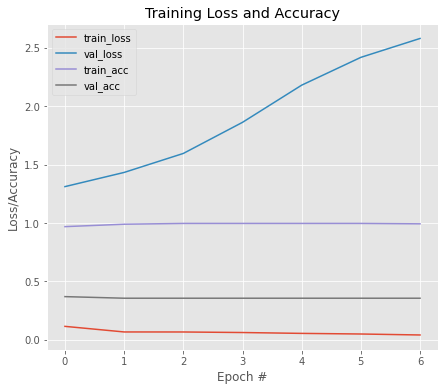


Model Performance Summary:

Best Validation accuracy:0.36986300349235535 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0573 - accuracy: 0.9897
Epoch 1: val_loss improved from inf to 2.36884, saving model to DenseNet121_a_2.hdf5
10/10 [==============================] - 25s 643ms/step - loss: 0.0573 - accuracy: 0.9897 - val_loss: 2.3688 - val_accuracy: 0.4932
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0440 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 2.36884
10/10 [==============================] - 4s 365ms/step - loss: 0.0440 - accuracy: 0.9931 - val_loss: 2.5192 - val_accuracy: 0.4932
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0263 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 2.36884
10/10 [==============================] - 4s 360ms/step - loss: 0.0263 - accuracy: 1.0000 - val_loss: 2.7210 - val_accuracy: 0.4932
Epoch 4/50
10/10 [==========================

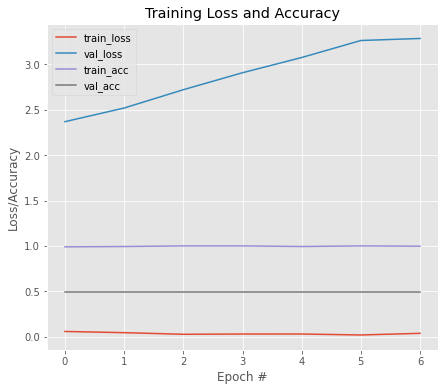


Model Performance Summary:

Best Validation accuracy:0.4931506812572479 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0476 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 2.67195, saving model to DenseNet121_b_2.hdf5
10/10 [==============================] - 25s 648ms/step - loss: 0.0476 - accuracy: 0.9966 - val_loss: 2.6719 - val_accuracy: 0.4932
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0192 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 2.67195
10/10 [==============================] - 4s 363ms/step - loss: 0.0192 - accuracy: 1.0000 - val_loss: 2.8773 - val_accuracy: 0.4932
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0246 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 2.67195
10/10 [==============================] - 4s 364ms/step - loss: 0.0246 - accuracy: 0.9966 - val_loss: 3.0053 - val_accuracy: 0.4932
Epoch 4/50
10/10 [==============================] - ETA: 0s -

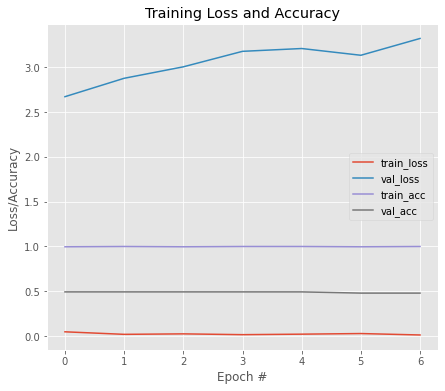


Model Performance Summary:

Best Validation accuracy:0.4931506812572479 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0111 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 3.77860, saving model to DenseNet121_a_3.hdf5
10/10 [==============================] - 25s 649ms/step - loss: 0.0111 - accuracy: 1.0000 - val_loss: 3.7786 - val_accuracy: 0.4110
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0269 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 3.77860
10/10 [==============================] - 4s 361ms/step - loss: 0.0269 - accuracy: 0.9931 - val_loss: 4.0425 - val_accuracy: 0.4110
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 3.77860
10/10 [==============================] - 4s 362ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 4.0799 - val_accuracy: 0.4110
Epoch 4/50
10/10 [===========================

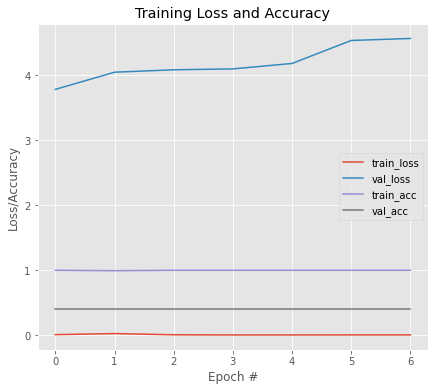


Model Performance Summary:

Best Validation accuracy:0.4109589159488678 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0102 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 4.35231, saving model to DenseNet121_b_3.hdf5
10/10 [==============================] - 25s 650ms/step - loss: 0.0102 - accuracy: 1.0000 - val_loss: 4.3523 - val_accuracy: 0.4110
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0069 - accuracy: 1.0000
Epoch 2: val_loss improved from 4.35231 to 4.31799, saving model to DenseNet121_b_3.hdf5
10/10 [==============================] - 4s 449ms/step - loss: 0.0069 - accuracy: 1.0000 - val_loss: 4.3180 - val_accuracy: 0.4110
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0062 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 4.31799
10/10 [==============================] - 4s 359ms/step - loss: 0.0062 - accuracy: 1.0000 - val_loss: 4.4169 - val_accuracy: 0.4110
Epoch 4/50
10/10 [=

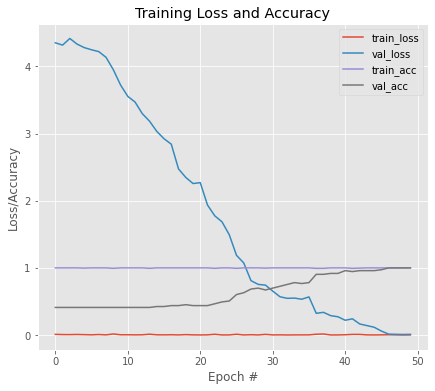


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:47
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00326, saving model to DenseNet121_a_4.hdf5
10/10 [==============================] - 28s 989ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00326 to 0.00197, saving model to DenseNet121_a_4.hdf5
10/10 [==============================] - 4s 455ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0020 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00197
10/10 [==============================] - 4s 365ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.0118 - val_accuracy: 1.0000
Epoch 4/50
10/10 

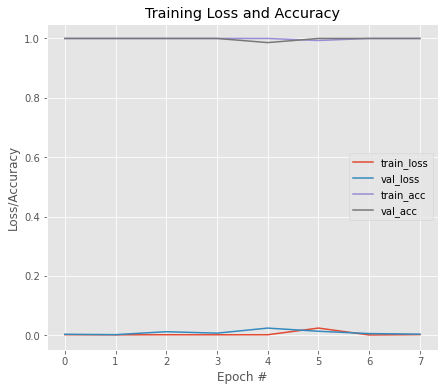


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00133, saving model to DenseNet121_b_4.hdf5
10/10 [==============================] - 25s 641ms/step - loss: 0.0030 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 4.6889e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00133 to 0.00102, saving model to DenseNet121_b_4.hdf5
10/10 [==============================] - 4s 454ms/step - loss: 4.6889e-04 - accuracy: 1.0000 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000    
Epoch 3: val_loss did not improve from 0.00102
10/10 [==============================] - 4s 365ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 4/50
10/10 [====

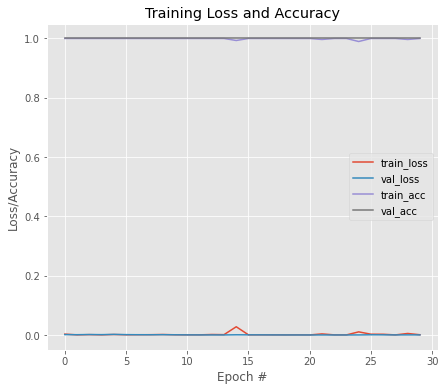


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.7068493127822876
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.33422, saving model to DenseNet121_wt.hdf5
12/12 [==============================] - 11s 544ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss: 0.3342 - val_accuracy: 0.8791
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.33422
12/12 [==============================] - 2s 129ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss: 0.3345 - val_accuracy: 0.8791
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.33422
12/12 [==============================] - 2s 132ms/step - loss: 0.0033 - accuracy: 1.0000 - val_l

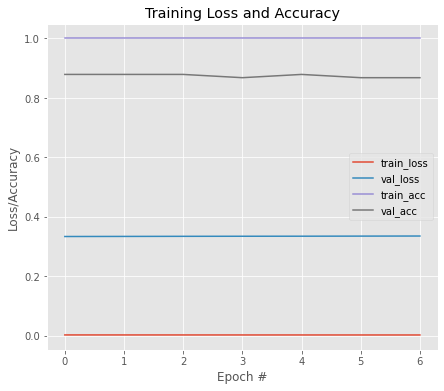


Model Performance Summary:

Best Validation accuracy:0.8791208863258362 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.50031, saving model to DenseNet121_wt.hdf5
12/12 [==============================] - 27s 762ms/step - loss: 0.0051 - accuracy: 1.0000 - val_loss: 0.5003 - val_accuracy: 0.8571
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.50031 to 0.44944, saving model to DenseNet121_wt.hdf5
12/12 [==============================] - 5s 446ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 0.4494 - val_accuracy: 0.8352
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.44944 to 0.40040, saving model to DenseNet121_wt.hdf5
12/12 [==============================] - 5s 450ms/step - loss: 0

In [ ]:
for model in MODEL_LIST_1:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx3,trainy3,testx3,testy3,data_aug=False,dataset = 'RIM-ONE_v2')
  gc.collect()

83697664/83683744 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.8393 - accuracy: 0.4502
Epoch 1: val_loss improved from inf to 0.89323, saving model to xception_a_0.hdf5
10/10 [==============================] - 7s 304ms/step - loss: 0.8393 - accuracy: 0.4502 - val_loss: 0.8932 - val_accuracy: 0.3699
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.8265 - accuracy: 0.4502
Epoch 2: val_loss improved from 0.89323 to 0.88060, saving model to xception_a_0.hdf5
10/10 [==============================] - 2s 202ms/step - loss: 0.8265 - accuracy: 0.4502 - val_loss: 0.8806 - val_accuracy: 0.3699
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.8165 - accuracy: 0.4502
Epoch 3: val_loss improved from 0.88060 to 0.86657, saving model to xception_a_0.hdf5
10/10 [==============================] - 2s 201ms/step - loss: 0.8165 - accuracy: 0.4502 - val_loss: 0.8666 - val_accurac

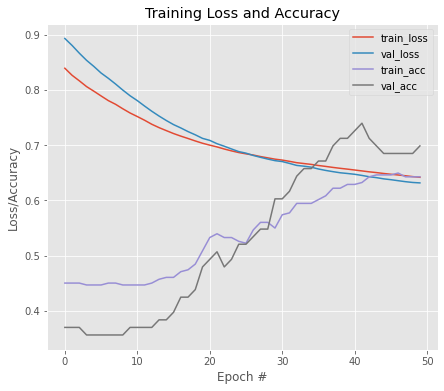


Model Performance Summary:

Best Validation accuracy:0.7397260069847107 at EPOCH:42
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6659 - accuracy: 0.5739
Epoch 1: val_loss improved from inf to 0.61331, saving model to xception_b_0.hdf5
10/10 [==============================] - 17s 850ms/step - loss: 0.6659 - accuracy: 0.5739 - val_loss: 0.6133 - val_accuracy: 0.6849
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.5426 - accuracy: 0.7148
Epoch 2: val_loss improved from 0.61331 to 0.60482, saving model to xception_b_0.hdf5
10/10 [==============================] - 8s 751ms/step - loss: 0.5426 - accuracy: 0.7148 - val_loss: 0.6048 - val_accuracy: 0.7123
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.4658 - accuracy: 0.8351
Epoch 3: val_loss improved from 0.60482 to 0.59725, saving model to xception_b_0.hdf5
10/10 [==============================] - 8s 751ms/step - loss: 0.4658 - accuracy: 0.8351 - val_loss: 0.5973 - val_ac

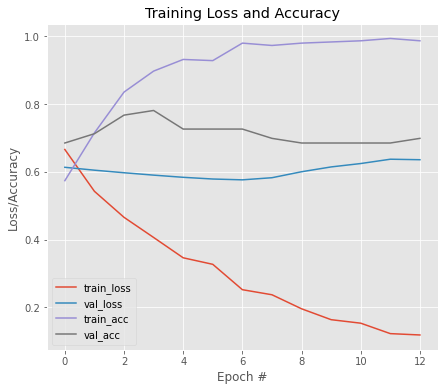


Model Performance Summary:

Best Validation accuracy:0.7808219194412231 at EPOCH:4
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1684 - accuracy: 0.9519
Epoch 1: val_loss improved from inf to 0.40754, saving model to xception_a_1.hdf5
10/10 [==============================] - 15s 825ms/step - loss: 0.1684 - accuracy: 0.9519 - val_loss: 0.4075 - val_accuracy: 0.8219
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.1023 - accuracy: 0.9863
Epoch 2: val_loss improved from 0.40754 to 0.38733, saving model to xception_a_1.hdf5
10/10 [==============================] - 8s 751ms/step - loss: 0.1023 - accuracy: 0.9863 - val_loss: 0.3873 - val_accuracy: 0.8493
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0892 - accuracy: 0.9931
Epoch 3: val_loss improved from 0.38733 to 0.36257, saving model to xception_a_1.hdf5
10/10 [==============================] - 8s 753ms/step - loss: 0.0892 - accuracy: 0.9931 - val_loss: 

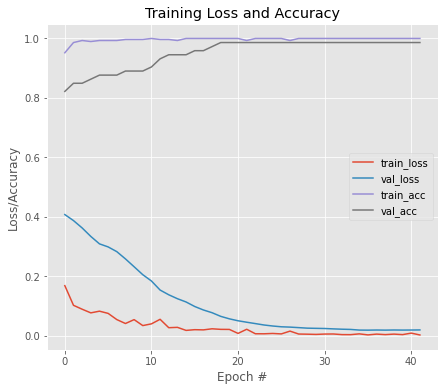


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:19
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.01948, saving model to xception_b_1.hdf5
10/10 [==============================] - 15s 815ms/step - loss: 0.0039 - accuracy: 1.0000 - val_loss: 0.0195 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0131 - accuracy: 0.9931
Epoch 2: val_loss improved from 0.01948 to 0.01834, saving model to xception_b_1.hdf5
10/10 [==============================] - 7s 747ms/step - loss: 0.0131 - accuracy: 0.9931 - val_loss: 0.0183 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0185 - accuracy: 0.9931
Epoch 3: val_loss improved from 0.01834 to 0.01770, saving model to xception_b_1.hdf5
10/10 [==============================] - 7s 747ms/step - loss: 0.0185 - accuracy: 0.9931 - val_loss: 0.0177 - val_ac

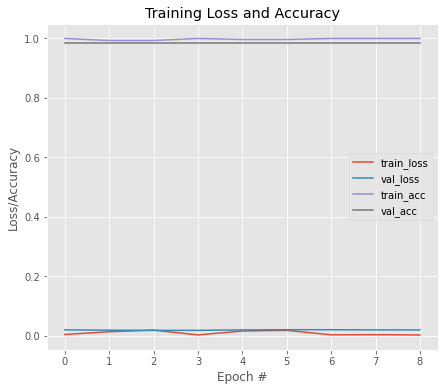


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0250 - accuracy: 0.9863
Epoch 1: val_loss improved from inf to 0.00085, saving model to xception_a_2.hdf5
10/10 [==============================] - 15s 815ms/step - loss: 0.0250 - accuracy: 0.9863 - val_loss: 8.5085e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0044 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00085 to 0.00084, saving model to xception_a_2.hdf5
10/10 [==============================] - 7s 746ms/step - loss: 0.0044 - accuracy: 1.0000 - val_loss: 8.3948e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0242 - accuracy: 0.9931
Epoch 3: val_loss did not improve from 0.00084
10/10 [==============================] - 7s 685ms/step - loss: 0.0242 - accuracy: 0.9931 - val_loss: 8.7721e-04 - val_accuracy: 1.00

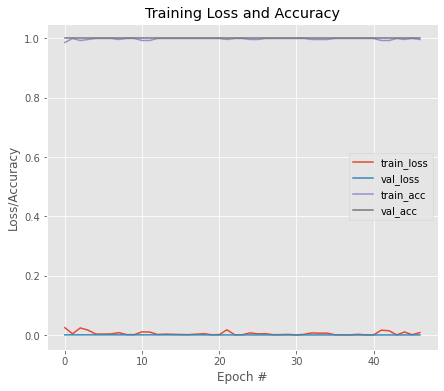


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0097 - accuracy: 0.9966    
Epoch 1: val_loss improved from inf to 0.00032, saving model to xception_b_2.hdf5
10/10 [==============================] - 15s 816ms/step - loss: 0.0097 - accuracy: 0.9966 - val_loss: 3.2374e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00032 to 0.00032, saving model to xception_b_2.hdf5
10/10 [==============================] - 7s 741ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 3.2055e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00032 to 0.00031, saving model to xception_b_2.hdf5
10/10 [==============================] - 8s 752ms/step - loss: 0.0047 - accuracy: 1.0000 - val_loss: 3.1428e-04 - val_ac

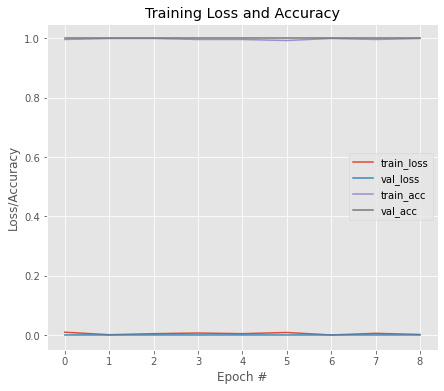


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0177 - accuracy: 0.9966    
Epoch 1: val_loss improved from inf to 0.00019, saving model to xception_a_3.hdf5
10/10 [==============================] - 15s 819ms/step - loss: 0.0177 - accuracy: 0.9966 - val_loss: 1.8779e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 2.7058e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00019 to 0.00018, saving model to xception_a_3.hdf5
10/10 [==============================] - 8s 751ms/step - loss: 2.7058e-04 - accuracy: 1.0000 - val_loss: 1.8198e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.00018
10/10 [==============================] - 7s 684ms/step - loss: 0.0037 - accuracy: 0.9966 - val_loss: 1.8280e-04 - val_accuracy: 1.0000


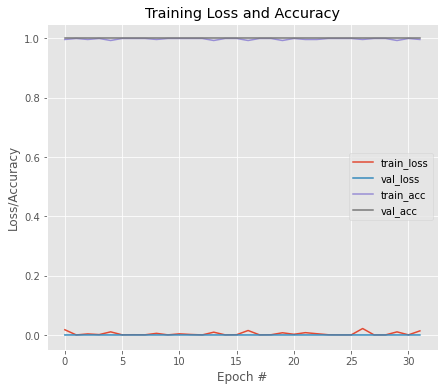


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0158 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.00015, saving model to xception_b_3.hdf5
10/10 [==============================] - 15s 882ms/step - loss: 0.0158 - accuracy: 0.9966 - val_loss: 1.4951e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 8.1553e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00015 to 0.00014, saving model to xception_b_3.hdf5
10/10 [==============================] - 7s 749ms/step - loss: 8.1553e-04 - accuracy: 1.0000 - val_loss: 1.4494e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 8.7748e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00014 to 0.00014, saving model to xception_b_3.hdf5
10/10 [==============================] - 7s 748ms/step - loss: 8.7748e-04 - accuracy: 1.0000 - val_loss: 1.4475e

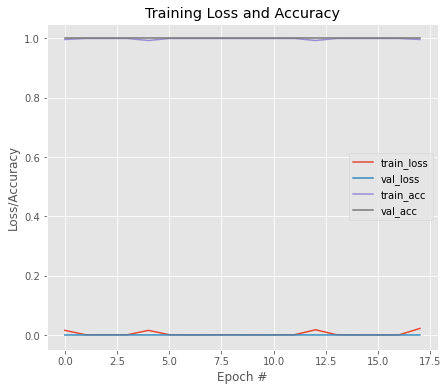


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0181 - accuracy: 0.9897
Epoch 1: val_loss improved from inf to 0.00008, saving model to xception_a_4.hdf5
10/10 [==============================] - 15s 857ms/step - loss: 0.0181 - accuracy: 0.9897 - val_loss: 8.1409e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 1.8177e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00008 to 0.00008, saving model to xception_a_4.hdf5
10/10 [==============================] - 7s 750ms/step - loss: 1.8177e-04 - accuracy: 1.0000 - val_loss: 8.0789e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 3.2056e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00008 to 0.00008, saving model to xception_a_4.hdf5
10/10 [==============================] - 8s 750ms/step - loss: 3.2056e-04 - accuracy: 1.0000 - v

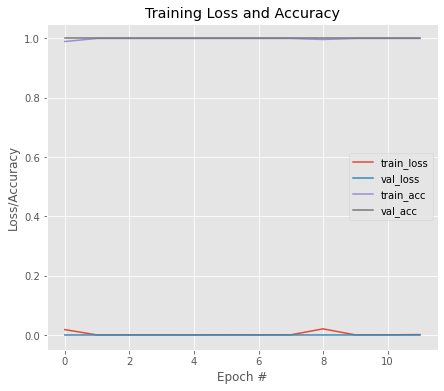


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00007, saving model to xception_b_4.hdf5
10/10 [==============================] - 15s 881ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 7.4421e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 5.3204e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00007
10/10 [==============================] - 7s 686ms/step - loss: 5.3204e-04 - accuracy: 1.0000 - val_loss: 7.4501e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0131 - accuracy: 0.9932
Epoch 3: val_loss did not improve from 0.00007
10/10 [==============================] - 7s 688ms/step - loss: 0.0131 - accuracy: 0.9932 - val_loss: 7.6462e-05 - val_accuracy: 1.0000
Epoch 4/50
10/10 [==============================] - ETA: 0s

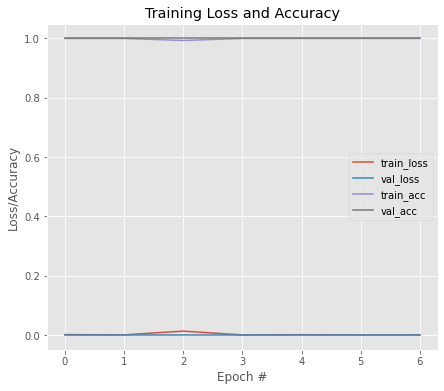


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9534246563911438
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 2.6510e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.29664, saving model to xception_wt.hdf5
12/12 [==============================] - 6s 300ms/step - loss: 2.6510e-04 - accuracy: 1.0000 - val_loss: 0.2966 - val_accuracy: 0.9121
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 2.4866e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.29664
12/12 [==============================] - 2s 168ms/step - loss: 2.4866e-04 - accuracy: 1.0000 - val_loss: 0.2987 - val_accuracy: 0.9121
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 2.3655e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.29664
12/12 [==============================] - 2s 170ms/step - loss: 2.3655e-04 - accu

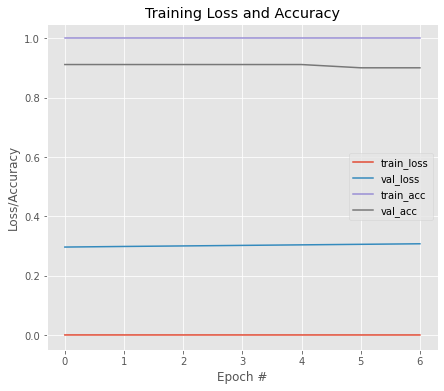


Model Performance Summary:

Best Validation accuracy:0.9120879173278809 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 8.9881e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.33169, saving model to xception_wt.hdf5
12/12 [==============================] - 17s 849ms/step - loss: 8.9881e-04 - accuracy: 1.0000 - val_loss: 0.3317 - val_accuracy: 0.9121
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0197 - accuracy: 0.9918
Epoch 2: val_loss improved from 0.33169 to 0.28695, saving model to xception_wt.hdf5
12/12 [==============================] - 9s 803ms/step - loss: 0.0197 - accuracy: 0.9918 - val_loss: 0.2870 - val_accuracy: 0.9231
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0153 - accuracy: 0.9945
Epoch 3: val_loss did not improve from 0.28695
12/12 [==============================] - 9s 711ms/step - loss: 0.0153 - accuracy: 0.9945 - val_loss: 0.

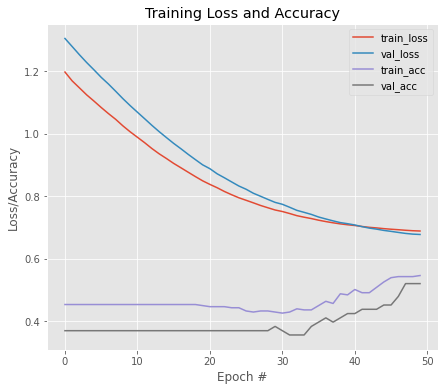


Model Performance Summary:

Best Validation accuracy:0.5205479264259338 at EPOCH:48
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.7341 - accuracy: 0.5464
Epoch 1: val_loss improved from inf to 0.66614, saving model to InceptionResNetV2_b_0.hdf5
10/10 [==============================] - 40s 1s/step - loss: 0.7341 - accuracy: 0.5464 - val_loss: 0.6661 - val_accuracy: 0.5616
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.5246 - accuracy: 0.6426
Epoch 2: val_loss did not improve from 0.66614
10/10 [==============================] - 6s 582ms/step - loss: 0.5246 - accuracy: 0.6426 - val_loss: 0.6684 - val_accuracy: 0.5753
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.4197 - accuracy: 0.7973
Epoch 3: val_loss did not improve from 0.66614
10/10 [==============================] - 6s 584ms/step - loss: 0.4197 - accuracy: 0.7973 - val_loss: 0.6886 - val_accuracy: 0.5616
Epoch 4/50
10/10 [==============================] - ETA: 

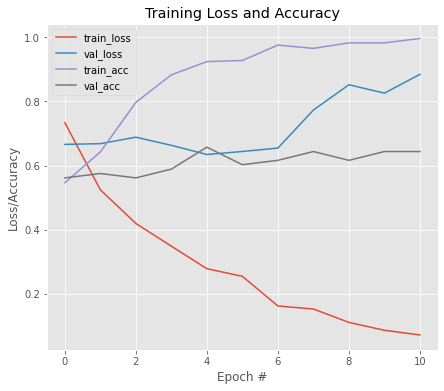


Model Performance Summary:

Best Validation accuracy:0.6575342416763306 at EPOCH:5
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1750 - accuracy: 0.9416
Epoch 1: val_loss improved from inf to 0.54126, saving model to InceptionResNetV2_a_1.hdf5
10/10 [==============================] - 38s 1s/step - loss: 0.1750 - accuracy: 0.9416 - val_loss: 0.5413 - val_accuracy: 0.7534
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0995 - accuracy: 0.9588
Epoch 2: val_loss improved from 0.54126 to 0.48807, saving model to InceptionResNetV2_a_1.hdf5
10/10 [==============================] - 8s 782ms/step - loss: 0.0995 - accuracy: 0.9588 - val_loss: 0.4881 - val_accuracy: 0.7123
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0841 - accuracy: 0.9863
Epoch 3: val_loss improved from 0.48807 to 0.47032, saving model to InceptionResNetV2_a_1.hdf5
10/10 [==============================] - 8s 784ms/step - loss: 0.0841 - accur

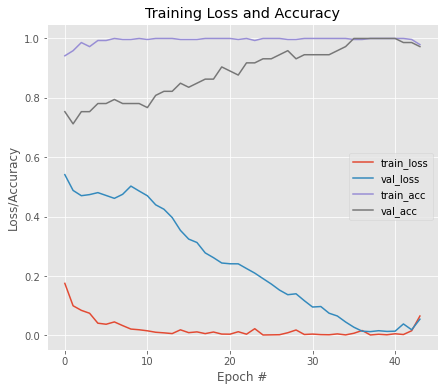


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:36
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0086 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.01010, saving model to InceptionResNetV2_b_1.hdf5
10/10 [==============================] - 39s 1s/step - loss: 0.0086 - accuracy: 0.9966 - val_loss: 0.0101 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0167 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 0.01010
10/10 [==============================] - 6s 583ms/step - loss: 0.0167 - accuracy: 0.9931 - val_loss: 0.0214 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0080 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.01010
10/10 [==============================] - 6s 582ms/step - loss: 0.0080 - accuracy: 0.9966 - val_loss: 0.0222 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================] - ETA: 0s - loss: 8.24

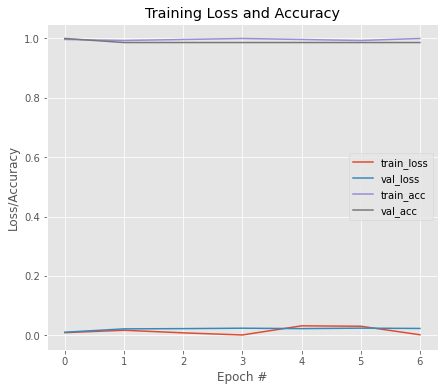


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 1.33625, saving model to InceptionResNetV2_a_2.hdf5
10/10 [==============================] - 39s 1s/step - loss: 0.0040 - accuracy: 1.0000 - val_loss: 1.3362 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 9.1444e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.33625
10/10 [==============================] - 6s 579ms/step - loss: 9.1444e-04 - accuracy: 1.0000 - val_loss: 1.4021 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0138 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 1.33625
10/10 [==============================] - 6s 582ms/step - loss: 0.0138 - accuracy: 0.9966 - val_loss: 1.6205 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================]

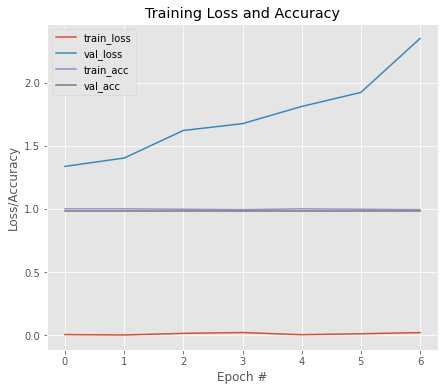


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0235 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 1.29924, saving model to InceptionResNetV2_b_2.hdf5
10/10 [==============================] - 38s 1s/step - loss: 0.0235 - accuracy: 0.9966 - val_loss: 1.2992 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 5.3760e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 1.29924
10/10 [==============================] - 6s 588ms/step - loss: 5.3760e-04 - accuracy: 1.0000 - val_loss: 1.3827 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 1.29924
10/10 [==============================] - 6s 583ms/step - loss: 0.0088 - accuracy: 0.9966 - val_loss: 1.3544 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================] 

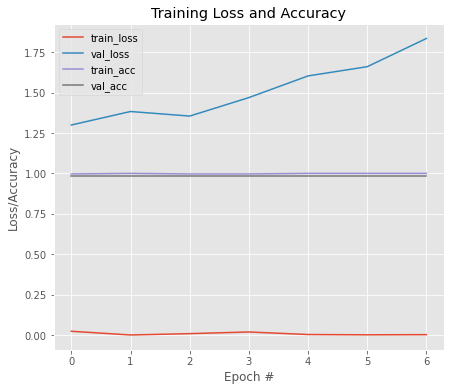


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.32241, saving model to InceptionResNetV2_a_3.hdf5
10/10 [==============================] - 38s 1s/step - loss: 0.0047 - accuracy: 0.9966 - val_loss: 0.3224 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0188 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 0.32241
10/10 [==============================] - 6s 582ms/step - loss: 0.0188 - accuracy: 0.9931 - val_loss: 0.3473 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.32241
10/10 [==============================] - 6s 584ms/step - loss: 0.0048 - accuracy: 0.9966 - val_loss: 0.3797 - val_accuracy: 0.9863
Epoch 4/50
10/10 [========================

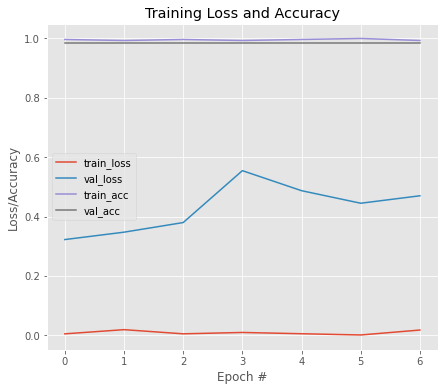


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0250 - accuracy: 0.9897
Epoch 1: val_loss improved from inf to 0.36638, saving model to InceptionResNetV2_b_3.hdf5
10/10 [==============================] - 38s 1s/step - loss: 0.0250 - accuracy: 0.9897 - val_loss: 0.3664 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 0.9966
Epoch 2: val_loss did not improve from 0.36638
10/10 [==============================] - 6s 585ms/step - loss: 0.0049 - accuracy: 0.9966 - val_loss: 0.3848 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.36638
10/10 [==============================] - 6s 583ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.3818 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================] - ETA: 0

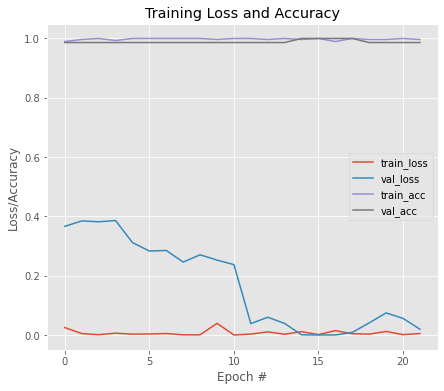


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:15
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000    
Epoch 1: val_loss improved from inf to 0.00012, saving model to InceptionResNetV2_a_4.hdf5
10/10 [==============================] - 39s 1s/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1892e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 0.9966
Epoch 2: val_loss did not improve from 0.00012
10/10 [==============================] - 6s 586ms/step - loss: 0.0036 - accuracy: 0.9966 - val_loss: 1.4173e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0215 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.00012
10/10 [==============================] - 6s 583ms/step - loss: 0.0215 - accuracy: 0.9966 - val_loss: 1.3063e-04 - val_accuracy: 1.0000
Epoch 4/50
10/10 [======================

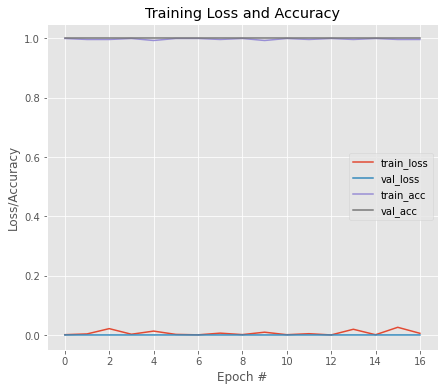


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.00006, saving model to InceptionResNetV2_b_4.hdf5
10/10 [==============================] - 38s 1s/step - loss: 0.0053 - accuracy: 0.9966 - val_loss: 6.3397e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 1.7575e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00006 to 0.00006, saving model to InceptionResNetV2_b_4.hdf5
10/10 [==============================] - 8s 782ms/step - loss: 1.7575e-04 - accuracy: 1.0000 - val_loss: 5.8741e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00006 to 0.00006, saving model to InceptionResNetV2_b_4.hdf5
10/10 [==============================] - 8s 791ms/step - loss: 0.0020 - accuracy: 1.0000 - v

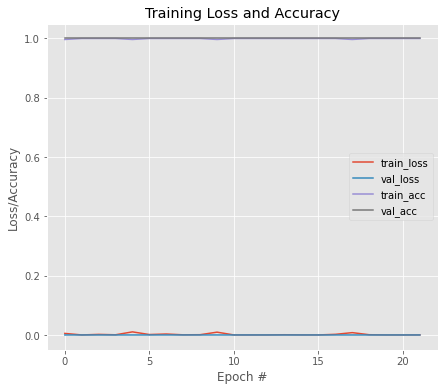


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9287671208381653
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.2385 - accuracy: 0.9945
Epoch 1: val_loss improved from inf to 0.64364, saving model to InceptionResNetV2_wt.hdf5
12/12 [==============================] - 16s 662ms/step - loss: 0.2385 - accuracy: 0.9945 - val_loss: 0.6436 - val_accuracy: 0.8901
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.2371 - accuracy: 0.9945
Epoch 2: val_loss did not improve from 0.64364
12/12 [==============================] - 3s 224ms/step - loss: 0.2371 - accuracy: 0.9945 - val_loss: 0.6451 - val_accuracy: 0.8901
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.2360 - accuracy: 0.9945
Epoch 3: val_loss did not improve from 0.64364
12/12 [==============================] - 3s 223ms/step - loss: 0.2360 - accuracy: 0.9945 -

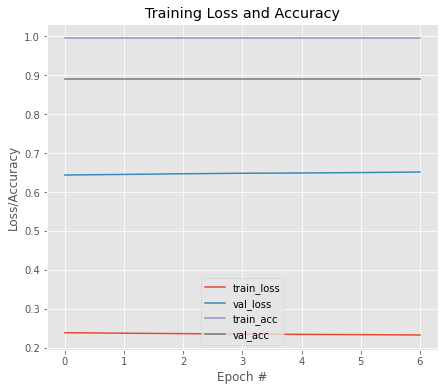


Model Performance Summary:

Best Validation accuracy:0.8901098966598511 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.97957, saving model to InceptionResNetV2_wt.hdf5
12/12 [==============================] - 40s 1s/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.9796 - val_accuracy: 0.8681
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0184 - accuracy: 0.9973
Epoch 2: val_loss improved from 0.97957 to 0.94550, saving model to InceptionResNetV2_wt.hdf5
12/12 [==============================] - 9s 787ms/step - loss: 0.0184 - accuracy: 0.9973 - val_loss: 0.9455 - val_accuracy: 0.8901
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0198 - accuracy: 0.9973
Epoch 3: val_loss improved from 0.94550 to 0.80741, saving model to InceptionResNetV2_wt.hdf5
12/12 [==============================] - 9s 761ms

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx3,trainy3,testx3,testy3,data_aug=False,dataset = 'RIM-ONE_v2')
  gc.collect()

17235968/17225924 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.8009 - accuracy: 0.4399
Epoch 1: val_loss improved from inf to 0.74609, saving model to MobileNet_a_0.hdf5
10/10 [==============================] - 3s 125ms/step - loss: 0.8009 - accuracy: 0.4399 - val_loss: 0.7461 - val_accuracy: 0.5068
Epoch 2/50
 9/10 [==========================>...] - ETA: 0s - loss: 0.7908 - accuracy: 0.4479
Epoch 2: val_loss improved from 0.74609 to 0.74592, saving model to MobileNet_a_0.hdf5
10/10 [==============================] - 1s 63ms/step - loss: 0.7975 - accuracy: 0.4433 - val_loss: 0.7459 - val_accuracy: 0.5068
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.7940 - accuracy: 0.4433
Epoch 3: val_loss improved from 0.74592 to 0.74304, saving model to MobileNet_a_0.hdf5
10/10 [==============================] - 1s 64ms/step - loss: 0.7940 - accuracy: 0.4433 - val_loss: 0.7430 - val_accura

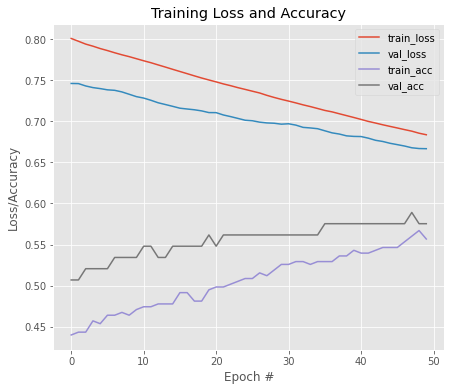


Model Performance Summary:

Best Validation accuracy:0.5890411138534546 at EPOCH:48
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.7933 - accuracy: 0.5739
Epoch 1: val_loss improved from inf to 0.62894, saving model to MobileNet_b_0.hdf5
10/10 [==============================] - 6s 235ms/step - loss: 0.7933 - accuracy: 0.5739 - val_loss: 0.6289 - val_accuracy: 0.6438
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.5367 - accuracy: 0.7148
Epoch 2: val_loss improved from 0.62894 to 0.60027, saving model to MobileNet_b_0.hdf5
10/10 [==============================] - 2s 178ms/step - loss: 0.5367 - accuracy: 0.7148 - val_loss: 0.6003 - val_accuracy: 0.6849
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.4267 - accuracy: 0.7904
Epoch 3: val_loss improved from 0.60027 to 0.58817, saving model to MobileNet_b_0.hdf5
10/10 [==============================] - 2s 180ms/step - loss: 0.4267 - accuracy: 0.7904 - val_loss: 0.5882 - val_

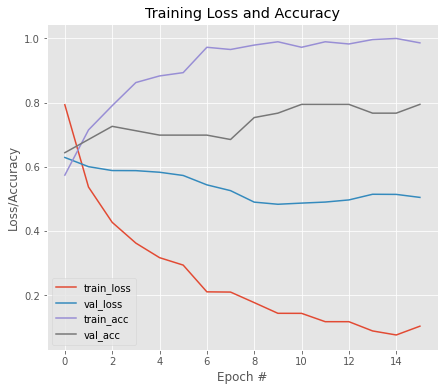


Model Performance Summary:

Best Validation accuracy:0.7945205569267273 at EPOCH:11
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.1474 - accuracy: 0.9691
Epoch 1: val_loss improved from inf to 0.36235, saving model to MobileNet_a_1.hdf5
10/10 [==============================] - 6s 225ms/step - loss: 0.1474 - accuracy: 0.9691 - val_loss: 0.3624 - val_accuracy: 0.8356
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.1337 - accuracy: 0.9691
Epoch 2: val_loss improved from 0.36235 to 0.35473, saving model to MobileNet_a_1.hdf5
10/10 [==============================] - 2s 176ms/step - loss: 0.1337 - accuracy: 0.9691 - val_loss: 0.3547 - val_accuracy: 0.8356
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0930 - accuracy: 0.9931
Epoch 3: val_loss improved from 0.35473 to 0.32320, saving model to MobileNet_a_1.hdf5
10/10 [==============================] - 2s 181ms/step - loss: 0.0930 - accuracy: 0.9931 - val_los

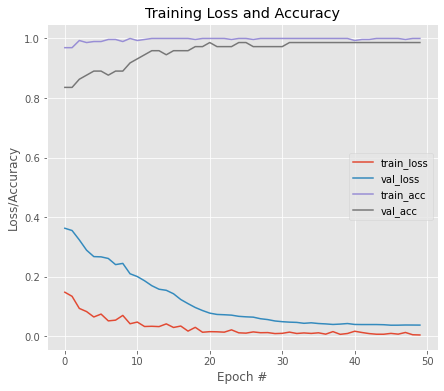


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:21
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.04044, saving model to MobileNet_b_1.hdf5
10/10 [==============================] - 6s 223ms/step - loss: 0.0047 - accuracy: 1.0000 - val_loss: 0.0404 - val_accuracy: 0.9863
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.04044
10/10 [==============================] - 2s 155ms/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.0416 - val_accuracy: 0.9863
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.04044
10/10 [==============================] - 2s 154ms/step - loss: 0.0051 - accuracy: 1.0000 - val_loss: 0.0419 - val_accuracy: 0.9863
Epoch 4/50
10/10 [==============================] - ETA: 0s - l

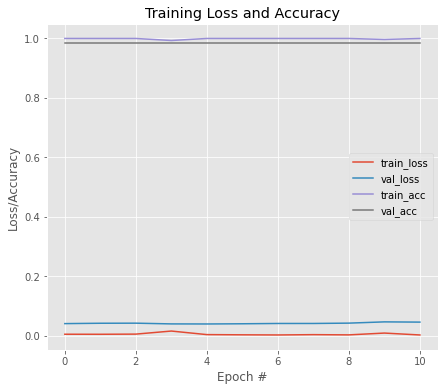


Model Performance Summary:

Best Validation accuracy:0.9863013625144958 at EPOCH:1
Starting fold 2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0131 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.00079, saving model to MobileNet_a_2.hdf5
10/10 [==============================] - 6s 227ms/step - loss: 0.0131 - accuracy: 0.9966 - val_loss: 7.8907e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0088 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00079
10/10 [==============================] - 2s 155ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 8.3058e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0067 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00079
10/10 [==============================] - 2s 154ms/step - loss: 0.0067 - accuracy: 1.0000 - val_loss: 7.9863e-04 - val_accuracy: 1.0000
Epoch 4/50
10/10 [==================

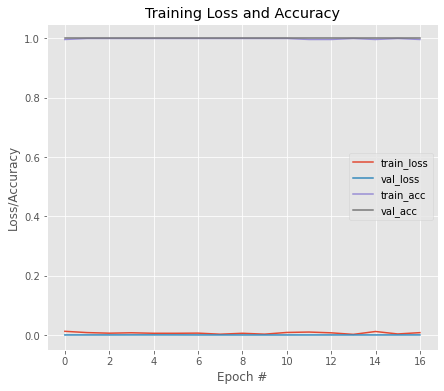


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 0.9931
Epoch 1: val_loss improved from inf to 0.00067, saving model to MobileNet_b_2.hdf5
10/10 [==============================] - 6s 232ms/step - loss: 0.0109 - accuracy: 0.9931 - val_loss: 6.6787e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00067 to 0.00065, saving model to MobileNet_b_2.hdf5
10/10 [==============================] - 2s 176ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 6.5479e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.00065
10/10 [==============================] - 2s 151ms/step - loss: 0.0053 - accuracy: 0.9966 - val_loss: 6.6282e-04 - val_accuracy: 1.0000
Epoch 4/50
10/10 [=========

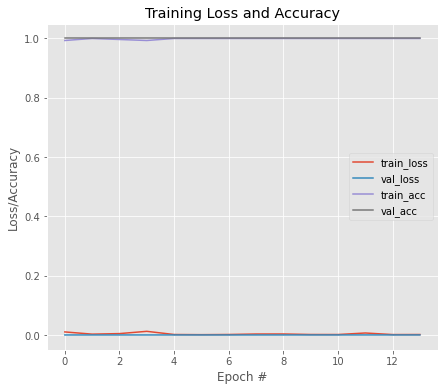


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00064, saving model to MobileNet_a_3.hdf5
10/10 [==============================] - 6s 226ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 6.4119e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0121 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 0.00064
10/10 [==============================] - 2s 152ms/step - loss: 0.0121 - accuracy: 0.9931 - val_loss: 6.8204e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00064 to 0.00060, saving model to MobileNet_a_3.hdf5
10/10 [==============================] - 2s 179ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 5.9738e-04 - val_accuracy: 1.0000
Epoch 4/50


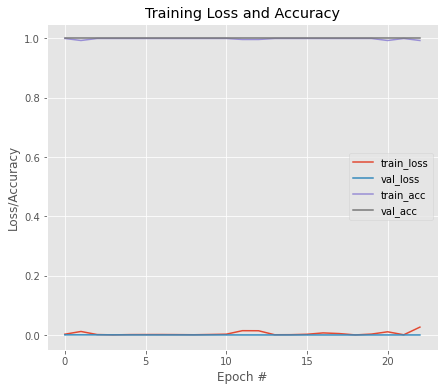


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0292 - accuracy: 0.9931
Epoch 1: val_loss improved from inf to 0.00019, saving model to MobileNet_b_3.hdf5
10/10 [==============================] - 6s 228ms/step - loss: 0.0292 - accuracy: 0.9931 - val_loss: 1.8884e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00019
10/10 [==============================] - 2s 153ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.9028e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 9.5107e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.00019
10/10 [==============================] - 2s 157ms/step - loss: 9.5107e-04 - accuracy: 1.0000 - val_loss: 1.9815e-04 - val_accuracy: 1.0000
Epoch 4/50
10/10 [==============================] - ETA: 0s

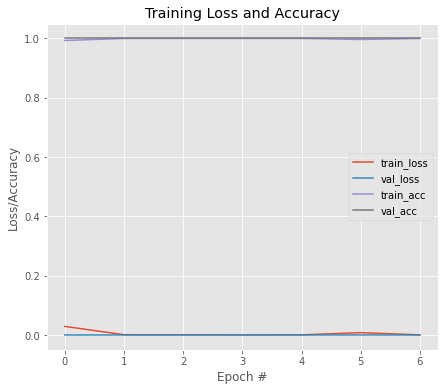


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00012, saving model to MobileNet_a_4.hdf5
10/10 [==============================] - 6s 249ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 1.1917e-04 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 6.0221e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.00012 to 0.00011, saving model to MobileNet_a_4.hdf5
10/10 [==============================] - 2s 180ms/step - loss: 6.0221e-04 - accuracy: 1.0000 - val_loss: 1.1097e-04 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 9.6662e-04 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.00011 to 0.00010, saving model to MobileNet_a_4.hdf5
10/10 [==============================] - 2s 178ms/step - loss: 9.6662e-04 - accuracy: 1.0000 -

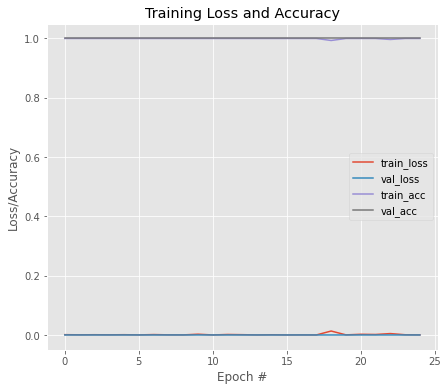


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 3.4016e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.00008, saving model to MobileNet_b_4.hdf5
10/10 [==============================] - 6s 233ms/step - loss: 3.4016e-04 - accuracy: 1.0000 - val_loss: 7.6276e-05 - val_accuracy: 1.0000
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 1.4179e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.00008
10/10 [==============================] - 2s 155ms/step - loss: 1.4179e-04 - accuracy: 1.0000 - val_loss: 7.6717e-05 - val_accuracy: 1.0000
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 0.9966
Epoch 3: val_loss improved from 0.00008 to 0.00008, saving model to MobileNet_b_4.hdf5
10/10 [==============================] - 2s 176ms/step - loss: 0.0051 - accuracy: 0.9966 - val_loss: 7.5496e-05 - val_accuracy: 1.0000
Epoch 4/50


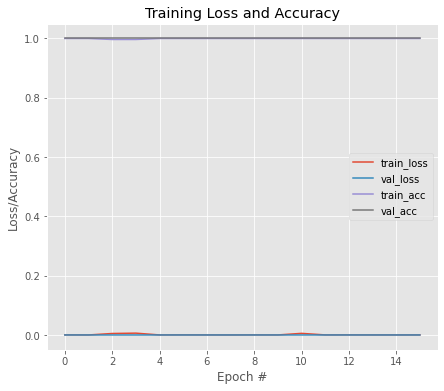


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9561643838882447
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/12 [==========================>...] - ETA: 0s - loss: 5.8094e-04 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.32010, saving model to MobileNet_wt.hdf5
12/12 [==============================] - 3s 113ms/step - loss: 5.8293e-04 - accuracy: 1.0000 - val_loss: 0.3201 - val_accuracy: 0.9011
Epoch 2/50
11/12 [==========================>...] - ETA: 0s - loss: 5.5709e-04 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.32010
12/12 [==============================] - 1s 48ms/step - loss: 5.6920e-04 - accuracy: 1.0000 - val_loss: 0.3206 - val_accuracy: 0.9011
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 5.5887e-04 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.32010
12/12 [==============================] - 1s 48ms/step - loss: 5.5887e-04 - accur

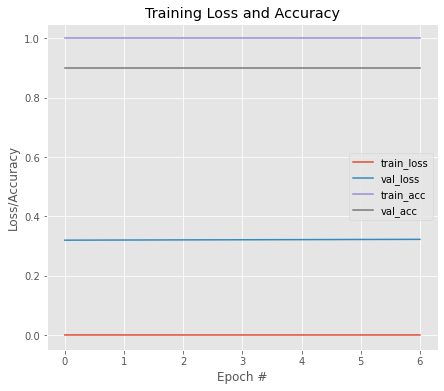


Model Performance Summary:

Best Validation accuracy:0.901098906993866 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.35771, saving model to MobileNet_wt.hdf5
12/12 [==============================] - 6s 226ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 0.3577 - val_accuracy: 0.9121
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 8.3317e-04 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.35771 to 0.33800, saving model to MobileNet_wt.hdf5
12/12 [==============================] - 2s 176ms/step - loss: 8.3317e-04 - accuracy: 1.0000 - val_loss: 0.3380 - val_accuracy: 0.9121
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.33800 to 0.31417, saving model to MobileNet_wt.hdf5
12/12 [==============================] - 2s 176ms/step - loss: 0

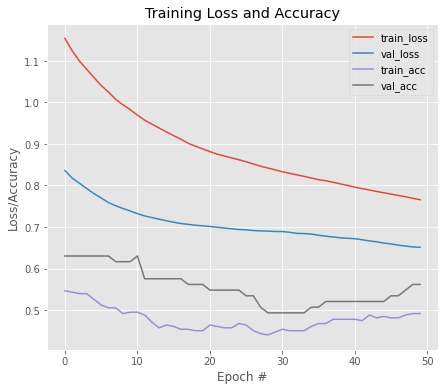


Model Performance Summary:

Best Validation accuracy:0.6301369667053223 at EPOCH:1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.6729 - accuracy: 0.6082
Epoch 1: val_loss improved from inf to 0.68442, saving model to MobileNetV2_b_0.hdf5
10/10 [==============================] - 10s 296ms/step - loss: 0.6729 - accuracy: 0.6082 - val_loss: 0.6844 - val_accuracy: 0.5342
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.4745 - accuracy: 0.7766
Epoch 2: val_loss did not improve from 0.68442
10/10 [==============================] - 2s 168ms/step - loss: 0.4745 - accuracy: 0.7766 - val_loss: 0.7025 - val_accuracy: 0.5890
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.4067 - accuracy: 0.8557
Epoch 3: val_loss did not improve from 0.68442
10/10 [==============================] - 2s 170ms/step - loss: 0.4067 - accuracy: 0.8557 - val_loss: 0.7279 - val_accuracy: 0.5753
Epoch 4/50
10/10 [==============================] - ETA: 0s -

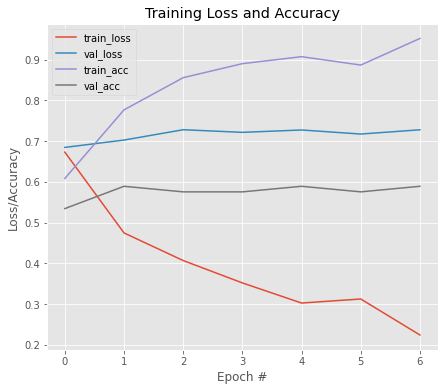


Model Performance Summary:

Best Validation accuracy:0.5890411138534546 at EPOCH:2
Starting fold 1
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.2665 - accuracy: 0.9175
Epoch 1: val_loss improved from inf to 0.75037, saving model to MobileNetV2_a_1.hdf5
10/10 [==============================] - 10s 287ms/step - loss: 0.2665 - accuracy: 0.9175 - val_loss: 0.7504 - val_accuracy: 0.5342
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.1985 - accuracy: 0.9588
Epoch 2: val_loss improved from 0.75037 to 0.74498, saving model to MobileNetV2_a_1.hdf5
10/10 [==============================] - 2s 206ms/step - loss: 0.1985 - accuracy: 0.9588 - val_loss: 0.7450 - val_accuracy: 0.5616
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.1926 - accuracy: 0.9485
Epoch 3: val_loss improved from 0.74498 to 0.71045, saving model to MobileNetV2_a_1.hdf5
10/10 [==============================] - 2s 205ms/step - loss: 0.1926 - accuracy: 0.9485 - v

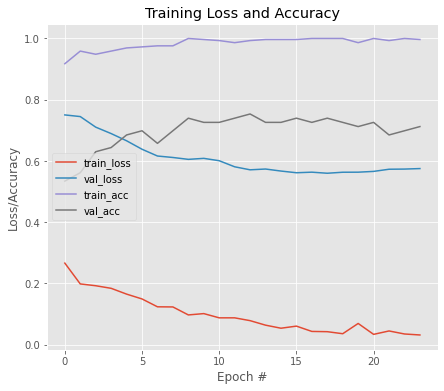


Model Performance Summary:

Best Validation accuracy:0.7534246444702148 at EPOCH:13
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0418 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.54363, saving model to MobileNetV2_b_1.hdf5
10/10 [==============================] - 10s 284ms/step - loss: 0.0418 - accuracy: 1.0000 - val_loss: 0.5436 - val_accuracy: 0.7397
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0469 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 0.54363
10/10 [==============================] - 2s 171ms/step - loss: 0.0469 - accuracy: 0.9931 - val_loss: 0.5536 - val_accuracy: 0.6986
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0254 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.54363
10/10 [==============================] - 2s 168ms/step - loss: 0.0254 - accuracy: 1.0000 - val_loss: 0.5555 - val_accuracy: 0.7123
Epoch 4/50
10/10 [==============================] - ETA: 0s 

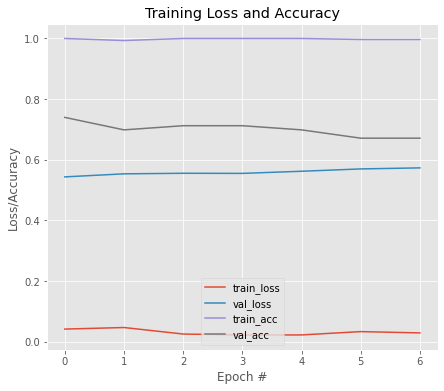


Model Performance Summary:

Best Validation accuracy:0.7397260069847107 at EPOCH:1
Starting fold 2
Epoch 1/50
 9/10 [==========================>...] - ETA: 0s - loss: 0.0597 - accuracy: 0.9826
Epoch 1: val_loss improved from inf to 0.59503, saving model to MobileNetV2_a_2.hdf5
10/10 [==============================] - 10s 284ms/step - loss: 0.0612 - accuracy: 0.9828 - val_loss: 0.5950 - val_accuracy: 0.7123
Epoch 2/50
 9/10 [==========================>...] - ETA: 0s - loss: 0.0352 - accuracy: 0.9931
Epoch 2: val_loss improved from 0.59503 to 0.57973, saving model to MobileNetV2_a_2.hdf5
10/10 [==============================] - 2s 202ms/step - loss: 0.0351 - accuracy: 0.9931 - val_loss: 0.5797 - val_accuracy: 0.7123
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0319 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.57973
10/10 [==============================] - 2s 183ms/step - loss: 0.0319 - accuracy: 1.0000 - val_loss: 0.5948 - val_accuracy: 0.7123
Epo

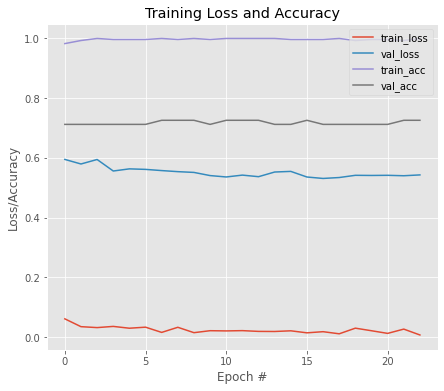


Model Performance Summary:

Best Validation accuracy:0.7260273694992065 at EPOCH:7
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.52722, saving model to MobileNetV2_b_2.hdf5
10/10 [==============================] - 10s 282ms/step - loss: 0.0079 - accuracy: 1.0000 - val_loss: 0.5272 - val_accuracy: 0.7534
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0080 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.52722
10/10 [==============================] - 2s 168ms/step - loss: 0.0080 - accuracy: 1.0000 - val_loss: 0.5313 - val_accuracy: 0.7671
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.52722
10/10 [==============================] - 2s 170ms/step - loss: 0.0100 - accuracy: 1.0000 - val_loss: 0.5352 - val_accuracy: 0.7534
Epoch 4/50
10/10 [==============================] - ETA: 0s -

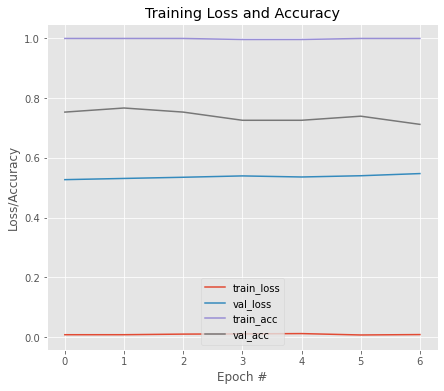


Model Performance Summary:

Best Validation accuracy:0.767123281955719 at EPOCH:2
Starting fold 3
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0090 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.59846, saving model to MobileNetV2_a_3.hdf5
10/10 [==============================] - 10s 290ms/step - loss: 0.0090 - accuracy: 1.0000 - val_loss: 0.5985 - val_accuracy: 0.6438
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0110 - accuracy: 0.9931
Epoch 2: val_loss did not improve from 0.59846
10/10 [==============================] - 2s 167ms/step - loss: 0.0110 - accuracy: 0.9931 - val_loss: 0.6081 - val_accuracy: 0.6849
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0104 - accuracy: 0.9966
Epoch 3: val_loss did not improve from 0.59846
10/10 [==============================] - 2s 165ms/step - loss: 0.0104 - accuracy: 0.9966 - val_loss: 0.6312 - val_accuracy: 0.6712
Epoch 4/50
10/10 [============================

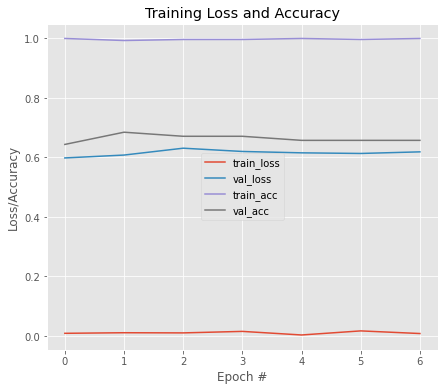


Model Performance Summary:

Best Validation accuracy:0.6849315166473389 at EPOCH:2
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0098 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.60343, saving model to MobileNetV2_b_3.hdf5
10/10 [==============================] - 10s 288ms/step - loss: 0.0098 - accuracy: 0.9966 - val_loss: 0.6034 - val_accuracy: 0.6849
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0229 - accuracy: 0.9931
Epoch 2: val_loss improved from 0.60343 to 0.60022, saving model to MobileNetV2_b_3.hdf5
10/10 [==============================] - 2s 202ms/step - loss: 0.0229 - accuracy: 0.9931 - val_loss: 0.6002 - val_accuracy: 0.6712
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.60022
10/10 [==============================] - 2s 168ms/step - loss: 0.0050 - accuracy: 1.0000 - val_loss: 0.6069 - val_accuracy: 0.6575
Epoch 4/50
10/10 [=

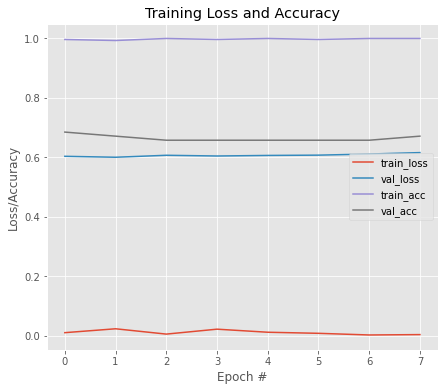


Model Performance Summary:

Best Validation accuracy:0.6849315166473389 at EPOCH:1
Starting fold 4
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0146 - accuracy: 0.9932
Epoch 1: val_loss improved from inf to 0.65891, saving model to MobileNetV2_a_4.hdf5
10/10 [==============================] - 10s 311ms/step - loss: 0.0146 - accuracy: 0.9932 - val_loss: 0.6589 - val_accuracy: 0.6806
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0063 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.65891
10/10 [==============================] - 2s 169ms/step - loss: 0.0063 - accuracy: 1.0000 - val_loss: 0.6632 - val_accuracy: 0.6806
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.65891 to 0.65458, saving model to MobileNetV2_a_4.hdf5
10/10 [==============================] - 2s 207ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 0.6546 - val_accuracy: 0.6944
Epo

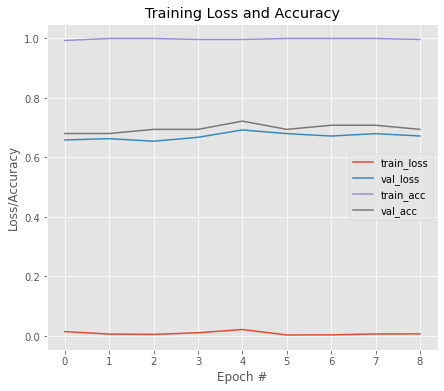


Model Performance Summary:

Best Validation accuracy:0.7222222089767456 at EPOCH:5
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0075 - accuracy: 0.9966
Epoch 1: val_loss improved from inf to 0.66059, saving model to MobileNetV2_b_4.hdf5
10/10 [==============================] - 10s 285ms/step - loss: 0.0075 - accuracy: 0.9966 - val_loss: 0.6606 - val_accuracy: 0.6250
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000
Epoch 2: val_loss improved from 0.66059 to 0.65948, saving model to MobileNetV2_b_4.hdf5
10/10 [==============================] - 2s 204ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.6595 - val_accuracy: 0.6389
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.65948
10/10 [==============================] - 2s 169ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.6679 - val_accuracy: 0.6111
Epoch 4/50
10/10 [=

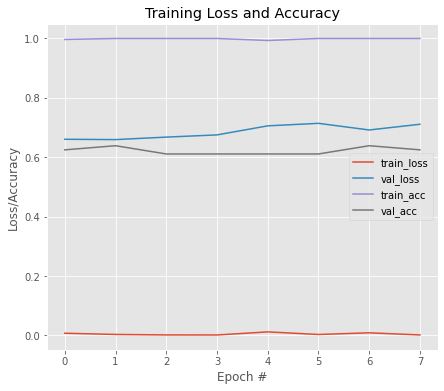


Model Performance Summary:

Best Validation accuracy:0.6388888955116272 at EPOCH:2
Average Accuracy:0.6839421629905701
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.5798 - accuracy: 0.7033
Epoch 1: val_loss improved from inf to 0.61186, saving model to MobileNetV2_wt.hdf5
12/12 [==============================] - 4s 150ms/step - loss: 0.5798 - accuracy: 0.7033 - val_loss: 0.6119 - val_accuracy: 0.6923
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.5774 - accuracy: 0.7088
Epoch 2: val_loss improved from 0.61186 to 0.61079, saving model to MobileNetV2_wt.hdf5
12/12 [==============================] - 1s 73ms/step - loss: 0.5774 - accuracy: 0.7088 - val_loss: 0.6108 - val_accuracy: 0.6923
Epoch 3/50
11/12 [==========================>...] - ETA: 0s - loss: 0.5619 - accuracy: 0.7169
Epoch 3: val_loss improved from 0.61079 to 0.60992, saving model to MobileNetV2_wt.hdf5
1

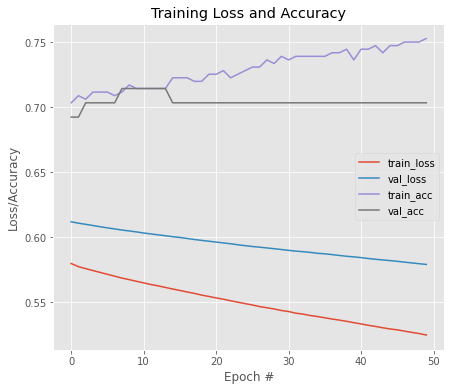


Model Performance Summary:

Best Validation accuracy:0.7142857313156128 at EPOCH:8
 Training Model with pretraned layer trainable
Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 0.0120 - accuracy: 0.9973
Epoch 1: val_loss improved from inf to 0.59062, saving model to MobileNetV2_wt.hdf5
12/12 [==============================] - 10s 283ms/step - loss: 0.0120 - accuracy: 0.9973 - val_loss: 0.5906 - val_accuracy: 0.6923
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.0080 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.59062
12/12 [==============================] - 2s 175ms/step - loss: 0.0080 - accuracy: 1.0000 - val_loss: 0.6106 - val_accuracy: 0.7143
Epoch 3/50
12/12 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_loss improved from 0.59062 to 0.57963, saving model to MobileNetV2_wt.hdf5
12/12 [==============================] - 2s 203ms/step - loss: 0.0040 - accuracy: 1.0000 - val_loss: 0.57

In [ ]:
for model in MODEL_LIST_3:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(tranx3,trainy3,testx3,testy3,data_aug=False,dataset = 'RIM-ONE_v2')
  gc.collect()

In [ ]:
gc.collect()

88

PLots

,Model,Accuracy,Sensitivity,AUC
0,xception_A_True_RIM-ONE_dl,0.897260,0.946809,0.877250
1,InceptionResNetV2_A_True_RIM-ONE_dl,0.883562,0.925532,0.866612
2,InceptionV3_A_True_RIM-ONE_dl,0.917808,0.914894,0.918985
3,vgg16_A_True_RIM-ONE_dl,0.917808,0.936170,0.910393
4,vgg19_A_True_RIM-ONE_dl,0.910959,0.957447,0.892185
5,resnet50_A_True_RIM-ONE_dl,0.643836,1.000000,0.500000
6,DenseNet121_A_True_RIM-ONE_dl,0.958904,0.957447,0.959493
7,MobileNet_A_True_RIM-ONE_dl,0.904110,0.925532,0.895458
8,MobileNetV2_A_True_RIM-ONE_dl,0.767123,0.829787,0.741817


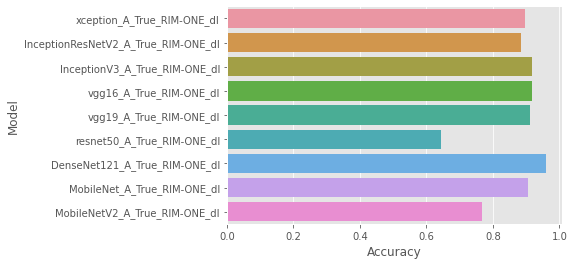

\begin{tabular}{lrrr}
\toprule
                              Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
         xception\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.946809 & 0.877250 \\
InceptionResNetV2\_A\_True\_RIM-ONE\_dl &  0.883562 &     0.925532 & 0.866612 \\
      InceptionV3\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.914894 & 0.918985 \\
            vgg16\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.936170 & 0.910393 \\
            vgg19\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.957447 & 0.892185 \\
         resnet50\_A\_True\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_True\_RIM-ONE\_dl &  0.958904 &     0.957447 & 0.959493 \\
        MobileNet\_A\_True\_RIM-ONE\_dl &  0.904110 &     0.925532 & 0.895458 \\
      MobileNetV2\_A\_True\_RIM-ONE\_dl &  0.767123 &     0.829787 & 0.741817 \\
\bottomrule
\end{tabular}



In [ ]:
plot_performance('True_RIM-ONE_dl')

,Model,Accuracy,Sensitivity,AUC
9,InceptionV3_A_False_RIM-ONE_dl,0.849315,0.872340,0.840016
10,vgg16_A_False_RIM-ONE_dl,0.883562,0.925532,0.866612
11,vgg19_A_False_RIM-ONE_dl,0.856164,0.925532,0.828151
12,resnet50_A_False_RIM-ONE_dl,0.643836,1.000000,0.500000
13,DenseNet121_A_False_RIM-ONE_dl,0.883562,0.904255,0.875205
14,MobileNet_A_False_RIM-ONE_dl,0.876712,0.882979,0.874182
15,MobileNetV2_A_False_RIM-ONE_dl,0.753425,0.819149,0.726882
16,xception_A_False_RIM-ONE_dl,0.849315,0.925532,0.818535
17,InceptionResNetV2_A_False_RIM-ONE_dl,0.828767,0.882979,0.806874


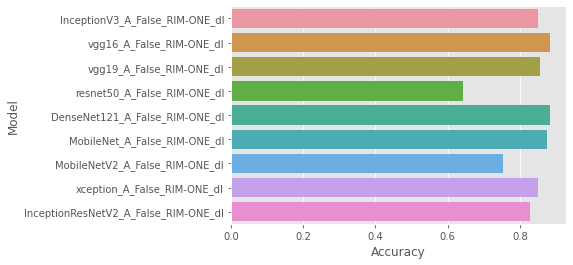

\begin{tabular}{lrrr}
\toprule
                               Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
      InceptionV3\_A\_False\_RIM-ONE\_dl &  0.849315 &     0.872340 & 0.840016 \\
            vgg16\_A\_False\_RIM-ONE\_dl &  0.883562 &     0.925532 & 0.866612 \\
            vgg19\_A\_False\_RIM-ONE\_dl &  0.856164 &     0.925532 & 0.828151 \\
         resnet50\_A\_False\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_False\_RIM-ONE\_dl &  0.883562 &     0.904255 & 0.875205 \\
        MobileNet\_A\_False\_RIM-ONE\_dl &  0.876712 &     0.882979 & 0.874182 \\
      MobileNetV2\_A\_False\_RIM-ONE\_dl &  0.753425 &     0.819149 & 0.726882 \\
         xception\_A\_False\_RIM-ONE\_dl &  0.849315 &     0.925532 & 0.818535 \\
InceptionResNetV2\_A\_False\_RIM-ONE\_dl &  0.828767 &     0.882979 & 0.806874 \\
\bottomrule
\end{tabular}



In [ ]:
plot_performance('False_RIM-ONE_dl')

,Model,Accuracy,Sensitivity,AUC
18,xception_A_False_ACRIMA,0.971631,0.982759,0.973307
19,InceptionResNetV2_A_False_ACRIMA,0.971631,0.982759,0.973307
20,InceptionV3_A_False_ACRIMA,0.985816,0.982759,0.985355
21,vgg16_A_False_ACRIMA,0.971631,0.982759,0.973307
22,vgg19_A_False_ACRIMA,0.950355,0.948276,0.950042
23,resnet50_A_False_ACRIMA,0.765957,0.551724,0.733693
24,DenseNet121_A_False_ACRIMA,1.000000,1.000000,1.000000
25,MobileNet_A_False_ACRIMA,0.978723,0.982759,0.979331
26,MobileNetV2_A_False_ACRIMA,0.659574,0.172414,0.586207


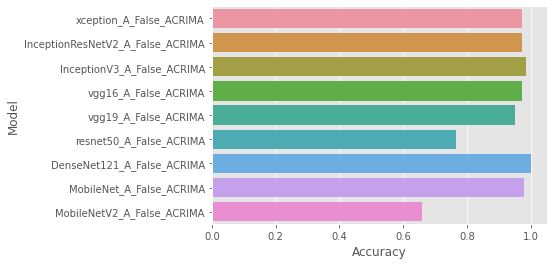

\begin{tabular}{lrrr}
\toprule
                           Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
         xception\_A\_False\_ACRIMA &  0.971631 &     0.982759 & 0.973307 \\
InceptionResNetV2\_A\_False\_ACRIMA &  0.971631 &     0.982759 & 0.973307 \\
      InceptionV3\_A\_False\_ACRIMA &  0.985816 &     0.982759 & 0.985355 \\
            vgg16\_A\_False\_ACRIMA &  0.971631 &     0.982759 & 0.973307 \\
            vgg19\_A\_False\_ACRIMA &  0.950355 &     0.948276 & 0.950042 \\
         resnet50\_A\_False\_ACRIMA &  0.765957 &     0.551724 & 0.733693 \\
      DenseNet121\_A\_False\_ACRIMA &  1.000000 &     1.000000 & 1.000000 \\
        MobileNet\_A\_False\_ACRIMA &  0.978723 &     0.982759 & 0.979331 \\
      MobileNetV2\_A\_False\_ACRIMA &  0.659574 &     0.172414 & 0.586207 \\
\bottomrule
\end{tabular}



In [ ]:
plot_performance('ACRIMA')

,Model,Accuracy,Sensitivity,AUC
27,InceptionV3_A_False_RIM-ONE_v2,0.868132,0.829268,0.864634
28,vgg16_A_False_RIM-ONE_v2,0.912088,0.853659,0.906829
29,vgg19_A_False_RIM-ONE_v2,0.901099,0.878049,0.899024
30,resnet50_A_False_RIM-ONE_v2,0.450549,1.000000,0.500000
31,DenseNet121_A_False_RIM-ONE_v2,0.868132,0.878049,0.869024
32,xception_A_False_RIM-ONE_v2,0.923077,0.902439,0.921220
33,InceptionResNetV2_A_False_RIM-ONE_v2,0.890110,0.829268,0.884634
34,MobileNet_A_False_RIM-ONE_v2,0.912088,0.926829,0.913415
35,MobileNetV2_A_False_RIM-ONE_v2,0.714286,0.609756,0.704878


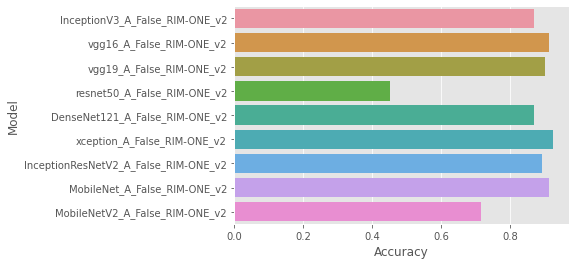

\begin{tabular}{lrrr}
\toprule
                               Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
      InceptionV3\_A\_False\_RIM-ONE\_v2 &  0.868132 &     0.829268 & 0.864634 \\
            vgg16\_A\_False\_RIM-ONE\_v2 &  0.912088 &     0.853659 & 0.906829 \\
            vgg19\_A\_False\_RIM-ONE\_v2 &  0.901099 &     0.878049 & 0.899024 \\
         resnet50\_A\_False\_RIM-ONE\_v2 &  0.450549 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_False\_RIM-ONE\_v2 &  0.868132 &     0.878049 & 0.869024 \\
         xception\_A\_False\_RIM-ONE\_v2 &  0.923077 &     0.902439 & 0.921220 \\
InceptionResNetV2\_A\_False\_RIM-ONE\_v2 &  0.890110 &     0.829268 & 0.884634 \\
        MobileNet\_A\_False\_RIM-ONE\_v2 &  0.912088 &     0.926829 & 0.913415 \\
      MobileNetV2\_A\_False\_RIM-ONE\_v2 &  0.714286 &     0.609756 & 0.704878 \\
\bottomrule
\end{tabular}



In [ ]:
plot_performance('RIM-ONE_v2')

# PLOT PERFORMANCE

,Model,Accuracy,Sensitivity,AUC
0,vgg16,0.938356,0.989362,0.917758
1,vgg19,0.924658,0.936170,0.920008
2,resnet50,0.643836,1.000000,0.500000
3,DenseNet121,0.931507,0.914894,0.938216
4,MobileNet,0.938356,0.936170,0.939239
5,InceptionV3,0.890411,0.957447,0.863339
6,InceptionResNetV2,0.904110,0.925532,0.895458
7,MobileNetV2,0.773973,0.925532,0.712766
8,xception,0.917808,0.957447,0.901800


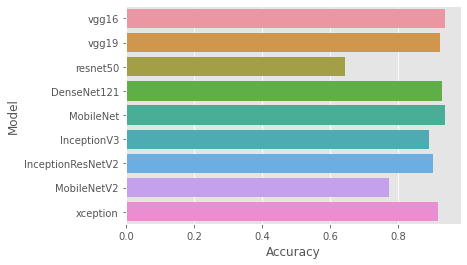

In [ ]:
plot_overall_performance()

# Without Data Augmentation

In [ ]:
MODEL_LIST = ['vgg16','vgg19','resnet50','DenseNet121','MobileNet','MobileNetV2','InceptionV3','InceptionResNetV2','xception']

58900480/58889256 [==============================] - 1s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 2)                 1026      
                                                                 
Total params: 14,715,714
Trainable params: 1,026
Non-trainable params: 14,714,688
_________________________________________________________________
None
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7484 - accuracy: 0.3542
Epoch 1: val_accuracy improved from -inf to 0.35294, saving model

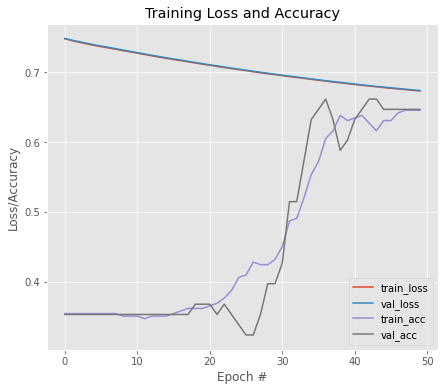


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:37
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6448 - accuracy: 0.6568
Epoch 1: val_accuracy improved from -inf to 0.70588, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 6s 362ms/step - loss: 0.6448 - accuracy: 0.6568 - val_loss: 0.6116 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5896 - accuracy: 0.6937
Epoch 2: val_accuracy improved from 0.70588 to 0.77941, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 2s 270ms/step - loss: 0.5896 - accuracy: 0.6937 - val_loss: 0.5907 - val_accuracy: 0.7794
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5687 - accuracy: 0.7343
Epoch 3: val_accuracy did not improve from 0.77941
9/9 [==============================] - 2s 233ms/step - loss: 0.5687 - accuracy: 0.7343 - val_loss: 0.5366 - val_accuracy: 0.7353
Epoch 4/50
9/9 [==============

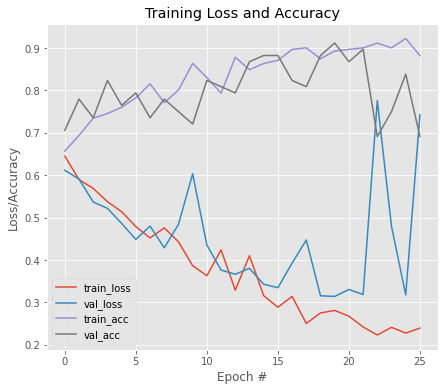


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:20
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3574 - accuracy: 0.8487
Epoch 1: val_accuracy improved from -inf to 0.97059, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 4s 280ms/step - loss: 0.3574 - accuracy: 0.8487 - val_loss: 0.1522 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2660 - accuracy: 0.9225
Epoch 2: val_accuracy did not improve from 0.97059
9/9 [==============================] - 2s 235ms/step - loss: 0.2660 - accuracy: 0.9225 - val_loss: 0.1215 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2852 - accuracy: 0.8782
Epoch 3: val_accuracy did not improve from 0.97059
9/9 [==============================] - 2s 234ms/step - loss: 0.2852 - accuracy: 0.8782 - val_loss: 0.1293 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] - 

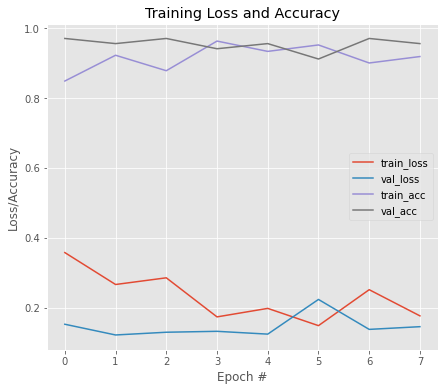


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3902 - accuracy: 0.9225
Epoch 1: val_accuracy improved from -inf to 0.97059, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 4s 282ms/step - loss: 0.3902 - accuracy: 0.9225 - val_loss: 0.1282 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1989 - accuracy: 0.9299
Epoch 2: val_accuracy did not improve from 0.97059
9/9 [==============================] - 2s 234ms/step - loss: 0.1989 - accuracy: 0.9299 - val_loss: 0.1952 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2192 - accuracy: 0.9114
Epoch 3: val_accuracy did not improve from 0.97059
9/9 [==============================] - 2s 233ms/step - loss: 0.2192 - accuracy: 0.9114 - val_loss: 0.1380 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.

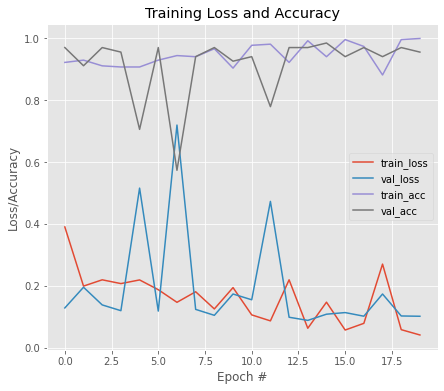


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:15
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4554 - accuracy: 0.9114
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 4s 283ms/step - loss: 0.4554 - accuracy: 0.9114 - val_loss: 0.0647 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0439 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 235ms/step - loss: 0.0439 - accuracy: 0.9963 - val_loss: 0.0570 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1140 - accuracy: 0.9557
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 234ms/step - loss: 0.1140 - accuracy: 0.9557 - val_loss: 0.5339 - val_accuracy: 0.6912
Epoch 4/50
9/9 [==============================] - 

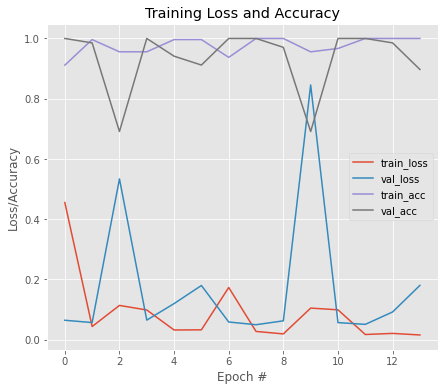


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4965 - accuracy: 0.9410
Epoch 1: val_accuracy improved from -inf to 0.98529, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 4s 282ms/step - loss: 0.4965 - accuracy: 0.9410 - val_loss: 0.0651 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0370 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 0.98529
9/9 [==============================] - 2s 234ms/step - loss: 0.0370 - accuracy: 0.9963 - val_loss: 0.0531 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0337 - accuracy: 0.9963
Epoch 3: val_accuracy improved from 0.98529 to 1.00000, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 2s 267ms/step - loss: 0.0337 - accuracy: 0.9963 - val_loss: 0.0577 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================

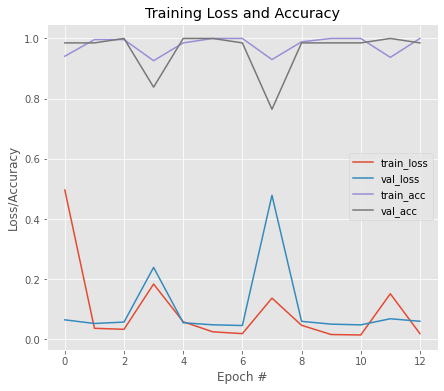


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3444 - accuracy: 0.9631
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 4s 281ms/step - loss: 0.3444 - accuracy: 0.9631 - val_loss: 0.0140 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0251 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 235ms/step - loss: 0.0251 - accuracy: 0.9963 - val_loss: 0.0277 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0247 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 234ms/step - loss: 0.0247 - accuracy: 1.0000 - val_loss: 0.0107 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

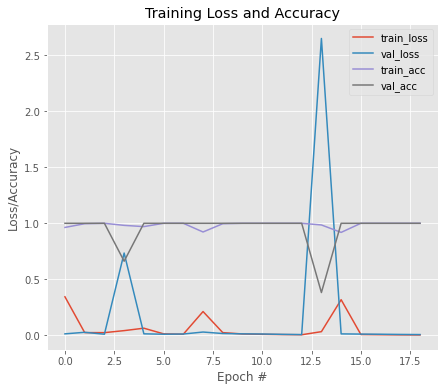


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6176 - accuracy: 0.8856
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 4s 282ms/step - loss: 0.6176 - accuracy: 0.8856 - val_loss: 0.0274 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0288 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 234ms/step - loss: 0.0288 - accuracy: 0.9963 - val_loss: 0.0191 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0226 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 233ms/step - loss: 0.0226 - accuracy: 0.9963 - val_loss: 0.0214 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0188 - accurac

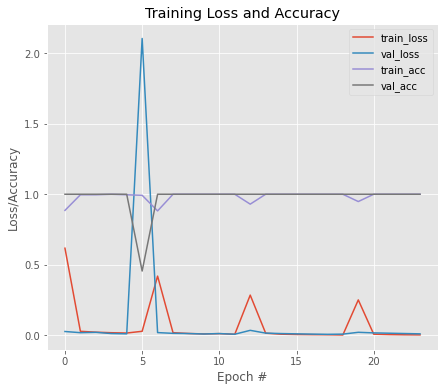


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5585 - accuracy: 0.9338
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 5s 430ms/step - loss: 0.5585 - accuracy: 0.9338 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 246ms/step - loss: 0.0094 - accuracy: 1.0000 - val_loss: 0.0034 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 235ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

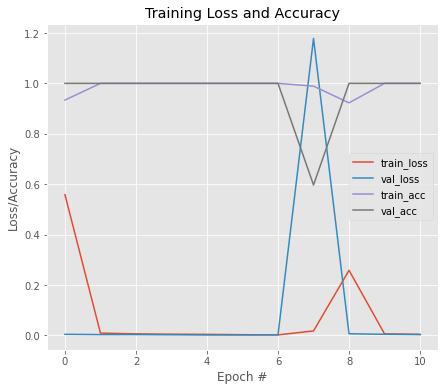


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3169 - accuracy: 0.9154
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 4s 281ms/step - loss: 0.3169 - accuracy: 0.9154 - val_loss: 0.0051 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 234ms/step - loss: 0.0094 - accuracy: 1.0000 - val_loss: 0.0038 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 233ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0044 - accurac

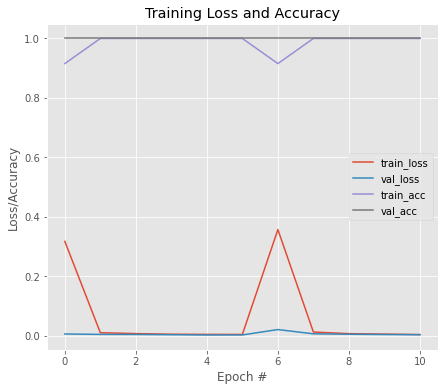


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9794117569923401
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0379 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.85616, saving model to vgg16_wt.hdf5
11/11 [==============================] - 3s 241ms/step - loss: 0.0379 - accuracy: 1.0000 - val_loss: 0.3131 - val_accuracy: 0.8562
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0368 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.85616 to 0.86301, saving model to vgg16_wt.hdf5
11/11 [==============================] - 1s 133ms/step - loss: 0.0368 - accuracy: 1.0000 - val_loss: 0.3100 - val_accuracy: 0.8630
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0361 - accuracy: 1.0000
Epoch 3: val_accuracy improved from 0.86301 to 0.86986, saving model to vgg16_wt.hdf5
11/11 [=============

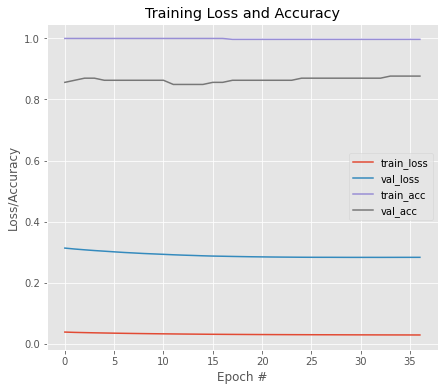


Model Performance Summary:

Best Validation accuracy:0.8767123222351074 at EPOCH:34
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.6829 - accuracy: 0.8643
Epoch 1: val_accuracy improved from -inf to 0.84247, saving model to vgg16_wt.hdf5
11/11 [==============================] - 5s 377ms/step - loss: 0.6829 - accuracy: 0.8643 - val_loss: 0.3431 - val_accuracy: 0.8425
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1382 - accuracy: 0.9587
Epoch 2: val_accuracy improved from 0.84247 to 0.86301, saving model to vgg16_wt.hdf5
11/11 [==============================] - 3s 281ms/step - loss: 0.1382 - accuracy: 0.9587 - val_loss: 0.3147 - val_accuracy: 0.8630
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.4145 - accuracy: 0.8761
Epoch 3: val_accuracy improved from 0.86301 to 0.87671, saving model to vgg16_wt.hdf5
11/11 [==============================] - 3s 284ms/step - loss: 0.4145

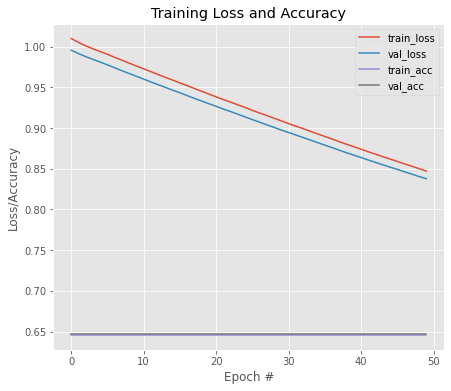


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7048 - accuracy: 0.6531
Epoch 1: val_accuracy improved from -inf to 0.64706, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 4s 332ms/step - loss: 0.7048 - accuracy: 0.6531 - val_loss: 0.6266 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6364 - accuracy: 0.6421
Epoch 2: val_accuracy improved from 0.64706 to 0.66176, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 3s 316ms/step - loss: 0.6364 - accuracy: 0.6421 - val_loss: 0.6045 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6124 - accuracy: 0.6716
Epoch 3: val_accuracy did not improve from 0.66176
9/9 [==============================] - 2s 274ms/step - loss: 0.6124 - accuracy: 0.6716 - val_loss: 0.5914 - val_accuracy: 0.6618
Epoch 4/50
9/9 [===============

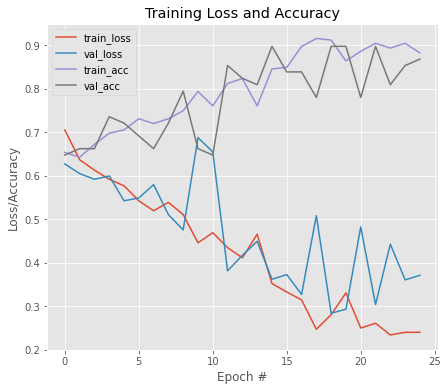


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:15
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5366 - accuracy: 0.8450
Epoch 1: val_accuracy improved from -inf to 0.92647, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 5s 350ms/step - loss: 0.5366 - accuracy: 0.8450 - val_loss: 0.1512 - val_accuracy: 0.9265
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1899 - accuracy: 0.9373
Epoch 2: val_accuracy improved from 0.92647 to 0.95588, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 3s 320ms/step - loss: 0.1899 - accuracy: 0.9373 - val_loss: 0.1273 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3184 - accuracy: 0.8893
Epoch 3: val_accuracy improved from 0.95588 to 0.97059, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 3s 318ms/step - loss: 0.3184 - accuracy: 0.8893 - val_loss: 0.1060 -

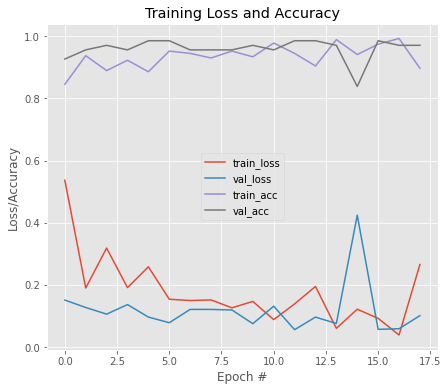


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:5
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3675 - accuracy: 0.8930
Epoch 1: val_accuracy improved from -inf to 0.95588, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 5s 332ms/step - loss: 0.3675 - accuracy: 0.8930 - val_loss: 0.1091 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1939 - accuracy: 0.9225
Epoch 2: val_accuracy did not improve from 0.95588
9/9 [==============================] - 2s 275ms/step - loss: 0.1939 - accuracy: 0.9225 - val_loss: 0.2561 - val_accuracy: 0.8971
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1272 - accuracy: 0.9594
Epoch 3: val_accuracy did not improve from 0.95588
9/9 [==============================] - 2s 275ms/step - loss: 0.1272 - accuracy: 0.9594 - val_loss: 0.0836 - val_accuracy: 0.9559
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0

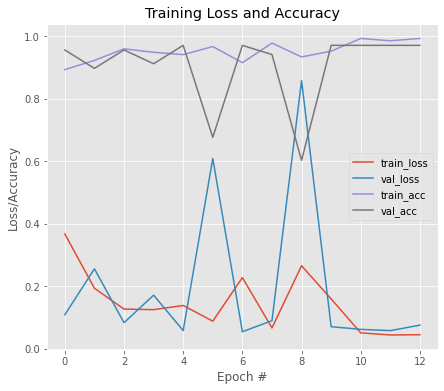


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:5
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6302 - accuracy: 0.9410
Epoch 1: val_accuracy improved from -inf to 0.97059, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 4s 332ms/step - loss: 0.6302 - accuracy: 0.9410 - val_loss: 0.0710 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0451 - accuracy: 0.9815
Epoch 2: val_accuracy improved from 0.97059 to 0.98529, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 3s 317ms/step - loss: 0.0451 - accuracy: 0.9815 - val_loss: 0.0603 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0349 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 0.98529
9/9 [==============================] - 2s 275ms/step - loss: 0.0349 - accuracy: 0.9963 - val_loss: 0.0721 - val_accuracy: 0.9706
Epoch 4/50
9/9 [

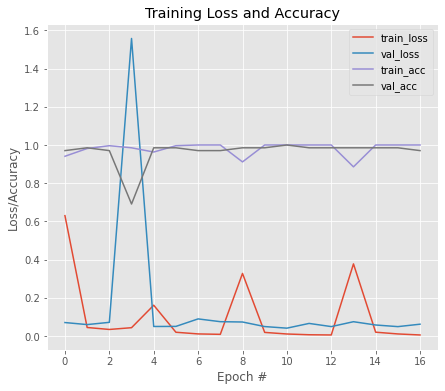


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:11
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4436 - accuracy: 0.9262
Epoch 1: val_accuracy improved from -inf to 0.97059, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 4s 332ms/step - loss: 0.4436 - accuracy: 0.9262 - val_loss: 0.1102 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0225 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.97059 to 0.98529, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 3s 321ms/step - loss: 0.0225 - accuracy: 1.0000 - val_loss: 0.0808 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0124 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.98529
9/9 [==============================] - 2s 273ms/step - loss: 0.0124 - accuracy: 1.0000 - val_loss: 0.0684 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=============================

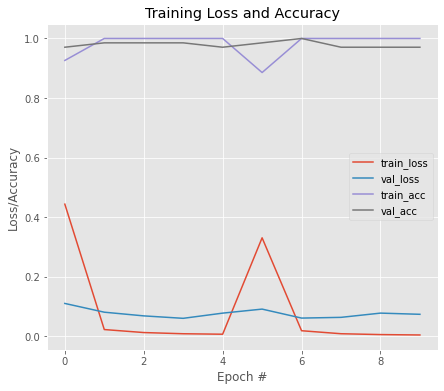


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:7
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3039 - accuracy: 0.9114
Epoch 1: val_accuracy improved from -inf to 0.98529, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 4s 330ms/step - loss: 0.3039 - accuracy: 0.9114 - val_loss: 0.0315 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0230 - accuracy: 0.9963
Epoch 2: val_accuracy improved from 0.98529 to 1.00000, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 3s 318ms/step - loss: 0.0230 - accuracy: 0.9963 - val_loss: 0.0142 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0267 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 288ms/step - loss: 0.0267 - accuracy: 0.9963 - val_loss: 0.0194 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============

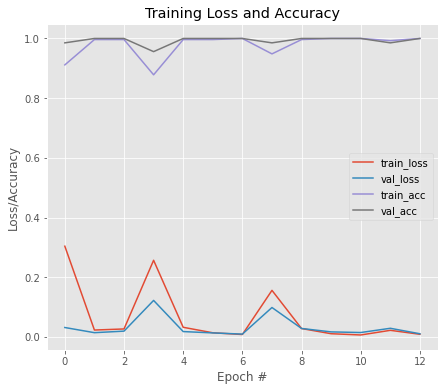


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5946 - accuracy: 0.9041
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 4s 349ms/step - loss: 0.5946 - accuracy: 0.9041 - val_loss: 0.0252 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0170 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 292ms/step - loss: 0.0170 - accuracy: 0.9963 - val_loss: 0.0137 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0124 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 272ms/step - loss: 0.0124 - accuracy: 0.9963 - val_loss: 0.0088 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0115 - accurac

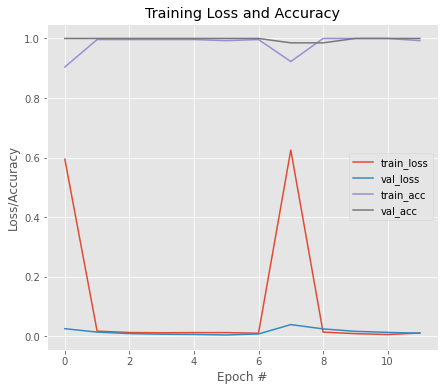


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8484 - accuracy: 0.8860
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 4s 332ms/step - loss: 0.8484 - accuracy: 0.8860 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0104 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 273ms/step - loss: 0.0104 - accuracy: 1.0000 - val_loss: 0.0027 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 274ms/step - loss: 0.0073 - accuracy: 1.0000 - val_loss: 0.0023 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

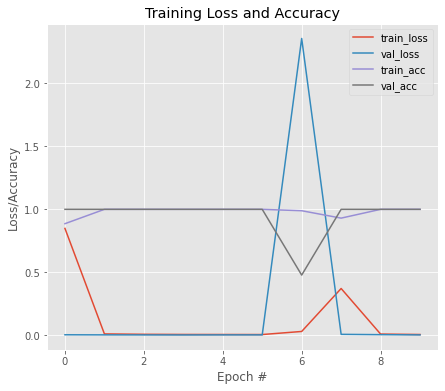


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1930 - accuracy: 0.9522
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 4s 329ms/step - loss: 0.1930 - accuracy: 0.9522 - val_loss: 0.0064 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0106 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 275ms/step - loss: 0.0106 - accuracy: 1.0000 - val_loss: 0.0046 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 290ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0062 - accurac

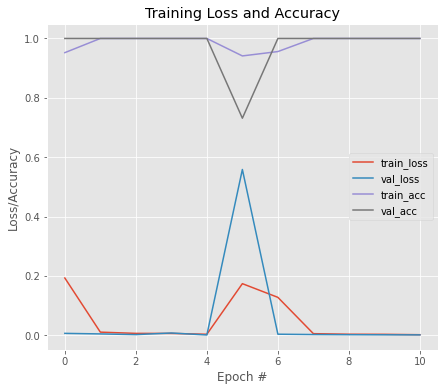


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9735294103622436
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0200 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.88356, saving model to vgg19_wt.hdf5
11/11 [==============================] - 2s 171ms/step - loss: 0.0200 - accuracy: 1.0000 - val_loss: 0.2774 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0198 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.88356
11/11 [==============================] - 2s 138ms/step - loss: 0.0198 - accuracy: 1.0000 - val_loss: 0.2768 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0197 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.88356
11/11 [==============================] - 1s 137ms/step - loss: 0.0197 - accuracy: 1.0000 -

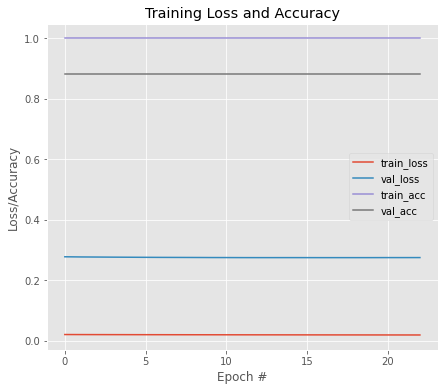


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.2236 - accuracy: 0.6637
Epoch 1: val_accuracy improved from -inf to 0.76027, saving model to vgg19_wt.hdf5
11/11 [==============================] - 5s 356ms/step - loss: 1.2236 - accuracy: 0.6637 - val_loss: 0.4633 - val_accuracy: 0.7603
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.4126 - accuracy: 0.8230
Epoch 2: val_accuracy improved from 0.76027 to 0.85616, saving model to vgg19_wt.hdf5
11/11 [==============================] - 4s 344ms/step - loss: 0.4126 - accuracy: 0.8230 - val_loss: 0.3054 - val_accuracy: 0.8562
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.3898 - accuracy: 0.8083
Epoch 3: val_accuracy did not improve from 0.85616
11/11 [==============================] - 3s 300ms/step - loss: 0.3898 - accuracy: 0.8083 - val_loss: 0.40

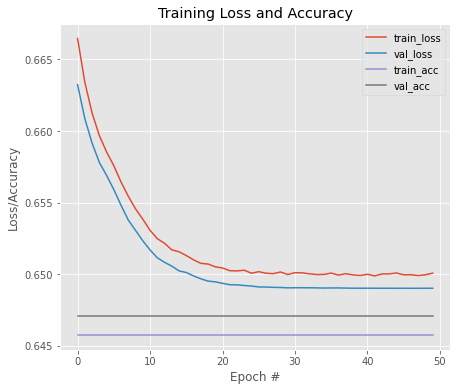


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6169 - accuracy: 0.6642
Epoch 1: val_accuracy improved from -inf to 0.64706, saving model to resnet50_b_0.hdf5
9/9 [==============================] - 15s 439ms/step - loss: 0.6169 - accuracy: 0.6642 - val_loss: 0.6507 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2957 - accuracy: 0.9114
Epoch 2: val_accuracy did not improve from 0.64706
9/9 [==============================] - 2s 198ms/step - loss: 0.2957 - accuracy: 0.9114 - val_loss: 0.6520 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1979 - accuracy: 0.9852
Epoch 3: val_accuracy did not improve from 0.64706
9/9 [==============================] - 2s 197ms/step - loss: 0.1979 - accuracy: 0.9852 - val_loss: 0.6555 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s - los

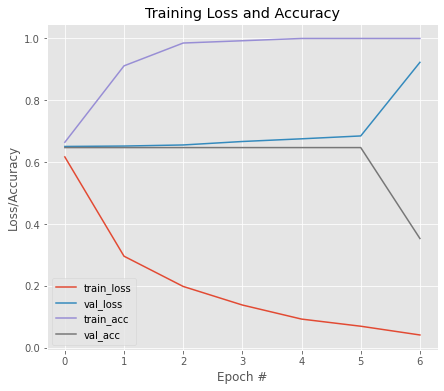


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0905 - accuracy: 0.9668
Epoch 1: val_accuracy improved from -inf to 0.29412, saving model to resnet50_a_1.hdf5
9/9 [==============================] - 13s 382ms/step - loss: 0.0905 - accuracy: 0.9668 - val_loss: 1.3292 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0406 - accuracy: 0.9926
Epoch 2: val_accuracy did not improve from 0.29412
9/9 [==============================] - 2s 198ms/step - loss: 0.0406 - accuracy: 0.9926 - val_loss: 1.9720 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0202 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.29412
9/9 [==============================] - 2s 197ms/step - loss: 0.0202 - accuracy: 1.0000 - val_loss: 2.3014 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================]

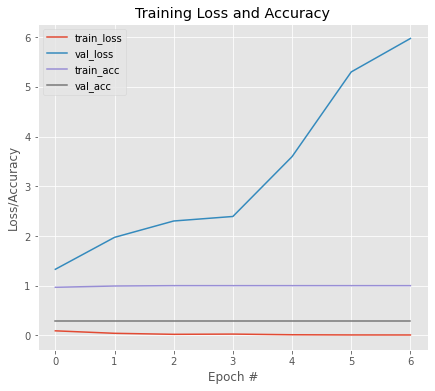


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0335 - accuracy: 0.9963
Epoch 1: val_accuracy improved from -inf to 0.29412, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 13s 386ms/step - loss: 0.0335 - accuracy: 0.9963 - val_loss: 1.9127 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0130 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.29412
9/9 [==============================] - 2s 198ms/step - loss: 0.0130 - accuracy: 1.0000 - val_loss: 2.7047 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.29412
9/9 [==============================] - 2s 199ms/step - loss: 0.0100 - accuracy: 1.0000 - val_loss: 2.9806 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================] - ETA: 0s - lo

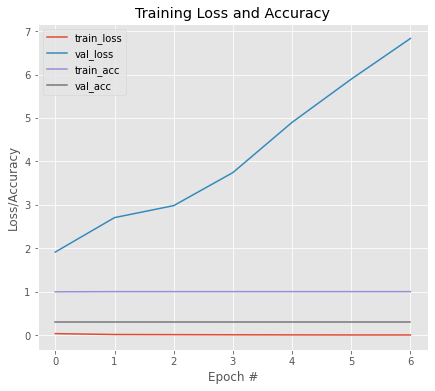


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0149 - accuracy: 0.9963
Epoch 1: val_accuracy improved from -inf to 0.38235, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 13s 389ms/step - loss: 0.0149 - accuracy: 0.9963 - val_loss: 5.8619 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.38235
9/9 [==============================] - 2s 196ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 6.4693 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.38235
9/9 [==============================] - 2s 199ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 7.0542 - val_accuracy: 0.3824
Epoch 4/50
9/9 [==============================

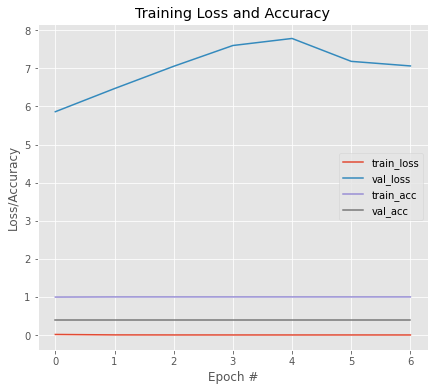


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.38235, saving model to resnet50_b_2.hdf5
9/9 [==============================] - 13s 380ms/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 7.8887 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 8.6072e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.38235
9/9 [==============================] - 2s 197ms/step - loss: 8.6072e-04 - accuracy: 1.0000 - val_loss: 7.9177 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.38235
9/9 [==============================] - 2s 199ms/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 7.7529 - val_accuracy: 0.3824
Epoch 4/50
9/9 [==============================] - ETA:

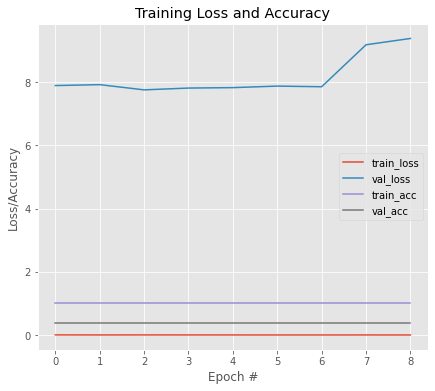


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.8052e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.36765, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 12s 376ms/step - loss: 5.8052e-04 - accuracy: 1.0000 - val_loss: 8.7786 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0018 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.36765
9/9 [==============================] - 2s 196ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 9.5666 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 8.2590e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.36765
9/9 [==============================] - 2s 198ms/step - loss: 8.2590e-04 - accuracy: 1.0000 - val_loss: 9.2238 - val_accuracy: 0.3676
Epoch 4/50
9/9 [==============

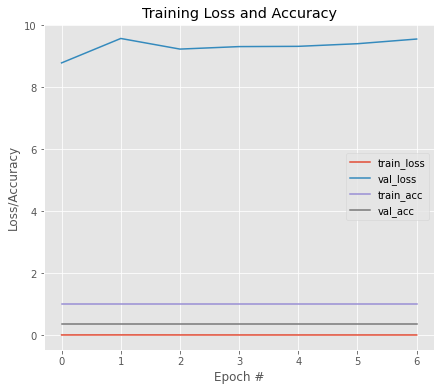


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.7756e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.36765, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 14s 452ms/step - loss: 1.7756e-04 - accuracy: 1.0000 - val_loss: 9.6233 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.8967e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.36765
9/9 [==============================] - 2s 199ms/step - loss: 6.8967e-05 - accuracy: 1.0000 - val_loss: 9.5746 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 4.3573e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.36765
9/9 [==============================] - 2s 198ms/step - loss: 4.3573e-05 - accuracy: 1.0000 - val_loss: 9.7437 - val_accuracy: 0.3676
Epoch 4/50
9/9 [======================

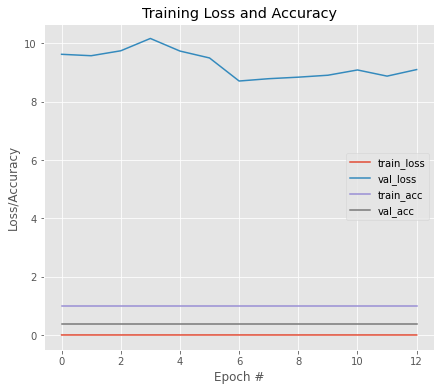


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.6617e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.37313, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 13s 437ms/step - loss: 1.6617e-05 - accuracy: 1.0000 - val_loss: 9.6173 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.3512e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.37313
9/9 [==============================] - 2s 197ms/step - loss: 2.3512e-05 - accuracy: 1.0000 - val_loss: 9.2660 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.8504e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.37313
9/9 [==============================] - 2s 208ms/step - loss: 3.8504e-05 - accuracy: 1.0000 - val_loss: 8.8042 - val_accuracy: 0.3731
Epoch 4/50
9/9 [======

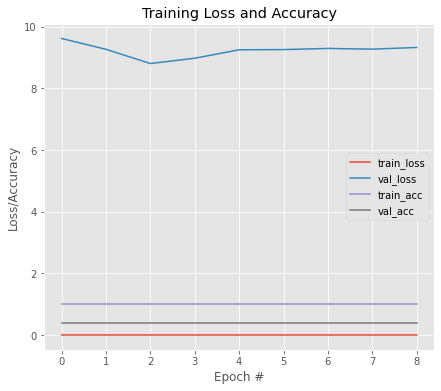


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.1627e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.37313, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 13s 388ms/step - loss: 3.1627e-05 - accuracy: 1.0000 - val_loss: 9.4036 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.7920e-06 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.37313
9/9 [==============================] - 2s 197ms/step - loss: 6.7920e-06 - accuracy: 1.0000 - val_loss: 9.6228 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.8204e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.37313
9/9 [==============================] - 2s 197ms/step - loss: 2.8204e-04 - accuracy: 1.0000 - val_loss: 9.9495 - val_accuracy: 0.3731
Epoch 4/50
9/9 [=======================

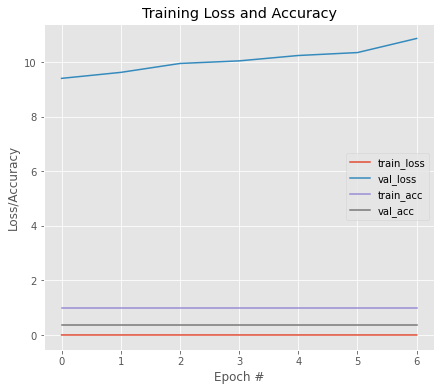


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Average Accuracy:0.41286216378211976
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.6510 - accuracy: 0.6460
Epoch 1: val_accuracy improved from -inf to 0.64384, saving model to resnet50_wt.hdf5
11/11 [==============================] - 5s 229ms/step - loss: 0.6510 - accuracy: 0.6460 - val_loss: 0.6516 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.6506 - accuracy: 0.6460
Epoch 2: val_accuracy did not improve from 0.64384
11/11 [==============================] - 1s 94ms/step - loss: 0.6506 - accuracy: 0.6460 - val_loss: 0.6514 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.6504 - accuracy: 0.6460
Epoch 3: val_accuracy did not improve from 0.64384
11/11 [==============================] - 1s 94ms/step - loss: 0.6504 - a

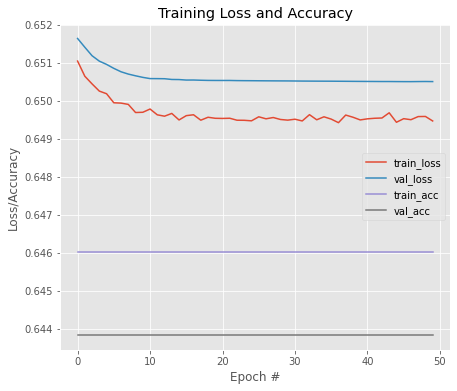


Model Performance Summary:

Best Validation accuracy:0.6438356041908264 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.2841 - accuracy: 0.9204
Epoch 1: val_accuracy improved from -inf to 0.64384, saving model to resnet50_wt.hdf5
11/11 [==============================] - 14s 400ms/step - loss: 0.2841 - accuracy: 0.9204 - val_loss: 0.6821 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0816 - accuracy: 0.9971
Epoch 2: val_accuracy did not improve from 0.64384
11/11 [==============================] - 2s 212ms/step - loss: 0.0816 - accuracy: 0.9971 - val_loss: 0.6798 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0333 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.64384
11/11 [==============================] - 2s 219ms/step - loss: 0.0333 - accuracy: 1.0000 - val_loss: 0.8146 - val_accuracy: 0.3562
Epoch

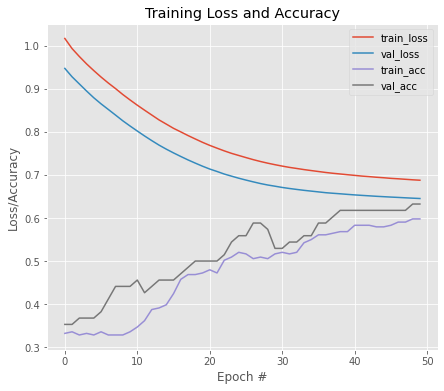


Model Performance Summary:

Best Validation accuracy:0.6323529481887817 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.9713 - accuracy: 0.6494
Epoch 1: val_accuracy improved from -inf to 0.64706, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 25s 582ms/step - loss: 0.9713 - accuracy: 0.6494 - val_loss: 0.6207 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6269 - accuracy: 0.6900
Epoch 2: val_accuracy did not improve from 0.64706
9/9 [==============================] - 2s 216ms/step - loss: 0.6269 - accuracy: 0.6900 - val_loss: 0.6125 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4587 - accuracy: 0.7343
Epoch 3: val_accuracy improved from 0.64706 to 0.66176, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 3s 311ms/step - loss: 0.4587 - accuracy: 0.7343 - val_loss: 0.6185 - val_accuracy: 0.6618
Epoch 4/50
9/9 [=

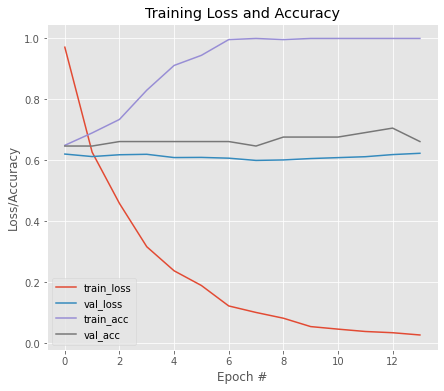


Model Performance Summary:

Best Validation accuracy:0.7058823704719543 at EPOCH:13
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1294 - accuracy: 0.9594
Epoch 1: val_accuracy improved from -inf to 0.76471, saving model to DenseNet121_a_1.hdf5
9/9 [==============================] - 23s 523ms/step - loss: 0.1294 - accuracy: 0.9594 - val_loss: 0.5340 - val_accuracy: 0.7647
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0628 - accuracy: 0.9889
Epoch 2: val_accuracy did not improve from 0.76471
9/9 [==============================] - 2s 217ms/step - loss: 0.0628 - accuracy: 0.9889 - val_loss: 0.5355 - val_accuracy: 0.7647
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0342 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 0.76471
9/9 [==============================] - 2s 217ms/step - loss: 0.0342 - accuracy: 0.9963 - val_loss: 0.5500 - val_accuracy: 0.7647
Epoch 4/50
9/9 [===========================

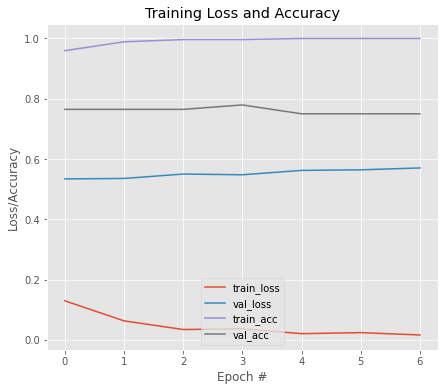


Model Performance Summary:

Best Validation accuracy:0.779411792755127 at EPOCH:4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0232 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.76471, saving model to DenseNet121_b_1.hdf5
9/9 [==============================] - 23s 519ms/step - loss: 0.0232 - accuracy: 1.0000 - val_loss: 0.5509 - val_accuracy: 0.7647
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0155 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.76471
9/9 [==============================] - 2s 215ms/step - loss: 0.0155 - accuracy: 1.0000 - val_loss: 0.5576 - val_accuracy: 0.7647
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0109 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.76471
9/9 [==============================] - 2s 213ms/step - loss: 0.0109 - accuracy: 1.0000 - val_loss: 0.5704 - val_accuracy: 0.7353
Epoch 4/50
9/9 [==============================] - ETA: 0s - l

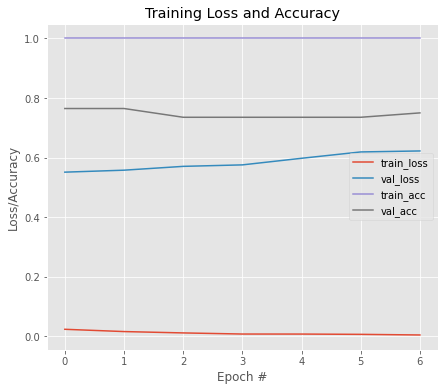


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0106 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.70588, saving model to DenseNet121_a_2.hdf5
9/9 [==============================] - 23s 525ms/step - loss: 0.0106 - accuracy: 1.0000 - val_loss: 0.6730 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0054 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.70588
9/9 [==============================] - 2s 215ms/step - loss: 0.0054 - accuracy: 1.0000 - val_loss: 0.6889 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0056 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.70588
9/9 [==============================] - 2s 213ms/step - loss: 0.0056 - accuracy: 1.0000 - val_loss: 0.7189 - val_accuracy: 0.7059
Epoch 4/50
9/9 [============================

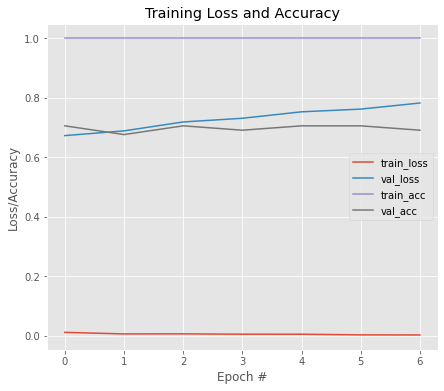


Model Performance Summary:

Best Validation accuracy:0.7058823704719543 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0038 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.67647, saving model to DenseNet121_b_2.hdf5
9/9 [==============================] - 23s 526ms/step - loss: 0.0038 - accuracy: 1.0000 - val_loss: 0.7416 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.67647
9/9 [==============================] - 2s 217ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.7592 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.67647
9/9 [==============================] - 2s 215ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.7688 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

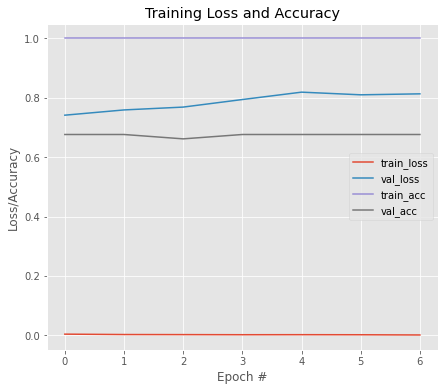


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000    
Epoch 1: val_accuracy improved from -inf to 0.72059, saving model to DenseNet121_a_3.hdf5
9/9 [==============================] - 23s 519ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.7301 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.72059
9/9 [==============================] - 2s 216ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.7066 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.72059
9/9 [==============================] - 2s 215ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.7334 - val_accuracy: 0.7206
Epoch 4/50
9/9 [========================

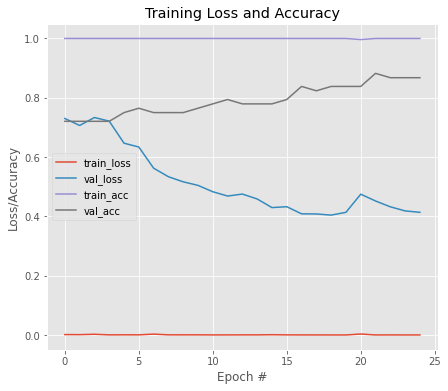


Model Performance Summary:

Best Validation accuracy:0.8823529481887817 at EPOCH:22
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.5779e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.85294, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 23s 514ms/step - loss: 1.5779e-04 - accuracy: 1.0000 - val_loss: 0.4973 - val_accuracy: 0.8529
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.3361e-04 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.85294 to 0.86765, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 3s 312ms/step - loss: 2.3361e-04 - accuracy: 1.0000 - val_loss: 0.5282 - val_accuracy: 0.8676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.0141e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.86765
9/9 [==============================] - 2s 216ms/step - loss: 1.0141e-04 - accuracy: 1.0000 - val_loss: 0.5017 - val_accuracy: 

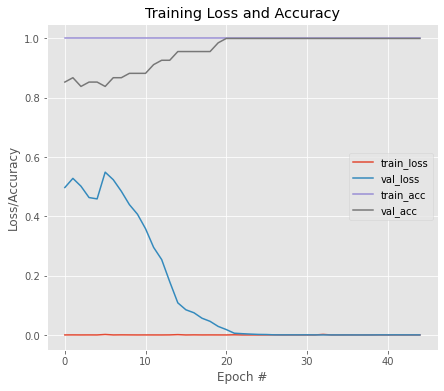


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:21
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0021 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to DenseNet121_a_4.hdf5
9/9 [==============================] - 24s 655ms/step - loss: 0.0021 - accuracy: 1.0000 - val_loss: 7.1062e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 217ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 4.5388e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.1009e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 218ms/step - loss: 1.1009e-04 - accuracy: 1.0000 - val_loss: 4.2773e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [======================

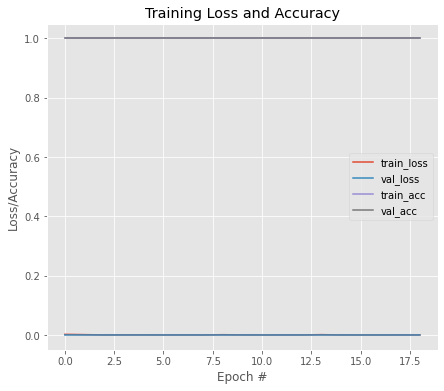


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.5943e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to DenseNet121_b_4.hdf5
9/9 [==============================] - 23s 525ms/step - loss: 2.5943e-04 - accuracy: 1.0000 - val_loss: 3.8425e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.5513e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 220ms/step - loss: 3.5513e-05 - accuracy: 1.0000 - val_loss: 2.7788e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.6988e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 218ms/step - loss: 1.6988e-04 - accuracy: 1.0000 - val_loss: 5.0754e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======================

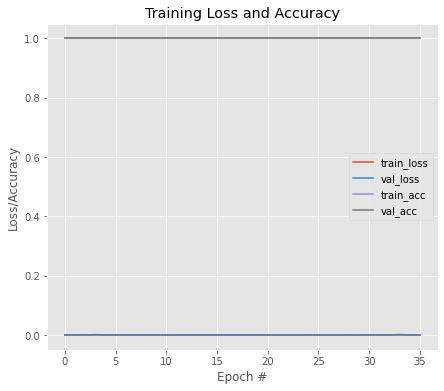


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8294117689132691
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0057 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.84932, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 9s 335ms/step - loss: 0.0057 - accuracy: 1.0000 - val_loss: 0.4556 - val_accuracy: 0.8493
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.84932
11/11 [==============================] - 1s 92ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.4513 - val_accuracy: 0.8493
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 1.0000
Epoch 3: val_accuracy improved from 0.84932 to 0.85616, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 2s 

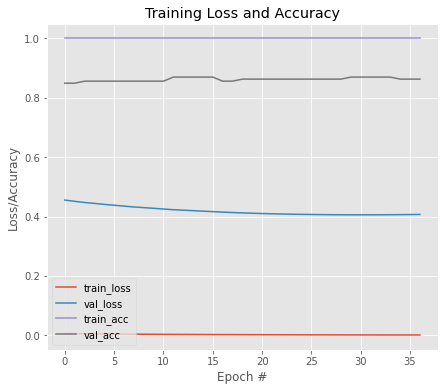


Model Performance Summary:

Best Validation accuracy:0.8698630332946777 at EPOCH:12
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 6.5647e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.82877, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 24s 525ms/step - loss: 6.5647e-04 - accuracy: 1.0000 - val_loss: 0.5239 - val_accuracy: 0.8288
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 4.3346e-04 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.82877 to 0.86301, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 3s 306ms/step - loss: 4.3346e-04 - accuracy: 1.0000 - val_loss: 0.4062 - val_accuracy: 0.8630
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 4.9377e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.86301
11/11 [==============================] - 3s 229ms/step - loss: 4.9377e-

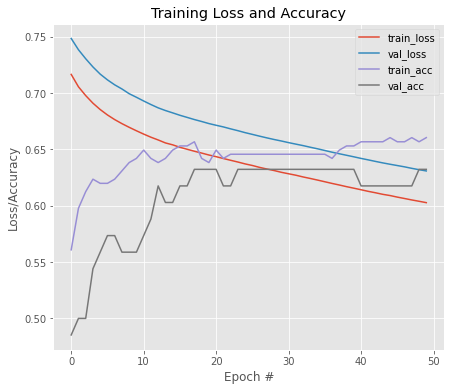


Model Performance Summary:

Best Validation accuracy:0.6323529481887817 at EPOCH:18
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6876 - accuracy: 0.6310
Epoch 1: val_accuracy improved from -inf to 0.47059, saving model to MobileNet_b_0.hdf5
9/9 [==============================] - 6s 243ms/step - loss: 0.6876 - accuracy: 0.6310 - val_loss: 0.8502 - val_accuracy: 0.4706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5021 - accuracy: 0.7601
Epoch 2: val_accuracy did not improve from 0.47059
9/9 [==============================] - 1s 154ms/step - loss: 0.5021 - accuracy: 0.7601 - val_loss: 1.0095 - val_accuracy: 0.4706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4228 - accuracy: 0.8229
Epoch 3: val_accuracy did not improve from 0.47059
9/9 [==============================] - 1s 152ms/step - loss: 0.4228 - accuracy: 0.8229 - val_loss: 1.2311 - val_accuracy: 0.3676
Epoch 4/50
9/9 [==============================] - ETA: 0s - lo

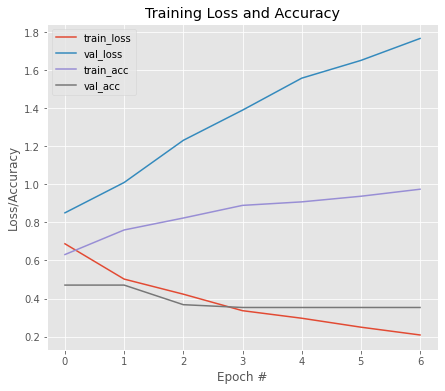


Model Performance Summary:

Best Validation accuracy:0.47058823704719543 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2437 - accuracy: 0.9520
Epoch 1: val_accuracy improved from -inf to 0.30882, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 6s 235ms/step - loss: 0.2437 - accuracy: 0.9520 - val_loss: 1.8412 - val_accuracy: 0.3088
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1812 - accuracy: 0.9779
Epoch 2: val_accuracy did not improve from 0.30882
9/9 [==============================] - 1s 157ms/step - loss: 0.1812 - accuracy: 0.9779 - val_loss: 1.7647 - val_accuracy: 0.3088
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1465 - accuracy: 0.9815
Epoch 3: val_accuracy improved from 0.30882 to 0.32353, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 2s 191ms/step - loss: 0.1465 - accuracy: 0.9815 - val_loss: 1.6866 - val_accuracy: 0.3235
Epoch 

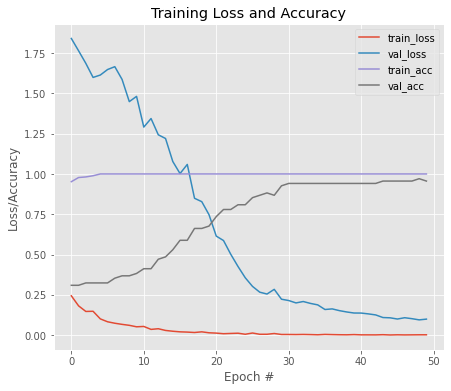


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 7.8269e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.97059, saving model to MobileNet_b_1.hdf5
9/9 [==============================] - 6s 266ms/step - loss: 7.8269e-04 - accuracy: 1.0000 - val_loss: 0.1114 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 8.0155e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.97059
9/9 [==============================] - 1s 152ms/step - loss: 8.0155e-04 - accuracy: 1.0000 - val_loss: 0.1365 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 9.3173e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.97059
9/9 [==============================] - 1s 164ms/step - loss: 9.3173e-04 - accuracy: 1.0000 - val_loss: 0.1163 - val_accuracy: 0.9706
Epoch 4/50
9/9 [=======================

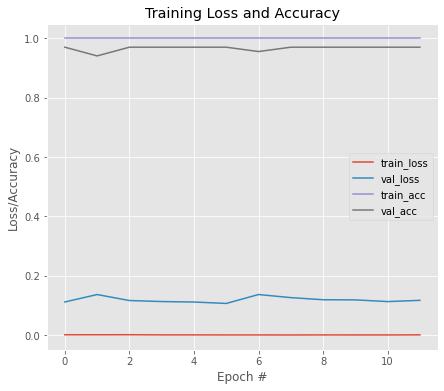


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0172 - accuracy: 0.9926
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 6s 236ms/step - loss: 0.0172 - accuracy: 0.9926 - val_loss: 7.4111e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 154ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 6.6423e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0164 - accuracy: 0.9926
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 153ms/step - loss: 0.0164 - accuracy: 0.9926 - val_loss: 8.0533e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [====================

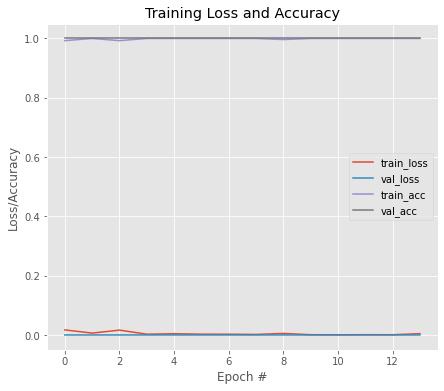


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0276 - accuracy: 0.9889
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 6s 237ms/step - loss: 0.0276 - accuracy: 0.9889 - val_loss: 8.8086e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 156ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 7.7873e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 160ms/step - loss: 0.0040 - accuracy: 1.0000 - val_loss: 7.2054e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

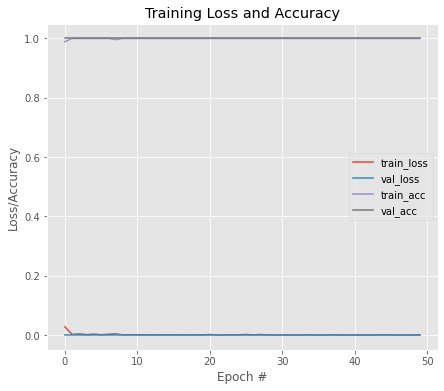


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 9.6870e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 6s 233ms/step - loss: 9.6870e-05 - accuracy: 1.0000 - val_loss: 7.2384e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.0100e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 164ms/step - loss: 1.0100e-04 - accuracy: 1.0000 - val_loss: 8.4918e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 4.8614e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 154ms/step - loss: 4.8614e-05 - accuracy: 1.0000 - val_loss: 8.3761e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========

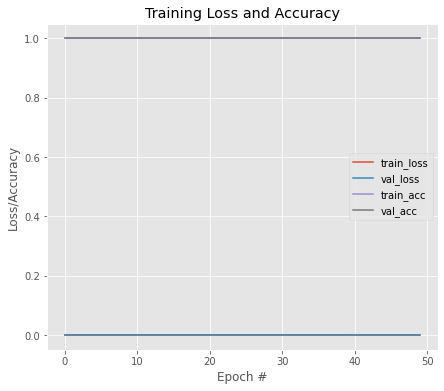


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.5959e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 6s 236ms/step - loss: 2.5959e-04 - accuracy: 1.0000 - val_loss: 6.1392e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.0511e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 154ms/step - loss: 3.0511e-04 - accuracy: 1.0000 - val_loss: 6.5600e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.9602e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 164ms/step - loss: 1.9602e-05 - accuracy: 1.0000 - val_loss: 5.9096e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========================

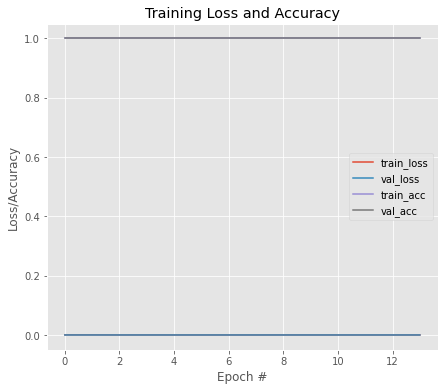


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.1139e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 6s 261ms/step - loss: 5.1139e-05 - accuracy: 1.0000 - val_loss: 5.6864e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.3991e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 154ms/step - loss: 1.3991e-05 - accuracy: 1.0000 - val_loss: 4.5904e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 5.5777e-06 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 153ms/step - loss: 5.5777e-06 - accuracy: 1.0000 - val_loss: 4.0976e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========

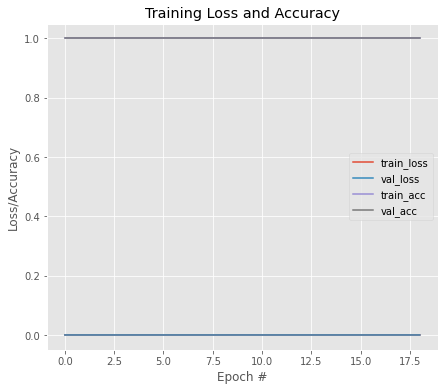


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.3231e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to MobileNet_b_4.hdf5
9/9 [==============================] - 6s 237ms/step - loss: 1.3231e-05 - accuracy: 1.0000 - val_loss: 6.3056e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 8.2759e-06 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 154ms/step - loss: 8.2759e-06 - accuracy: 1.0000 - val_loss: 6.3358e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.4368e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 1s 151ms/step - loss: 3.4368e-05 - accuracy: 1.0000 - val_loss: 4.4783e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========================

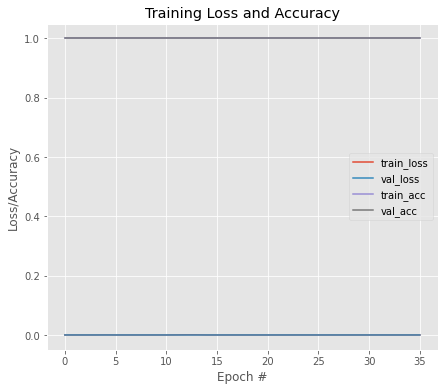


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8882352888584137
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.83562, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 2s 112ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.4901 - val_accuracy: 0.8356
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.83562 to 0.84247, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 1s 59ms/step - loss: 0.0032 - accuracy: 1.0000 - val_loss: 0.4836 - val_accuracy: 0.8425
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.84247
11/11 [==============================] - 0s 46ms

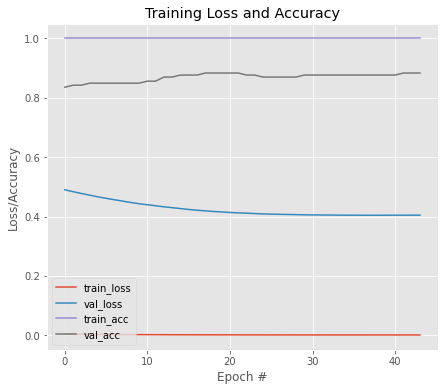


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:18
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0108 - accuracy: 0.9941
Epoch 1: val_accuracy improved from -inf to 0.89041, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 6s 238ms/step - loss: 0.0108 - accuracy: 0.9941 - val_loss: 0.4166 - val_accuracy: 0.8904
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 0.9971
Epoch 2: val_accuracy did not improve from 0.89041
11/11 [==============================] - 2s 158ms/step - loss: 0.0047 - accuracy: 0.9971 - val_loss: 0.4222 - val_accuracy: 0.8904
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 0.9971
Epoch 3: val_accuracy did not improve from 0.89041
11/11 [==============================] - 2s 159ms/step - loss: 0.0052 - accuracy: 0.9971 - val_loss: 0.4049 - val_accuracy: 0.8904
Epoc

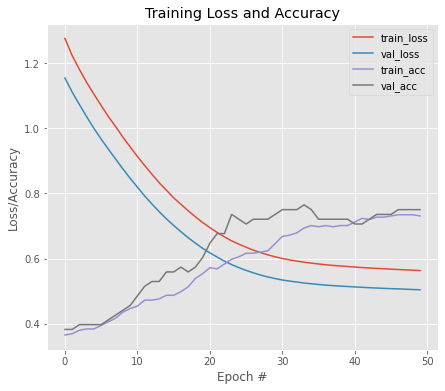


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:34
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6912 - accuracy: 0.6162
Epoch 1: val_accuracy improved from -inf to 0.75000, saving model to MobileNetV2_b_0.hdf5
9/9 [==============================] - 12s 317ms/step - loss: 0.6912 - accuracy: 0.6162 - val_loss: 0.5297 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5292 - accuracy: 0.7343
Epoch 2: val_accuracy did not improve from 0.75000
9/9 [==============================] - 2s 168ms/step - loss: 0.5292 - accuracy: 0.7343 - val_loss: 0.5380 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4722 - accuracy: 0.7823
Epoch 3: val_accuracy did not improve from 0.75000
9/9 [==============================] - 2s 172ms/step - loss: 0.4722 - accuracy: 0.7823 - val_loss: 0.5524 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s -

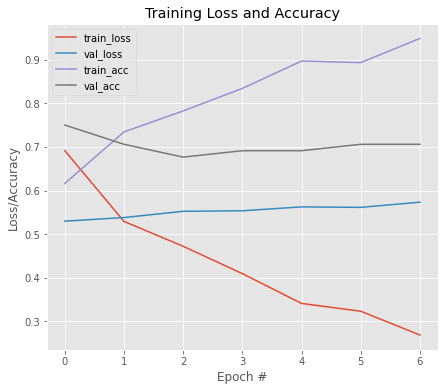


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2880 - accuracy: 0.9336
Epoch 1: val_accuracy improved from -inf to 0.60294, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 10s 303ms/step - loss: 0.2880 - accuracy: 0.9336 - val_loss: 0.7257 - val_accuracy: 0.6029
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2273 - accuracy: 0.9520
Epoch 2: val_accuracy did not improve from 0.60294
9/9 [==============================] - 2s 169ms/step - loss: 0.2273 - accuracy: 0.9520 - val_loss: 0.7384 - val_accuracy: 0.5882
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1941 - accuracy: 0.9742
Epoch 3: val_accuracy did not improve from 0.60294
9/9 [==============================] - 2s 167ms/step - loss: 0.1941 - accuracy: 0.9742 - val_loss: 0.7188 - val_accuracy: 0.5882
Epoch 4/50
9/9 [==============================] - ETA: 0s 

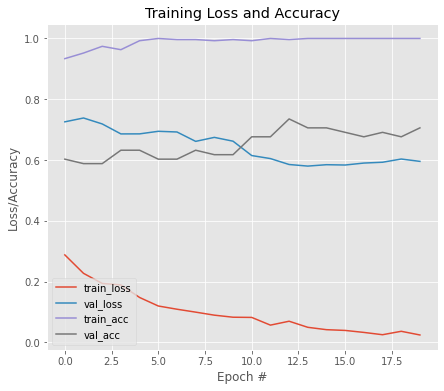


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:13
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0502 - accuracy: 0.9963
Epoch 1: val_accuracy improved from -inf to 0.69118, saving model to MobileNetV2_b_1.hdf5
9/9 [==============================] - 11s 308ms/step - loss: 0.0502 - accuracy: 0.9963 - val_loss: 0.5953 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0415 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 171ms/step - loss: 0.0415 - accuracy: 0.9963 - val_loss: 0.5963 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0291 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 169ms/step - loss: 0.0291 - accuracy: 1.0000 - val_loss: 0.6209 - val_accuracy: 0.6324
Epoch 4/50
9/9 [==============================] - ETA: 0s -

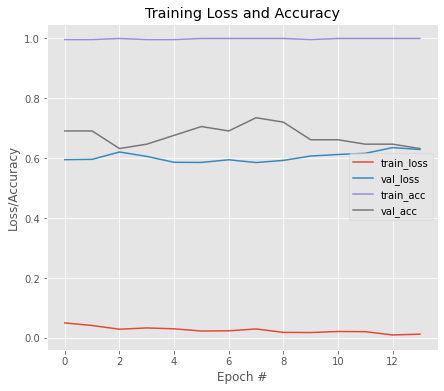


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:8
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0531 - accuracy: 0.9815
Epoch 1: val_accuracy improved from -inf to 0.69118, saving model to MobileNetV2_a_2.hdf5
9/9 [==============================] - 10s 305ms/step - loss: 0.0531 - accuracy: 0.9815 - val_loss: 0.6791 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0365 - accuracy: 0.9926
Epoch 2: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 166ms/step - loss: 0.0365 - accuracy: 0.9926 - val_loss: 0.6950 - val_accuracy: 0.6912
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0216 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 167ms/step - loss: 0.0216 - accuracy: 1.0000 - val_loss: 0.7032 - val_accuracy: 0.6765
Epoch 4/50
9/9 [============================

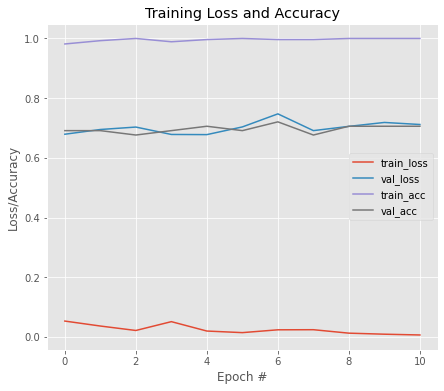


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:7
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0083 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.67647, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 10s 303ms/step - loss: 0.0083 - accuracy: 1.0000 - val_loss: 0.7916 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0062 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.67647
9/9 [==============================] - 2s 169ms/step - loss: 0.0062 - accuracy: 1.0000 - val_loss: 0.8486 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.67647
9/9 [==============================] - 2s 170ms/step - loss: 0.0048 - accuracy: 1.0000 - val_loss: 0.9705 - val_accuracy: 0.5294
Epoch 4/50
9/9 [==============================] - ETA: 0s - l

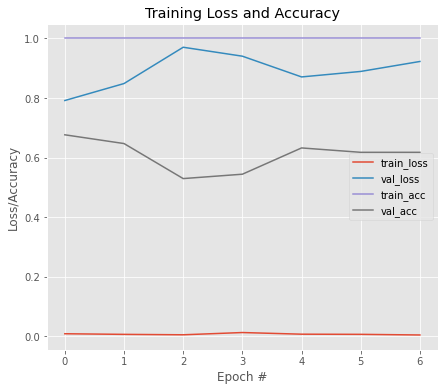


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0089 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.61765, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 10s 308ms/step - loss: 0.0089 - accuracy: 1.0000 - val_loss: 0.8694 - val_accuracy: 0.6176
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.61765 to 0.64706, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 2s 214ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 0.8510 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0044 - accuracy: 1.0000
Epoch 3: val_accuracy improved from 0.64706 to 0.66176, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 2s 211ms/step - loss: 0.0044 - accuracy: 1.0000 - 

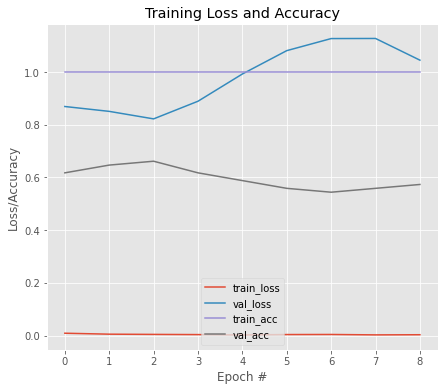


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.69118, saving model to MobileNetV2_b_3.hdf5
9/9 [==============================] - 10s 305ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.8126 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 172ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.9742 - val_accuracy: 0.6029
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0033 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.69118
9/9 [==============================] - 2s 171ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss: 0.8452 - val_accuracy: 0.6765
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

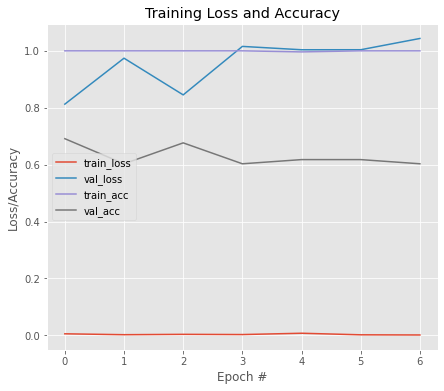


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.55224, saving model to MobileNetV2_a_4.hdf5
9/9 [==============================] - 10s 339ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.2636 - val_accuracy: 0.5522
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 0.55224
9/9 [==============================] - 2s 169ms/step - loss: 0.0049 - accuracy: 0.9963 - val_loss: 1.0743 - val_accuracy: 0.5224
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.5631e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.55224
9/9 [==============================] - 2s 170ms/step - loss: 7.5631e-04 - accuracy: 1.0000 - val_loss: 1.0782 - val_accuracy: 0.5224
Epoch 4/50
9/9 [====================

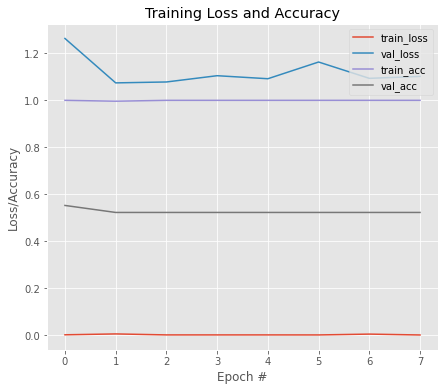


Model Performance Summary:

Best Validation accuracy:0.5522388219833374 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.8694e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.56716, saving model to MobileNetV2_b_4.hdf5
9/9 [==============================] - 10s 308ms/step - loss: 5.8694e-04 - accuracy: 1.0000 - val_loss: 1.3405 - val_accuracy: 0.5672
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.56716
9/9 [==============================] - 2s 171ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 1.0376 - val_accuracy: 0.5224
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 8.6354e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.56716
9/9 [==============================] - 2s 177ms/step - loss: 8.6354e-04 - accuracy: 1.0000 - val_loss: 1.1602 - val_accuracy: 0.5373
Epoch 4/50
9/9 [============================

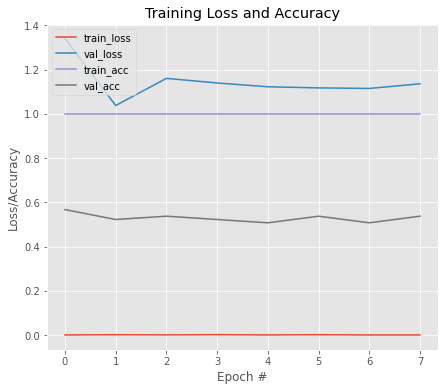


Model Performance Summary:

Best Validation accuracy:0.5671641826629639 at EPOCH:1
Average Accuracy:0.6840210676193237
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.5753 - accuracy: 0.6991
Epoch 1: val_accuracy improved from -inf to 0.66438, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 4s 158ms/step - loss: 0.5753 - accuracy: 0.6991 - val_loss: 0.5969 - val_accuracy: 0.6644
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.5653 - accuracy: 0.6991
Epoch 2: val_accuracy improved from 0.66438 to 0.67123, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 1s 70ms/step - loss: 0.5653 - accuracy: 0.6991 - val_loss: 0.5884 - val_accuracy: 0.6712
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.5592 - accuracy: 0.7050
Epoch 3: val_accuracy did not improve from 0.67123
11/11 [======================

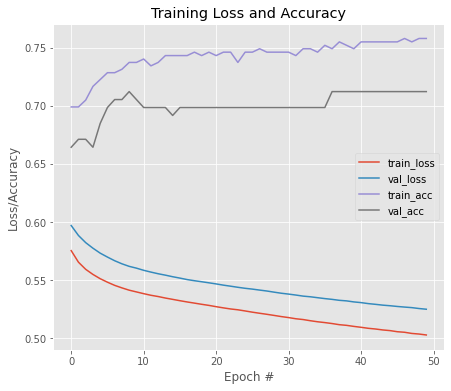


Model Performance Summary:

Best Validation accuracy:0.7123287916183472 at EPOCH:9
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.4969 - accuracy: 0.7581
Epoch 1: val_accuracy improved from -inf to 0.64384, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 10s 296ms/step - loss: 0.4969 - accuracy: 0.7581 - val_loss: 0.6140 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.3250 - accuracy: 0.8997
Epoch 2: val_accuracy did not improve from 0.64384
11/11 [==============================] - 2s 177ms/step - loss: 0.3250 - accuracy: 0.8997 - val_loss: 0.6255 - val_accuracy: 0.6301
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2480 - accuracy: 0.9351
Epoch 3: val_accuracy improved from 0.64384 to 0.65068, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 2s 211ms/step - loss: 0.2480 - accuracy: 0.9351 - v

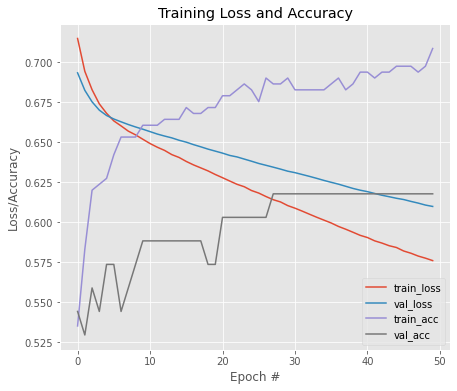


Model Performance Summary:

Best Validation accuracy:0.6176470518112183 at EPOCH:28
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6239 - accuracy: 0.6753
Epoch 1: val_accuracy improved from -inf to 0.66176, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 15s 456ms/step - loss: 0.6239 - accuracy: 0.6753 - val_loss: 0.6496 - val_accuracy: 0.6618
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4286 - accuracy: 0.8708
Epoch 2: val_accuracy did not improve from 0.66176
9/9 [==============================] - 2s 169ms/step - loss: 0.4286 - accuracy: 0.8708 - val_loss: 0.6898 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3380 - accuracy: 0.9483
Epoch 3: val_accuracy did not improve from 0.66176
9/9 [==============================] - 2s 169ms/step - loss: 0.3380 - accuracy: 0.9483 - val_loss: 0.6782 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s -

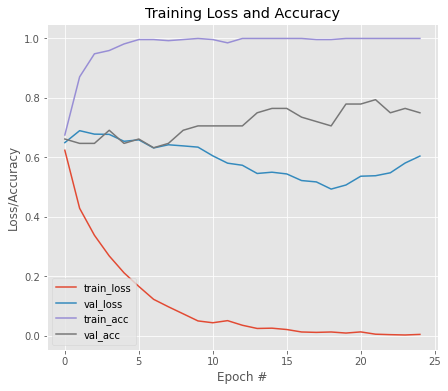


Model Performance Summary:

Best Validation accuracy:0.7941176295280457 at EPOCH:22
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0839 - accuracy: 0.9594
Epoch 1: val_accuracy improved from -inf to 0.88235, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 14s 422ms/step - loss: 0.0839 - accuracy: 0.9594 - val_loss: 0.2231 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0295 - accuracy: 0.9889
Epoch 2: val_accuracy improved from 0.88235 to 0.92647, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 2s 274ms/step - loss: 0.0295 - accuracy: 0.9889 - val_loss: 0.1724 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0162 - accuracy: 0.9926
Epoch 3: val_accuracy did not improve from 0.92647
9/9 [==============================] - 2s 169ms/step - loss: 0.0162 - accuracy: 0.9926 - val_loss: 0.1561 - val_accuracy: 0.9118
E

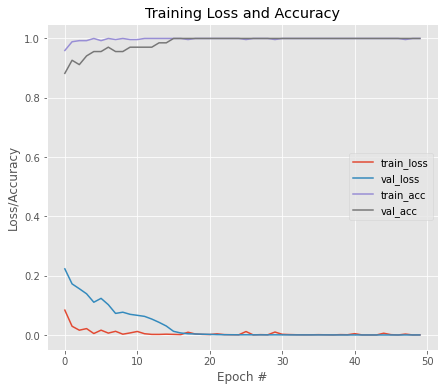


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:16
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 14s 406ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 0.0102 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 9.1760e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 168ms/step - loss: 9.1760e-04 - accuracy: 1.0000 - val_loss: 0.0095 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 167ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0057 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

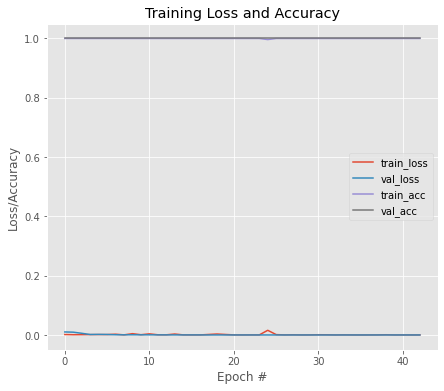


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.2405e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 14s 405ms/step - loss: 2.2405e-04 - accuracy: 1.0000 - val_loss: 2.3690e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0115 - accuracy: 0.9926
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 169ms/step - loss: 0.0115 - accuracy: 0.9926 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 9.0206e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 177ms/step - loss: 9.0206e-05 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======================

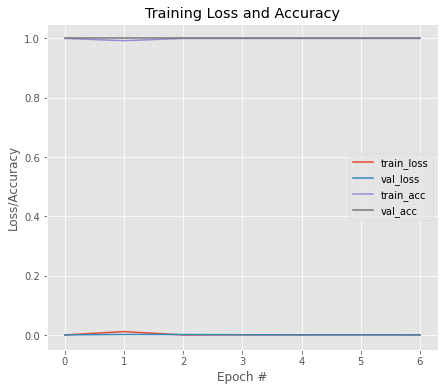


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.0041e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 15s 416ms/step - loss: 1.0041e-04 - accuracy: 1.0000 - val_loss: 4.4431e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.0090e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 170ms/step - loss: 2.0090e-04 - accuracy: 1.0000 - val_loss: 5.7685e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000    
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 170ms/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 1.3927e-04 - val_accuracy: 1.0000
Epoch 4/50
9/9 [===========================

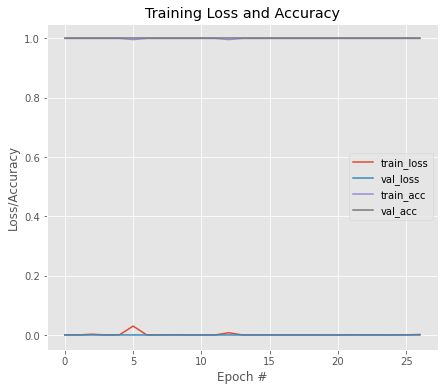


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.5451e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 14s 405ms/step - loss: 3.5451e-04 - accuracy: 1.0000 - val_loss: 4.3809e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 9.5294e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 169ms/step - loss: 9.5294e-04 - accuracy: 1.0000 - val_loss: 1.6606e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 168ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 2.5835e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [===============

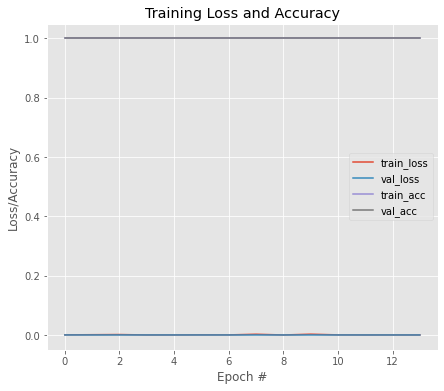


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.7628e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 15s 488ms/step - loss: 2.7628e-05 - accuracy: 1.0000 - val_loss: 2.9441e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.2535e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 169ms/step - loss: 1.2535e-04 - accuracy: 1.0000 - val_loss: 1.8117e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.6194e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 169ms/step - loss: 2.6194e-05 - accuracy: 1.0000 - val_loss: 1.3766e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [=======================

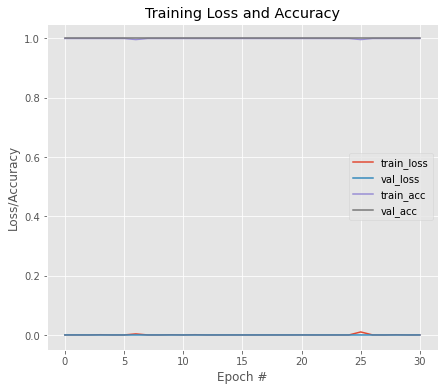


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 1.7960e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 15s 506ms/step - loss: 1.7960e-04 - accuracy: 1.0000 - val_loss: 3.0549e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.0508e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 166ms/step - loss: 2.0508e-05 - accuracy: 1.0000 - val_loss: 3.5069e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 0.9926
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 167ms/step - loss: 0.0079 - accuracy: 0.9926 - val_loss: 5.1882e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [===============

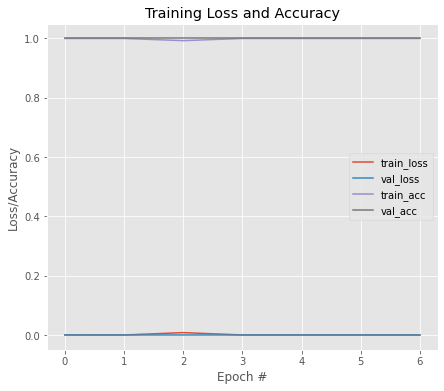


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.2500e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 14s 410ms/step - loss: 3.2500e-05 - accuracy: 1.0000 - val_loss: 5.5494e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.0072e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 171ms/step - loss: 2.0072e-05 - accuracy: 1.0000 - val_loss: 3.1350e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 2s 177ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 6.0796e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================]

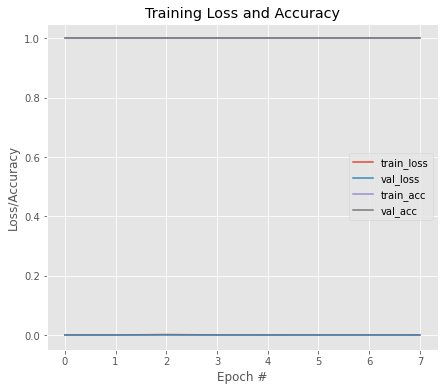


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9588235259056092
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.85616, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 7s 296ms/step - loss: 0.0100 - accuracy: 1.0000 - val_loss: 0.4474 - val_accuracy: 0.8562
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0094 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.85616 to 0.86301, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 1s 124ms/step - loss: 0.0094 - accuracy: 1.0000 - val_loss: 0.4418 - val_accuracy: 0.8630
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0089 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.86301
11/11 [==============================] - 1s

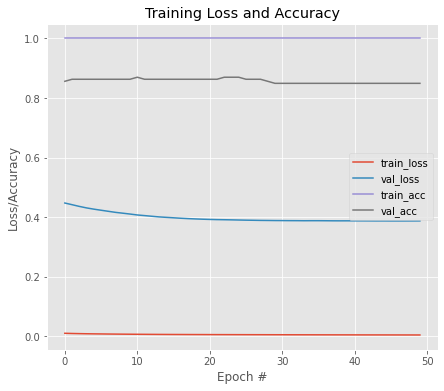


Model Performance Summary:

Best Validation accuracy:0.8698630332946777 at EPOCH:11
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 6.6084e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.84932, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 15s 416ms/step - loss: 6.6084e-04 - accuracy: 1.0000 - val_loss: 0.3938 - val_accuracy: 0.8493
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.84932
11/11 [==============================] - 2s 179ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 0.5124 - val_accuracy: 0.8425
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.84932
11/11 [==============================] - 2s 177ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.5295 - val_accuracy: 

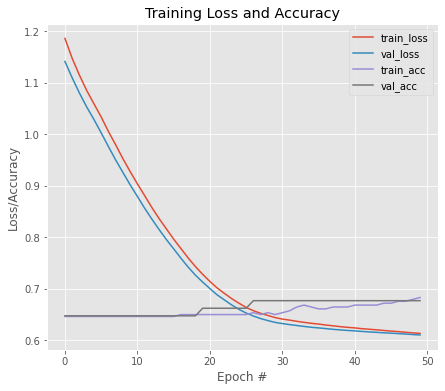


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:27
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7157 - accuracy: 0.4834
Epoch 1: val_accuracy improved from -inf to 0.66176, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 39s 1s/step - loss: 0.7157 - accuracy: 0.4834 - val_loss: 0.6378 - val_accuracy: 0.6618
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5558 - accuracy: 0.7675
Epoch 2: val_accuracy improved from 0.66176 to 0.67647, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 5s 598ms/step - loss: 0.5558 - accuracy: 0.7675 - val_loss: 0.6129 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4578 - accuracy: 0.8708
Epoch 3: val_accuracy improved from 0.67647 to 0.69118, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 5s 598ms/step - loss: 0.4578 - accuracy: 0.8708 - 

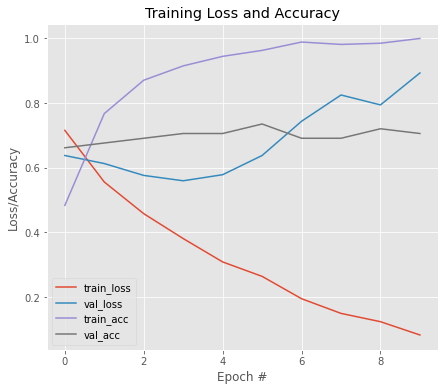


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:6
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1244 - accuracy: 0.9779
Epoch 1: val_accuracy improved from -inf to 0.63235, saving model to InceptionResNetV2_a_1.hdf5
9/9 [==============================] - 38s 973ms/step - loss: 0.1244 - accuracy: 0.9779 - val_loss: 1.9841 - val_accuracy: 0.6324
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0786 - accuracy: 0.9852
Epoch 2: val_accuracy did not improve from 0.63235
9/9 [==============================] - 3s 371ms/step - loss: 0.0786 - accuracy: 0.9852 - val_loss: 2.3801 - val_accuracy: 0.6324
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0526 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.63235
9/9 [==============================] - 3s 369ms/step - loss: 0.0526 - accuracy: 1.0000 - val_loss: 2.8338 - val_accuracy: 0.6324
Epoch 4/50
9/9 [======================

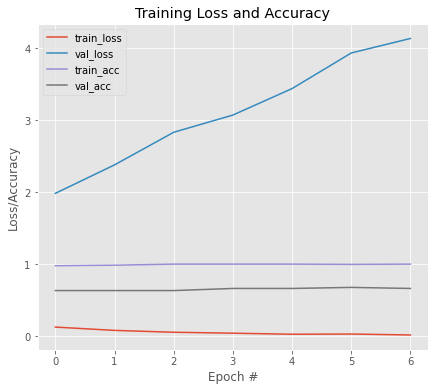


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0114 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.67647, saving model to InceptionResNetV2_b_1.hdf5
9/9 [==============================] - 37s 1000ms/step - loss: 0.0114 - accuracy: 1.0000 - val_loss: 3.3190 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0084 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.67647
9/9 [==============================] - 3s 387ms/step - loss: 0.0084 - accuracy: 1.0000 - val_loss: 3.5725 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_accuracy improved from 0.67647 to 0.70588, saving model to InceptionResNetV2_b_1.hdf5
9/9 [==============================] - 5s 600ms/step - loss: 0.0040 - accuracy: 1.0000 - val_loss: 3.7332 - val_accuracy: 0.7059
Epoch

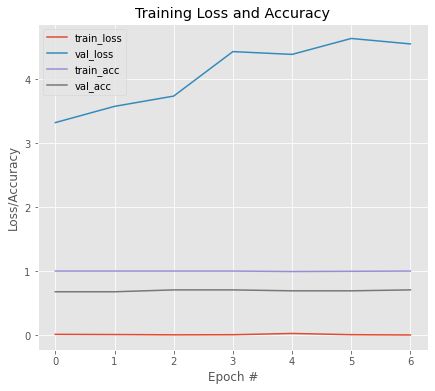


Model Performance Summary:

Best Validation accuracy:0.7058823704719543 at EPOCH:3
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.75000, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 37s 972ms/step - loss: 0.0041 - accuracy: 1.0000 - val_loss: 3.3084 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.75000 to 0.79412, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 6s 743ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 3.5089 - val_accuracy: 0.7941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.79412
9/9 [==============================] - 3s 368ms/step - loss: 0.0022 - accuracy: 1.0000 - val_loss: 3.6022 - val_accurac

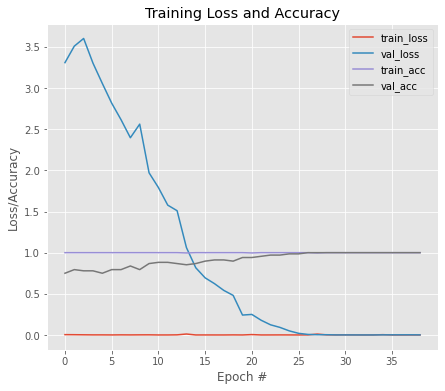


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:27
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.0484e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionResNetV2_b_2.hdf5
9/9 [==============================] - 40s 1s/step - loss: 3.0484e-04 - accuracy: 1.0000 - val_loss: 0.0055 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 2.7887e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 372ms/step - loss: 2.7887e-04 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.2390e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 370ms/step - loss: 1.2390e-04 - accuracy: 1.0000 - val_loss: 4.8638e-04 - val_accuracy: 1.0000
Epoch 4/50
9/9 [===========================

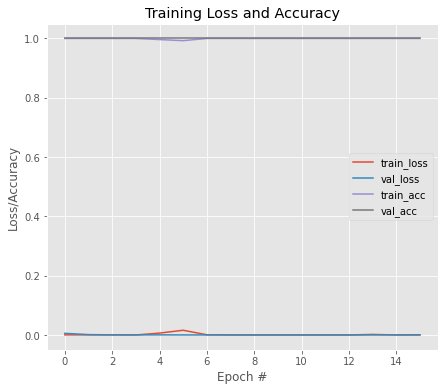


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 5.5871e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.98529, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 37s 981ms/step - loss: 5.5871e-05 - accuracy: 1.0000 - val_loss: 0.4634 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.4161e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 0.98529
9/9 [==============================] - 3s 370ms/step - loss: 6.4161e-05 - accuracy: 1.0000 - val_loss: 0.4155 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.8603e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.98529
9/9 [==============================] - 3s 370ms/step - loss: 2.8603e-05 - accuracy: 1.0000 - val_loss: 0.3314 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=============

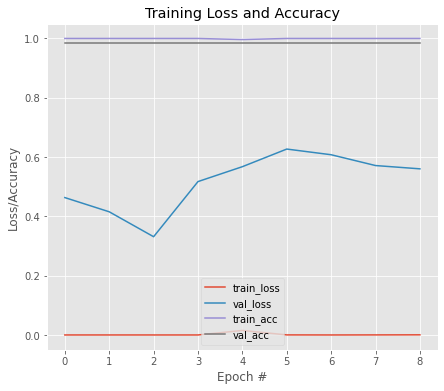


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 7.8726e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.98529, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 38s 1s/step - loss: 7.8726e-04 - accuracy: 1.0000 - val_loss: 0.3821 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0038 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 0.98529
9/9 [==============================] - 3s 369ms/step - loss: 0.0038 - accuracy: 0.9963 - val_loss: 0.3965 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.2124e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.98529
9/9 [==============================] - 3s 367ms/step - loss: 1.2124e-04 - accuracy: 1.0000 - val_loss: 0.3642 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=========================

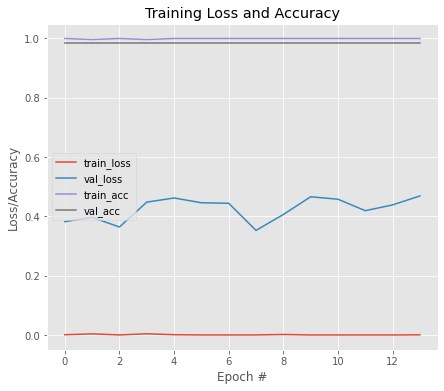


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0240 - accuracy: 0.9926
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 37s 1s/step - loss: 0.0240 - accuracy: 0.9926 - val_loss: 3.6018e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 8.3610e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 385ms/step - loss: 8.3610e-04 - accuracy: 1.0000 - val_loss: 3.5676e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 4.0624e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 369ms/step - loss: 4.0624e-04 - accuracy: 1.0000 - val_loss: 3.1046e-05 - val_accuracy: 1.0000
Epoch 4/50
9/

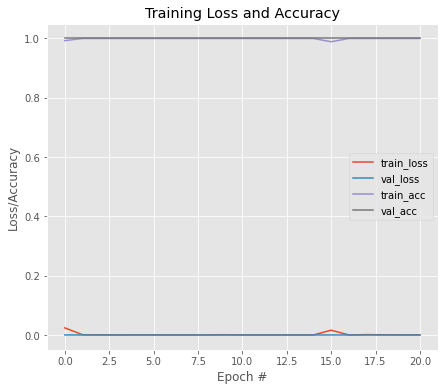


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 7.4784e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 39s 1s/step - loss: 7.4784e-05 - accuracy: 1.0000 - val_loss: 3.1476e-05 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 4.7991e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 371ms/step - loss: 4.7991e-05 - accuracy: 1.0000 - val_loss: 1.7729e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.6910e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 3s 384ms/step - loss: 1.6910e-04 - accuracy: 1.0000 - val_loss: 2.5799e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [====================

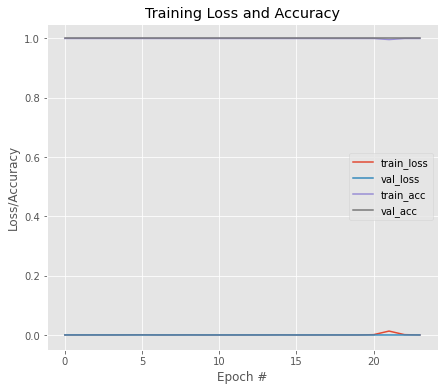


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8852941155433655
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1364 - accuracy: 0.9823
Epoch 1: val_accuracy improved from -inf to 0.81507, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 15s 609ms/step - loss: 0.1364 - accuracy: 0.9823 - val_loss: 1.7879 - val_accuracy: 0.8151
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1345 - accuracy: 0.9823
Epoch 2: val_accuracy did not improve from 0.81507
11/11 [==============================] - 2s 166ms/step - loss: 0.1345 - accuracy: 0.9823 - val_loss: 1.7662 - val_accuracy: 0.8151
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1329 - accuracy: 0.9823
Epoch 3: val_accuracy improved from 0.81507 to 0.82192, saving model to InceptionResNetV2_wt.hdf5
11/11 [=======================

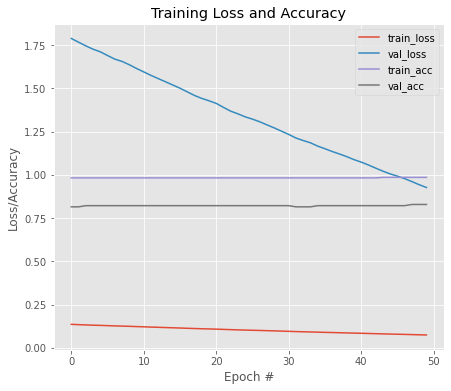


Model Performance Summary:

Best Validation accuracy:0.8287671208381653 at EPOCH:48
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 1.1722e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.82192, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 38s 918ms/step - loss: 1.1722e-04 - accuracy: 1.0000 - val_loss: 1.3435 - val_accuracy: 0.8219
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0262 - accuracy: 0.9971
Epoch 2: val_accuracy did not improve from 0.82192
11/11 [==============================] - 4s 396ms/step - loss: 0.0262 - accuracy: 0.9971 - val_loss: 1.6658 - val_accuracy: 0.7740
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.82192
11/11 [==============================] - 4s 395ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 1.4105 - val_accu

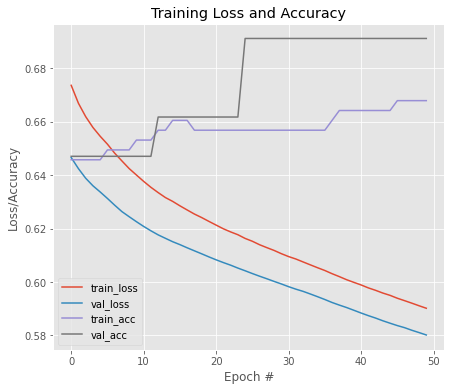


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:25
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6251 - accuracy: 0.6974
Epoch 1: val_accuracy improved from -inf to 0.67647, saving model to xception_b_0.hdf5
9/9 [==============================] - 13s 596ms/step - loss: 0.6251 - accuracy: 0.6974 - val_loss: 0.5759 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5328 - accuracy: 0.7934
Epoch 2: val_accuracy did not improve from 0.67647
9/9 [==============================] - 4s 391ms/step - loss: 0.5328 - accuracy: 0.7934 - val_loss: 0.5570 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4822 - accuracy: 0.8635
Epoch 3: val_accuracy did not improve from 0.67647
9/9 [==============================] - 4s 390ms/step - loss: 0.4822 - accuracy: 0.8635 - val_loss: 0.5427 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 0s - lo

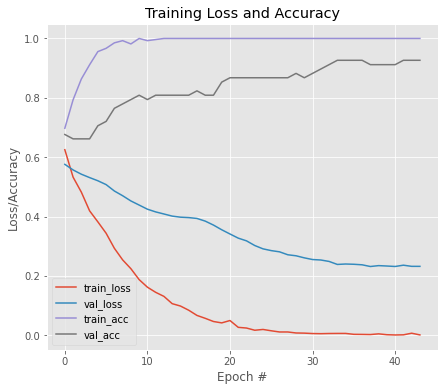


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:34
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0728 - accuracy: 0.9779
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_a_1.hdf5
9/9 [==============================] - 13s 547ms/step - loss: 0.0728 - accuracy: 0.9779 - val_loss: 2.2221e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0153 - accuracy: 0.9926
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 389ms/step - loss: 0.0153 - accuracy: 0.9926 - val_loss: 2.2042e-04 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0137 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 390ms/step - loss: 0.0137 - accuracy: 0.9963 - val_loss: 2.2116e-04 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==================

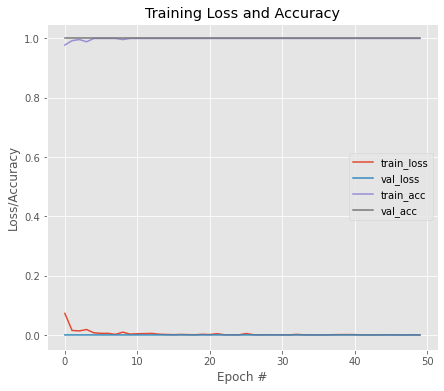


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0180 - accuracy: 0.9926
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_b_1.hdf5
9/9 [==============================] - 13s 548ms/step - loss: 0.0180 - accuracy: 0.9926 - val_loss: 2.0176e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0071 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 389ms/step - loss: 0.0071 - accuracy: 1.0000 - val_loss: 2.1943e-04 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 413ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 2.0609e-04 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

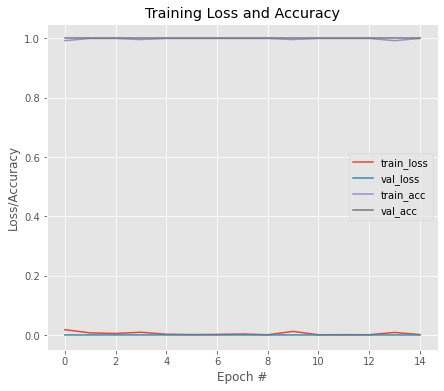


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_a_2.hdf5
9/9 [==============================] - 13s 556ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 1.3981e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 388ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 1.2920e-04 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 7.3820e-04 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 390ms/step - loss: 7.3820e-04 - accuracy: 1.0000 - val_loss: 1.1813e-04 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========================

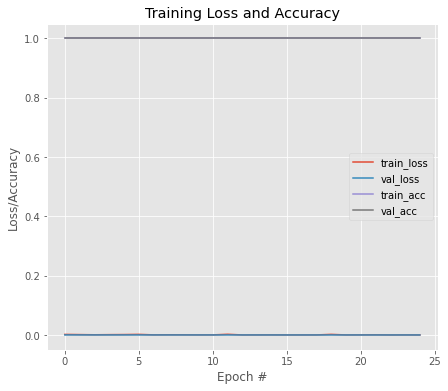


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.7637e-04 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_b_2.hdf5
9/9 [==============================] - 13s 637ms/step - loss: 4.7637e-04 - accuracy: 1.0000 - val_loss: 1.0928e-04 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 3.7412e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 391ms/step - loss: 3.7412e-04 - accuracy: 1.0000 - val_loss: 9.1618e-05 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0055 - accuracy: 0.9963
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 391ms/step - loss: 0.0055 - accuracy: 0.9963 - val_loss: 8.9153e-05 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - 

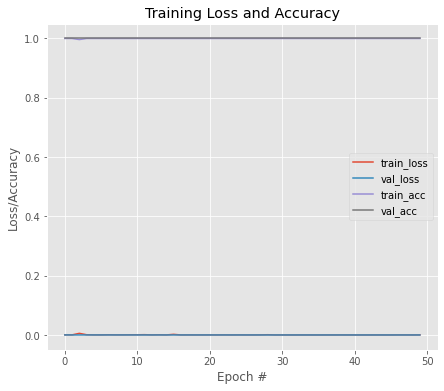


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 4.1833e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_a_3.hdf5
9/9 [==============================] - 12s 549ms/step - loss: 4.1833e-05 - accuracy: 1.0000 - val_loss: 3.1678e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 1.7140e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 413ms/step - loss: 1.7140e-05 - accuracy: 1.0000 - val_loss: 3.0451e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 390ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 3.3922e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==================

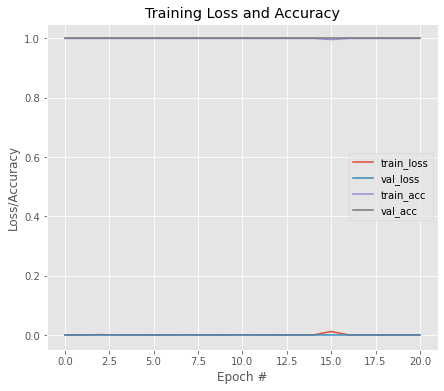


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.4014e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_b_3.hdf5
9/9 [==============================] - 12s 550ms/step - loss: 3.4014e-05 - accuracy: 1.0000 - val_loss: 3.6096e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.5845e-04 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 411ms/step - loss: 6.5845e-04 - accuracy: 1.0000 - val_loss: 3.4781e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 3.4130e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 391ms/step - loss: 3.4130e-05 - accuracy: 1.0000 - val_loss: 3.4255e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========================

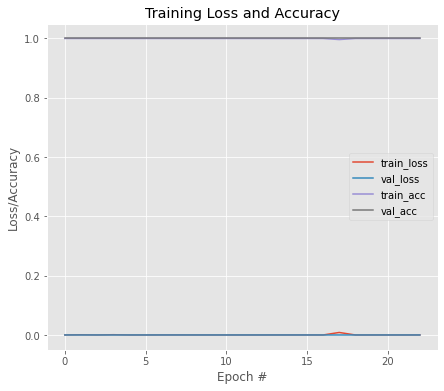


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 2.6126e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_a_4.hdf5
9/9 [==============================] - 13s 632ms/step - loss: 2.6126e-05 - accuracy: 1.0000 - val_loss: 3.0336e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 6.0003e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 415ms/step - loss: 6.0003e-05 - accuracy: 1.0000 - val_loss: 2.2223e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 1.3802e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 393ms/step - loss: 1.3802e-05 - accuracy: 1.0000 - val_loss: 2.1511e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========

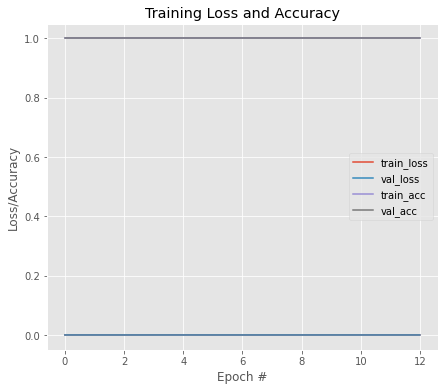


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 3.3282e-05 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to xception_b_4.hdf5
9/9 [==============================] - 12s 550ms/step - loss: 3.3282e-05 - accuracy: 1.0000 - val_loss: 2.2507e-06 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 9.0169e-05 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 389ms/step - loss: 9.0169e-05 - accuracy: 1.0000 - val_loss: 2.2507e-06 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 2.7547e-05 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 411ms/step - loss: 2.7547e-05 - accuracy: 1.0000 - val_loss: 2.1725e-06 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==========================

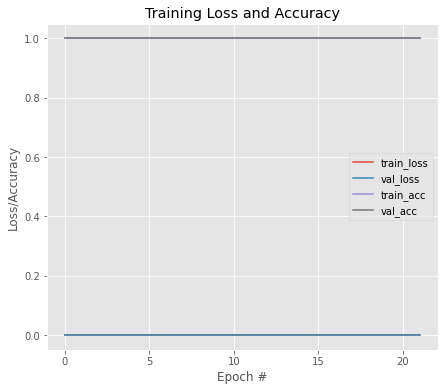


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9852941155433654
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0029 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.88356, saving model to xception_wt.hdf5
11/11 [==============================] - 5s 263ms/step - loss: 0.0029 - accuracy: 1.0000 - val_loss: 0.3188 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.88356 to 0.89041, saving model to xception_wt.hdf5
11/11 [==============================] - 2s 154ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.3178 - val_accuracy: 0.8904
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.89041
11/11 [==============================] - 1s 117ms

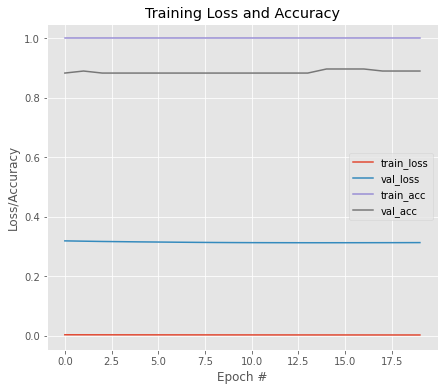


Model Performance Summary:

Best Validation accuracy:0.8972602486610413 at EPOCH:15
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0072 - accuracy: 1.0000
Epoch 1: val_accuracy improved from -inf to 0.88356, saving model to xception_wt.hdf5
11/11 [==============================] - 14s 574ms/step - loss: 0.0072 - accuracy: 1.0000 - val_loss: 0.3615 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000
Epoch 2: val_accuracy improved from 0.88356 to 0.89041, saving model to xception_wt.hdf5
11/11 [==============================] - 5s 470ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 0.3529 - val_accuracy: 0.8904
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 0.89041
11/11 [==============================] - 5s 410ms/step - loss: 0.0014 - accuracy: 1.0000 - val_lo

In [ ]:

for model in MODEL_LIST:

  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(training_images,training_label,test_images,test_label,data_aug=False)

,Model,Accuracy,Sensitivity,AUC
0,vgg16,0.938356,0.989362,0.917758
1,vgg19,0.924658,0.936170,0.920008
2,resnet50,0.643836,1.000000,0.500000
3,DenseNet121,0.931507,0.914894,0.938216
4,MobileNet,0.938356,0.936170,0.939239
5,InceptionV3,0.890411,0.957447,0.863339
6,InceptionResNetV2,0.904110,0.925532,0.895458
7,MobileNetV2,0.773973,0.925532,0.712766
8,xception,0.917808,0.957447,0.901800
9,vgg16_A_False,0.897260,0.957447,0.872954


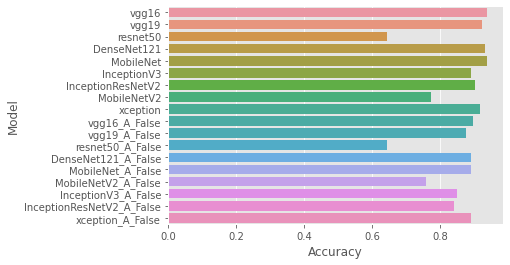

\begin{tabular}{lrrr}
\toprule
                    Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
                    vgg16 &  0.938356 &     0.989362 & 0.917758 \\
                    vgg19 &  0.924658 &     0.936170 & 0.920008 \\
                 resnet50 &  0.643836 &     1.000000 & 0.500000 \\
              DenseNet121 &  0.931507 &     0.914894 & 0.938216 \\
                MobileNet &  0.938356 &     0.936170 & 0.939239 \\
              InceptionV3 &  0.890411 &     0.957447 & 0.863339 \\
        InceptionResNetV2 &  0.904110 &     0.925532 & 0.895458 \\
              MobileNetV2 &  0.773973 &     0.925532 & 0.712766 \\
                 xception &  0.917808 &     0.957447 & 0.901800 \\
            vgg16\_A\_False &  0.897260 &     0.957447 & 0.872954 \\
            vgg19\_A\_False &  0.876712 &     0.872340 & 0.878478 \\
         resnet50\_A\_False &  0.643836 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_False &  0.890411 &     0.904255 & 0.884820 \\
        Mobile

In [ ]:
plot_overall_performance()

21/04/2022

# New Attempt

In [ ]:
test_label.shape

(146,)

Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7484 - accuracy: 0.3542
Epoch 1: val_accuracy improved from -inf to 0.35294, saving model to vgg16_a_0.hdf5
9/9 [==============================] - 5s 499ms/step - loss: 0.7484 - accuracy: 0.3542 - val_loss: 0.7487 - val_accuracy: 0.3529
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.7455 - accuracy: 0.3542
Epoch 2: val_accuracy did not improve from 0.35294
9/9 [==============================] - 2s 178ms/step - loss: 0.7455 - accuracy: 0.3542 - val_loss: 0.7463 - val_accuracy: 0.3529
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.7432 - accuracy: 0.3542
Epoch 3: val_accuracy did not improve from 0.35294
9/9 [==============================] - 2s 180ms/step - loss: 0.7432 - accuracy: 0.3542 - val_loss: 0.7441 - val_accuracy: 0.3529
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.7409 - accuracy: 0.3542
Epoch 4: val_accuracy did not improve from 

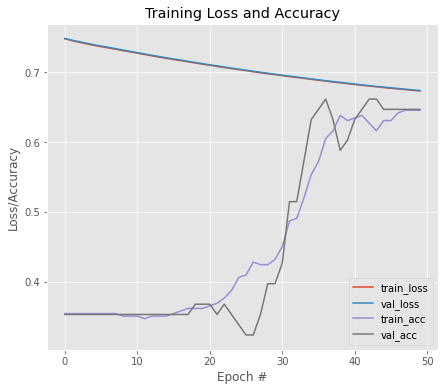


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:37
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6448 - accuracy: 0.6568
Epoch 1: val_accuracy improved from -inf to 0.70588, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 12s 773ms/step - loss: 0.6448 - accuracy: 0.6568 - val_loss: 0.6115 - val_accuracy: 0.7059
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5896 - accuracy: 0.6937
Epoch 2: val_accuracy improved from 0.70588 to 0.77941, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 4s 478ms/step - loss: 0.5896 - accuracy: 0.6937 - val_loss: 0.5910 - val_accuracy: 0.7794
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5687 - accuracy: 0.7343
Epoch 3: val_accuracy did not improve from 0.77941
9/9 [==============================] - 4s 445ms/step - loss: 0.5687 - accuracy: 0.7343 - val_loss: 0.5365 - val_accuracy: 0.7353
Epoch 4/50
9/9 [=============

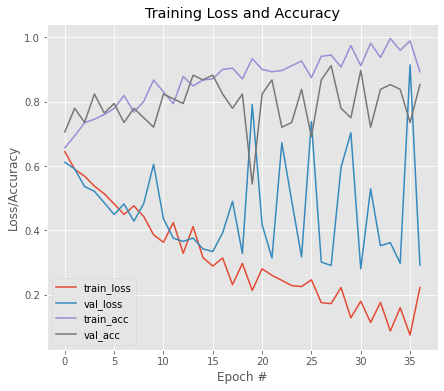


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:28
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3904 - accuracy: 0.8856
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 6s 508ms/step - loss: 0.3904 - accuracy: 0.8856 - val_loss: 0.0770 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1796 - accuracy: 0.9446
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 462ms/step - loss: 0.1796 - accuracy: 0.9446 - val_loss: 0.0731 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1154 - accuracy: 0.9705
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 464ms/step - loss: 0.1154 - accuracy: 0.9705 - val_loss: 0.0918 - val_accuracy: 0.9853
Epoch 4/50
9/9 [==============================] - 

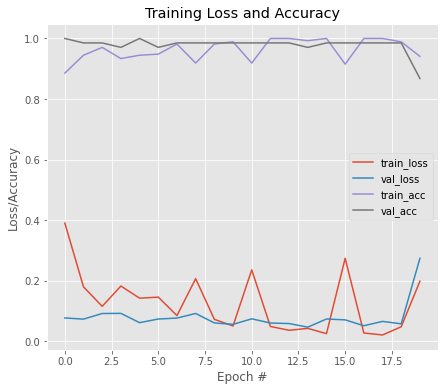


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3135 - accuracy: 0.8967
Epoch 1: val_accuracy improved from -inf to 0.85294, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 6s 513ms/step - loss: 0.3135 - accuracy: 0.8967 - val_loss: 0.3064 - val_accuracy: 0.8529
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1296 - accuracy: 0.9594
Epoch 2: val_accuracy improved from 0.85294 to 0.97059, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 4s 501ms/step - loss: 0.1296 - accuracy: 0.9594 - val_loss: 0.0720 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1578 - accuracy: 0.9446
Epoch 3: val_accuracy did not improve from 0.97059
9/9 [==============================] - 4s 497ms/step - loss: 0.1578 - accuracy: 0.9446 - val_loss: 0.0831 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================

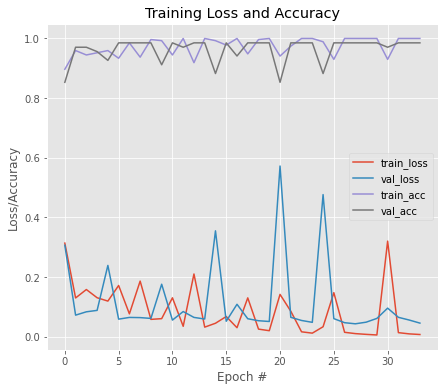


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:6
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5554 - accuracy: 0.9631
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 6s 513ms/step - loss: 0.5554 - accuracy: 0.9631 - val_loss: 0.0170 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0147 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 470ms/step - loss: 0.0147 - accuracy: 1.0000 - val_loss: 0.0145 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0120 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 469ms/step - loss: 0.0120 - accuracy: 1.0000 - val_loss: 0.0133 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - E

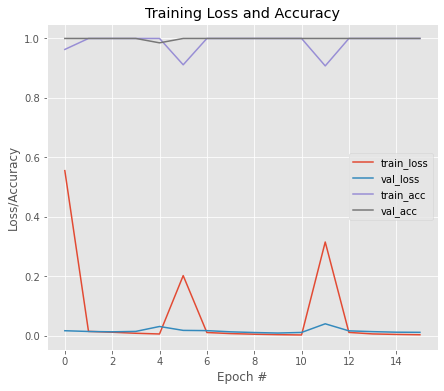


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4001 - accuracy: 0.9004
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 6s 515ms/step - loss: 0.4001 - accuracy: 0.9004 - val_loss: 0.0266 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0198 - accuracy: 0.9963
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 470ms/step - loss: 0.0198 - accuracy: 0.9963 - val_loss: 0.0185 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0128 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 470ms/step - loss: 0.0128 - accuracy: 1.0000 - val_loss: 0.0166 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0079 - accurac

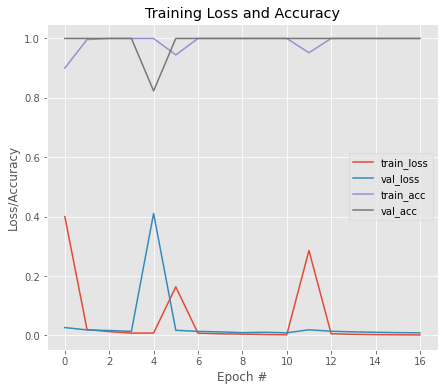


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4204 - accuracy: 0.9631
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 6s 516ms/step - loss: 0.4204 - accuracy: 0.9631 - val_loss: 0.0050 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 499ms/step - loss: 0.0064 - accuracy: 1.0000 - val_loss: 0.0039 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 469ms/step - loss: 0.0048 - accuracy: 1.0000 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 

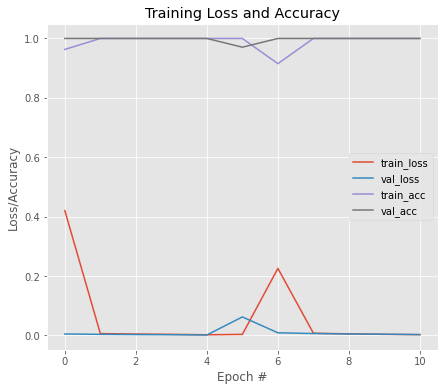


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6606 - accuracy: 0.9446
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 6s 515ms/step - loss: 0.6606 - accuracy: 0.9446 - val_loss: 0.0051 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0054 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 472ms/step - loss: 0.0054 - accuracy: 1.0000 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 469ms/step - loss: 0.0047 - accuracy: 1.0000 - val_loss: 0.0035 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0042 - accurac

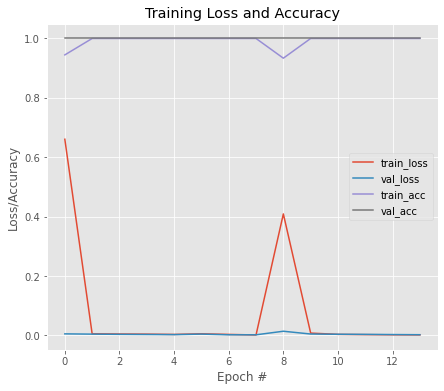


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5316 - accuracy: 0.9485
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 11s 1s/step - loss: 0.5316 - accuracy: 0.9485 - val_loss: 0.0031 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 471ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.0021 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 469ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.

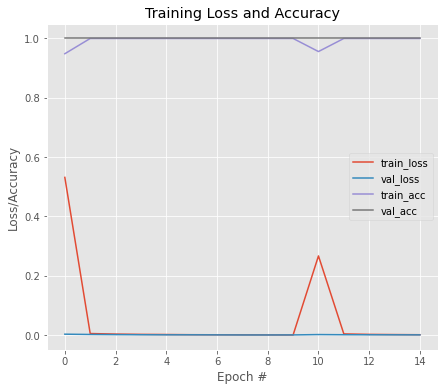


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2630 - accuracy: 0.9596
Epoch 1: val_accuracy improved from -inf to 1.00000, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 6s 515ms/step - loss: 0.2630 - accuracy: 0.9596 - val_loss: 0.0021 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000
Epoch 2: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 468ms/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000
Epoch 3: val_accuracy did not improve from 1.00000
9/9 [==============================] - 4s 471ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0020 - accurac

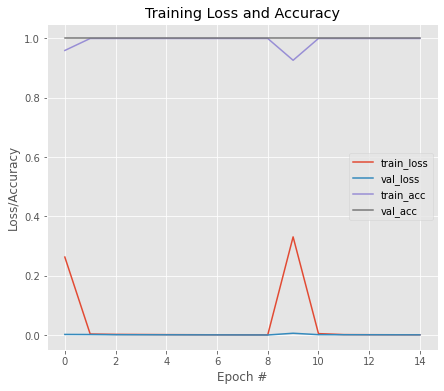


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9794117569923401
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0236 - accuracy: 0.9971
Epoch 1: val_accuracy improved from -inf to 0.88356, saving model to vgg16_wt.hdf5
11/11 [==============================] - 7s 650ms/step - loss: 0.0236 - accuracy: 0.9971 - val_loss: 0.2761 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0234 - accuracy: 0.9971
Epoch 2: val_accuracy did not improve from 0.88356
11/11 [==============================] - 3s 240ms/step - loss: 0.0234 - accuracy: 0.9971 - val_loss: 0.2754 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0233 - accuracy: 0.9971
Epoch 3: val_accuracy did not improve from 0.88356
11/11 [==============================] - 3s 239ms/step - loss: 0.0233 - accuracy: 0.9971 -

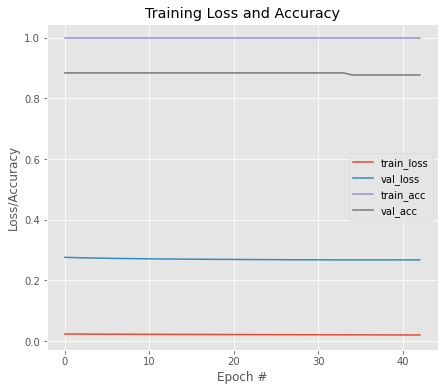


Model Performance Summary:

Best Validation accuracy:0.8835616707801819 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.9375 - accuracy: 0.7906
Epoch 1: val_accuracy improved from -inf to 0.86301, saving model to vgg16_wt.hdf5
11/11 [==============================] - 10s 570ms/step - loss: 0.9375 - accuracy: 0.7906 - val_loss: 0.3307 - val_accuracy: 0.8630
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0739 - accuracy: 0.9882
Epoch 2: val_accuracy did not improve from 0.86301
11/11 [==============================] - 6s 515ms/step - loss: 0.0739 - accuracy: 0.9882 - val_loss: 0.3792 - val_accuracy: 0.8151
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0508 - accuracy: 0.9853
Epoch 3: val_accuracy improved from 0.86301 to 0.86986, saving model to vgg16_wt.hdf5
11/11 [==============================] - 6s 541ms/step - loss: 0.0508 - accuracy: 0.9853 - val_loss: 0.3

In [ ]:
model_obj = HIGH_LEVEL_MODEL('vgg16')
model_obj.train_phase(training_images,training_label,test_images,test_label,data_aug=False)

Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7454 - accuracy: 0.3542
Epoch 1: val_accuracy improved from -inf to 0.35294, saving model to vgg16_a_0.hdf5
9/9 [==============================] - 4s 370ms/step - loss: 0.7454 - accuracy: 0.3542 - val_loss: 0.7487 - val_accuracy: 0.3529
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.7425 - accuracy: 0.3542
Epoch 2: val_accuracy did not improve from 0.35294
9/9 [==============================] - 3s 322ms/step - loss: 0.7425 - accuracy: 0.3542 - val_loss: 0.7462 - val_accuracy: 0.3529
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.7396 - accuracy: 0.3542
Epoch 3: val_accuracy did not improve from 0.35294
9/9 [==============================] - 3s 325ms/step - loss: 0.7396 - accuracy: 0.3542 - val_loss: 0.7441 - val_accuracy: 0.3529
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.7364 - accuracy: 0.3542
Epoch 4: val_accuracy did not improve from 

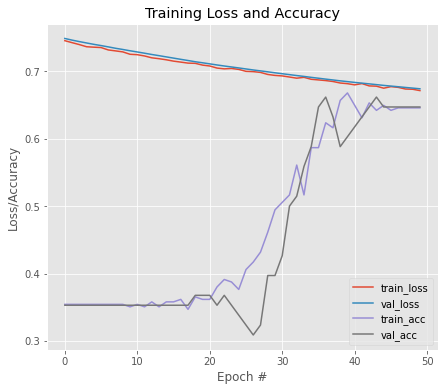


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:37
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6406 - accuracy: 0.6494
Epoch 1: val_accuracy improved from -inf to 0.64706, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 6s 506ms/step - loss: 0.6406 - accuracy: 0.6494 - val_loss: 0.6213 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6166 - accuracy: 0.6716
Epoch 2: val_accuracy improved from 0.64706 to 0.66176, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 5s 482ms/step - loss: 0.6166 - accuracy: 0.6716 - val_loss: 0.5994 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6110 - accuracy: 0.7048
Epoch 3: val_accuracy improved from 0.66176 to 0.75000, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 5s 489ms/step - loss: 0.6110 - accuracy: 0.7048 - val_loss: 0.5711 - val_accuracy: 0

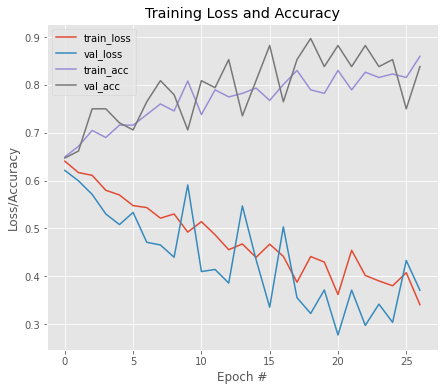


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:19
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5127 - accuracy: 0.7269
Epoch 1: val_accuracy improved from -inf to 0.91176, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 6s 522ms/step - loss: 0.5127 - accuracy: 0.7269 - val_loss: 0.2283 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3421 - accuracy: 0.8266
Epoch 2: val_accuracy did not improve from 0.91176
9/9 [==============================] - 4s 460ms/step - loss: 0.3421 - accuracy: 0.8266 - val_loss: 0.2261 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3839 - accuracy: 0.8266
Epoch 3: val_accuracy did not improve from 0.91176
9/9 [==============================] - 4s 454ms/step - loss: 0.3839 - accuracy: 0.8266 - val_loss: 0.4672 - val_accuracy: 0.7794
Epoch 4/50
9/9 [==============================] - 

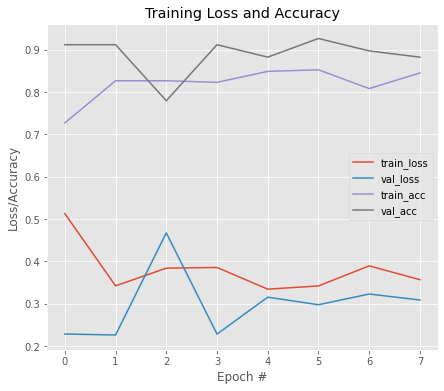


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4231 - accuracy: 0.8303
Epoch 1: val_accuracy improved from -inf to 0.91176, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 6s 522ms/step - loss: 0.4231 - accuracy: 0.8303 - val_loss: 0.2138 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2963 - accuracy: 0.8561
Epoch 2: val_accuracy did not improve from 0.91176
9/9 [==============================] - 4s 464ms/step - loss: 0.2963 - accuracy: 0.8561 - val_loss: 0.1838 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3157 - accuracy: 0.8524
Epoch 3: val_accuracy improved from 0.91176 to 0.92647, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 5s 497ms/step - loss: 0.3157 - accuracy: 0.8524 - val_loss: 0.1853 - val_accuracy: 0.9265
Epoch 4/50
9/9 [===============

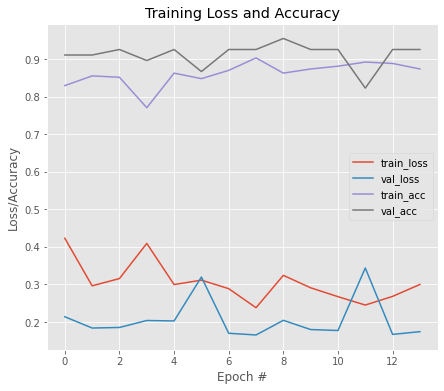


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:9
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3972 - accuracy: 0.8967
Epoch 1: val_accuracy improved from -inf to 0.86765, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 6s 525ms/step - loss: 0.3972 - accuracy: 0.8967 - val_loss: 0.2648 - val_accuracy: 0.8676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2050 - accuracy: 0.9188
Epoch 2: val_accuracy did not improve from 0.86765
9/9 [==============================] - 4s 466ms/step - loss: 0.2050 - accuracy: 0.9188 - val_loss: 0.2596 - val_accuracy: 0.8529
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2067 - accuracy: 0.9188
Epoch 3: val_accuracy did not improve from 0.86765
9/9 [==============================] - 4s 470ms/step - loss: 0.2067 - accuracy: 0.9188 - val_loss: 0.3218 - val_accuracy: 0.8382
Epoch 4/50
9/9 [==============================] - E

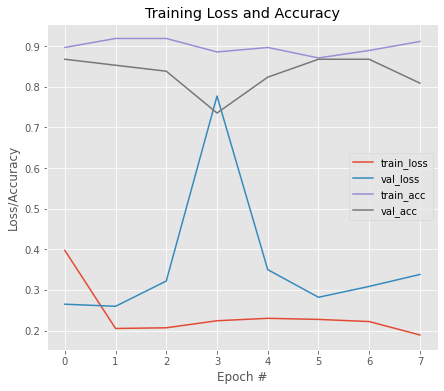


Model Performance Summary:

Best Validation accuracy:0.8676470518112183 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3158 - accuracy: 0.8672
Epoch 1: val_accuracy improved from -inf to 0.85294, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 6s 517ms/step - loss: 0.3158 - accuracy: 0.8672 - val_loss: 0.2645 - val_accuracy: 0.8529
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1993 - accuracy: 0.9151
Epoch 2: val_accuracy did not improve from 0.85294
9/9 [==============================] - 4s 459ms/step - loss: 0.1993 - accuracy: 0.9151 - val_loss: 0.3294 - val_accuracy: 0.8382
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2289 - accuracy: 0.9004
Epoch 3: val_accuracy did not improve from 0.85294
9/9 [==============================] - 4s 494ms/step - loss: 0.2289 - accuracy: 0.9004 - val_loss: 0.2752 - val_accuracy: 0.8235
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0

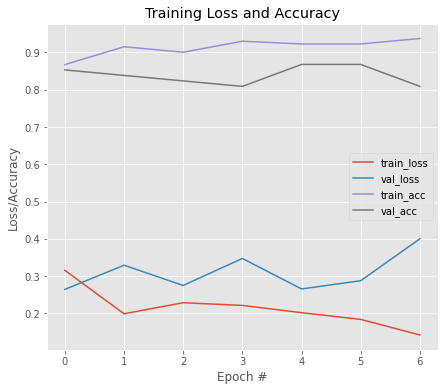


Model Performance Summary:

Best Validation accuracy:0.8676470518112183 at EPOCH:5
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3420 - accuracy: 0.8598
Epoch 1: val_accuracy improved from -inf to 0.94118, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 6s 528ms/step - loss: 0.3420 - accuracy: 0.8598 - val_loss: 0.1825 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1994 - accuracy: 0.9041
Epoch 2: val_accuracy did not improve from 0.94118
9/9 [==============================] - 5s 470ms/step - loss: 0.1994 - accuracy: 0.9041 - val_loss: 0.2441 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2407 - accuracy: 0.9041
Epoch 3: val_accuracy did not improve from 0.94118
9/9 [==============================] - 4s 467ms/step - loss: 0.2407 - accuracy: 0.9041 - val_loss: 0.1751 - val_accuracy: 0.9265
Epoch 4/50
9/9 [==============================] - E

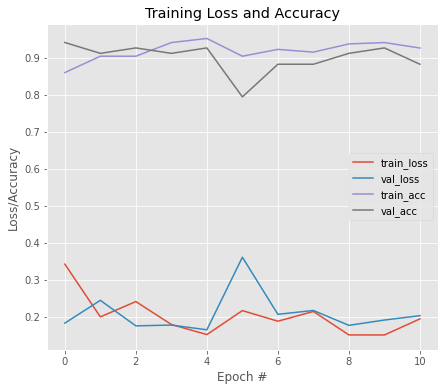


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3083 - accuracy: 0.9114
Epoch 1: val_accuracy improved from -inf to 0.89706, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 6s 529ms/step - loss: 0.3083 - accuracy: 0.9114 - val_loss: 0.2754 - val_accuracy: 0.8971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2013 - accuracy: 0.9077
Epoch 2: val_accuracy did not improve from 0.89706
9/9 [==============================] - 4s 469ms/step - loss: 0.2013 - accuracy: 0.9077 - val_loss: 0.3119 - val_accuracy: 0.8971
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1933 - accuracy: 0.9077
Epoch 3: val_accuracy improved from 0.89706 to 0.92647, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 5s 503ms/step - loss: 0.1933 - accuracy: 0.9077 - val_loss: 0.1939 - val_accuracy: 0.9265
Epoch 4/50
9/9 [===============

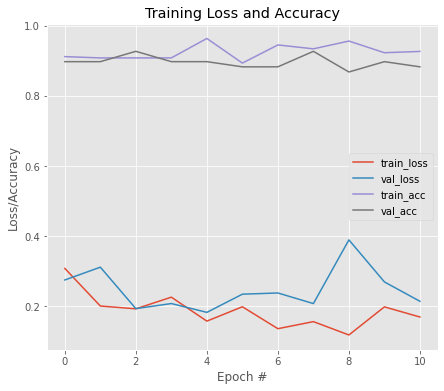


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:3
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3173 - accuracy: 0.8860
Epoch 1: val_accuracy improved from -inf to 0.98507, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 6s 527ms/step - loss: 0.3173 - accuracy: 0.8860 - val_loss: 0.0867 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1830 - accuracy: 0.9301
Epoch 2: val_accuracy did not improve from 0.98507
9/9 [==============================] - 4s 468ms/step - loss: 0.1830 - accuracy: 0.9301 - val_loss: 0.1343 - val_accuracy: 0.9403
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1408 - accuracy: 0.9522
Epoch 3: val_accuracy did not improve from 0.98507
9/9 [==============================] - 4s 470ms/step - loss: 0.1408 - accuracy: 0.9522 - val_loss: 0.1389 - val_accuracy: 0.9552
Epoch 4/50
9/9 [==============================] - E

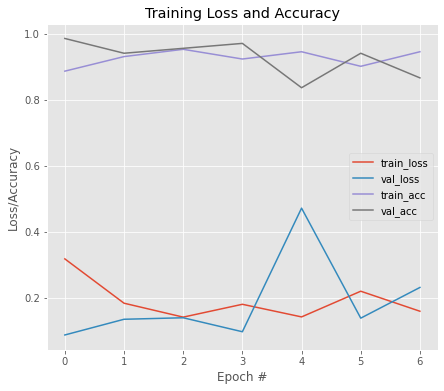


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2625 - accuracy: 0.8824
Epoch 1: val_accuracy improved from -inf to 0.94030, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 6s 529ms/step - loss: 0.2625 - accuracy: 0.8824 - val_loss: 0.1608 - val_accuracy: 0.9403
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1611 - accuracy: 0.9412
Epoch 2: val_accuracy improved from 0.94030 to 0.97015, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 5s 502ms/step - loss: 0.1611 - accuracy: 0.9412 - val_loss: 0.0989 - val_accuracy: 0.9701
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1812 - accuracy: 0.9044
Epoch 3: val_accuracy improved from 0.97015 to 0.98507, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 5s 508ms/step - loss: 0.1812 - accuracy: 0.9044 - val_loss: 0.1019 - val_accuracy: 0.

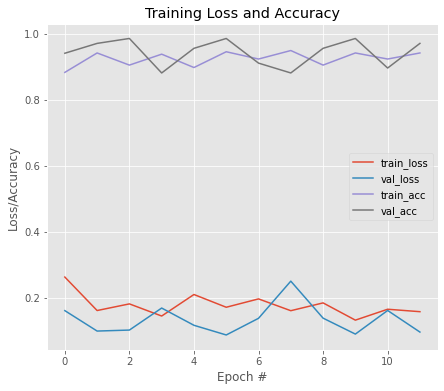


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:3
Average Accuracy:0.9264266967773438
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1281 - accuracy: 0.9617
Epoch 1: val_accuracy improved from -inf to 0.91781, saving model to vgg16_wt.hdf5
11/11 [==============================] - 5s 404ms/step - loss: 0.1281 - accuracy: 0.9617 - val_loss: 0.2483 - val_accuracy: 0.9178
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1308 - accuracy: 0.9528
Epoch 2: val_accuracy did not improve from 0.91781
11/11 [==============================] - 4s 378ms/step - loss: 0.1308 - accuracy: 0.9528 - val_loss: 0.2465 - val_accuracy: 0.9178
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1340 - accuracy: 0.9528
Epoch 3: val_accuracy did not improve from 0.91781
11/11 [==============================] - 4s 379ms/step - loss: 0.1340 - acc

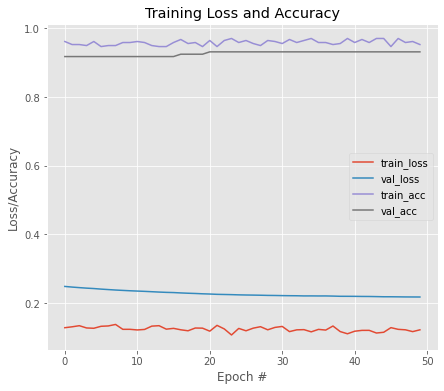


Model Performance Summary:

Best Validation accuracy:0.931506872177124 at EPOCH:21
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.8912 - accuracy: 0.6047
Epoch 1: val_accuracy improved from -inf to 0.74658, saving model to vgg16_wt.hdf5
11/11 [==============================] - 7s 550ms/step - loss: 0.8912 - accuracy: 0.6047 - val_loss: 0.5698 - val_accuracy: 0.7466
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.6375 - accuracy: 0.7168
Epoch 2: val_accuracy did not improve from 0.74658
11/11 [==============================] - 6s 495ms/step - loss: 0.6375 - accuracy: 0.7168 - val_loss: 0.5212 - val_accuracy: 0.7055
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.4734 - accuracy: 0.7906
Epoch 3: val_accuracy improved from 0.74658 to 0.88356, saving model to vgg16_wt.hdf5
11/11 [==============================] - 6s 524ms/step - loss: 0.4734 - accuracy: 0.7906 - val_loss: 0.29

In [ ]:
model_obj = HIGH_LEVEL_MODEL('vgg16')
model_obj.train_phase(training_images,training_label,test_images,test_label,data_aug=True)

In [ ]:
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
RIM_ONE_R2_DIR= '/content/gdrive/My Drive/MSC_Project/Dataset/RIMONE-db-r2'

def get_rim_one_db_r2(width,height,test_train_ratio = 0.2,histogram_eq = False):
  print(f"Height:{height} Width:{width}")
  class_labels = {}
  training_images,training_labels = process_image(RIM_ONE_R2_DIR,
                                                  class_labels,
                                                  width,height)
  
  training_label = (pd.Series(training_labels).map(class_labels)).values
  #training_label = to_categorical(training_label.astype('float32'))
  training_images = training_images.reshape(-1, width, width, 3).astype('float32')

  X_train, X_test, y_train, y_test = train_test_split(training_images, 
                                                      training_label, 
                                                      test_size=test_train_ratio, 
                                                      random_state=100)

  return (X_train,y_train),(X_test,y_test)

1 - MAY - 2022

Resize Image to 224*224*3 as per paper

In [ ]:
trainx1,trainy1,testx1,testy1 = get_rim_one_dl_dataset(width = 224, height = 224)

In [ ]:
MODEL_LIST_1 = ['InceptionV3','vgg16','vgg19',]
MODEL_LIST_2 = ['xception','InceptionResNetV2','resnet50']
MODEL_LIST_3 = ['MobileNet','MobileNetV2','DenseNet121']

87924736/87910968 [==============================] - 1s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7657 - accuracy: 0.5240
Epoch 1: val_loss improved from inf to 0.69394, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 12s 578ms/step - loss: 0.7657 - accuracy: 0.5240 - val_loss: 0.6939 - val_accuracy: 0.5441
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6753 - accuracy: 0.6089
Epoch 2: val_loss improved from 0.69394 to 0.68194, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 4s 395ms/step - loss: 0.6753 - accuracy: 0.6089 - val_loss: 0.6819 - val_accuracy: 0.5294
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6991 - accuracy: 0.5978
Epoch 3: val_loss improved from 0.68194 to 0.67605, saving model to InceptionV3_a_0.hdf5
9/9 [==============================] - 4s 402ms/step - loss: 0.6991 - accuracy: 0.5978 - val_loss: 0.6761 - val_accuracy:

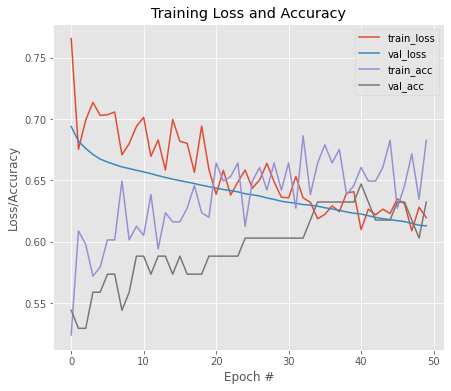


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:41
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6461 - accuracy: 0.6273
Epoch 1: val_loss improved from inf to 0.63201, saving model to InceptionV3_b_0.hdf5
9/9 [==============================] - 20s 623ms/step - loss: 0.6461 - accuracy: 0.6273 - val_loss: 0.6320 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5781 - accuracy: 0.7196
Epoch 2: val_loss did not improve from 0.63201
9/9 [==============================] - 3s 337ms/step - loss: 0.5781 - accuracy: 0.7196 - val_loss: 0.6543 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5640 - accuracy: 0.7085
Epoch 3: val_loss did not improve from 0.63201
9/9 [==============================] - 3s 334ms/step - loss: 0.5640 - accuracy: 0.7085 - val_loss: 0.6542 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.5109

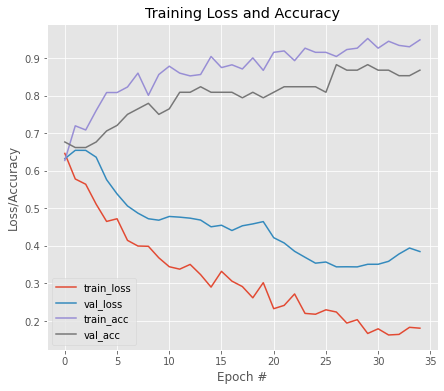


Model Performance Summary:

Best Validation accuracy:0.8823529481887817 at EPOCH:27
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2021 - accuracy: 0.9262
Epoch 1: val_loss improved from inf to 0.10625, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 19s 664ms/step - loss: 0.2021 - accuracy: 0.9262 - val_loss: 0.1063 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1788 - accuracy: 0.9446
Epoch 2: val_loss improved from 0.10625 to 0.09954, saving model to InceptionV3_a_1.hdf5
9/9 [==============================] - 4s 458ms/step - loss: 0.1788 - accuracy: 0.9446 - val_loss: 0.0995 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1845 - accuracy: 0.9336
Epoch 3: val_loss did not improve from 0.09954
9/9 [==============================] - 3s 344ms/step - loss: 0.1845 - accuracy: 0.9336 - val_loss: 0.1017 - val_accuracy: 0.9706
Epoch 4/50
9/9

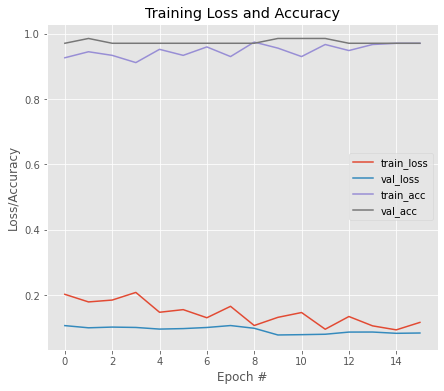


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1117 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.07642, saving model to InceptionV3_b_1.hdf5
9/9 [==============================] - 18s 618ms/step - loss: 0.1117 - accuracy: 0.9631 - val_loss: 0.0764 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1124 - accuracy: 0.9594
Epoch 2: val_loss did not improve from 0.07642
9/9 [==============================] - 3s 339ms/step - loss: 0.1124 - accuracy: 0.9594 - val_loss: 0.0799 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1206 - accuracy: 0.9557
Epoch 3: val_loss did not improve from 0.07642
9/9 [==============================] - 3s 339ms/step - loss: 0.1206 - accuracy: 0.9557 - val_loss: 0.0862 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0865 

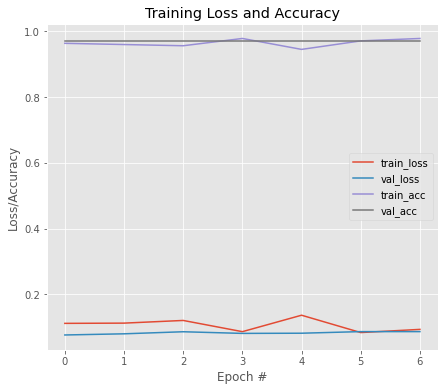


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1264 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 0.04814, saving model to InceptionV3_a_2.hdf5
9/9 [==============================] - 18s 610ms/step - loss: 0.1264 - accuracy: 0.9594 - val_loss: 0.0481 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1194 - accuracy: 0.9668
Epoch 2: val_loss did not improve from 0.04814
9/9 [==============================] - 3s 358ms/step - loss: 0.1194 - accuracy: 0.9668 - val_loss: 0.0628 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0885 - accuracy: 0.9705
Epoch 3: val_loss did not improve from 0.04814
9/9 [==============================] - 3s 333ms/step - loss: 0.0885 - accuracy: 0.9705 - val_loss: 0.0760 - val_accuracy: 0.9706
Epoch 4/50
9/9 [==============================] - ETA: 0s 

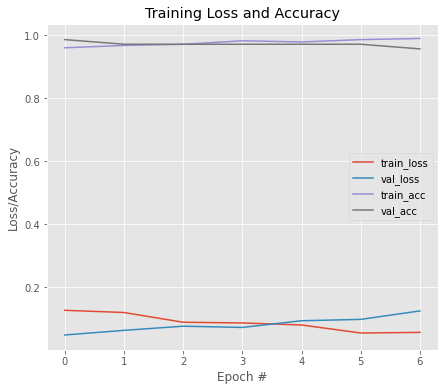


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0857 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 0.05733, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 18s 622ms/step - loss: 0.0857 - accuracy: 0.9742 - val_loss: 0.0573 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0722 - accuracy: 0.9779
Epoch 2: val_loss did not improve from 0.05733
9/9 [==============================] - 3s 326ms/step - loss: 0.0722 - accuracy: 0.9779 - val_loss: 0.0613 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0662 - accuracy: 0.9779
Epoch 3: val_loss improved from 0.05733 to 0.04955, saving model to InceptionV3_b_2.hdf5
9/9 [==============================] - 4s 452ms/step - loss: 0.0662 - accuracy: 0.9779 - val_loss: 0.0495 - val_accuracy: 0.9853
Epoch 4/50
9/9 [===============

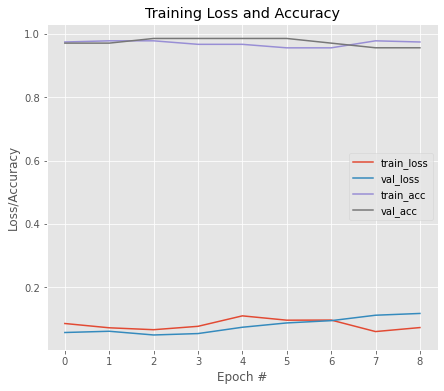


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:3
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0742 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.02697, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 18s 627ms/step - loss: 0.0742 - accuracy: 0.9852 - val_loss: 0.0270 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0469 - accuracy: 0.9852
Epoch 2: val_loss improved from 0.02697 to 0.02501, saving model to InceptionV3_a_3.hdf5
9/9 [==============================] - 4s 457ms/step - loss: 0.0469 - accuracy: 0.9852 - val_loss: 0.0250 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0360 - accuracy: 0.9852
Epoch 3: val_loss did not improve from 0.02501
9/9 [==============================] - 3s 331ms/step - loss: 0.0360 - accuracy: 0.9852 - val_loss: 0.0258 - val_accuracy: 1.0000
Epoch 4/50
9/9 

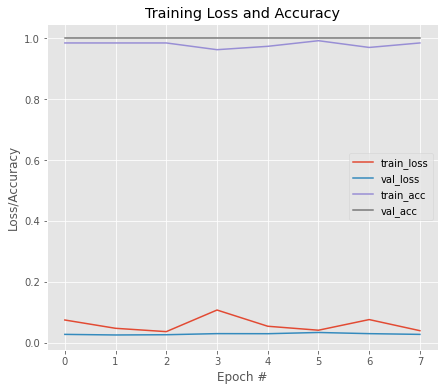


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0479 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.02681, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 18s 609ms/step - loss: 0.0479 - accuracy: 0.9852 - val_loss: 0.0268 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0426 - accuracy: 0.9963
Epoch 2: val_loss improved from 0.02681 to 0.02422, saving model to InceptionV3_b_3.hdf5
9/9 [==============================] - 4s 491ms/step - loss: 0.0426 - accuracy: 0.9963 - val_loss: 0.0242 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0337 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.02422
9/9 [==============================] - 3s 329ms/step - loss: 0.0337 - accuracy: 0.9963 - val_loss: 0.0272 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================

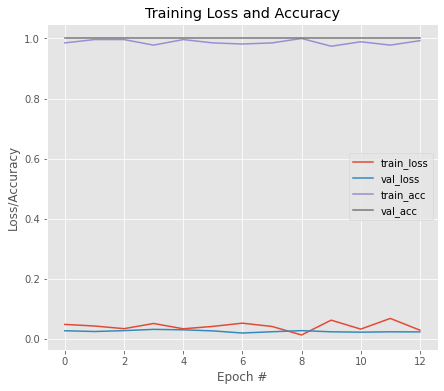


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0866 - accuracy: 0.9706
Epoch 1: val_loss improved from inf to 0.01425, saving model to InceptionV3_a_4.hdf5
9/9 [==============================] - 19s 700ms/step - loss: 0.0866 - accuracy: 0.9706 - val_loss: 0.0142 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0436 - accuracy: 0.9890
Epoch 2: val_loss did not improve from 0.01425
9/9 [==============================] - 3s 358ms/step - loss: 0.0436 - accuracy: 0.9890 - val_loss: 0.0155 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0342 - accuracy: 0.9890
Epoch 3: val_loss did not improve from 0.01425
9/9 [==============================] - 3s 363ms/step - loss: 0.0342 - accuracy: 0.9890 - val_loss: 0.0160 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0658

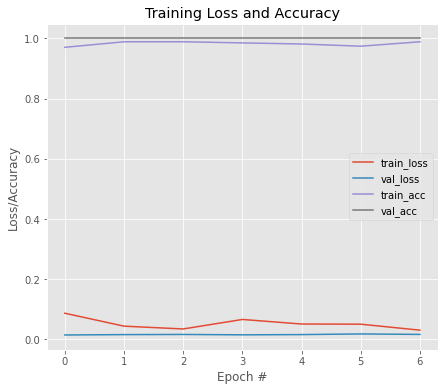


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0378 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.01565, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 18s 612ms/step - loss: 0.0378 - accuracy: 0.9853 - val_loss: 0.0156 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0360 - accuracy: 0.9890
Epoch 2: val_loss did not improve from 0.01565
9/9 [==============================] - 3s 367ms/step - loss: 0.0360 - accuracy: 0.9890 - val_loss: 0.0163 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0622 - accuracy: 0.9706
Epoch 3: val_loss improved from 0.01565 to 0.01389, saving model to InceptionV3_b_4.hdf5
9/9 [==============================] - 4s 450ms/step - loss: 0.0622 - accuracy: 0.9706 - val_loss: 0.0139 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================

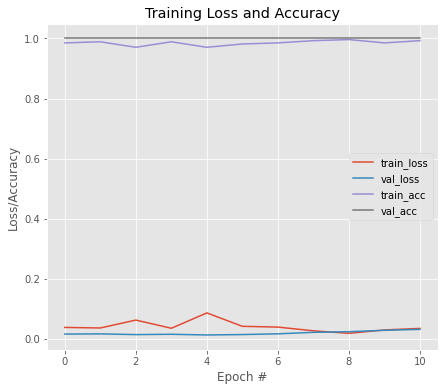


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9676470518112182
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0280 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.25393, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 11s 559ms/step - loss: 0.0280 - accuracy: 0.9853 - val_loss: 0.2539 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0293 - accuracy: 0.9912
Epoch 2: val_loss improved from 0.25393 to 0.25379, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 4s 395ms/step - loss: 0.0293 - accuracy: 0.9912 - val_loss: 0.2538 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0366 - accuracy: 0.9912
Epoch 3: val_loss improved from 0.25379 to 0.25336, saving model to InceptionV3_wt.hdf5
11/11 [=======

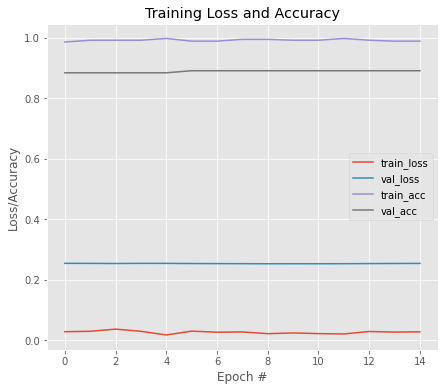


Model Performance Summary:

Best Validation accuracy:0.8904109597206116 at EPOCH:6
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0252 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.32273, saving model to InceptionV3_wt.hdf5
11/11 [==============================] - 19s 605ms/step - loss: 0.0252 - accuracy: 0.9971 - val_loss: 0.3227 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0726 - accuracy: 0.9705
Epoch 2: val_loss did not improve from 0.32273
11/11 [==============================] - 4s 347ms/step - loss: 0.0726 - accuracy: 0.9705 - val_loss: 0.3324 - val_accuracy: 0.8767
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0778 - accuracy: 0.9735
Epoch 3: val_loss did not improve from 0.32273
11/11 [==============================] - 4s 349ms/step - loss: 0.0778 - accuracy: 0.9735 - val_loss: 0.3294 - val_accuracy: 0.8836
Epoch 4/50
11/1

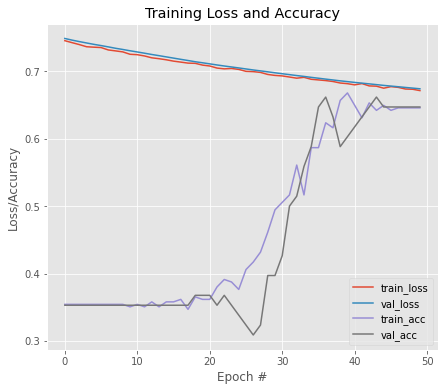


Model Performance Summary:

Best Validation accuracy:0.6617646813392639 at EPOCH:37
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6375 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.62009, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 7s 453ms/step - loss: 0.6375 - accuracy: 0.6494 - val_loss: 0.6201 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6164 - accuracy: 0.6716
Epoch 2: val_loss improved from 0.62009 to 0.60028, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 4s 393ms/step - loss: 0.6164 - accuracy: 0.6716 - val_loss: 0.6003 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6112 - accuracy: 0.7085
Epoch 3: val_loss improved from 0.60028 to 0.57287, saving model to vgg16_b_0.hdf5
9/9 [==============================] - 4s 386ms/step - loss: 0.6112 - accuracy: 0.7085 - val_loss: 0.5729 - val_accuracy: 0.7353
Epoch 4

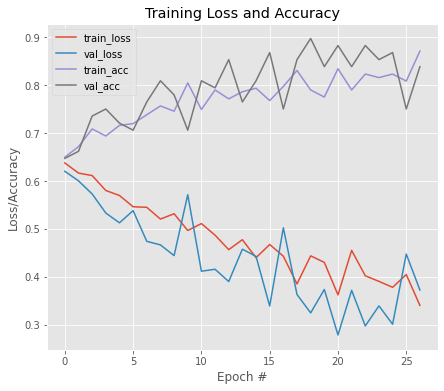


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:19
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5141 - accuracy: 0.7269
Epoch 1: val_loss improved from inf to 0.22598, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 5s 400ms/step - loss: 0.5141 - accuracy: 0.7269 - val_loss: 0.2260 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3401 - accuracy: 0.8229
Epoch 2: val_loss improved from 0.22598 to 0.22519, saving model to vgg16_a_1.hdf5
9/9 [==============================] - 4s 388ms/step - loss: 0.3401 - accuracy: 0.8229 - val_loss: 0.2252 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3859 - accuracy: 0.8303
Epoch 3: val_loss did not improve from 0.22519
9/9 [==============================] - 3s 340ms/step - loss: 0.3859 - accuracy: 0.8303 - val_loss: 0.4605 - val_accuracy: 0.7794
Epoch 4/50
9/9 [===========

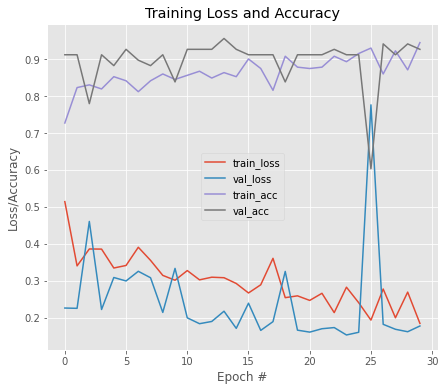


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:14
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4648 - accuracy: 0.8672
Epoch 1: val_loss improved from inf to 0.14433, saving model to vgg16_b_1.hdf5
9/9 [==============================] - 5s 390ms/step - loss: 0.4648 - accuracy: 0.8672 - val_loss: 0.1443 - val_accuracy: 0.9265
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2003 - accuracy: 0.9188
Epoch 2: val_loss did not improve from 0.14433
9/9 [==============================] - 3s 330ms/step - loss: 0.2003 - accuracy: 0.9188 - val_loss: 0.2333 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2045 - accuracy: 0.9114
Epoch 3: val_loss did not improve from 0.14433
9/9 [==============================] - 3s 367ms/step - loss: 0.2045 - accuracy: 0.9114 - val_loss: 0.1674 - val_accuracy: 0.9118
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1853 - accu

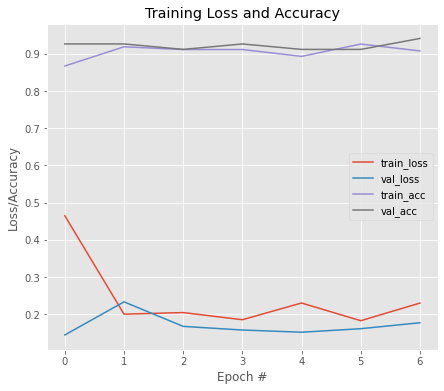


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:7
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3665 - accuracy: 0.9004
Epoch 1: val_loss improved from inf to 0.18596, saving model to vgg16_a_2.hdf5
9/9 [==============================] - 5s 404ms/step - loss: 0.3665 - accuracy: 0.9004 - val_loss: 0.1860 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1620 - accuracy: 0.9336
Epoch 2: val_loss did not improve from 0.18596
9/9 [==============================] - 3s 347ms/step - loss: 0.1620 - accuracy: 0.9336 - val_loss: 0.1898 - val_accuracy: 0.8971
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1732 - accuracy: 0.9262
Epoch 3: val_loss did not improve from 0.18596
9/9 [==============================] - 3s 348ms/step - loss: 0.1732 - accuracy: 0.9262 - val_loss: 0.2842 - val_accuracy: 0.8824
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

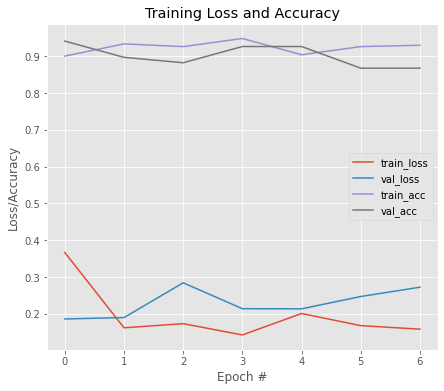


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3988 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 0.18863, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 6s 405ms/step - loss: 0.3988 - accuracy: 0.8967 - val_loss: 0.1886 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1722 - accuracy: 0.9336
Epoch 2: val_loss improved from 0.18863 to 0.18772, saving model to vgg16_b_2.hdf5
9/9 [==============================] - 4s 385ms/step - loss: 0.1722 - accuracy: 0.9336 - val_loss: 0.1877 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1783 - accuracy: 0.9336
Epoch 3: val_loss did not improve from 0.18772
9/9 [==============================] - 3s 351ms/step - loss: 0.1783 - accuracy: 0.9336 - val_loss: 0.2088 - val_accuracy: 0.8824
Epoch 4/50
9/9 [============================

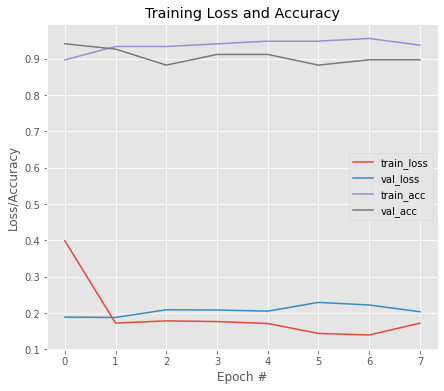


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4629 - accuracy: 0.8819
Epoch 1: val_loss improved from inf to 0.15907, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 5s 405ms/step - loss: 0.4629 - accuracy: 0.8819 - val_loss: 0.1591 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1647 - accuracy: 0.9373
Epoch 2: val_loss improved from 0.15907 to 0.15187, saving model to vgg16_a_3.hdf5
9/9 [==============================] - 4s 387ms/step - loss: 0.1647 - accuracy: 0.9373 - val_loss: 0.1519 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1080 - accuracy: 0.9668
Epoch 3: val_loss did not improve from 0.15187
9/9 [==============================] - 3s 349ms/step - loss: 0.1080 - accuracy: 0.9668 - val_loss: 0.1778 - val_accuracy: 0.8824
Epoch 4/50
9/9 [============

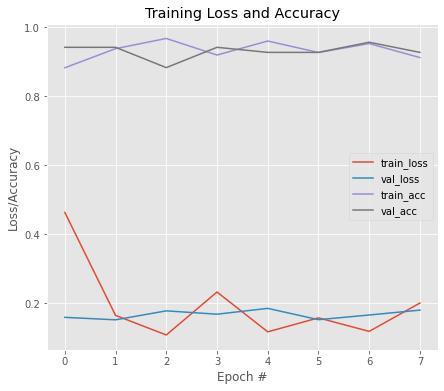


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:7
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3082 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 0.17236, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 5s 404ms/step - loss: 0.3082 - accuracy: 0.8967 - val_loss: 0.1724 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1454 - accuracy: 0.9520
Epoch 2: val_loss improved from 0.17236 to 0.16517, saving model to vgg16_b_3.hdf5
9/9 [==============================] - 4s 384ms/step - loss: 0.1454 - accuracy: 0.9520 - val_loss: 0.1652 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1942 - accuracy: 0.9336
Epoch 3: val_loss did not improve from 0.16517
9/9 [==============================] - 3s 351ms/step - loss: 0.1942 - accuracy: 0.9336 - val_loss: 0.1789 - val_accuracy: 0.8971
Epoch 4/50
9/9 [============================

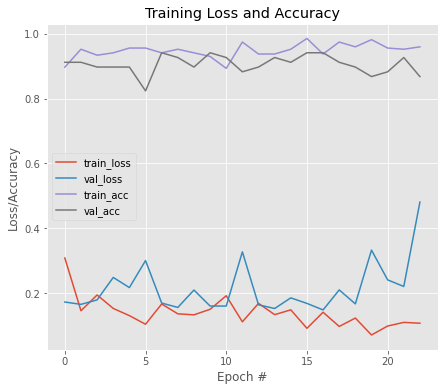


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:7
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2875 - accuracy: 0.8860
Epoch 1: val_loss improved from inf to 0.06171, saving model to vgg16_a_4.hdf5
9/9 [==============================] - 6s 526ms/step - loss: 0.2875 - accuracy: 0.8860 - val_loss: 0.0617 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1286 - accuracy: 0.9485
Epoch 2: val_loss did not improve from 0.06171
9/9 [==============================] - 3s 346ms/step - loss: 0.1286 - accuracy: 0.9485 - val_loss: 0.0858 - val_accuracy: 0.9552
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1286 - accuracy: 0.9412
Epoch 3: val_loss did not improve from 0.06171
9/9 [==============================] - 3s 351ms/step - loss: 0.1286 - accuracy: 0.9412 - val_loss: 0.2530 - val_accuracy: 0.8507
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

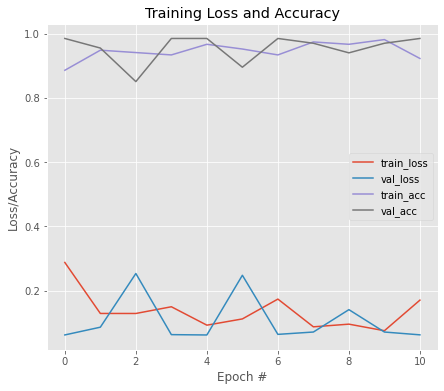


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1830 - accuracy: 0.9081
Epoch 1: val_loss improved from inf to 0.11456, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 5s 402ms/step - loss: 0.1830 - accuracy: 0.9081 - val_loss: 0.1146 - val_accuracy: 0.9552
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1206 - accuracy: 0.9522
Epoch 2: val_loss did not improve from 0.11456
9/9 [==============================] - 3s 345ms/step - loss: 0.1206 - accuracy: 0.9522 - val_loss: 0.1360 - val_accuracy: 0.9254
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0997 - accuracy: 0.9632
Epoch 3: val_loss improved from 0.11456 to 0.05321, saving model to vgg16_b_4.hdf5
9/9 [==============================] - 4s 390ms/step - loss: 0.0997 - accuracy: 0.9632 - val_loss: 0.0532 - val_accuracy: 0.9851
Epoch 4/50
9/9 [============================

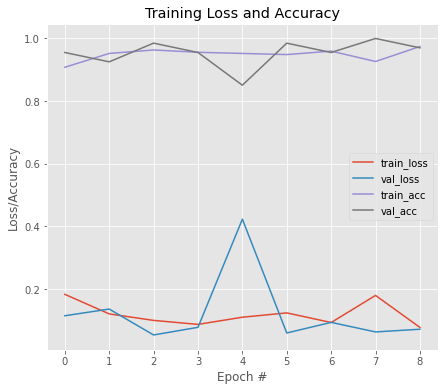


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:8
Average Accuracy:0.9441176533699036
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0591 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.23057, saving model to vgg16_wt.hdf5
11/11 [==============================] - 6s 460ms/step - loss: 0.0591 - accuracy: 0.9853 - val_loss: 0.2306 - val_accuracy: 0.9110
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0630 - accuracy: 0.9823
Epoch 2: val_loss did not improve from 0.23057
11/11 [==============================] - 4s 358ms/step - loss: 0.0630 - accuracy: 0.9823 - val_loss: 0.2306 - val_accuracy: 0.9110
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0729 - accuracy: 0.9794
Epoch 3: val_loss did not improve from 0.23057
11/11 [==============================] - 4s 358ms/step - loss: 0.0729 - accuracy: 0.9794 - val_loss: 0.

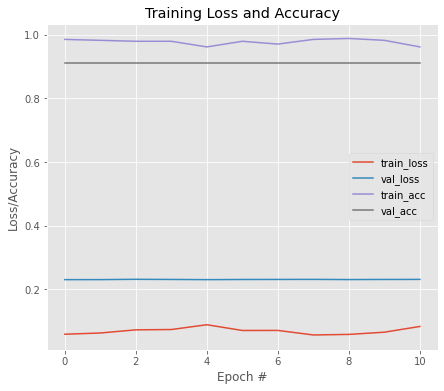


Model Performance Summary:

Best Validation accuracy:0.9109588861465454 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.7770 - accuracy: 0.8319
Epoch 1: val_loss improved from inf to 0.22706, saving model to vgg16_wt.hdf5
11/11 [==============================] - 7s 417ms/step - loss: 0.7770 - accuracy: 0.8319 - val_loss: 0.2271 - val_accuracy: 0.9178
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1961 - accuracy: 0.9263
Epoch 2: val_loss did not improve from 0.22706
11/11 [==============================] - 4s 367ms/step - loss: 0.1961 - accuracy: 0.9263 - val_loss: 0.2279 - val_accuracy: 0.9110
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0922 - accuracy: 0.9794
Epoch 3: val_loss did not improve from 0.22706
11/11 [==============================] - 4s 367ms/step - loss: 0.0922 - accuracy: 0.9794 - val_loss: 0.4239 - val_accuracy: 0.8630
Epoch 4/50
11/11 [====

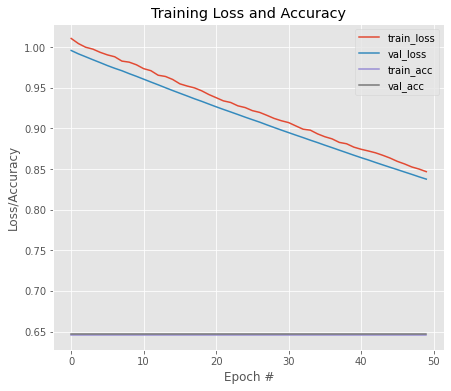


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6726 - accuracy: 0.6421
Epoch 1: val_loss improved from inf to 0.61994, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 6s 427ms/step - loss: 0.6726 - accuracy: 0.6421 - val_loss: 0.6199 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6260 - accuracy: 0.6568
Epoch 2: val_loss improved from 0.61994 to 0.60974, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 4s 415ms/step - loss: 0.6260 - accuracy: 0.6568 - val_loss: 0.6097 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6266 - accuracy: 0.6605
Epoch 3: val_loss improved from 0.60974 to 0.60230, saving model to vgg19_b_0.hdf5
9/9 [==============================] - 4s 415ms/step - loss: 0.6266 - accuracy: 0.6605 - val_loss: 0.6023 - val_accuracy: 0.7647
Epoch 4/

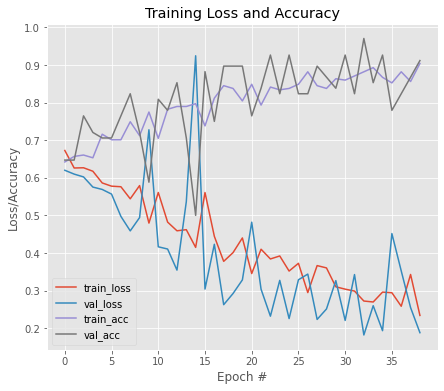


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:33
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.5189 - accuracy: 0.8007
Epoch 1: val_loss improved from inf to 0.19944, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 6s 431ms/step - loss: 0.5189 - accuracy: 0.8007 - val_loss: 0.1994 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2858 - accuracy: 0.8561
Epoch 2: val_loss improved from 0.19944 to 0.10043, saving model to vgg19_a_1.hdf5
9/9 [==============================] - 4s 441ms/step - loss: 0.2858 - accuracy: 0.8561 - val_loss: 0.1004 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2943 - accuracy: 0.8856
Epoch 3: val_loss did not improve from 0.10043
9/9 [==============================] - 3s 362ms/step - loss: 0.2943 - accuracy: 0.8856 - val_loss: 0.1136 - val_accuracy: 1.0000
Epoch 4/50
9/9 [============

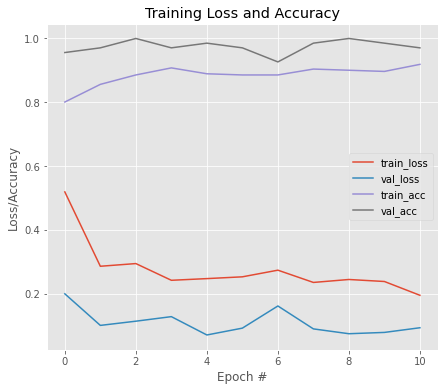


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4764 - accuracy: 0.8413
Epoch 1: val_loss improved from inf to 0.07583, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 6s 429ms/step - loss: 0.4764 - accuracy: 0.8413 - val_loss: 0.0758 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2149 - accuracy: 0.9114
Epoch 2: val_loss did not improve from 0.07583
9/9 [==============================] - 3s 356ms/step - loss: 0.2149 - accuracy: 0.9114 - val_loss: 0.0779 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2221 - accuracy: 0.9077
Epoch 3: val_loss improved from 0.07583 to 0.07214, saving model to vgg19_b_1.hdf5
9/9 [==============================] - 4s 416ms/step - loss: 0.2221 - accuracy: 0.9077 - val_loss: 0.0721 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s -

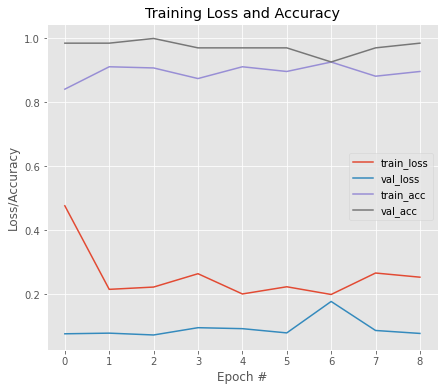


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3610 - accuracy: 0.8856
Epoch 1: val_loss improved from inf to 0.19165, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 6s 448ms/step - loss: 0.3610 - accuracy: 0.8856 - val_loss: 0.1916 - val_accuracy: 0.9265
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1358 - accuracy: 0.9557
Epoch 2: val_loss did not improve from 0.19165
9/9 [==============================] - 3s 357ms/step - loss: 0.1358 - accuracy: 0.9557 - val_loss: 0.2968 - val_accuracy: 0.8529
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1830 - accuracy: 0.9114
Epoch 3: val_loss improved from 0.19165 to 0.18428, saving model to vgg19_a_2.hdf5
9/9 [==============================] - 4s 411ms/step - loss: 0.1830 - accuracy: 0.9114 - val_loss: 0.1843 - val_accuracy: 0.9118
Epoch 4/50
9/9 [===========================

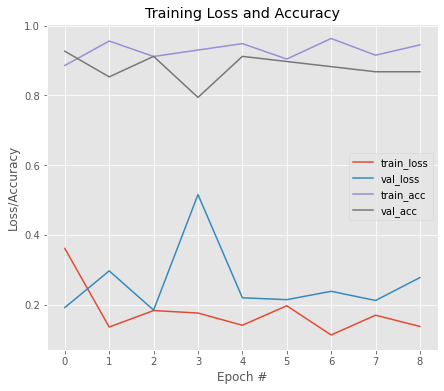


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3920 - accuracy: 0.8930
Epoch 1: val_loss improved from inf to 0.22761, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 6s 436ms/step - loss: 0.3920 - accuracy: 0.8930 - val_loss: 0.2276 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1267 - accuracy: 0.9631
Epoch 2: val_loss improved from 0.22761 to 0.22020, saving model to vgg19_b_2.hdf5
9/9 [==============================] - 4s 402ms/step - loss: 0.1267 - accuracy: 0.9631 - val_loss: 0.2202 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1827 - accuracy: 0.9299
Epoch 3: val_loss did not improve from 0.22020
9/9 [==============================] - 3s 357ms/step - loss: 0.1827 - accuracy: 0.9299 - val_loss: 0.5775 - val_accuracy: 0.7794
Epoch 4/50
9/9 [============================

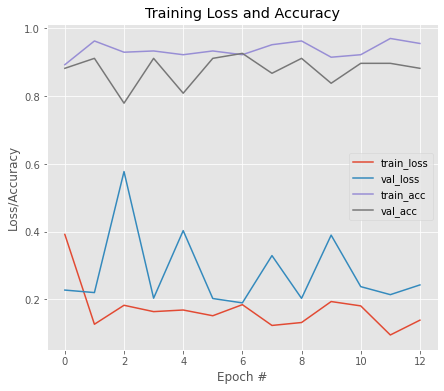


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:7
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.8914 - accuracy: 0.9077
Epoch 1: val_loss improved from inf to 0.10075, saving model to vgg19_a_3.hdf5
9/9 [==============================] - 6s 435ms/step - loss: 0.8914 - accuracy: 0.9077 - val_loss: 0.1007 - val_accuracy: 0.9706
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1310 - accuracy: 0.9410
Epoch 2: val_loss did not improve from 0.10075
9/9 [==============================] - 3s 360ms/step - loss: 0.1310 - accuracy: 0.9410 - val_loss: 0.1603 - val_accuracy: 0.9265
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1627 - accuracy: 0.9336
Epoch 3: val_loss did not improve from 0.10075
9/9 [==============================] - 4s 364ms/step - loss: 0.1627 - accuracy: 0.9336 - val_loss: 0.1172 - val_accuracy: 0.9265
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss

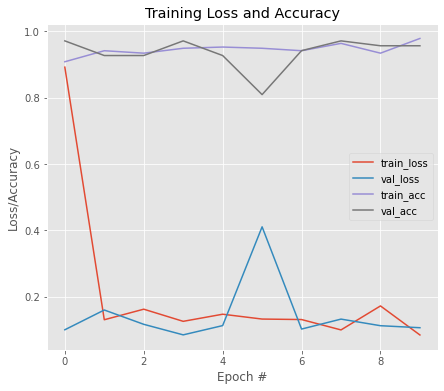


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3288 - accuracy: 0.8708
Epoch 1: val_loss improved from inf to 0.13325, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 6s 426ms/step - loss: 0.3288 - accuracy: 0.8708 - val_loss: 0.1332 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1123 - accuracy: 0.9483
Epoch 2: val_loss improved from 0.13325 to 0.10490, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 4s 403ms/step - loss: 0.1123 - accuracy: 0.9483 - val_loss: 0.1049 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1063 - accuracy: 0.9520
Epoch 3: val_loss improved from 0.10490 to 0.09512, saving model to vgg19_b_3.hdf5
9/9 [==============================] - 4s 411ms/step - loss: 0.1063 - accuracy: 0.9520 - val_loss: 0.0951 - val_accuracy: 0.9559
Epoch 4/5

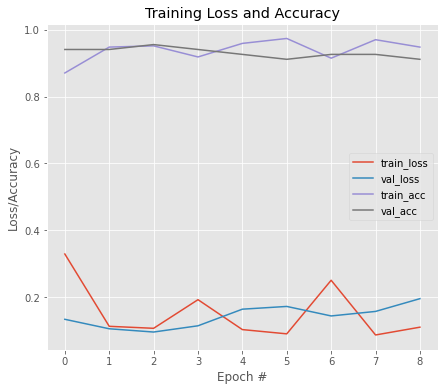


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:3
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2766 - accuracy: 0.9228
Epoch 1: val_loss improved from inf to 0.06665, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 6s 421ms/step - loss: 0.2766 - accuracy: 0.9228 - val_loss: 0.0667 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0916 - accuracy: 0.9596
Epoch 2: val_loss improved from 0.06665 to 0.06621, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 4s 412ms/step - loss: 0.0916 - accuracy: 0.9596 - val_loss: 0.0662 - val_accuracy: 0.9552
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1455 - accuracy: 0.9412
Epoch 3: val_loss improved from 0.06621 to 0.03995, saving model to vgg19_a_4.hdf5
9/9 [==============================] - 4s 410ms/step - loss: 0.1455 - accuracy: 0.9412 - val_loss: 0.0399 - val_accuracy:

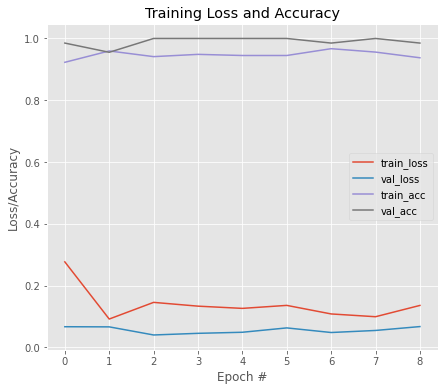


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3323 - accuracy: 0.9118
Epoch 1: val_loss improved from inf to 0.06014, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 6s 433ms/step - loss: 0.3323 - accuracy: 0.9118 - val_loss: 0.0601 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0934 - accuracy: 0.9559
Epoch 2: val_loss did not improve from 0.06014
9/9 [==============================] - 3s 363ms/step - loss: 0.0934 - accuracy: 0.9559 - val_loss: 0.0912 - val_accuracy: 0.9701
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1677 - accuracy: 0.9375
Epoch 3: val_loss improved from 0.06014 to 0.04461, saving model to vgg19_b_4.hdf5
9/9 [==============================] - 4s 415ms/step - loss: 0.1677 - accuracy: 0.9375 - val_loss: 0.0446 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s -

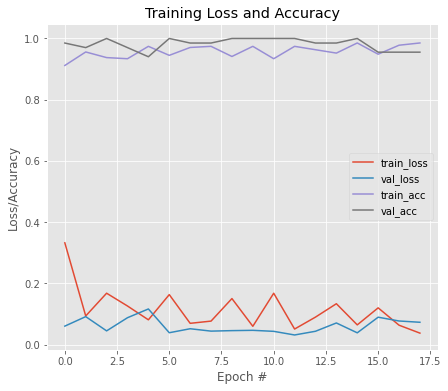


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:3
Average Accuracy:0.970588231086731
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1550 - accuracy: 0.9499
Epoch 1: val_loss improved from inf to 0.22834, saving model to vgg19_wt.hdf5
11/11 [==============================] - 5s 401ms/step - loss: 0.1550 - accuracy: 0.9499 - val_loss: 0.2283 - val_accuracy: 0.9247
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1778 - accuracy: 0.9351
Epoch 2: val_loss did not improve from 0.22834
11/11 [==============================] - 4s 368ms/step - loss: 0.1778 - accuracy: 0.9351 - val_loss: 0.2285 - val_accuracy: 0.9247
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1570 - accuracy: 0.9528
Epoch 3: val_loss did not improve from 0.22834
11/11 [==============================] - 4s 375ms/step - loss: 0.1570 - accuracy: 0.9528 - val_loss: 0.2

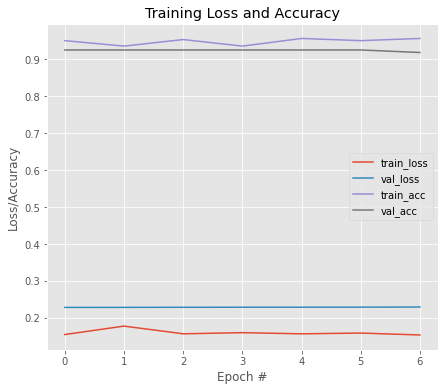


Model Performance Summary:

Best Validation accuracy:0.9246575236320496 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.8858 - accuracy: 0.8024
Epoch 1: val_loss improved from inf to 0.37765, saving model to vgg19_wt.hdf5
11/11 [==============================] - 7s 466ms/step - loss: 0.8858 - accuracy: 0.8024 - val_loss: 0.3777 - val_accuracy: 0.8151
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.3850 - accuracy: 0.8201
Epoch 2: val_loss improved from 0.37765 to 0.34145, saving model to vgg19_wt.hdf5
11/11 [==============================] - 5s 419ms/step - loss: 0.3850 - accuracy: 0.8201 - val_loss: 0.3414 - val_accuracy: 0.8219
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2625 - accuracy: 0.8968
Epoch 3: val_loss did not improve from 0.34145
11/11 [==============================] - 4s 377ms/step - loss: 0.2625 - accuracy: 0.8968 - val_loss: 0.3447 - val_accu

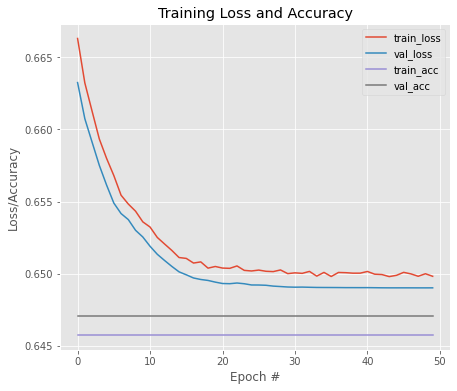


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6729 - accuracy: 0.6015
Epoch 1: val_loss improved from inf to 0.65033, saving model to resnet50_b_0.hdf5
9/9 [==============================] - 18s 552ms/step - loss: 0.6729 - accuracy: 0.6015 - val_loss: 0.6503 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5484 - accuracy: 0.7196
Epoch 2: val_loss did not improve from 0.65033
9/9 [==============================] - 3s 341ms/step - loss: 0.5484 - accuracy: 0.7196 - val_loss: 0.6844 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4844 - accuracy: 0.7749
Epoch 3: val_loss did not improve from 0.65033
9/9 [==============================] - 3s 345ms/step - loss: 0.4844 - accuracy: 0.7749 - val_loss: 0.7030 - val_accuracy: 0.3529
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.4380 - a

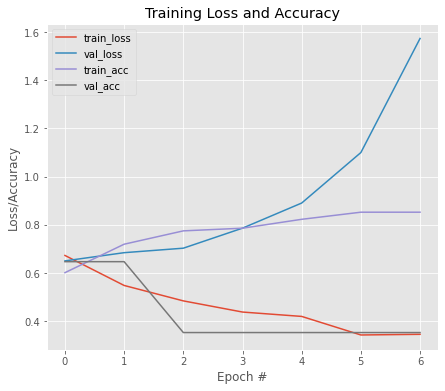


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3273 - accuracy: 0.8708
Epoch 1: val_loss improved from inf to 1.95943, saving model to resnet50_a_1.hdf5
9/9 [==============================] - 17s 581ms/step - loss: 0.3273 - accuracy: 0.8708 - val_loss: 1.9594 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2699 - accuracy: 0.9114
Epoch 2: val_loss did not improve from 1.95943
9/9 [==============================] - 3s 346ms/step - loss: 0.2699 - accuracy: 0.9114 - val_loss: 2.6534 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2467 - accuracy: 0.9114
Epoch 3: val_loss did not improve from 1.95943
9/9 [==============================] - 3s 344ms/step - loss: 0.2467 - accuracy: 0.9114 - val_loss: 3.1054 - val_accuracy: 0.2941
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

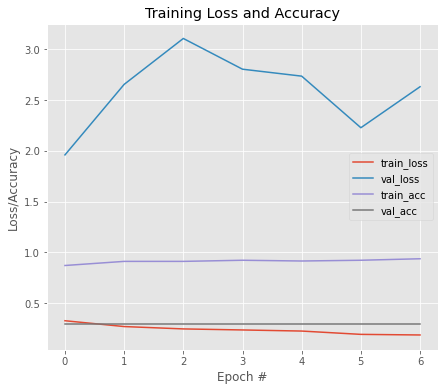


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2666 - accuracy: 0.8967
Epoch 1: val_loss improved from inf to 2.38948, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 17s 565ms/step - loss: 0.2666 - accuracy: 0.8967 - val_loss: 2.3895 - val_accuracy: 0.2941
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2281 - accuracy: 0.9114
Epoch 2: val_loss improved from 2.38948 to 2.02607, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 4s 451ms/step - loss: 0.2281 - accuracy: 0.9114 - val_loss: 2.0261 - val_accuracy: 0.2941
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2310 - accuracy: 0.9188
Epoch 3: val_loss improved from 2.02607 to 2.01779, saving model to resnet50_b_1.hdf5
9/9 [==============================] - 4s 454ms/step - loss: 0.2310 - accuracy: 0.9188 - val_loss: 2.0178 - val_accuracy: 0.29

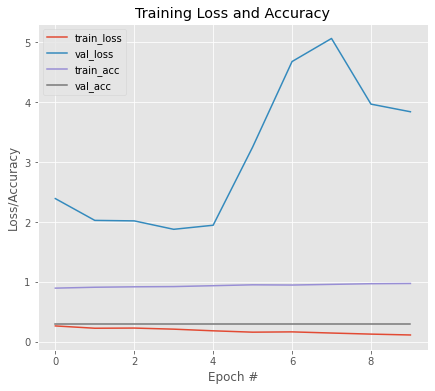


Model Performance Summary:

Best Validation accuracy:0.29411765933036804 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1241 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 4.34286, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 17s 572ms/step - loss: 0.1241 - accuracy: 0.9631 - val_loss: 4.3429 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1632 - accuracy: 0.9520
Epoch 2: val_loss improved from 4.34286 to 3.27957, saving model to resnet50_a_2.hdf5
9/9 [==============================] - 4s 478ms/step - loss: 0.1632 - accuracy: 0.9520 - val_loss: 3.2796 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1036 - accuracy: 0.9705
Epoch 3: val_loss did not improve from 3.27957
9/9 [==============================] - 3s 339ms/step - loss: 0.1036 - accuracy: 0.9705 - val_loss: 3.8532 - val_accuracy: 0.3824
Epoch 4/50
9/9 [====

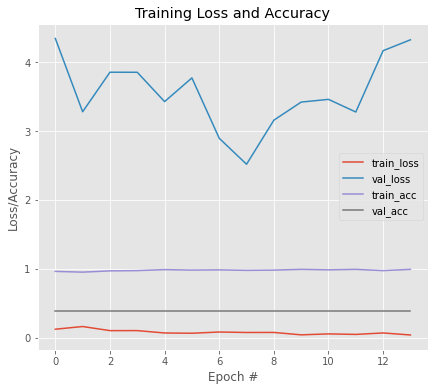


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0563 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 2.06166, saving model to resnet50_b_2.hdf5
9/9 [==============================] - 17s 564ms/step - loss: 0.0563 - accuracy: 0.9852 - val_loss: 2.0617 - val_accuracy: 0.3824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0825 - accuracy: 0.9852
Epoch 2: val_loss did not improve from 2.06166
9/9 [==============================] - 3s 340ms/step - loss: 0.0825 - accuracy: 0.9852 - val_loss: 2.5161 - val_accuracy: 0.3824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0640 - accuracy: 0.9705
Epoch 3: val_loss did not improve from 2.06166
9/9 [==============================] - 3s 373ms/step - loss: 0.0640 - accuracy: 0.9705 - val_loss: 3.0024 - val_accuracy: 0.3824
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0509 - 

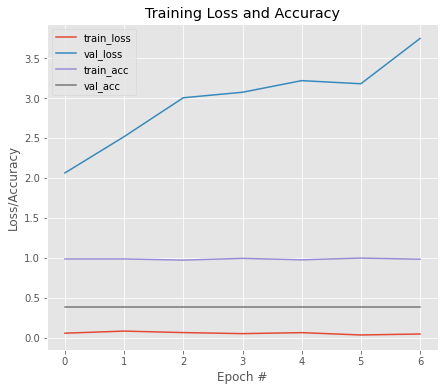


Model Performance Summary:

Best Validation accuracy:0.38235294818878174 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0712 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 3.38478, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 17s 573ms/step - loss: 0.0712 - accuracy: 0.9742 - val_loss: 3.3848 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0337 - accuracy: 0.9963
Epoch 2: val_loss improved from 3.38478 to 3.28882, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 4s 453ms/step - loss: 0.0337 - accuracy: 0.9963 - val_loss: 3.2888 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0304 - accuracy: 0.9889
Epoch 3: val_loss improved from 3.28882 to 2.97868, saving model to resnet50_a_3.hdf5
9/9 [==============================] - 5s 563ms/step - loss: 0.0304 - accuracy: 0.9889 - val_loss: 2.9787 - va

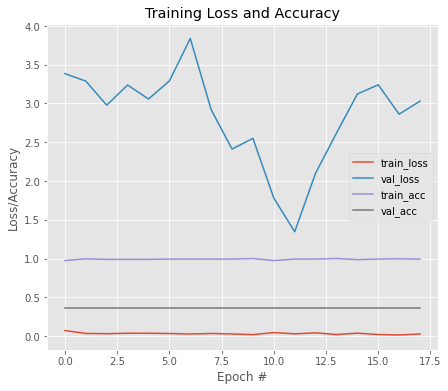


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0400 - accuracy: 0.9889
Epoch 1: val_loss improved from inf to 3.39183, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 17s 571ms/step - loss: 0.0400 - accuracy: 0.9889 - val_loss: 3.3918 - val_accuracy: 0.3676
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0204 - accuracy: 0.9963
Epoch 2: val_loss improved from 3.39183 to 3.11676, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 4s 453ms/step - loss: 0.0204 - accuracy: 0.9963 - val_loss: 3.1168 - val_accuracy: 0.3676
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 1.0000
Epoch 3: val_loss improved from 3.11676 to 2.63869, saving model to resnet50_b_3.hdf5
9/9 [==============================] - 4s 467ms/step - loss: 0.0100 - accuracy: 1.0000 - val_loss: 2.6387 - val_accuracy: 0.36

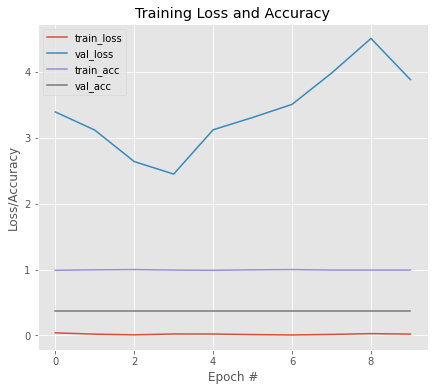


Model Performance Summary:

Best Validation accuracy:0.36764705181121826 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0475 - accuracy: 0.9816
Epoch 1: val_loss improved from inf to 3.77418, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 17s 593ms/step - loss: 0.0475 - accuracy: 0.9816 - val_loss: 3.7742 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0245 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 3.77418
9/9 [==============================] - 3s 334ms/step - loss: 0.0245 - accuracy: 0.9926 - val_loss: 5.1416 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0564 - accuracy: 0.9743
Epoch 3: val_loss improved from 3.77418 to 3.70515, saving model to resnet50_a_4.hdf5
9/9 [==============================] - 4s 463ms/step - loss: 0.0564 - accuracy: 0.9743 - val_loss: 3.7052 - val_accuracy: 0.3731
Epoch 4/50
9/9 [====

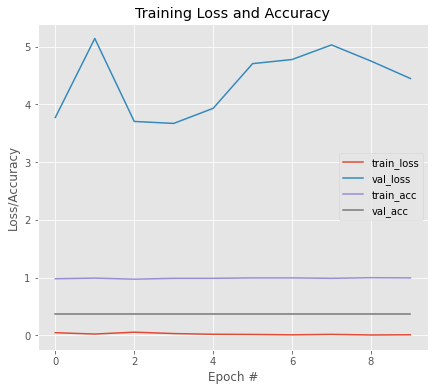


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0259 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 3.17306, saving model to resnet50_b_4.hdf5
9/9 [==============================] - 17s 570ms/step - loss: 0.0259 - accuracy: 0.9926 - val_loss: 3.1731 - val_accuracy: 0.3731
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0193 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 3.17306
9/9 [==============================] - 3s 343ms/step - loss: 0.0193 - accuracy: 0.9926 - val_loss: 3.7091 - val_accuracy: 0.3731
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0263 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 3.17306
9/9 [==============================] - 3s 368ms/step - loss: 0.0263 - accuracy: 0.9963 - val_loss: 4.4290 - val_accuracy: 0.3731
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0136 - a

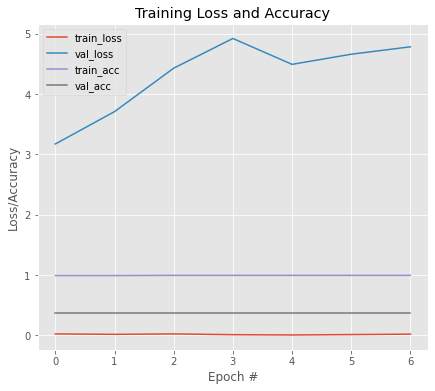


Model Performance Summary:

Best Validation accuracy:0.3731343150138855 at EPOCH:1
Average Accuracy:0.41286216378211976
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.6509 - accuracy: 0.6460
Epoch 1: val_loss improved from inf to 0.65107, saving model to resnet50_wt.hdf5
11/11 [==============================] - 9s 506ms/step - loss: 0.6509 - accuracy: 0.6460 - val_loss: 0.6511 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.6504 - accuracy: 0.6460
Epoch 2: val_loss improved from 0.65107 to 0.65092, saving model to resnet50_wt.hdf5
11/11 [==============================] - 4s 396ms/step - loss: 0.6504 - accuracy: 0.6460 - val_loss: 0.6509 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.6500 - accuracy: 0.6460
Epoch 3: val_loss improved from 0.65092 to 0.65074, saving model to resnet50_wt.hdf5
11/11 [=

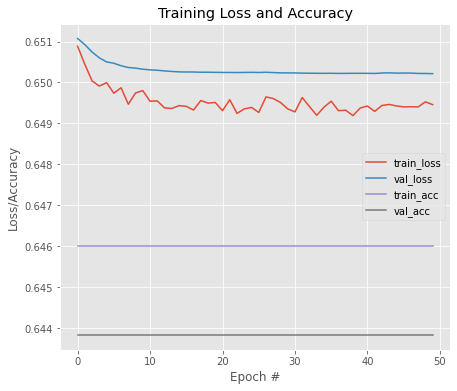


Model Performance Summary:

Best Validation accuracy:0.6438356041908264 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.4779 - accuracy: 0.7699
Epoch 1: val_loss improved from inf to 0.66048, saving model to resnet50_wt.hdf5
11/11 [==============================] - 18s 556ms/step - loss: 0.4779 - accuracy: 0.7699 - val_loss: 0.6605 - val_accuracy: 0.6438
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.3490 - accuracy: 0.8289
Epoch 2: val_loss did not improve from 0.66048
11/11 [==============================] - 4s 353ms/step - loss: 0.3490 - accuracy: 0.8289 - val_loss: 0.6614 - val_accuracy: 0.6438
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.2933 - accuracy: 0.8850
Epoch 3: val_loss improved from 0.66048 to 0.65319, saving model to resnet50_wt.hdf5
11/11 [==============================] - 5s 445ms/step - loss: 0.2933 - accuracy: 0.8850 - val_loss: 0.6532 - v

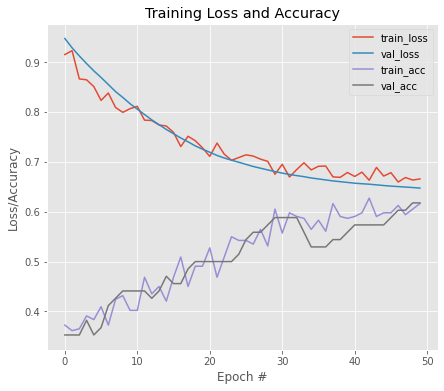


Model Performance Summary:

Best Validation accuracy:0.6176470518112183 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.9000 - accuracy: 0.6458
Epoch 1: val_loss improved from inf to 0.61804, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 30s 760ms/step - loss: 0.9000 - accuracy: 0.6458 - val_loss: 0.6180 - val_accuracy: 0.6324
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.7279 - accuracy: 0.6790
Epoch 2: val_loss improved from 0.61804 to 0.60283, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 4s 481ms/step - loss: 0.7279 - accuracy: 0.6790 - val_loss: 0.6028 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6837 - accuracy: 0.6900
Epoch 3: val_loss improved from 0.60283 to 0.59487, saving model to DenseNet121_b_0.hdf5
9/9 [==============================] - 4s 476ms/step - loss: 0.6837 - accuracy: 0.6900 - val_loss: 0.5949 - val_accur

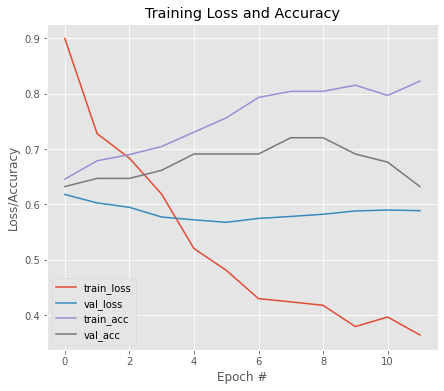


Model Performance Summary:

Best Validation accuracy:0.720588207244873 at EPOCH:8
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3382 - accuracy: 0.8487
Epoch 1: val_loss improved from inf to 0.54794, saving model to DenseNet121_a_1.hdf5
9/9 [==============================] - 29s 728ms/step - loss: 0.3382 - accuracy: 0.8487 - val_loss: 0.5479 - val_accuracy: 0.7353
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3541 - accuracy: 0.8672
Epoch 2: val_loss did not improve from 0.54794
9/9 [==============================] - 3s 348ms/step - loss: 0.3541 - accuracy: 0.8672 - val_loss: 0.5482 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3376 - accuracy: 0.8450
Epoch 3: val_loss did not improve from 0.54794
9/9 [==============================] - 3s 336ms/step - loss: 0.3376 - accuracy: 0.8450 - val_loss: 0.5557 - val_accuracy: 0.7059
Epoch 4/50
9/9 [==============================] - ETA: 0s 

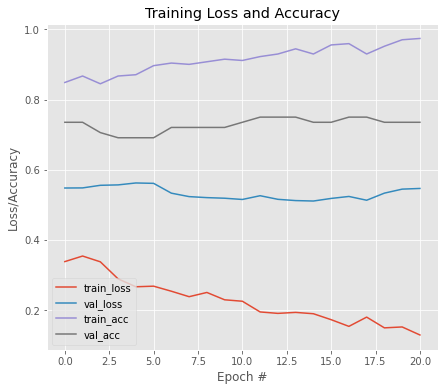


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:12
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1656 - accuracy: 0.9557
Epoch 1: val_loss improved from inf to 0.52072, saving model to DenseNet121_b_1.hdf5
9/9 [==============================] - 29s 721ms/step - loss: 0.1656 - accuracy: 0.9557 - val_loss: 0.5207 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1873 - accuracy: 0.9299
Epoch 2: val_loss did not improve from 0.52072
9/9 [==============================] - 3s 344ms/step - loss: 0.1873 - accuracy: 0.9299 - val_loss: 0.5372 - val_accuracy: 0.7500
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1445 - accuracy: 0.9668
Epoch 3: val_loss did not improve from 0.52072
9/9 [==============================] - 3s 344ms/step - loss: 0.1445 - accuracy: 0.9668 - val_loss: 0.5425 - val_accuracy: 0.7500
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1437 - accuracy: 0

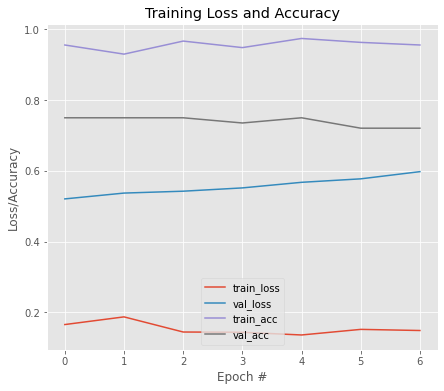


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1965 - accuracy: 0.9151
Epoch 1: val_loss improved from inf to 0.87609, saving model to DenseNet121_a_2.hdf5
9/9 [==============================] - 29s 764ms/step - loss: 0.1965 - accuracy: 0.9151 - val_loss: 0.8761 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1447 - accuracy: 0.9446
Epoch 2: val_loss did not improve from 0.87609
9/9 [==============================] - 3s 345ms/step - loss: 0.1447 - accuracy: 0.9446 - val_loss: 0.8782 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1375 - accuracy: 0.9557
Epoch 3: val_loss improved from 0.87609 to 0.84610, saving model to DenseNet121_a_2.hdf5
9/9 [==============================] - 4s 475ms/step - loss: 0.1375 - accuracy: 0.9557 - val_loss: 0.8461 - val_accuracy: 0.6471
Epoch 4/50
9/9 [=============

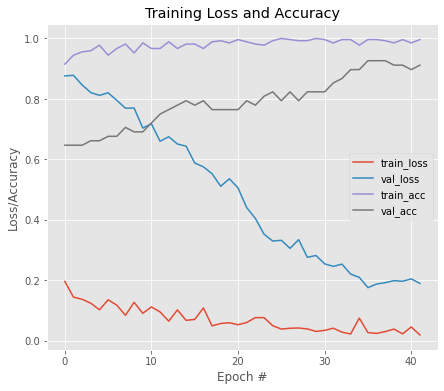


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:36
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0337 - accuracy: 0.9889
Epoch 1: val_loss improved from inf to 0.18140, saving model to DenseNet121_b_2.hdf5
9/9 [==============================] - 29s 727ms/step - loss: 0.0337 - accuracy: 0.9889 - val_loss: 0.1814 - val_accuracy: 0.9118
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0287 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.18140
9/9 [==============================] - 3s 350ms/step - loss: 0.0287 - accuracy: 0.9926 - val_loss: 0.2008 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0195 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.18140
9/9 [==============================] - 3s 350ms/step - loss: 0.0195 - accuracy: 0.9963 - val_loss: 0.1961 - val_accuracy: 0.9265
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0392

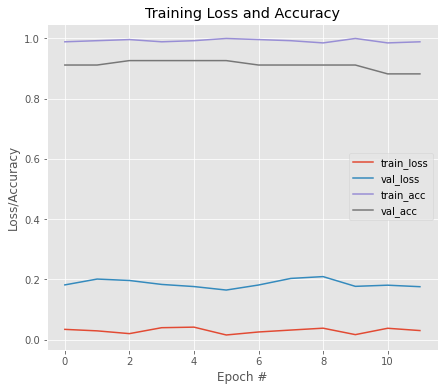


Model Performance Summary:

Best Validation accuracy:0.9264705777168274 at EPOCH:3
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0741 - accuracy: 0.9742
Epoch 1: val_loss improved from inf to 0.00655, saving model to DenseNet121_a_3.hdf5
9/9 [==============================] - 28s 723ms/step - loss: 0.0741 - accuracy: 0.9742 - val_loss: 0.0065 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0656 - accuracy: 0.9815
Epoch 2: val_loss did not improve from 0.00655
9/9 [==============================] - 3s 339ms/step - loss: 0.0656 - accuracy: 0.9815 - val_loss: 0.0072 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0550 - accuracy: 0.9815
Epoch 3: val_loss improved from 0.00655 to 0.00606, saving model to DenseNet121_a_3.hdf5
9/9 [==============================] - 4s 502ms/step - loss: 0.0550 - accuracy: 0.9815 - val_loss: 0.0061 - val_accuracy: 1.0000
Epoch 4/50
9/9 

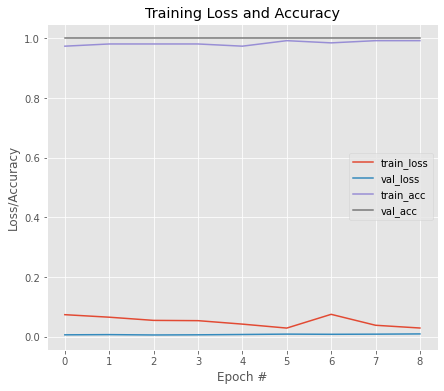


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0428 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.00660, saving model to DenseNet121_b_3.hdf5
9/9 [==============================] - 28s 741ms/step - loss: 0.0428 - accuracy: 0.9852 - val_loss: 0.0066 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0422 - accuracy: 0.9779
Epoch 2: val_loss did not improve from 0.00660
9/9 [==============================] - 3s 348ms/step - loss: 0.0422 - accuracy: 0.9779 - val_loss: 0.0085 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0658 - accuracy: 0.9852
Epoch 3: val_loss did not improve from 0.00660
9/9 [==============================] - 3s 346ms/step - loss: 0.0658 - accuracy: 0.9852 - val_loss: 0.0104 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0567 - accuracy: 0.9

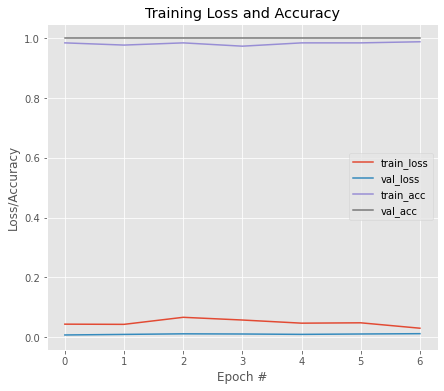


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0333 - accuracy: 0.9963
Epoch 1: val_loss improved from inf to 0.00690, saving model to DenseNet121_a_4.hdf5
9/9 [==============================] - 29s 835ms/step - loss: 0.0333 - accuracy: 0.9963 - val_loss: 0.0069 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0302 - accuracy: 0.9963
Epoch 2: val_loss did not improve from 0.00690
9/9 [==============================] - 3s 343ms/step - loss: 0.0302 - accuracy: 0.9963 - val_loss: 0.0090 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0255 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 0.00690
9/9 [==============================] - 3s 347ms/step - loss: 0.0255 - accuracy: 0.9926 - val_loss: 0.0088 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0285

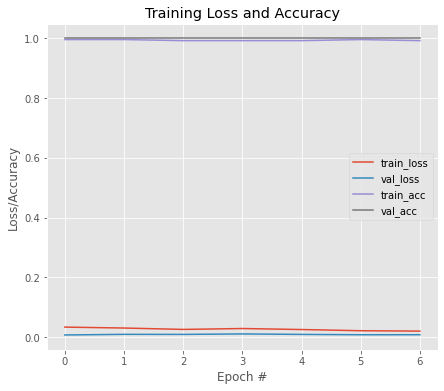


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0229 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 0.00764, saving model to DenseNet121_b_4.hdf5
9/9 [==============================] - 29s 727ms/step - loss: 0.0229 - accuracy: 0.9926 - val_loss: 0.0076 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0525 - accuracy: 0.9853
Epoch 2: val_loss did not improve from 0.00764
9/9 [==============================] - 3s 338ms/step - loss: 0.0525 - accuracy: 0.9853 - val_loss: 0.0085 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0262 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.00764
9/9 [==============================] - 3s 349ms/step - loss: 0.0262 - accuracy: 0.9963 - val_loss: 0.0088 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0172 - accuracy: 1.0

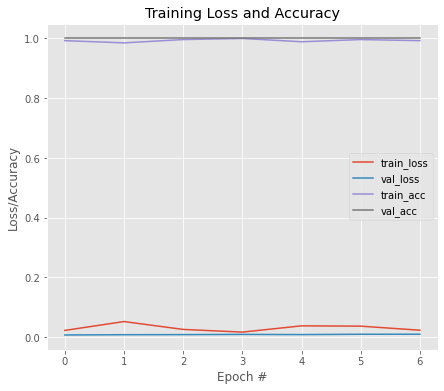


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.8794117569923401
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0450 - accuracy: 0.9882
Epoch 1: val_loss improved from inf to 0.22368, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 13s 653ms/step - loss: 0.0450 - accuracy: 0.9882 - val_loss: 0.2237 - val_accuracy: 0.9178
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0355 - accuracy: 0.9882
Epoch 2: val_loss improved from 0.22368 to 0.22284, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 5s 420ms/step - loss: 0.0355 - accuracy: 0.9882 - val_loss: 0.2228 - val_accuracy: 0.9247
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0379 - accuracy: 0.9912
Epoch 3: val_loss improved from 0.22284 to 0.22223, saving model to DenseNet121_wt.hdf5
11/11 [=======

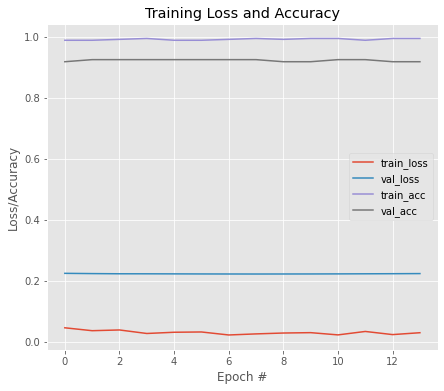


Model Performance Summary:

Best Validation accuracy:0.9246575236320496 at EPOCH:2
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0382 - accuracy: 0.9882
Epoch 1: val_loss improved from inf to 0.25466, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 30s 705ms/step - loss: 0.0382 - accuracy: 0.9882 - val_loss: 0.2547 - val_accuracy: 0.8973
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0441 - accuracy: 0.9853
Epoch 2: val_loss improved from 0.25466 to 0.24206, saving model to DenseNet121_wt.hdf5
11/11 [==============================] - 5s 485ms/step - loss: 0.0441 - accuracy: 0.9853 - val_loss: 0.2421 - val_accuracy: 0.8836
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0389 - accuracy: 0.9941
Epoch 3: val_loss did not improve from 0.24206
11/11 [==============================] - 4s 359ms/step - loss: 0.0389 - accuracy: 0.9941 - val_loss: 0.27

In [ ]:
for model in MODEL_LIST_1:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1)
  gc.collect()

83697664/83683744 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6780 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.64691, saving model to xception_a_0.hdf5
9/9 [==============================] - 8s 485ms/step - loss: 0.6780 - accuracy: 0.6494 - val_loss: 0.6469 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6698 - accuracy: 0.6458
Epoch 2: val_loss improved from 0.64691 to 0.64263, saving model to xception_a_0.hdf5
9/9 [==============================] - 3s 384ms/step - loss: 0.6698 - accuracy: 0.6458 - val_loss: 0.6426 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6768 - accuracy: 0.6494
Epoch 3: val_loss improved from 0.64263 to 0.63915, saving model to xception_a_0.hdf5
9/9 [==============================] - 4s 396ms/step - loss: 0.6768 - accuracy: 0.6494 - val_loss: 0.6391 - val_accuracy: 0.6471
Ep

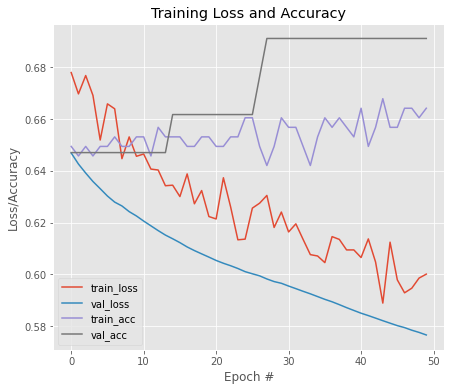


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:28
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6273 - accuracy: 0.6310
Epoch 1: val_loss improved from inf to 0.55714, saving model to xception_b_0.hdf5
9/9 [==============================] - 15s 617ms/step - loss: 0.6273 - accuracy: 0.6310 - val_loss: 0.5571 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5973 - accuracy: 0.7048
Epoch 2: val_loss improved from 0.55714 to 0.53990, saving model to xception_b_0.hdf5
9/9 [==============================] - 5s 500ms/step - loss: 0.5973 - accuracy: 0.7048 - val_loss: 0.5399 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5674 - accuracy: 0.7196
Epoch 3: val_loss improved from 0.53990 to 0.52818, saving model to xception_b_0.hdf5
9/9 [==============================] - 5s 539ms/step - loss: 0.5674 - accuracy: 0.7196 - val_loss: 0.5282 - val_accuracy: 0.73

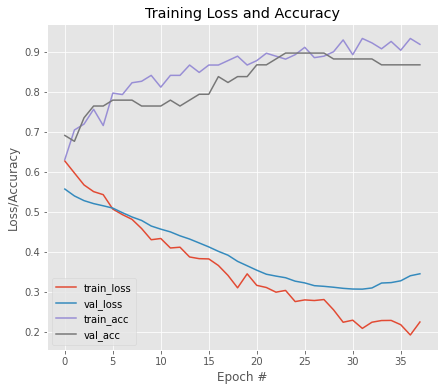


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:24
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2064 - accuracy: 0.9336
Epoch 1: val_loss improved from inf to 0.12248, saving model to xception_a_1.hdf5
9/9 [==============================] - 15s 593ms/step - loss: 0.2064 - accuracy: 0.9336 - val_loss: 0.1225 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2187 - accuracy: 0.9151
Epoch 2: val_loss improved from 0.12248 to 0.11726, saving model to xception_a_1.hdf5
9/9 [==============================] - 5s 493ms/step - loss: 0.2187 - accuracy: 0.9151 - val_loss: 0.1173 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2279 - accuracy: 0.9077
Epoch 3: val_loss improved from 0.11726 to 0.11444, saving model to xception_a_1.hdf5
9/9 [==============================] - 4s 517ms/step - loss: 0.2279 - accuracy: 0.9077 - val_loss: 0.1144 - va

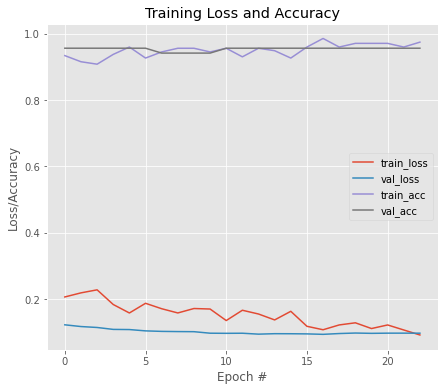


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1053 - accuracy: 0.9705
Epoch 1: val_loss improved from inf to 0.09404, saving model to xception_b_1.hdf5
9/9 [==============================] - 15s 599ms/step - loss: 0.1053 - accuracy: 0.9705 - val_loss: 0.0940 - val_accuracy: 0.9559
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1453 - accuracy: 0.9520
Epoch 2: val_loss improved from 0.09404 to 0.09384, saving model to xception_b_1.hdf5
9/9 [==============================] - 5s 518ms/step - loss: 0.1453 - accuracy: 0.9520 - val_loss: 0.0938 - val_accuracy: 0.9559
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1159 - accuracy: 0.9631
Epoch 3: val_loss did not improve from 0.09384
9/9 [==============================] - 4s 404ms/step - loss: 0.1159 - accuracy: 0.9631 - val_loss: 0.0969 - val_accuracy: 0.9559
Epoch 4/50
9/9 [=====================

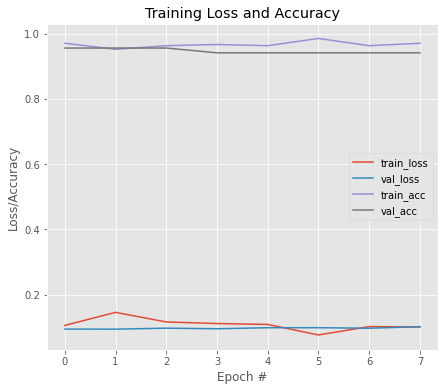


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:1
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1188 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 0.06428, saving model to xception_a_2.hdf5
9/9 [==============================] - 15s 576ms/step - loss: 0.1188 - accuracy: 0.9594 - val_loss: 0.0643 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1060 - accuracy: 0.9631
Epoch 2: val_loss improved from 0.06428 to 0.05944, saving model to xception_a_2.hdf5
9/9 [==============================] - 5s 494ms/step - loss: 0.1060 - accuracy: 0.9631 - val_loss: 0.0594 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0929 - accuracy: 0.9705
Epoch 3: val_loss improved from 0.05944 to 0.05887, saving model to xception_a_2.hdf5
9/9 [==============================] - 5s 580ms/step - loss: 0.0929 - accuracy: 0.9705 - val_loss: 0.0589 - val

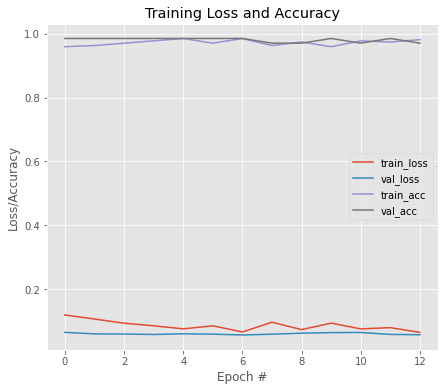


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0764 - accuracy: 0.9705
Epoch 1: val_loss improved from inf to 0.05485, saving model to xception_b_2.hdf5
9/9 [==============================] - 15s 603ms/step - loss: 0.0764 - accuracy: 0.9705 - val_loss: 0.0549 - val_accuracy: 0.9853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0545 - accuracy: 0.9852
Epoch 2: val_loss improved from 0.05485 to 0.05092, saving model to xception_b_2.hdf5
9/9 [==============================] - 5s 498ms/step - loss: 0.0545 - accuracy: 0.9852 - val_loss: 0.0509 - val_accuracy: 0.9853
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0608 - accuracy: 0.9926
Epoch 3: val_loss did not improve from 0.05092
9/9 [==============================] - 4s 407ms/step - loss: 0.0608 - accuracy: 0.9926 - val_loss: 0.0544 - val_accuracy: 0.9853
Epoch 4/50
9/9 [=====================

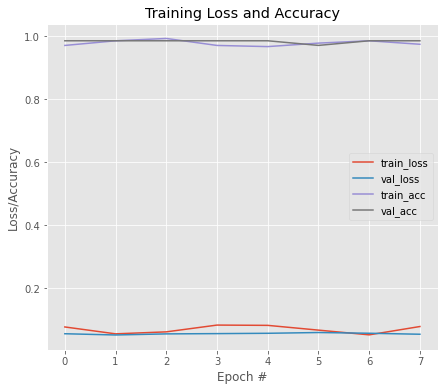


Model Performance Summary:

Best Validation accuracy:0.9852941036224365 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0821 - accuracy: 0.9705
Epoch 1: val_loss improved from inf to 0.03080, saving model to xception_a_3.hdf5
9/9 [==============================] - 15s 594ms/step - loss: 0.0821 - accuracy: 0.9705 - val_loss: 0.0308 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0490 - accuracy: 0.9926
Epoch 2: val_loss did not improve from 0.03080
9/9 [==============================] - 4s 402ms/step - loss: 0.0490 - accuracy: 0.9926 - val_loss: 0.0316 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0961 - accuracy: 0.9557
Epoch 3: val_loss did not improve from 0.03080
9/9 [==============================] - 4s 401ms/step - loss: 0.0961 - accuracy: 0.9557 - val_loss: 0.0317 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

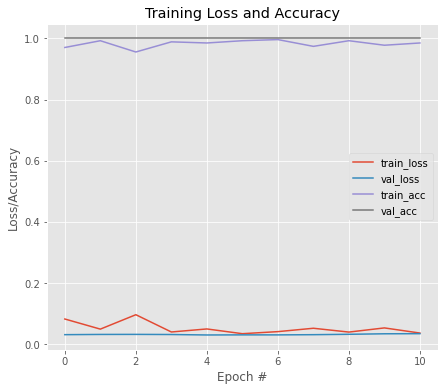


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0432 - accuracy: 0.9852
Epoch 1: val_loss improved from inf to 0.03752, saving model to xception_b_3.hdf5
9/9 [==============================] - 15s 593ms/step - loss: 0.0432 - accuracy: 0.9852 - val_loss: 0.0375 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0457 - accuracy: 0.9889
Epoch 2: val_loss did not improve from 0.03752
9/9 [==============================] - 4s 401ms/step - loss: 0.0457 - accuracy: 0.9889 - val_loss: 0.0394 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0430 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.03752
9/9 [==============================] - 4s 424ms/step - loss: 0.0430 - accuracy: 0.9963 - val_loss: 0.0378 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0311 - accuracy: 0.9963

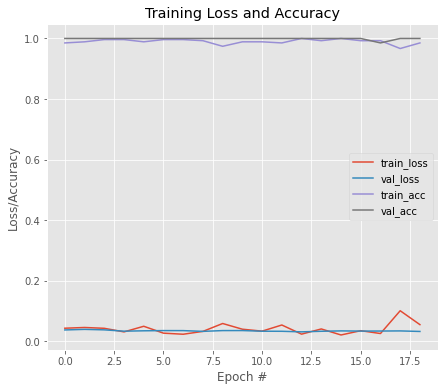


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0763 - accuracy: 0.9669
Epoch 1: val_loss improved from inf to 0.00451, saving model to xception_a_4.hdf5
9/9 [==============================] - 15s 622ms/step - loss: 0.0763 - accuracy: 0.9669 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0738 - accuracy: 0.9816
Epoch 2: val_loss did not improve from 0.00451
9/9 [==============================] - 4s 404ms/step - loss: 0.0738 - accuracy: 0.9816 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0417 - accuracy: 0.9853
Epoch 3: val_loss improved from 0.00451 to 0.00421, saving model to xception_a_4.hdf5
9/9 [==============================] - 5s 498ms/step - loss: 0.0417 - accuracy: 0.9853 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 4/50
9/9 [====================

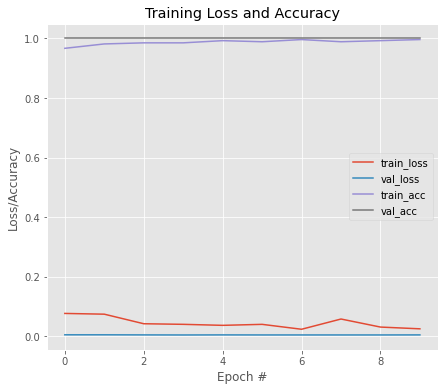


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0269 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 0.00380, saving model to xception_b_4.hdf5
9/9 [==============================] - 15s 597ms/step - loss: 0.0269 - accuracy: 0.9926 - val_loss: 0.0038 - val_accuracy: 1.0000
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0440 - accuracy: 0.9890
Epoch 2: val_loss improved from 0.00380 to 0.00373, saving model to xception_b_4.hdf5
9/9 [==============================] - 5s 494ms/step - loss: 0.0440 - accuracy: 0.9890 - val_loss: 0.0037 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0649 - accuracy: 0.9706
Epoch 3: val_loss did not improve from 0.00373
9/9 [==============================] - 4s 389ms/step - loss: 0.0649 - accuracy: 0.9706 - val_loss: 0.0040 - val_accuracy: 1.0000
Epoch 4/50
9/9 [==============================] - ET

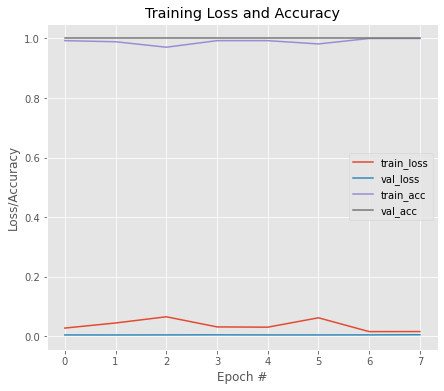


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9676470637321473
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0247 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.25126, saving model to xception_wt.hdf5
11/11 [==============================] - 8s 496ms/step - loss: 0.0247 - accuracy: 0.9971 - val_loss: 0.2513 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0188 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.25126
11/11 [==============================] - 4s 350ms/step - loss: 0.0188 - accuracy: 1.0000 - val_loss: 0.2516 - val_accuracy: 0.9041
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0310 - accuracy: 0.9912
Epoch 3: val_loss did not improve from 0.25126
11/11 [==============================] - 4s 349ms/step - loss: 0.0310 - accuracy: 0.9912 - val_loss:

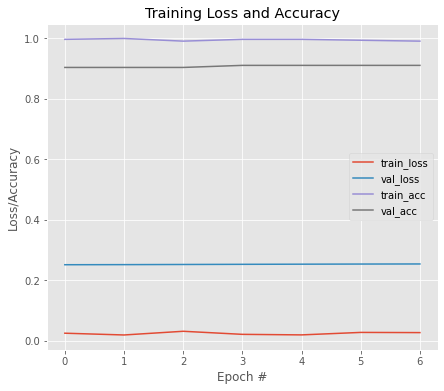


Model Performance Summary:

Best Validation accuracy:0.9109588861465454 at EPOCH:4
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0274 - accuracy: 0.9941
Epoch 1: val_loss improved from inf to 0.27461, saving model to xception_wt.hdf5
11/11 [==============================] - 16s 609ms/step - loss: 0.0274 - accuracy: 0.9941 - val_loss: 0.2746 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0614 - accuracy: 0.9764
Epoch 2: val_loss improved from 0.27461 to 0.26825, saving model to xception_wt.hdf5
11/11 [==============================] - 6s 489ms/step - loss: 0.0614 - accuracy: 0.9764 - val_loss: 0.2682 - val_accuracy: 0.8973
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0516 - accuracy: 0.9882
Epoch 3: val_loss did not improve from 0.26825
11/11 [==============================] - 5s 416ms/step - loss: 0.0516 - accuracy: 0.9882 - val_loss: 0.2918 - v

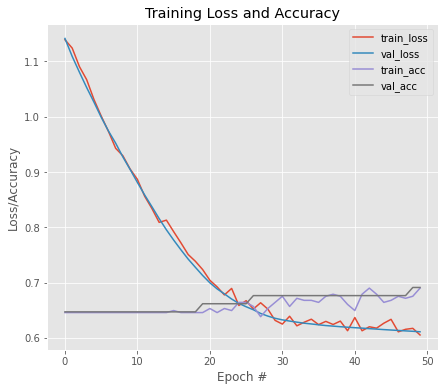


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:49
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.7704 - accuracy: 0.3948
Epoch 1: val_loss improved from inf to 0.59388, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 48s 1s/step - loss: 0.7704 - accuracy: 0.3948 - val_loss: 0.5939 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6541 - accuracy: 0.5683
Epoch 2: val_loss improved from 0.59388 to 0.58256, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 6s 672ms/step - loss: 0.6541 - accuracy: 0.5683 - val_loss: 0.5826 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6265 - accuracy: 0.6347
Epoch 3: val_loss improved from 0.58256 to 0.56824, saving model to InceptionResNetV2_b_0.hdf5
9/9 [==============================] - 6s 679ms/step - loss: 0.6265 - accuracy: 0.6347 - val_loss: 0.5

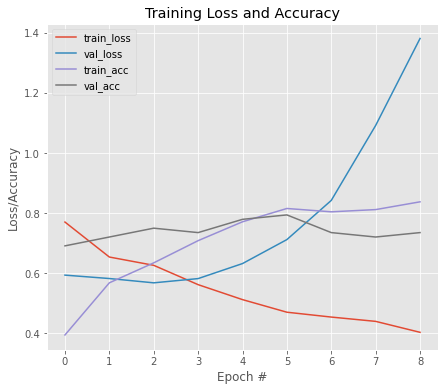


Model Performance Summary:

Best Validation accuracy:0.7941176295280457 at EPOCH:6
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4034 - accuracy: 0.8229
Epoch 1: val_loss improved from inf to 3.17061, saving model to InceptionResNetV2_a_1.hdf5
9/9 [==============================] - 46s 1s/step - loss: 0.4034 - accuracy: 0.8229 - val_loss: 3.1706 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3608 - accuracy: 0.8672
Epoch 2: val_loss did not improve from 3.17061
9/9 [==============================] - 4s 386ms/step - loss: 0.3608 - accuracy: 0.8672 - val_loss: 4.1386 - val_accuracy: 0.6765
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3367 - accuracy: 0.8450
Epoch 3: val_loss did not improve from 3.17061
9/9 [==============================] - 4s 388ms/step - loss: 0.3367 - accuracy: 0.8450 - val_loss: 4.9307 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA:

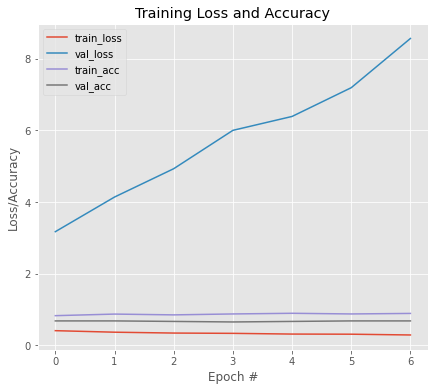


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.3502 - accuracy: 0.8561
Epoch 1: val_loss improved from inf to 4.20198, saving model to InceptionResNetV2_b_1.hdf5
9/9 [==============================] - 46s 1s/step - loss: 0.3502 - accuracy: 0.8561 - val_loss: 4.2020 - val_accuracy: 0.6765
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.3378 - accuracy: 0.8708
Epoch 2: val_loss did not improve from 4.20198
9/9 [==============================] - 4s 388ms/step - loss: 0.3378 - accuracy: 0.8708 - val_loss: 5.1678 - val_accuracy: 0.6618
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.3002 - accuracy: 0.8967
Epoch 3: val_loss did not improve from 4.20198
9/9 [==============================] - 4s 400ms/step - loss: 0.3002 - accuracy: 0.8967 - val_loss: 6.0944 - val_accuracy: 0.6471
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.29

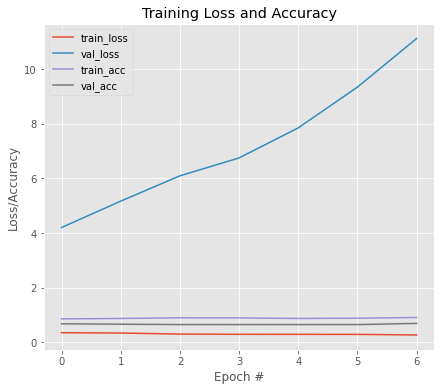


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:7
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2047 - accuracy: 0.9373
Epoch 1: val_loss improved from inf to 8.17653, saving model to InceptionResNetV2_a_2.hdf5
9/9 [==============================] - 45s 1s/step - loss: 0.2047 - accuracy: 0.9373 - val_loss: 8.1765 - val_accuracy: 0.6471
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1859 - accuracy: 0.9520
Epoch 2: val_loss did not improve from 8.17653
9/9 [==============================] - 4s 388ms/step - loss: 0.1859 - accuracy: 0.9520 - val_loss: 8.7184 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1967 - accuracy: 0.9188
Epoch 3: val_loss did not improve from 8.17653
9/9 [==============================] - 4s 403ms/step - loss: 0.1967 - accuracy: 0.9188 - val_loss: 10.1949 - val_accuracy: 0.6618
Epoch 4/50
9/9 [==============================] - ETA

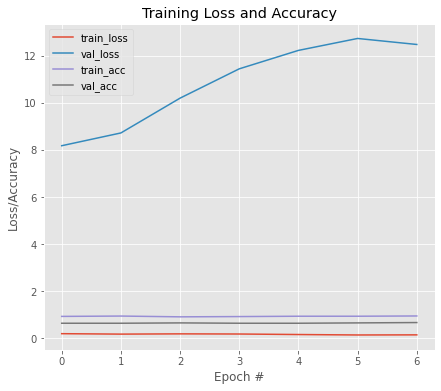


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:7
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2111 - accuracy: 0.9262
Epoch 1: val_loss improved from inf to 8.79682, saving model to InceptionResNetV2_b_2.hdf5
9/9 [==============================] - 46s 1s/step - loss: 0.2111 - accuracy: 0.9262 - val_loss: 8.7968 - val_accuracy: 0.6618
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1643 - accuracy: 0.9410
Epoch 2: val_loss improved from 8.79682 to 8.29814, saving model to InceptionResNetV2_b_2.hdf5
9/9 [==============================] - 6s 656ms/step - loss: 0.1643 - accuracy: 0.9410 - val_loss: 8.2981 - val_accuracy: 0.6471
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1976 - accuracy: 0.9299
Epoch 3: val_loss did not improve from 8.29814
9/9 [==============================] - 4s 407ms/step - loss: 0.1976 - accuracy: 0.9299 - val_loss: 8.7317 - val_accuracy: 0.6471
Epoch 4/50
9/9 [======

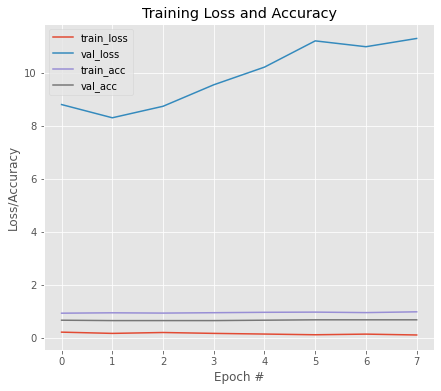


Model Performance Summary:

Best Validation accuracy:0.6764705777168274 at EPOCH:6
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1504 - accuracy: 0.9446
Epoch 1: val_loss improved from inf to 7.46651, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 45s 1s/step - loss: 0.1504 - accuracy: 0.9446 - val_loss: 7.4665 - val_accuracy: 0.7353
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1516 - accuracy: 0.9410
Epoch 2: val_loss did not improve from 7.46651
9/9 [==============================] - 4s 390ms/step - loss: 0.1516 - accuracy: 0.9410 - val_loss: 7.5870 - val_accuracy: 0.7500
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1298 - accuracy: 0.9594
Epoch 3: val_loss improved from 7.46651 to 7.38507, saving model to InceptionResNetV2_a_3.hdf5
9/9 [==============================] - 6s 692ms/step - loss: 0.1298 - accuracy: 0.9594 - val_loss: 7.3851 - val_accuracy: 0.7500
Epoch 

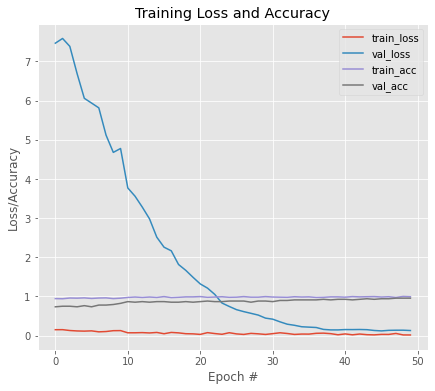


Model Performance Summary:

Best Validation accuracy:0.9558823704719543 at EPOCH:48
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0112 - accuracy: 1.0000
Epoch 1: val_loss improved from inf to 0.12588, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 46s 1s/step - loss: 0.0112 - accuracy: 1.0000 - val_loss: 0.1259 - val_accuracy: 0.9265
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0236 - accuracy: 0.9889
Epoch 2: val_loss improved from 0.12588 to 0.10994, saving model to InceptionResNetV2_b_3.hdf5
9/9 [==============================] - 6s 691ms/step - loss: 0.0236 - accuracy: 0.9889 - val_loss: 0.1099 - val_accuracy: 0.9706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0146 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.10994
9/9 [==============================] - 4s 393ms/step - loss: 0.0146 - accuracy: 0.9963 - val_loss: 0.1193 - val_accuracy: 0.9559
Epoch 4/50
9/9 [=====

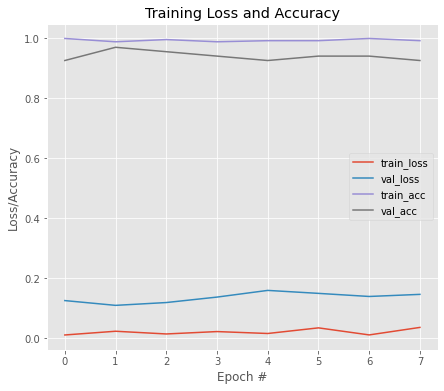


Model Performance Summary:

Best Validation accuracy:0.970588207244873 at EPOCH:2
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0847 - accuracy: 0.9706
Epoch 1: val_loss improved from inf to 0.12499, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 47s 1s/step - loss: 0.0847 - accuracy: 0.9706 - val_loss: 0.1250 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0359 - accuracy: 0.9890
Epoch 2: val_loss improved from 0.12499 to 0.10904, saving model to InceptionResNetV2_a_4.hdf5
9/9 [==============================] - 6s 688ms/step - loss: 0.0359 - accuracy: 0.9890 - val_loss: 0.1090 - val_accuracy: 0.9851
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0668 - accuracy: 0.9816
Epoch 3: val_loss did not improve from 0.10904
9/9 [==============================] - 4s 392ms/step - loss: 0.0668 - accuracy: 0.9816 - val_loss: 0.1115 - val_accuracy: 0.9851
Epoch 4

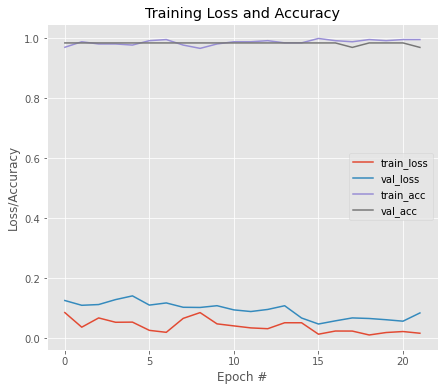


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0282 - accuracy: 0.9926
Epoch 1: val_loss improved from inf to 0.03664, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 46s 1s/step - loss: 0.0282 - accuracy: 0.9926 - val_loss: 0.0366 - val_accuracy: 0.9701
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0267 - accuracy: 0.9853
Epoch 2: val_loss improved from 0.03664 to 0.01644, saving model to InceptionResNetV2_b_4.hdf5
9/9 [==============================] - 6s 670ms/step - loss: 0.0267 - accuracy: 0.9853 - val_loss: 0.0164 - val_accuracy: 1.0000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0134 - accuracy: 0.9963
Epoch 3: val_loss did not improve from 0.01644
9/9 [==============================] - 4s 413ms/step - loss: 0.0134 - accuracy: 0.9963 - val_loss: 0.0197 - val_accuracy: 1.0000
Epoch 4/50
9/9 [======

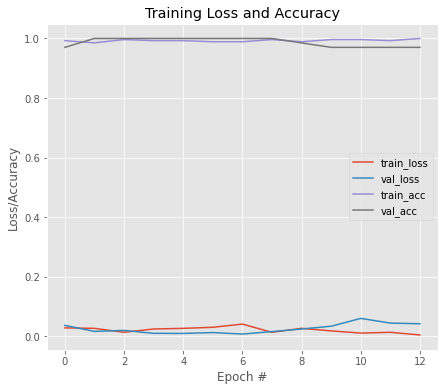


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:2
Average Accuracy:0.8264705777168274
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0156 - accuracy: 0.9971
Epoch 1: val_loss improved from inf to 0.40305, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 21s 909ms/step - loss: 0.0156 - accuracy: 0.9971 - val_loss: 0.4031 - val_accuracy: 0.9041
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0056 - accuracy: 1.0000
Epoch 2: val_loss did not improve from 0.40305
11/11 [==============================] - 4s 379ms/step - loss: 0.0056 - accuracy: 1.0000 - val_loss: 0.4032 - val_accuracy: 0.9041
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0037 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.40305
11/11 [==============================] - 4s 377ms/step - loss: 0.0037 - accuracy: 1.0000 -

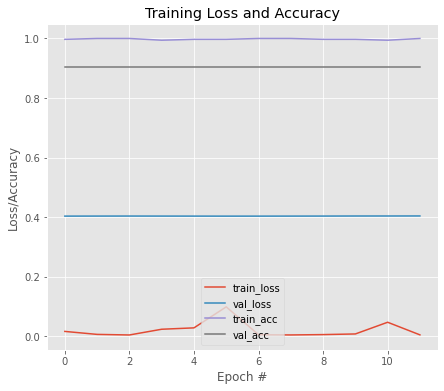


Model Performance Summary:

Best Validation accuracy:0.9041095972061157 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0297 - accuracy: 0.9853
Epoch 1: val_loss improved from inf to 0.47305, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 47s 1s/step - loss: 0.0297 - accuracy: 0.9853 - val_loss: 0.4731 - val_accuracy: 0.8836
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0259 - accuracy: 0.9912
Epoch 2: val_loss improved from 0.47305 to 0.40562, saving model to InceptionResNetV2_wt.hdf5
11/11 [==============================] - 7s 644ms/step - loss: 0.0259 - accuracy: 0.9912 - val_loss: 0.4056 - val_accuracy: 0.8767
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000
Epoch 3: val_loss did not improve from 0.40562
11/11 [==============================] - 5s 411ms/step - loss: 0.0040 - accuracy: 1.0000 - val_l

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1)
  gc.collect()

17235968/17225924 [==============================] - 0s 0us/step
Starting fold 0
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6808 - accuracy: 0.6089
Epoch 1: val_loss improved from inf to 0.74981, saving model to MobileNet_a_0.hdf5
9/9 [==============================] - 6s 412ms/step - loss: 0.6808 - accuracy: 0.6089 - val_loss: 0.7498 - val_accuracy: 0.4853
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6989 - accuracy: 0.5646
Epoch 2: val_loss improved from 0.74981 to 0.74003, saving model to MobileNet_a_0.hdf5
9/9 [==============================] - 3s 344ms/step - loss: 0.6989 - accuracy: 0.5646 - val_loss: 0.7400 - val_accuracy: 0.5000
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6796 - accuracy: 0.5720
Epoch 3: val_loss improved from 0.74003 to 0.73193, saving model to MobileNet_a_0.hdf5
9/9 [==============================] - 3s 342ms/step - loss: 0.6796 - accuracy: 0.5720 - val_loss: 0.7319 - val_accuracy: 0.5000

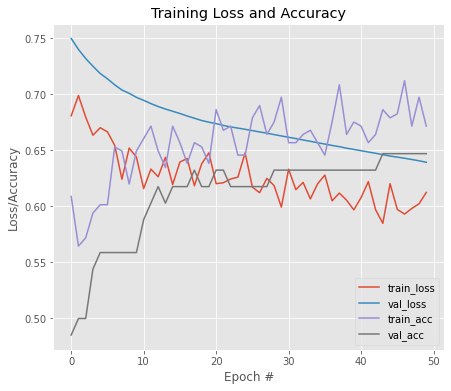


Model Performance Summary:

Best Validation accuracy:0.6470588445663452 at EPOCH:44
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6595 - accuracy: 0.6089
Epoch 1: val_loss improved from inf to 0.64559, saving model to MobileNet_b_0.hdf5
9/9 [==============================] - 9s 422ms/step - loss: 0.6595 - accuracy: 0.6089 - val_loss: 0.6456 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.6040 - accuracy: 0.6827
Epoch 2: val_loss did not improve from 0.64559
9/9 [==============================] - 3s 320ms/step - loss: 0.6040 - accuracy: 0.6827 - val_loss: 0.7415 - val_accuracy: 0.5294
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.6225 - accuracy: 0.7048
Epoch 3: val_loss did not improve from 0.64559
9/9 [==============================] - 3s 318ms/step - loss: 0.6225 - accuracy: 0.7048 - val_loss: 0.8088 - val_accuracy: 0.5294
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.5269 - 

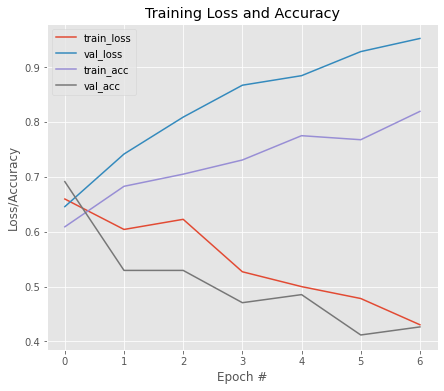


Model Performance Summary:

Best Validation accuracy:0.6911764740943909 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4456 - accuracy: 0.8081
Epoch 1: val_loss improved from inf to 0.90514, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 9s 425ms/step - loss: 0.4456 - accuracy: 0.8081 - val_loss: 0.9051 - val_accuracy: 0.3971
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4776 - accuracy: 0.8081
Epoch 2: val_loss improved from 0.90514 to 0.82060, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 3s 364ms/step - loss: 0.4776 - accuracy: 0.8081 - val_loss: 0.8206 - val_accuracy: 0.4706
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4358 - accuracy: 0.7897
Epoch 3: val_loss improved from 0.82060 to 0.75231, saving model to MobileNet_a_1.hdf5
9/9 [==============================] - 3s 354ms/step - loss: 0.4358 - accuracy: 0.7897 - val_loss: 0.7523 - v

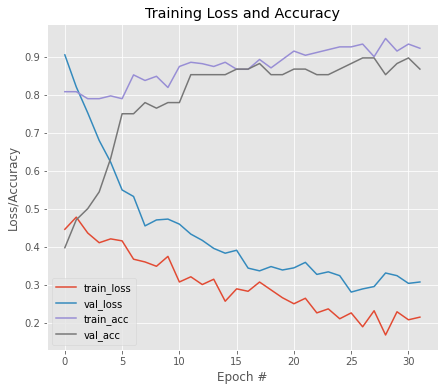


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:27
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2276 - accuracy: 0.9262
Epoch 1: val_loss improved from inf to 0.28373, saving model to MobileNet_b_1.hdf5
9/9 [==============================] - 9s 428ms/step - loss: 0.2276 - accuracy: 0.9262 - val_loss: 0.2837 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.2268 - accuracy: 0.9188
Epoch 2: val_loss improved from 0.28373 to 0.27310, saving model to MobileNet_b_1.hdf5
9/9 [==============================] - 3s 393ms/step - loss: 0.2268 - accuracy: 0.9188 - val_loss: 0.2731 - val_accuracy: 0.9118
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.2148 - accuracy: 0.9262
Epoch 3: val_loss did not improve from 0.27310
9/9 [==============================] - 3s 327ms/step - loss: 0.2148 - accuracy: 0.9262 - val_loss: 0.2862 - val_accuracy: 0.8971
Epoch 4/50
9/9 [===================

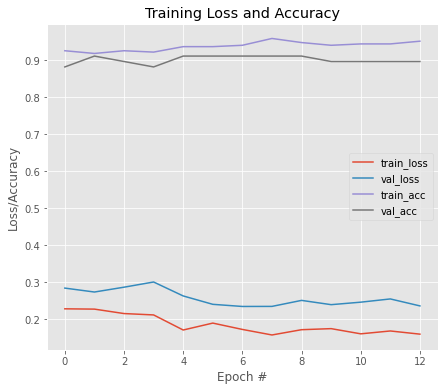


Model Performance Summary:

Best Validation accuracy:0.9117646813392639 at EPOCH:2
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.2008 - accuracy: 0.9262
Epoch 1: val_loss improved from inf to 0.21158, saving model to MobileNet_a_2.hdf5
9/9 [==============================] - 9s 426ms/step - loss: 0.2008 - accuracy: 0.9262 - val_loss: 0.2116 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1982 - accuracy: 0.9410
Epoch 2: val_loss did not improve from 0.21158
9/9 [==============================] - 3s 323ms/step - loss: 0.1982 - accuracy: 0.9410 - val_loss: 0.2331 - val_accuracy: 0.8824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1550 - accuracy: 0.9483
Epoch 3: val_loss did not improve from 0.21158
9/9 [==============================] - 3s 323ms/step - loss: 0.1550 - accuracy: 0.9483 - val_loss: 0.2409 - val_accuracy: 0.8824
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

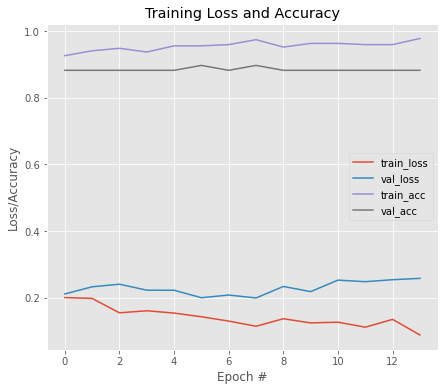


Model Performance Summary:

Best Validation accuracy:0.8970588445663452 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1240 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 0.23774, saving model to MobileNet_b_2.hdf5
9/9 [==============================] - 9s 429ms/step - loss: 0.1240 - accuracy: 0.9594 - val_loss: 0.2377 - val_accuracy: 0.8824
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1342 - accuracy: 0.9594
Epoch 2: val_loss did not improve from 0.23774
9/9 [==============================] - 3s 319ms/step - loss: 0.1342 - accuracy: 0.9594 - val_loss: 0.2862 - val_accuracy: 0.8824
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0937 - accuracy: 0.9815
Epoch 3: val_loss did not improve from 0.23774
9/9 [==============================] - 3s 320ms/step - loss: 0.0937 - accuracy: 0.9815 - val_loss: 0.3043 - val_accuracy: 0.8824
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1064 - a

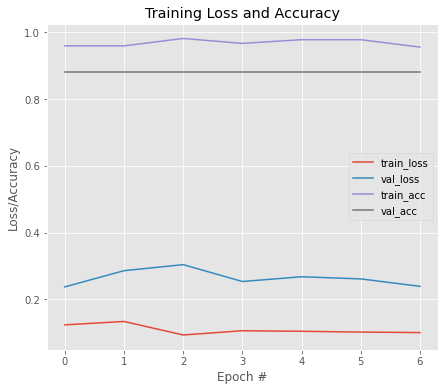


Model Performance Summary:

Best Validation accuracy:0.8823529481887817 at EPOCH:1
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1145 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.12611, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 9s 433ms/step - loss: 0.1145 - accuracy: 0.9631 - val_loss: 0.1261 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1129 - accuracy: 0.9705
Epoch 2: val_loss improved from 0.12611 to 0.12227, saving model to MobileNet_a_3.hdf5
9/9 [==============================] - 3s 366ms/step - loss: 0.1129 - accuracy: 0.9705 - val_loss: 0.1223 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1066 - accuracy: 0.9594
Epoch 3: val_loss did not improve from 0.12227
9/9 [==============================] - 3s 328ms/step - loss: 0.1066 - accuracy: 0.9594 - val_loss: 0.1232 - val_accuracy: 0.9412
Epoch 4/50
9/9 [====

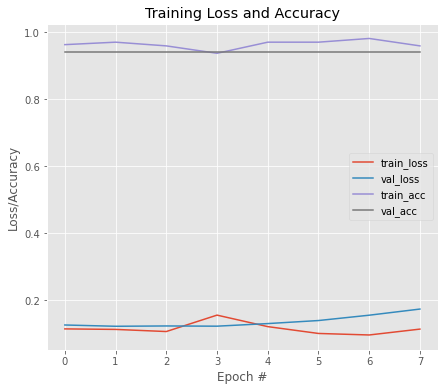


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1463 - accuracy: 0.9373
Epoch 1: val_loss improved from inf to 0.13213, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 9s 433ms/step - loss: 0.1463 - accuracy: 0.9373 - val_loss: 0.1321 - val_accuracy: 0.9412
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1389 - accuracy: 0.9262
Epoch 2: val_loss improved from 0.13213 to 0.12486, saving model to MobileNet_b_3.hdf5
9/9 [==============================] - 3s 368ms/step - loss: 0.1389 - accuracy: 0.9262 - val_loss: 0.1249 - val_accuracy: 0.9412
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1060 - accuracy: 0.9705
Epoch 3: val_loss did not improve from 0.12486
9/9 [==============================] - 3s 319ms/step - loss: 0.1060 - accuracy: 0.9705 - val_loss: 0.1428 - val_accuracy: 0.9412
Epoch 4/50
9/9 [====================

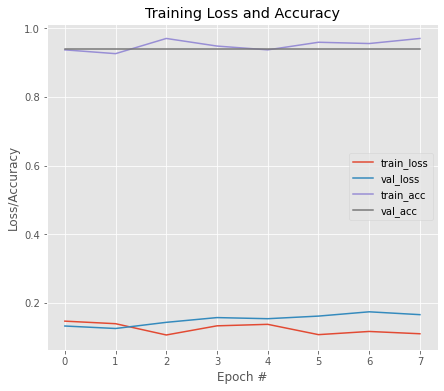


Model Performance Summary:

Best Validation accuracy:0.9411764740943909 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1070 - accuracy: 0.9559
Epoch 1: val_loss improved from inf to 0.06612, saving model to MobileNet_a_4.hdf5
9/9 [==============================] - 9s 438ms/step - loss: 0.1070 - accuracy: 0.9559 - val_loss: 0.0661 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0990 - accuracy: 0.9743
Epoch 2: val_loss did not improve from 0.06612
9/9 [==============================] - 3s 325ms/step - loss: 0.0990 - accuracy: 0.9743 - val_loss: 0.0755 - val_accuracy: 0.9701
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1010 - accuracy: 0.9706
Epoch 3: val_loss did not improve from 0.06612
9/9 [==============================] - 3s 325ms/step - loss: 0.1010 - accuracy: 0.9706 - val_loss: 0.0825 - val_accuracy: 0.9701
Epoch 4/50
9/9 [==============================] - ETA: 0s - 

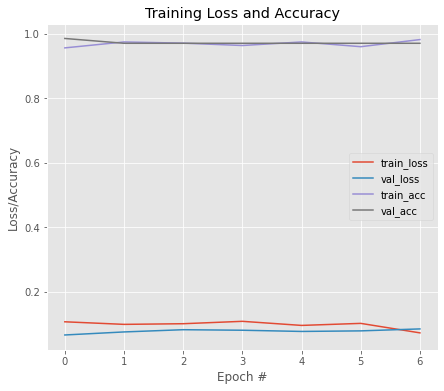


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1033 - accuracy: 0.9706
Epoch 1: val_loss improved from inf to 0.06209, saving model to MobileNet_b_4.hdf5
9/9 [==============================] - 9s 463ms/step - loss: 0.1033 - accuracy: 0.9706 - val_loss: 0.0621 - val_accuracy: 0.9851
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1324 - accuracy: 0.9522
Epoch 2: val_loss did not improve from 0.06209
9/9 [==============================] - 3s 351ms/step - loss: 0.1324 - accuracy: 0.9522 - val_loss: 0.0656 - val_accuracy: 0.9701
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1562 - accuracy: 0.9485
Epoch 3: val_loss did not improve from 0.06209
9/9 [==============================] - 3s 332ms/step - loss: 0.1562 - accuracy: 0.9485 - val_loss: 0.0748 - val_accuracy: 0.9701
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0927 - a

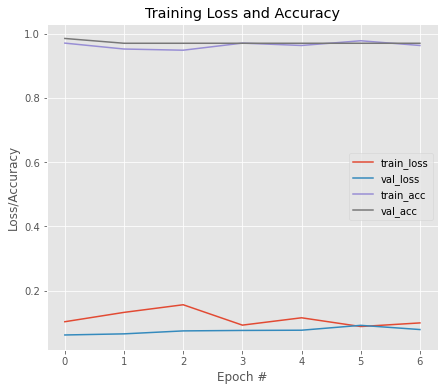


Model Performance Summary:

Best Validation accuracy:0.9850746393203735 at EPOCH:1
Average Accuracy:0.8823090434074402
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.0760 - accuracy: 0.9882
Epoch 1: val_loss improved from inf to 0.23533, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 6s 411ms/step - loss: 0.0760 - accuracy: 0.9882 - val_loss: 0.2353 - val_accuracy: 0.9110
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.0799 - accuracy: 0.9823
Epoch 2: val_loss improved from 0.23533 to 0.23370, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 4s 343ms/step - loss: 0.0799 - accuracy: 0.9823 - val_loss: 0.2337 - val_accuracy: 0.9178
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0751 - accuracy: 0.9794
Epoch 3: val_loss improved from 0.23370 to 0.23184, saving model to MobileNet_wt.hdf5
11/11 

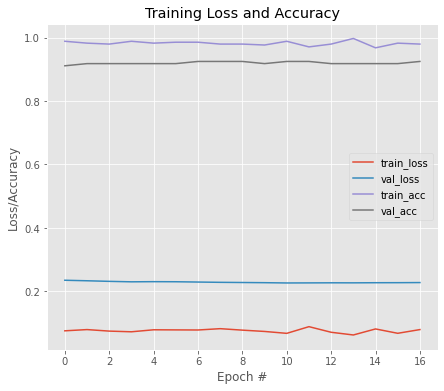


Model Performance Summary:

Best Validation accuracy:0.9246575236320496 at EPOCH:7
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1360 - accuracy: 0.9469
Epoch 1: val_loss improved from inf to 0.21783, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 10s 418ms/step - loss: 0.1360 - accuracy: 0.9469 - val_loss: 0.2178 - val_accuracy: 0.9110
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1071 - accuracy: 0.9587
Epoch 2: val_loss improved from 0.21783 to 0.21614, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 4s 373ms/step - loss: 0.1071 - accuracy: 0.9587 - val_loss: 0.2161 - val_accuracy: 0.9110
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.0823 - accuracy: 0.9823
Epoch 3: val_loss improved from 0.21614 to 0.21328, saving model to MobileNet_wt.hdf5
11/11 [==============================] - 4s 360ms/step - loss: 0.0823 

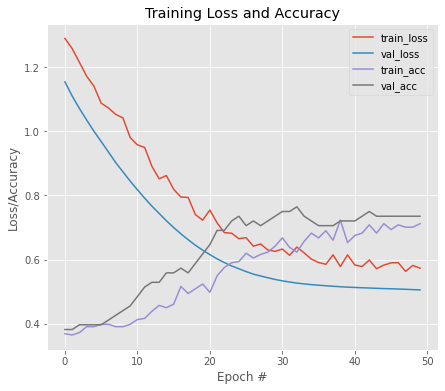


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:33
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.6278 - accuracy: 0.6494
Epoch 1: val_loss improved from inf to 0.49889, saving model to MobileNetV2_b_0.hdf5
9/9 [==============================] - 14s 476ms/step - loss: 0.6278 - accuracy: 0.6494 - val_loss: 0.4989 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.5812 - accuracy: 0.6937
Epoch 2: val_loss did not improve from 0.49889
9/9 [==============================] - 3s 324ms/step - loss: 0.5812 - accuracy: 0.6937 - val_loss: 0.5183 - val_accuracy: 0.7206
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.5434 - accuracy: 0.7269
Epoch 3: val_loss did not improve from 0.49889
9/9 [==============================] - 3s 325ms/step - loss: 0.5434 - accuracy: 0.7269 - val_loss: 0.5406 - val_accuracy: 0.7206
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.5275

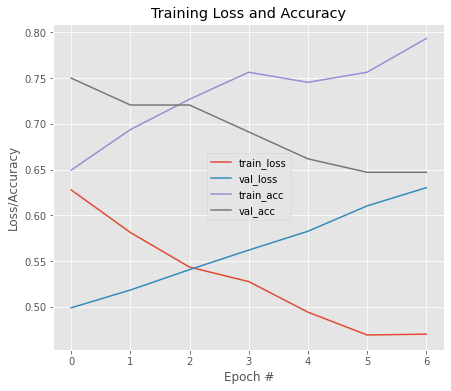


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:1
Starting fold 1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.4949 - accuracy: 0.7565
Epoch 1: val_loss improved from inf to 0.80238, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 14s 504ms/step - loss: 0.4949 - accuracy: 0.7565 - val_loss: 0.8024 - val_accuracy: 0.5441
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.4497 - accuracy: 0.7860
Epoch 2: val_loss did not improve from 0.80238
9/9 [==============================] - 3s 333ms/step - loss: 0.4497 - accuracy: 0.7860 - val_loss: 0.8088 - val_accuracy: 0.5294
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.4433 - accuracy: 0.7860
Epoch 3: val_loss improved from 0.80238 to 0.79552, saving model to MobileNetV2_a_1.hdf5
9/9 [==============================] - 4s 386ms/step - loss: 0.4433 - accuracy: 0.7860 - val_loss: 0.7955 - val_accuracy: 0.5588
Epoch 4/50
9/9 [=============

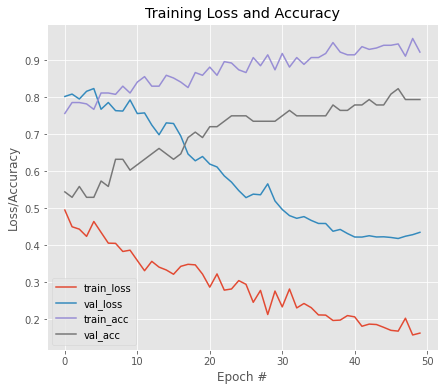


Model Performance Summary:

Best Validation accuracy:0.8235294222831726 at EPOCH:47
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1946 - accuracy: 0.9299
Epoch 1: val_loss improved from inf to 0.42922, saving model to MobileNetV2_b_1.hdf5
9/9 [==============================] - 14s 501ms/step - loss: 0.1946 - accuracy: 0.9299 - val_loss: 0.4292 - val_accuracy: 0.8235
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1905 - accuracy: 0.9410
Epoch 2: val_loss did not improve from 0.42922
9/9 [==============================] - 3s 318ms/step - loss: 0.1905 - accuracy: 0.9410 - val_loss: 0.4352 - val_accuracy: 0.8235
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1462 - accuracy: 0.9483
Epoch 3: val_loss did not improve from 0.42922
9/9 [==============================] - 3s 362ms/step - loss: 0.1462 - accuracy: 0.9483 - val_loss: 0.4305 - val_accuracy: 0.8235
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.1507

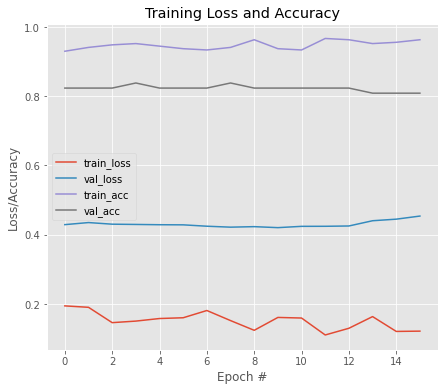


Model Performance Summary:

Best Validation accuracy:0.8382353186607361 at EPOCH:4
Starting fold 2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1286 - accuracy: 0.9557
Epoch 1: val_loss improved from inf to 0.64046, saving model to MobileNetV2_a_2.hdf5
9/9 [==============================] - 14s 503ms/step - loss: 0.1286 - accuracy: 0.9557 - val_loss: 0.6405 - val_accuracy: 0.6912
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1841 - accuracy: 0.9188
Epoch 2: val_loss did not improve from 0.64046
9/9 [==============================] - 3s 320ms/step - loss: 0.1841 - accuracy: 0.9188 - val_loss: 0.6540 - val_accuracy: 0.7059
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1267 - accuracy: 0.9631
Epoch 3: val_loss did not improve from 0.64046
9/9 [==============================] - 3s 325ms/step - loss: 0.1267 - accuracy: 0.9631 - val_loss: 0.6634 - val_accuracy: 0.7059
Epoch 4/50
9/9 [==============================] - ETA: 0s

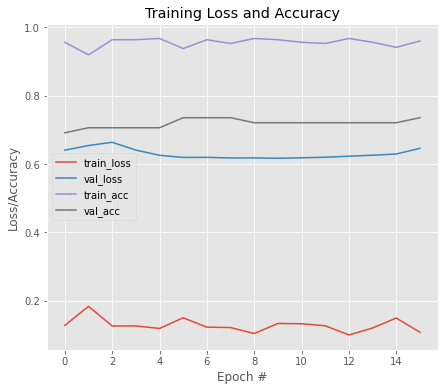


Model Performance Summary:

Best Validation accuracy:0.7352941036224365 at EPOCH:6
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1243 - accuracy: 0.9631
Epoch 1: val_loss improved from inf to 0.65214, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 14s 498ms/step - loss: 0.1243 - accuracy: 0.9631 - val_loss: 0.6521 - val_accuracy: 0.7206
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1058 - accuracy: 0.9705
Epoch 2: val_loss improved from 0.65214 to 0.65098, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 4s 383ms/step - loss: 0.1058 - accuracy: 0.9705 - val_loss: 0.6510 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.1136 - accuracy: 0.9631
Epoch 3: val_loss improved from 0.65098 to 0.63544, saving model to MobileNetV2_b_2.hdf5
9/9 [==============================] - 4s 382ms/step - loss: 0.1136 - accuracy: 0.9631 - val_loss: 0.6354 - val_accura

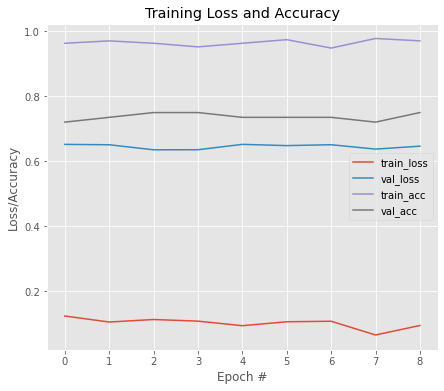


Model Performance Summary:

Best Validation accuracy:0.75 at EPOCH:3
Starting fold 3
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0843 - accuracy: 0.9668
Epoch 1: val_loss improved from inf to 0.52671, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 14s 505ms/step - loss: 0.0843 - accuracy: 0.9668 - val_loss: 0.5267 - val_accuracy: 0.7500
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0865 - accuracy: 0.9742
Epoch 2: val_loss improved from 0.52671 to 0.52109, saving model to MobileNetV2_a_3.hdf5
9/9 [==============================] - 4s 384ms/step - loss: 0.0865 - accuracy: 0.9742 - val_loss: 0.5211 - val_accuracy: 0.7794
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0984 - accuracy: 0.9779
Epoch 3: val_loss did not improve from 0.52109
9/9 [==============================] - 3s 324ms/step - loss: 0.0984 - accuracy: 0.9779 - val_loss: 0.5276 - val_accuracy: 0.7794
Epoch 4/50
9/9 [=============

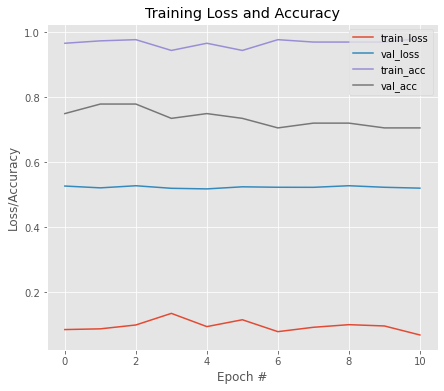


Model Performance Summary:

Best Validation accuracy:0.779411792755127 at EPOCH:2
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.1171 - accuracy: 0.9594
Epoch 1: val_loss improved from inf to 0.54421, saving model to MobileNetV2_b_3.hdf5
9/9 [==============================] - 14s 498ms/step - loss: 0.1171 - accuracy: 0.9594 - val_loss: 0.5442 - val_accuracy: 0.7647
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0965 - accuracy: 0.9631
Epoch 2: val_loss did not improve from 0.54421
9/9 [==============================] - 3s 318ms/step - loss: 0.0965 - accuracy: 0.9631 - val_loss: 0.5499 - val_accuracy: 0.7353
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0886 - accuracy: 0.9742
Epoch 3: val_loss did not improve from 0.54421
9/9 [==============================] - 3s 328ms/step - loss: 0.0886 - accuracy: 0.9742 - val_loss: 0.5780 - val_accuracy: 0.7500
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0871 -

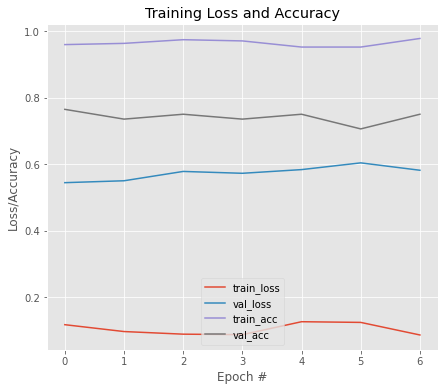


Model Performance Summary:

Best Validation accuracy:0.7647058963775635 at EPOCH:1
Starting fold 4
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0877 - accuracy: 0.9669
Epoch 1: val_loss improved from inf to 0.50948, saving model to MobileNetV2_a_4.hdf5
9/9 [==============================] - 14s 505ms/step - loss: 0.0877 - accuracy: 0.9669 - val_loss: 0.5095 - val_accuracy: 0.7313
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.1264 - accuracy: 0.9485
Epoch 2: val_loss improved from 0.50948 to 0.50578, saving model to MobileNetV2_a_4.hdf5
9/9 [==============================] - 4s 382ms/step - loss: 0.1264 - accuracy: 0.9485 - val_loss: 0.5058 - val_accuracy: 0.7164
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0758 - accuracy: 0.9706
Epoch 3: val_loss did not improve from 0.50578
9/9 [==============================] - 3s 318ms/step - loss: 0.0758 - accuracy: 0.9706 - val_loss: 0.5149 - val_accuracy: 0.7313
Epoch 4/50
9/9 

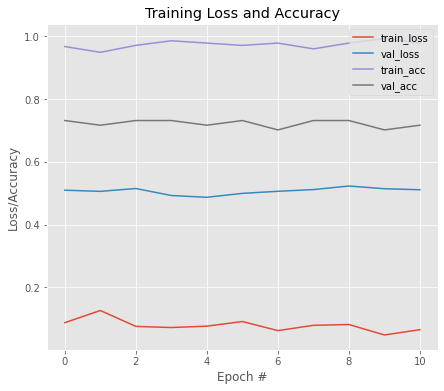


Model Performance Summary:

Best Validation accuracy:0.7313432693481445 at EPOCH:1
Epoch 1/50
9/9 [==============================] - ETA: 0s - loss: 0.0828 - accuracy: 0.9779
Epoch 1: val_loss improved from inf to 0.48188, saving model to MobileNetV2_b_4.hdf5
9/9 [==============================] - 14s 503ms/step - loss: 0.0828 - accuracy: 0.9779 - val_loss: 0.4819 - val_accuracy: 0.7164
Epoch 2/50
9/9 [==============================] - ETA: 0s - loss: 0.0578 - accuracy: 0.9853
Epoch 2: val_loss did not improve from 0.48188
9/9 [==============================] - 3s 325ms/step - loss: 0.0578 - accuracy: 0.9853 - val_loss: 0.5033 - val_accuracy: 0.7164
Epoch 3/50
9/9 [==============================] - ETA: 0s - loss: 0.0577 - accuracy: 0.9853
Epoch 3: val_loss did not improve from 0.48188
9/9 [==============================] - 3s 327ms/step - loss: 0.0577 - accuracy: 0.9853 - val_loss: 0.4867 - val_accuracy: 0.7164
Epoch 4/50
9/9 [==============================] - ETA: 0s - loss: 0.0826 

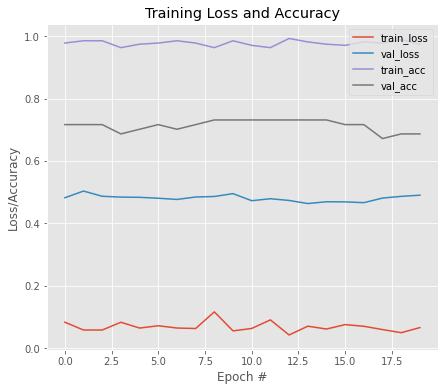


Model Performance Summary:

Best Validation accuracy:0.7313432693481445 at EPOCH:9
Average Accuracy:0.7668568968772889
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.5751 - accuracy: 0.6932
Epoch 1: val_loss improved from inf to 0.55070, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 8s 457ms/step - loss: 0.5751 - accuracy: 0.6932 - val_loss: 0.5507 - val_accuracy: 0.7534
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.5348 - accuracy: 0.7552
Epoch 2: val_loss did not improve from 0.55070
11/11 [==============================] - 4s 334ms/step - loss: 0.5348 - accuracy: 0.7552 - val_loss: 0.5571 - val_accuracy: 0.7534
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.5264 - accuracy: 0.7522
Epoch 3: val_loss did not improve from 0.55070
11/11 [==============================] - 4s 325ms/step - loss: 0.5264 - accuracy: 

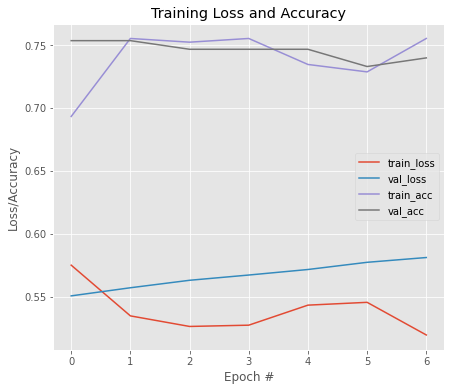


Model Performance Summary:

Best Validation accuracy:0.7534246444702148 at EPOCH:1
 Training Model with pretraned layer trainable
Epoch 1/50
11/11 [==============================] - ETA: 0s - loss: 0.1455 - accuracy: 0.9440
Epoch 1: val_loss improved from inf to 0.53550, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 15s 481ms/step - loss: 0.1455 - accuracy: 0.9440 - val_loss: 0.5355 - val_accuracy: 0.7534
Epoch 2/50
11/11 [==============================] - ETA: 0s - loss: 0.1228 - accuracy: 0.9617
Epoch 2: val_loss improved from 0.53550 to 0.51389, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 4s 385ms/step - loss: 0.1228 - accuracy: 0.9617 - val_loss: 0.5139 - val_accuracy: 0.7603
Epoch 3/50
11/11 [==============================] - ETA: 0s - loss: 0.1419 - accuracy: 0.9410
Epoch 3: val_loss improved from 0.51389 to 0.49269, saving model to MobileNetV2_wt.hdf5
11/11 [==============================] - 4s 404ms/step - loss: 0

In [ ]:
for model in MODEL_LIST_3:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx1,trainy1,testx1,testy1)
  gc.collect()

,Model,Accuracy,Sensitivity,AUC
0,InceptionV3_A_True_RIM-ONE_dl,0.904110,0.946809,0.886866
1,vgg16_A_True_RIM-ONE_dl,0.917808,0.978723,0.893208
2,vgg19_A_True_RIM-ONE_dl,0.910959,0.925532,0.905074
3,resnet50_A_True_RIM-ONE_dl,0.643836,1.000000,0.500000
4,DenseNet121_A_True_RIM-ONE_dl,0.910959,0.925532,0.905074
5,xception_A_True_RIM-ONE_dl,0.897260,0.936170,0.881547
6,InceptionResNetV2_A_True_RIM-ONE_dl,0.897260,0.957447,0.872954
7,MobileNet_A_True_RIM-ONE_dl,0.910959,0.936170,0.900777
8,MobileNetV2_A_True_RIM-ONE_dl,0.760274,0.882979,0.710720


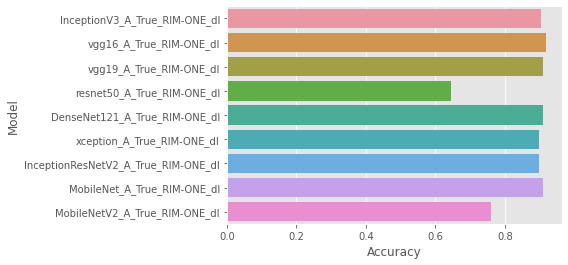

\begin{tabular}{lrrr}
\toprule
                              Model &  Accuracy &  Sensitivity &      AUC \\
\midrule
      InceptionV3\_A\_True\_RIM-ONE\_dl &  0.904110 &     0.946809 & 0.886866 \\
            vgg16\_A\_True\_RIM-ONE\_dl &  0.917808 &     0.978723 & 0.893208 \\
            vgg19\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.925532 & 0.905074 \\
         resnet50\_A\_True\_RIM-ONE\_dl &  0.643836 &     1.000000 & 0.500000 \\
      DenseNet121\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.925532 & 0.905074 \\
         xception\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.936170 & 0.881547 \\
InceptionResNetV2\_A\_True\_RIM-ONE\_dl &  0.897260 &     0.957447 & 0.872954 \\
        MobileNet\_A\_True\_RIM-ONE\_dl &  0.910959 &     0.936170 & 0.900777 \\
      MobileNetV2\_A\_True\_RIM-ONE\_dl &  0.760274 &     0.882979 & 0.710720 \\
\bottomrule
\end{tabular}



In [ ]:
plot_performance('RIM-ONE_dl')

Test set from Another hispital

In [ ]:
trainx,trainy, testx,testy = get_rim_one_dl_dataset_hospital(height = 224, width = 224)

Width 224, Height:224
Width 224, Height:224


In [ ]:
trainx.shape

(311, 224, 224, 3)

In [ ]:
testx.shape

(174, 224, 224, 3)

83697664/83683744 [==============================] - 1s 0us/step
Starting fold 0
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.7177 - accuracy: 0.5968
Epoch 1: val_loss improved from inf to 0.56188, saving model to xception_a_0.hdf5
8/8 [==============================] - 6s 455ms/step - loss: 0.7177 - accuracy: 0.5968 - val_loss: 0.5619 - val_accuracy: 0.7460
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.7312 - accuracy: 0.5968
Epoch 2: val_loss improved from 0.56188 to 0.56080, saving model to xception_a_0.hdf5
8/8 [==============================] - 3s 357ms/step - loss: 0.7312 - accuracy: 0.5968 - val_loss: 0.5608 - val_accuracy: 0.7460
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.7188 - accuracy: 0.5968
Epoch 3: val_loss improved from 0.56080 to 0.56018, saving model to xception_a_0.hdf5
8/8 [==============================] - 3s 356ms/step - loss: 0.7188 - accuracy: 0.5968 - val_loss: 0.5602 - val_accuracy: 0.7460
Ep

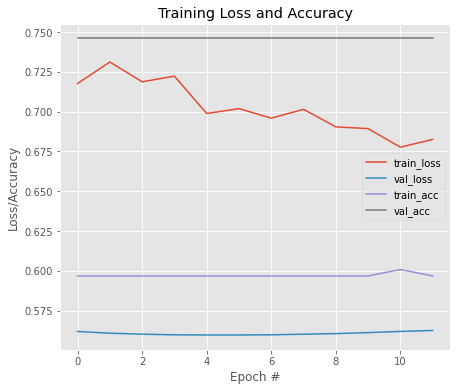


Model Performance Summary:

Best Validation accuracy:0.7460317611694336 at EPOCH:1
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.6620 - accuracy: 0.6008
Epoch 1: val_loss improved from inf to 0.54597, saving model to xception_b_0.hdf5
8/8 [==============================] - 13s 631ms/step - loss: 0.6620 - accuracy: 0.6008 - val_loss: 0.5460 - val_accuracy: 0.7460
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.6021 - accuracy: 0.6573
Epoch 2: val_loss improved from 0.54597 to 0.53694, saving model to xception_b_0.hdf5
8/8 [==============================] - 4s 485ms/step - loss: 0.6021 - accuracy: 0.6573 - val_loss: 0.5369 - val_accuracy: 0.7460
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.5728 - accuracy: 0.6573
Epoch 3: val_loss improved from 0.53694 to 0.52871, saving model to xception_b_0.hdf5
8/8 [==============================] - 4s 478ms/step - loss: 0.5728 - accuracy: 0.6573 - val_loss: 0.5287 - val_accuracy: 0.746

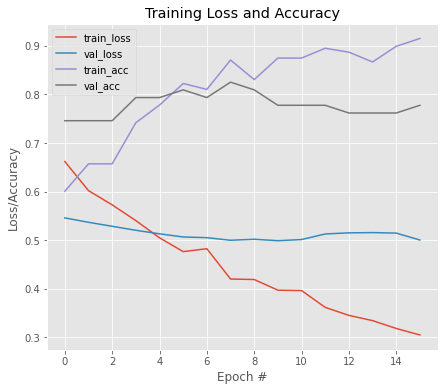


Model Performance Summary:

Best Validation accuracy:0.8253968358039856 at EPOCH:8
Starting fold 1
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.3057 - accuracy: 0.8996
Epoch 1: val_loss improved from inf to 0.40129, saving model to xception_a_1.hdf5
8/8 [==============================] - 13s 695ms/step - loss: 0.3057 - accuracy: 0.8996 - val_loss: 0.4013 - val_accuracy: 0.8387
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.2839 - accuracy: 0.9116
Epoch 2: val_loss improved from 0.40129 to 0.38020, saving model to xception_a_1.hdf5
8/8 [==============================] - 4s 482ms/step - loss: 0.2839 - accuracy: 0.9116 - val_loss: 0.3802 - val_accuracy: 0.8548
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.2739 - accuracy: 0.8996
Epoch 3: val_loss improved from 0.38020 to 0.36525, saving model to xception_a_1.hdf5
8/8 [==============================] - 4s 489ms/step - loss: 0.2739 - accuracy: 0.8996 - val_loss: 0.3653 - val

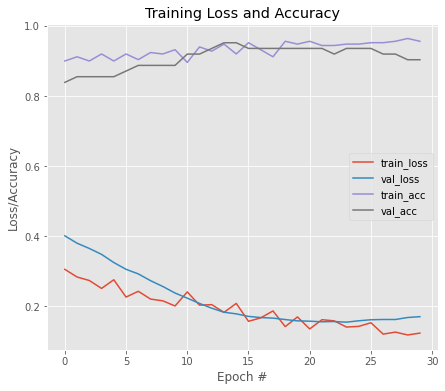


Model Performance Summary:

Best Validation accuracy:0.9516128897666931 at EPOCH:14
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.1446 - accuracy: 0.9598
Epoch 1: val_loss improved from inf to 0.15813, saving model to xception_b_1.hdf5
8/8 [==============================] - 12s 581ms/step - loss: 0.1446 - accuracy: 0.9598 - val_loss: 0.1581 - val_accuracy: 0.9355
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.1243 - accuracy: 0.9598
Epoch 2: val_loss did not improve from 0.15813
8/8 [==============================] - 3s 397ms/step - loss: 0.1243 - accuracy: 0.9598 - val_loss: 0.1595 - val_accuracy: 0.9355
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.1305 - accuracy: 0.9518
Epoch 3: val_loss did not improve from 0.15813
8/8 [==============================] - 3s 398ms/step - loss: 0.1305 - accuracy: 0.9518 - val_loss: 0.1621 - val_accuracy: 0.9032
Epoch 4/50
8/8 [==============================] - ETA: 0s - loss: 0.1201 - 

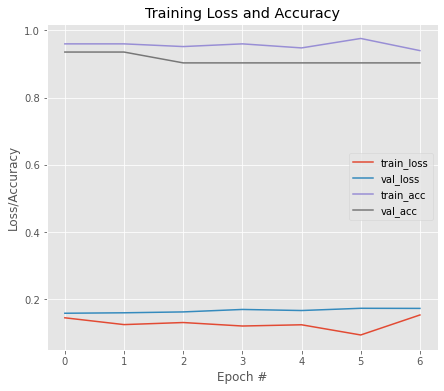


Model Performance Summary:

Best Validation accuracy:0.9354838728904724 at EPOCH:1
Starting fold 2
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.1629 - accuracy: 0.9518
Epoch 1: val_loss improved from inf to 0.05517, saving model to xception_a_2.hdf5
8/8 [==============================] - 12s 566ms/step - loss: 0.1629 - accuracy: 0.9518 - val_loss: 0.0552 - val_accuracy: 0.9839
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.1624 - accuracy: 0.9357
Epoch 2: val_loss improved from 0.05517 to 0.05442, saving model to xception_a_2.hdf5
8/8 [==============================] - 4s 485ms/step - loss: 0.1624 - accuracy: 0.9357 - val_loss: 0.0544 - val_accuracy: 0.9839
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.1311 - accuracy: 0.9639
Epoch 3: val_loss did not improve from 0.05442
8/8 [==============================] - 3s 399ms/step - loss: 0.1311 - accuracy: 0.9639 - val_loss: 0.0557 - val_accuracy: 0.9839
Epoch 4/50
8/8 [=====

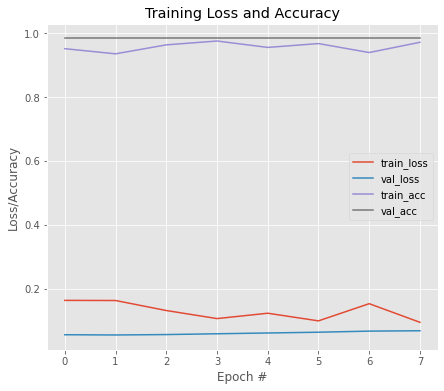


Model Performance Summary:

Best Validation accuracy:0.9838709831237793 at EPOCH:1
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.1203 - accuracy: 0.9558
Epoch 1: val_loss improved from inf to 0.05968, saving model to xception_b_2.hdf5
8/8 [==============================] - 12s 572ms/step - loss: 0.1203 - accuracy: 0.9558 - val_loss: 0.0597 - val_accuracy: 0.9839
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.1221 - accuracy: 0.9558
Epoch 2: val_loss improved from 0.05968 to 0.05663, saving model to xception_b_2.hdf5
8/8 [==============================] - 4s 485ms/step - loss: 0.1221 - accuracy: 0.9558 - val_loss: 0.0566 - val_accuracy: 0.9839
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.1111 - accuracy: 0.9598
Epoch 3: val_loss improved from 0.05663 to 0.05521, saving model to xception_b_2.hdf5
8/8 [==============================] - 4s 486ms/step - loss: 0.1111 - accuracy: 0.9598 - val_loss: 0.0552 - val_accuracy: 0.983

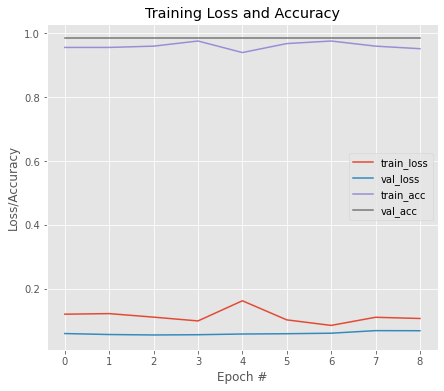


Model Performance Summary:

Best Validation accuracy:0.9838709831237793 at EPOCH:1
Starting fold 3
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.0878 - accuracy: 0.9759
Epoch 1: val_loss improved from inf to 0.02960, saving model to xception_a_3.hdf5
8/8 [==============================] - 12s 572ms/step - loss: 0.0878 - accuracy: 0.9759 - val_loss: 0.0296 - val_accuracy: 1.0000
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.0885 - accuracy: 0.9719
Epoch 2: val_loss did not improve from 0.02960
8/8 [==============================] - 3s 397ms/step - loss: 0.0885 - accuracy: 0.9719 - val_loss: 0.0304 - val_accuracy: 0.9839
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.1046 - accuracy: 0.9598
Epoch 3: val_loss improved from 0.02960 to 0.02918, saving model to xception_a_3.hdf5
8/8 [==============================] - 4s 485ms/step - loss: 0.1046 - accuracy: 0.9598 - val_loss: 0.0292 - val_accuracy: 1.0000
Epoch 4/50
8/8 [=====

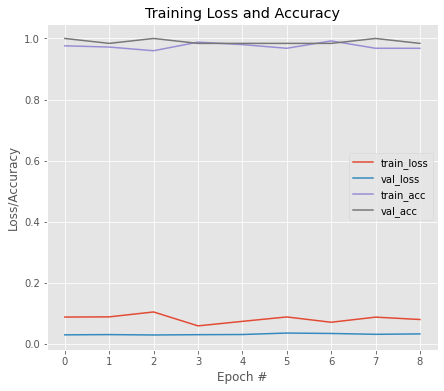


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.0932 - accuracy: 0.9719
Epoch 1: val_loss improved from inf to 0.02662, saving model to xception_b_3.hdf5
8/8 [==============================] - 12s 565ms/step - loss: 0.0932 - accuracy: 0.9719 - val_loss: 0.0266 - val_accuracy: 1.0000
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.0632 - accuracy: 0.9839
Epoch 2: val_loss did not improve from 0.02662
8/8 [==============================] - 3s 398ms/step - loss: 0.0632 - accuracy: 0.9839 - val_loss: 0.0269 - val_accuracy: 1.0000
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.0637 - accuracy: 0.9759
Epoch 3: val_loss improved from 0.02662 to 0.02633, saving model to xception_b_3.hdf5
8/8 [==============================] - 4s 485ms/step - loss: 0.0637 - accuracy: 0.9759 - val_loss: 0.0263 - val_accuracy: 1.0000
Epoch 4/50
8/8 [==============================] - ET

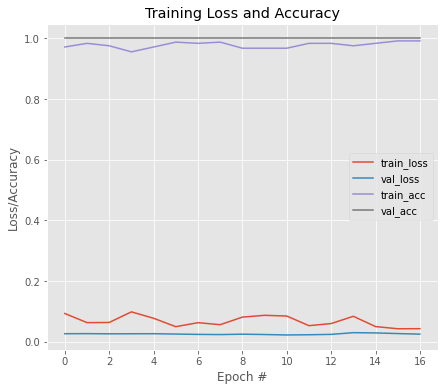


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Starting fold 4
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.0582 - accuracy: 0.9799
Epoch 1: val_loss improved from inf to 0.02244, saving model to xception_a_4.hdf5
8/8 [==============================] - 12s 567ms/step - loss: 0.0582 - accuracy: 0.9799 - val_loss: 0.0224 - val_accuracy: 1.0000
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.0464 - accuracy: 0.9920
Epoch 2: val_loss improved from 0.02244 to 0.02162, saving model to xception_a_4.hdf5
8/8 [==============================] - 4s 482ms/step - loss: 0.0464 - accuracy: 0.9920 - val_loss: 0.0216 - val_accuracy: 1.0000
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.0747 - accuracy: 0.9759
Epoch 3: val_loss improved from 0.02162 to 0.02122, saving model to xception_a_4.hdf5
8/8 [==============================] - 4s 483ms/step - loss: 0.0747 - accuracy: 0.9759 - val_loss: 0.0212 - val_accuracy: 1.00

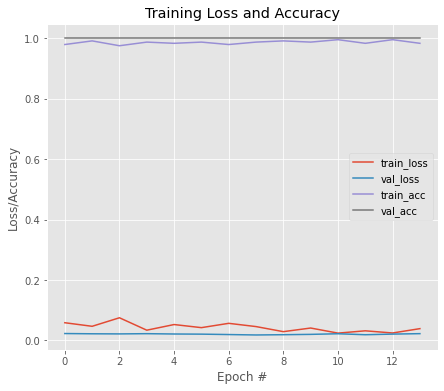


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.0286 - accuracy: 0.9920
Epoch 1: val_loss improved from inf to 0.01969, saving model to xception_b_4.hdf5
8/8 [==============================] - 12s 578ms/step - loss: 0.0286 - accuracy: 0.9920 - val_loss: 0.0197 - val_accuracy: 1.0000
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.0330 - accuracy: 0.9920
Epoch 2: val_loss did not improve from 0.01969
8/8 [==============================] - 3s 398ms/step - loss: 0.0330 - accuracy: 0.9920 - val_loss: 0.0213 - val_accuracy: 1.0000
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.0294 - accuracy: 0.9960
Epoch 3: val_loss did not improve from 0.01969
8/8 [==============================] - 3s 410ms/step - loss: 0.0294 - accuracy: 0.9960 - val_loss: 0.0211 - val_accuracy: 1.0000
Epoch 4/50
8/8 [==============================] - ETA: 0s - loss: 0.0269 - accuracy: 1.0000

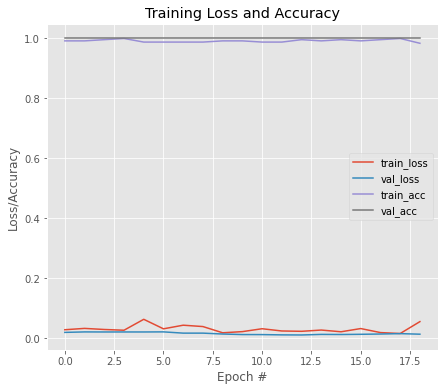


Model Performance Summary:

Best Validation accuracy:1.0 at EPOCH:1
Average Accuracy:0.9489503383636475
 Training Model on full dataset
 Training Model with pretraned layer frozen
Epoch 1/50
10/10 [==============================] - ETA: 0s - loss: 0.0360 - accuracy: 0.9904
Epoch 1: val_loss did not improve from inf
10/10 [==============================] - 7s 461ms/step - loss: 0.0360 - accuracy: 0.9904 - val_loss: nan - val_accuracy: 0.0000e+00
Epoch 2/50
10/10 [==============================] - ETA: 0s - loss: 0.0276 - accuracy: 1.0000
Epoch 2: val_loss did not improve from inf
10/10 [==============================] - 3s 336ms/step - loss: 0.0276 - accuracy: 1.0000 - val_loss: nan - val_accuracy: 0.0000e+00
Epoch 3/50
10/10 [==============================] - ETA: 0s - loss: 0.0361 - accuracy: 0.9936
Epoch 3: val_loss did not improve from inf
10/10 [==============================] - 3s 351ms/step - loss: 0.0361 - accuracy: 0.9936 - val_loss: nan - val_accuracy: 0.0000e+00
Epoch 4/50
1

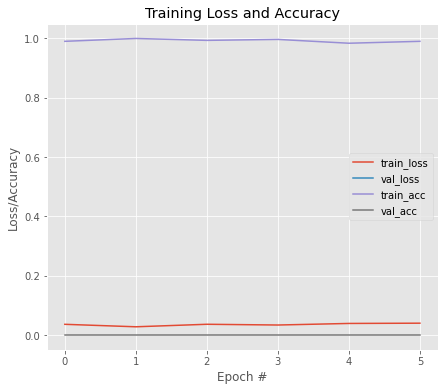


Model Performance Summary:

Best Validation accuracy:0.0 at EPOCH:1
 Training Model with pretraned layer trainable


OSError: ignored

In [ ]:
for model in MODEL_LIST_2:
  set_seed()
  model_obj = HIGH_LEVEL_MODEL(model)
  model_obj.train_phase(trainx,trainy,testx,testy)
  gc.collect()